In [1]:
from Postprocess_functions import *

Welcome to JupyROOT 6.26/10


In [2]:
import gmsh
import sys
import os
from os.path import exists
import subprocess
import numpy as np
import time
import ROOT
from os import listdir
from os.path import isfile, join
import os.path
from os import path
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import argparse
from ROOT import TFile, TTree
import matplotlib.pyplot as plt
from scipy.interpolate import splrep, splev,splprep
from scipy.interpolate import BSpline
import math
def Initialization_Mult(args):
    print('Initializations')
    gen=[]
    gen_file=[]
    NSGA_files=[]
    root_folder=[]
    pictures_folder=[]
    pictures_folder_pareto=[]
    pictures_folder_filter=[]
    pictures_folder_filter_shape=[]
    
    c=0
    for fol in args.folder:
        root_folder.append(fol)
        gen.append(args.generation[c])
        print(gen)
        folder_path='ROOT/'+root_folder[c] # add path to ROOT/
        rf=os.listdir(folder_path)		# get all files in the folder
        NSGA_filenames = find_strings_containing_substring(rf, 'NSGAII_') # Get all root files
        print(rf)
        NSGA_filenames=sort_strings_by_int(NSGA_filenames)
        prefix = folder_path+'/'
        NSGA_files.append([prefix+s for s in NSGA_filenames])
        print(str(gen[c]))
        gen_file.append(folder_path+'/'+find_strings_containing_substring(rf, str(gen[c]))[0]) # Get last generation file or given gen.
        print('pictures/ROOT/'+root_folder[c]+'/Shape/')
        pictures_folder.append('pictures/ROOT/'+root_folder[c]+'/Shape/')
        print(pictures_folder)
        pictures_folder_pareto.append('pictures/ROOT/'+root_folder[c]+'/Pareto/')
        pictures_folder_filter.append('pictures/ROOT/'+root_folder[c]+'/Filter/')
        pictures_folder_filter_shape.append('pictures/ROOT/'+root_folder[c]+'/Filter/Shape_gen'+str(gen[c])+'/')

        create_folder(pictures_folder[c])  # Create required folders to store pictures
        create_folder(pictures_folder_pareto[c])  # Create required folders to store pictures
        create_folder(pictures_folder_filter[c])  # Create required folders to store pictures
        create_folder(pictures_folder_filter_shape[c])  # Create required folders to store pictures
        c+=1
        print('### Initializations END')
    return gen, gen_file, NSGA_files, root_folder, pictures_folder, pictures_folder_pareto, pictures_folder_filter, pictures_folder_filter_shape


In [ ]:
import matplotlib as mpl
pgf_with_latex = {                      # setup matplotlib to use latex for output
    "pgf.texsystem": "pdflatex",        # change this if using xetex or lautex
    "text.usetex": True,                # use LaTeX to write all text
    "font.family": "serif",
    "font.serif": [],                   # blank entries should cause plots 
    "font.sans-serif": [],              # to inherit fonts from the document
    "font.monospace": [],
    "axes.labelsize": 10,               # LaTeX default is 10pt font.
    "font.size": 10,
    "legend.fontsize": 8,               # Make the legend/label fonts 
    "xtick.labelsize": 8,               # a little smaller
    "ytick.labelsize": 8,
    #"figure.figsize": figsize(0.9),     # default fig size of 0.9 textwidth
    "pgf.preamble": "\n".join([ # plots will use this preamble
        r"\usepackage[utf8]{inputenc}",
        r"\usepackage[T1]{fontenc}",
        r"\usepackage[detect-all,locale=DE]{siunitx}",
        ])
    }
mpl.use("pgf")
mpl.rcParams.update(pgf_with_latex)

In [3]:
# Fill the class with the required inputs:

class ArgValues:
    def __init__(self):
        self.folder = ["G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12"]
        self.generation = [13]
        self.Ysym = [1]
        self.LYSOL = [1]
        self.save = 1
        self.Shape = 0
        self.ParetoFrontier = 0
        self.Filter = 1
        self.LaunchIndv = 0
args0=ArgValues()

In [4]:
gen, gen_file, NSGA_files, root_folder, pictures_folder, pictures_folder_pareto, pictures_folder_filter, pictures_folder_filter_shape= Initialization_Mult(args0)
gen_file

Initializations
[13]
['NSGAII_3.root', 'NSGAII_11.root', 'NSGAII_2.root', 'NSGAII_0.root', 'NSGAII_5.root', 'NSGAII_12.root', 'NSGAII_8.root', 'NSGAII_7.root', 'NSGAII_13.root', 'NSGAII_4.root', 'NSGAII_9.root', 'NSGAII_10.root', 'NSGAII_1.root', 'NSGAII_6.root']
13
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Shape/
['pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Shape/']
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Shape/ already exists.
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Pareto/ already exists.
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Filter/ already exists.
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Filter/Shape_gen13/ already exists.
### Initializations END


['ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_13.root']

In [5]:
NSGA_files

[['ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_0.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_1.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_2.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_3.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_4.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_5.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_6.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_7.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_8.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_9.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_10.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_11.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375

In [6]:
NSGA_files[0][1]

'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_1.root'

### Filter - PF
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
[72, 24, 9, 13, 67, 77, 2, 83, 73, 23, 65, 64, 84, 87, 27]


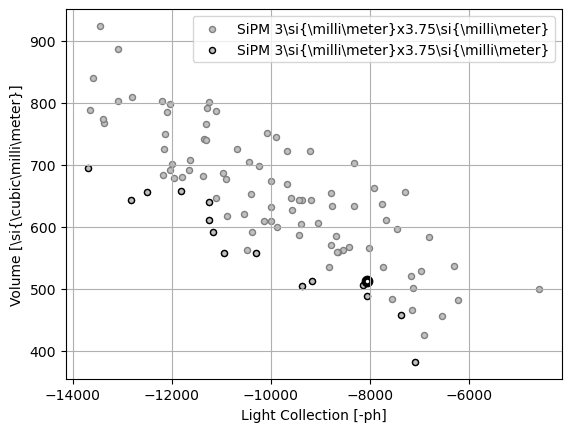

<Figure size 640x480 with 0 Axes>

In [7]:
	##############
	### FILTER ###
	##############
print('### Filter - PF')
fig1, ax1 = plt.subplots()

def plt_filtered_PF(fig1,ax1,gen_file,colorf,colore,lab='',mk='o'):
    # Get required input for plotting the crystal shapes
    num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file)
    obj1f,obj2f,idxf=filter_values(obj1,obj2,20)
    print(idxf)
    #ax1.errorbar(obj1f,obj2f, fmt='o', capsize=3)
    ax1.scatter(obj1f,obj2f, s=19, c=colorf, edgecolor=colore, marker=mk,label=lab)
#    ax.errorbar(x, y, xerr=xerr, fmt='o', capsize=3)

def plt_nonfiltered_PF(fig1,ax1,gen_file,colorf,colore,lab='',mk='o'):
    # Get required input for plotting the crystal shapes
    num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file)
    #obj1f,obj2f,idxf=filter_values(obj1,obj2,20)
    #print(idxf)
    #ax1.errorbar(obj1f,obj2f, fmt='o', capsize=3)
    ax1.scatter(obj1,obj2, s=19, c=colorf, edgecolor=colore, marker=mk,label=lab)
#    ax.errorbar(x, y, xerr=xerr, fmt='o', capsize=3)

plt.grid()
ax1.set_xlabel('Light Collection [-ph]')
ax1.set_ylabel('Volume [\\si{\cubic\milli\meter}]')
#plt.axhline(y = 3*3*28.5*2, color = 'k', linestyle = '--')
#plt.axhline(y = 2.4*3*28.5*2, color = 'k', linestyle = '--')
#plt.axhline(y = 3.75*3*28.5*2, color = 'k', linestyle = '--')
plt_nonfiltered_PF(fig1,ax1,NSGA_files[0][0],'silver','gray',lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}')
plt_filtered_PF(fig1,ax1,NSGA_files[0][0],'silver','black',lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}')

ax1.scatter([-8059],[513],s=30, c='white', edgecolor='black', marker='o',linewidths=3)
ax1.legend(bbox_to_anchor=(1.0, 1))

plt.show()
plt.draw()


The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


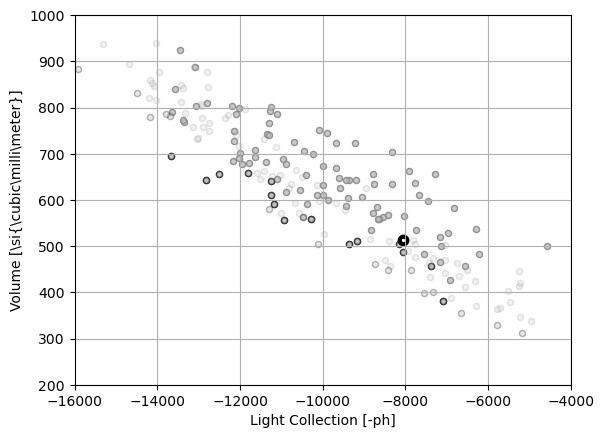

In [8]:
import matplotlib.pyplot as plt

def plot_filtered_data_G(nsga_file_idx, alpha=1.0):
    fig, ax = plt.subplots()

    def plt_filtered_PF(fig, ax, gen_file, colorf, colore, lab='', mk='o',alph=alpha):
        # Get required input for plotting the crystal shapes
        num_indv, num_vars, obj1, obj2, vars_tuple, lstvars = GetRootVariables(gen_file)
        obj1f, obj2f, idxf = filter_values(obj1, obj2, 20)
        ax.scatter(obj1f, obj2f, s=19, c=colorf, edgecolor=colore, marker=mk, alpha=alph, label=lab)

    def plt_nonfiltered_PF(fig1,ax1,gen_file,colorf,colore,lab='',mk='o',alph=alpha):
        # Get required input for plotting the crystal shapes
        num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file)
        #obj1f,obj2f,idxf=filter_values(obj1,obj2,20)
        #print(idxf)
        #ax1.errorbar(obj1f,obj2f, fmt='o', capsize=3)
        ax1.scatter(obj1,obj2, s=19, c=colorf, edgecolor=colore, marker=mk, alpha=alph,label=lab)
    #    ax.errorbar(x, y, xerr=xerr, fmt='o', capsize=3)
        
    plt.grid()
    ax.set_xlabel('Light Collection [-ph]')
    ax.set_ylabel('Volume [\\si{\cubic\milli\meter}]')
    plt_nonfiltered_PF(fig, ax, NSGA_files[0][nsga_file_idx], 'silver', 'gray', lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}')
    plt_filtered_PF(fig, ax, NSGA_files[0][nsga_file_idx], 'silver', 'black', lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}')
    
    if (alpha<1):
        plt_nonfiltered_PF(fig, ax, NSGA_files[0][nsga_file_idx+1], 'silver', 'gray', lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}',alph=1-alpha)
        plt_filtered_PF(fig, ax, NSGA_files[0][nsga_file_idx+1], 'silver', 'black', lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}',alph=1-alpha)
    
    ax.scatter([-8059], [513], s=30, c='white', edgecolor='black', marker='o', linewidths=3)
    #ax.legend(bbox_to_anchor=(1.0, 1))
    #ax.set_xlim(left=0)
    ax.set_xlim([-16000,-4000])
    ax.set_ylim([200,1000])
    plt.show()


plot_filtered_data_G(0,0.8)


The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100


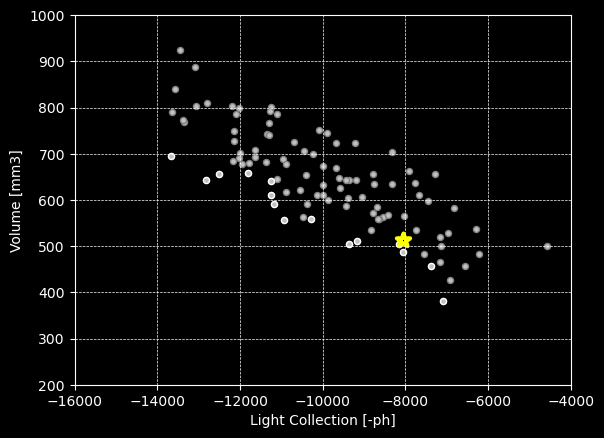

In [15]:
import matplotlib.pyplot as plt

def plot_filtered_data_G_w(nsga_file_idx, alpha=1.0,idx=0):
    fig, ax = plt.subplots()

    def plt_filtered_PF(fig, ax, gen_file, colorf, colore, lab='', mk='o',alph=1):
        # Get required input for plotting the crystal shapes
        num_indv, num_vars, obj1, obj2, vars_tuple, lstvars = GetRootVariables(gen_file)
        obj1f, obj2f, idxf = filter_values(obj1, obj2, 20)
        ax.scatter(obj1f, obj2f, s=19, c=colorf, edgecolor=colore, marker=mk, alpha=alph, label=lab)

    def plt_nonfiltered_PF(fig1,ax1,gen_file,colorf,colore,lab='',mk='o',alph=1):
        # Get required input for plotting the crystal shapes
        num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file)
        #obj1f,obj2f,idxf=filter_values(obj1,obj2,20)
        #print(idxf)
        #ax1.errorbar(obj1f,obj2f, fmt='o', capsize=3)
        ax1.scatter(obj1,obj2, s=19, c=colorf, edgecolor=colore, marker=mk, alpha=alph,label=lab)
    #    ax.errorbar(x, y, xerr=xerr, fmt='o', capsize=3)

    ax.set_facecolor('black') # Set background color
    plt.grid(color='white', linestyle='--', linewidth=0.5) # Set grid color
    ax.tick_params(axis='x', colors='white') # Set color of x-axis ticks and labels
    ax.tick_params(axis='y', colors='white') # Set color of y-axis ticks and labels
    ax.spines['bottom'].set_color('white') # Set color of x-axis line
    ax.spines['left'].set_color('white') # Set color of y-axis line
    ax.set_xlabel('Light Collection [-ph]', color='white')
    ax.set_ylabel('Volume [mm3]', color='white')
    
    plt_nonfiltered_PF(fig, ax, NSGA_files[0][nsga_file_idx], 'silver', 'gray', lab='', alph=alpha)
    plt_filtered_PF(fig, ax, NSGA_files[0][nsga_file_idx], 'silver', 'white', lab='', alph=alpha)

    if (alpha<1):
        plt_nonfiltered_PF(fig, ax, NSGA_files[0][nsga_file_idx+1], 'silver', 'gray', lab='',alph=1-alpha)
        plt_filtered_PF(fig, ax, NSGA_files[0][nsga_file_idx+1], 'silver', 'white', lab='',alph=1-alpha)
    
    ax.scatter([-8059], [513], s=100, c='black', edgecolor='yellow', marker='*', linewidths=3)
    #ax.legend(bbox_to_anchor=(1.0, 1))
    #ax.set_xlim(left=0)
    ax.set_xlim([-16000,-4000])
    ax.set_ylim([200,1000])
    plt.savefig(f"movieIM/picture_{idx}.png")



    plt.show()
    
plt.style.use('dark_background')
plot_filtered_data_G_w(0,1,3)


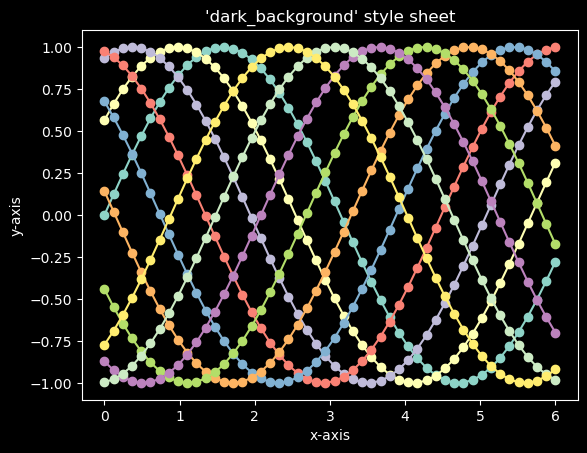

In [10]:
import numpy as np
import matplotlib.pyplot as plt


plt.style.use('dark_background')

fig, ax = plt.subplots()

L = 6
x = np.linspace(0, L)
ncolors = len(plt.rcParams['axes.prop_cycle'])
shift = np.linspace(0, L, ncolors, endpoint=False)
for s in shift:
    ax.plot(x, np.sin(x + s), 'o-')
ax.set_xlabel('x-axis')
ax.set_ylabel('y-axis')
ax.set_title("'dark_background' style sheet")

plt.show()

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100


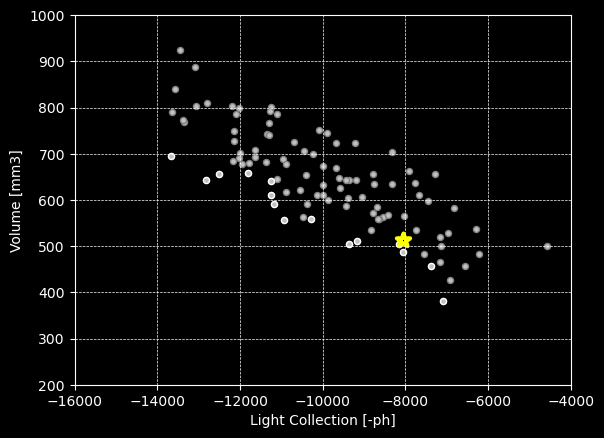

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


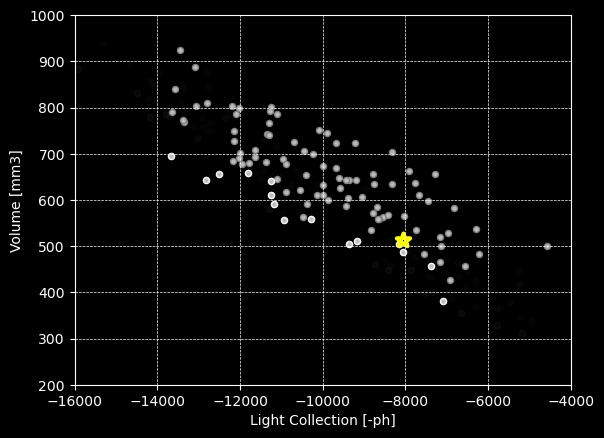

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


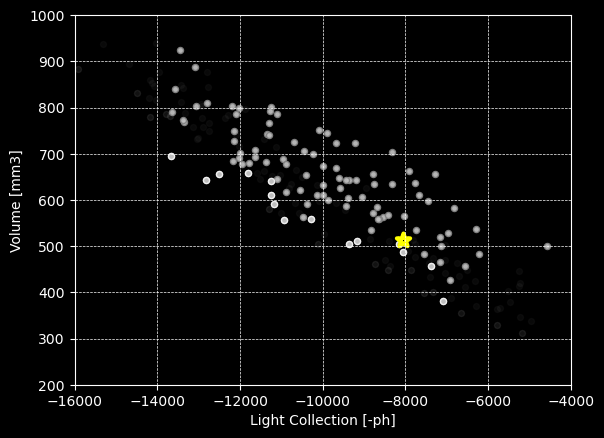

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


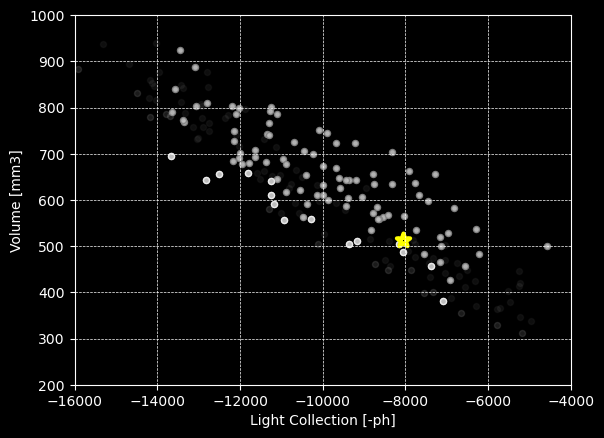

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


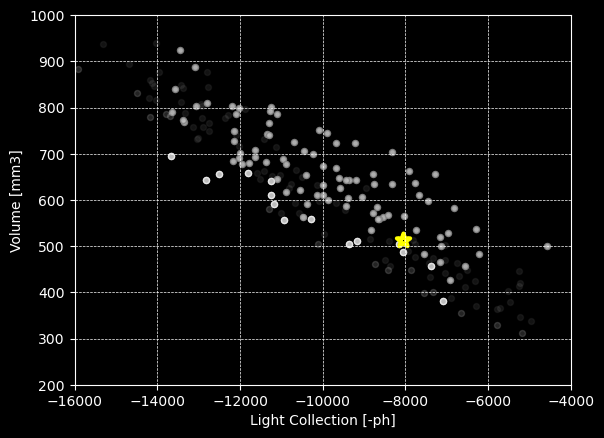

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


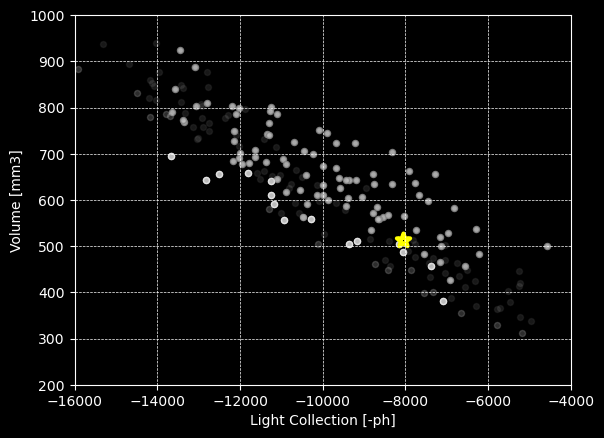

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


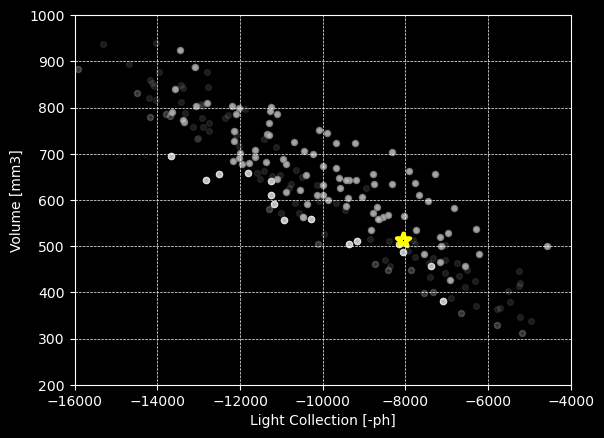

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


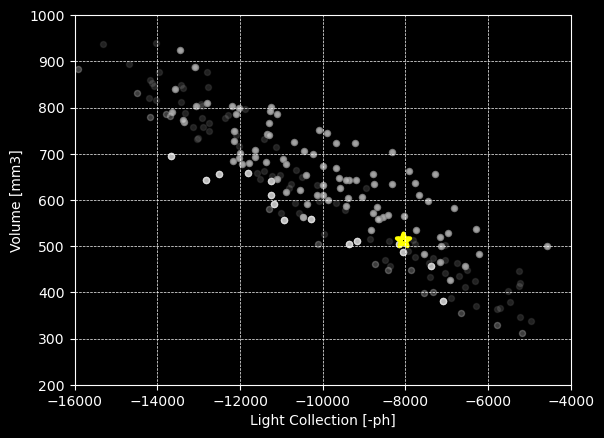

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


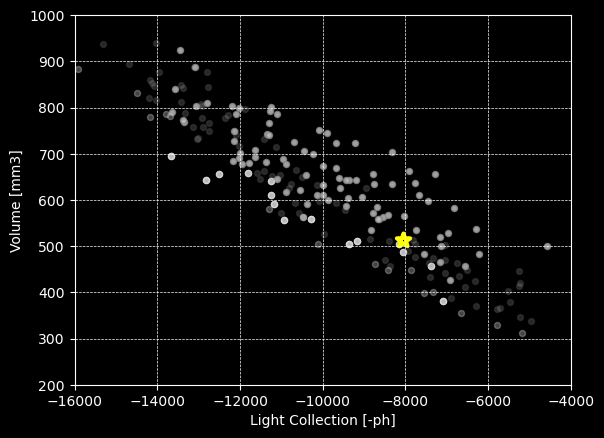

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


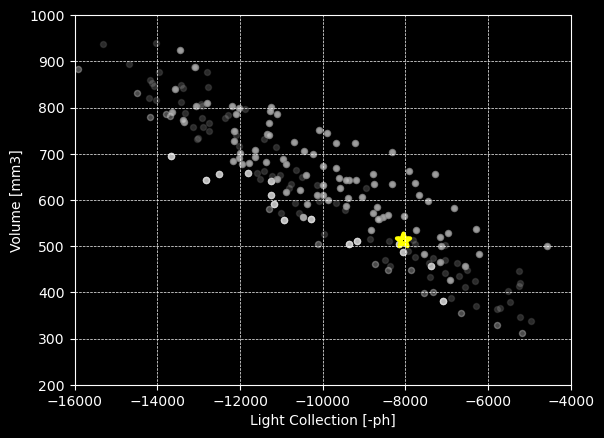

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


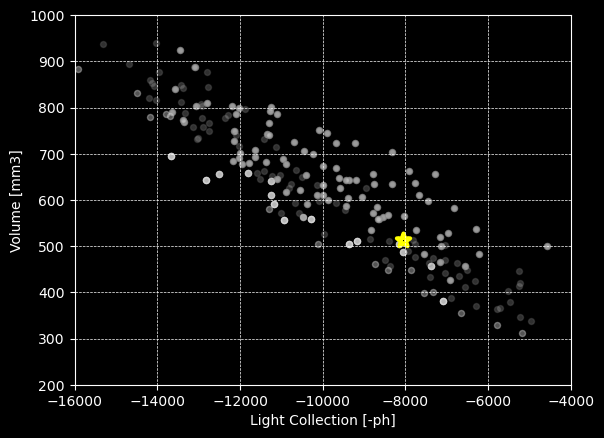

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


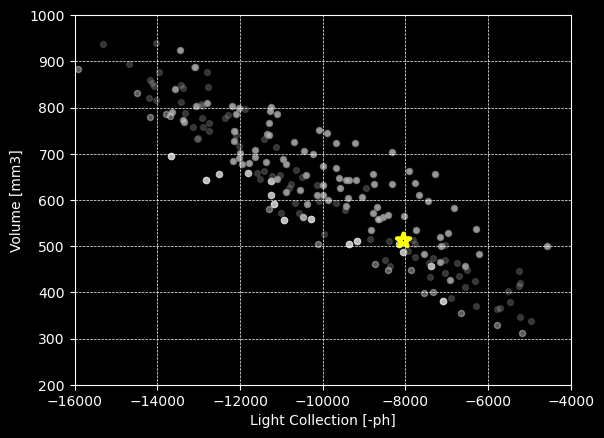

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


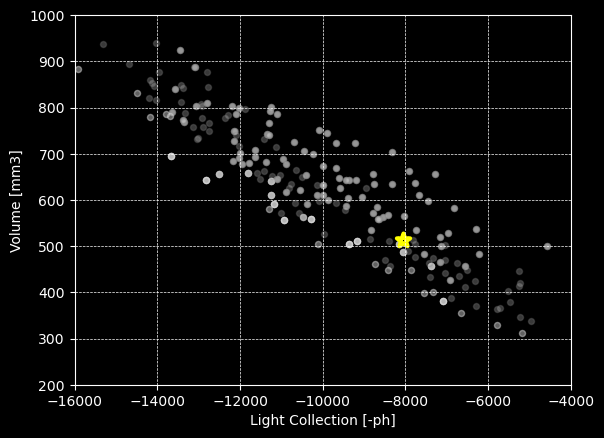

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


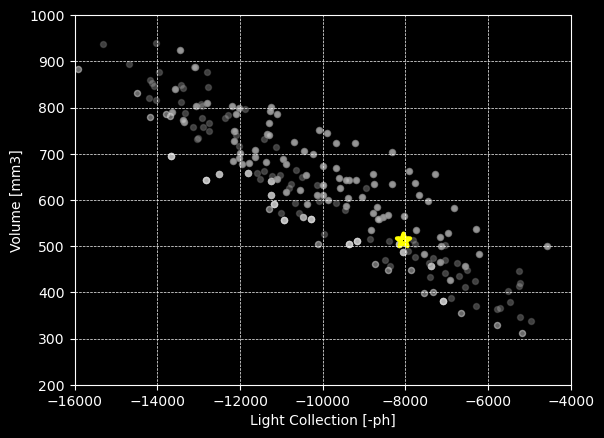

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


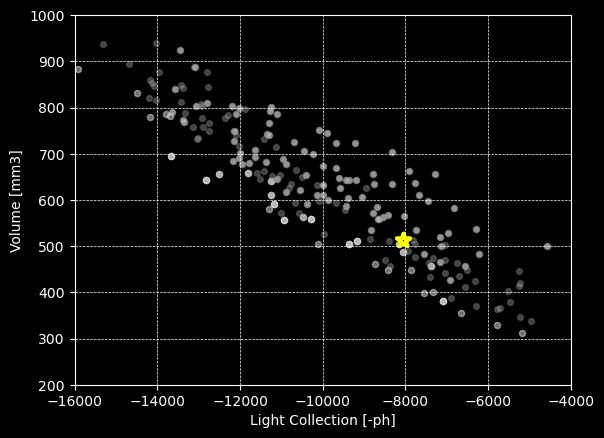

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


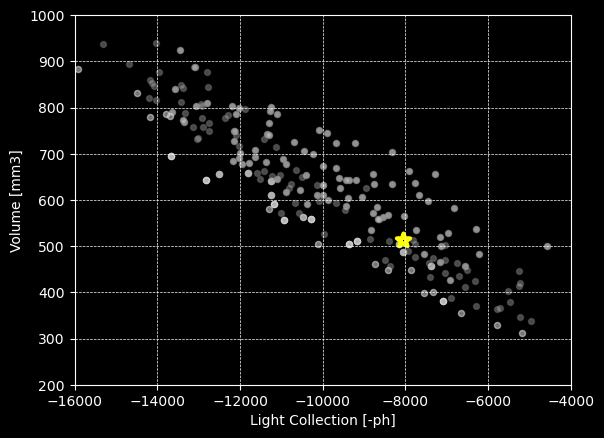

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


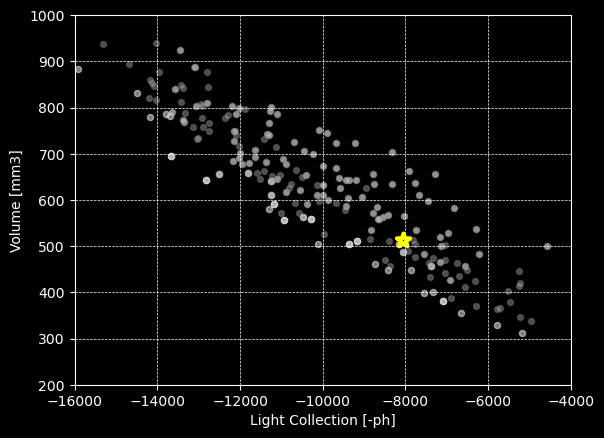

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


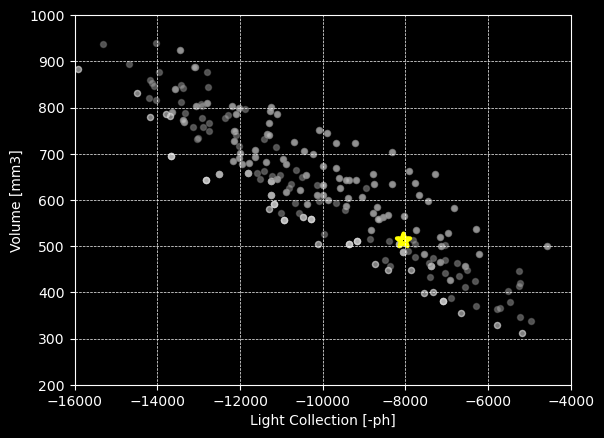

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


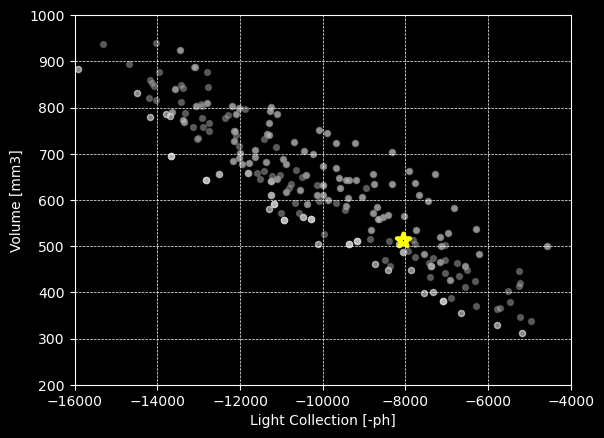

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


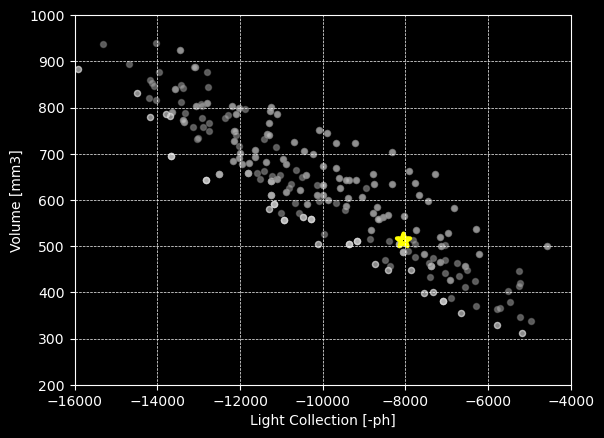

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


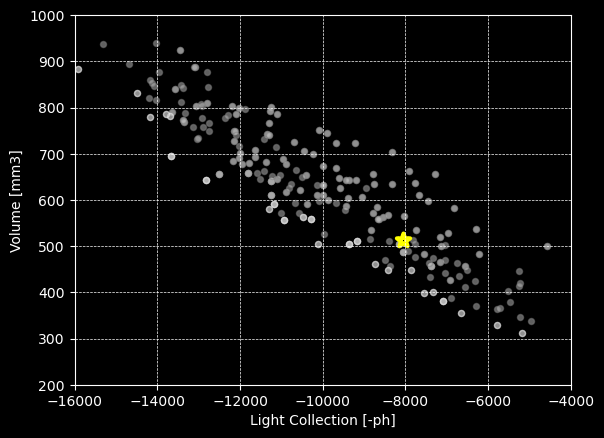

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


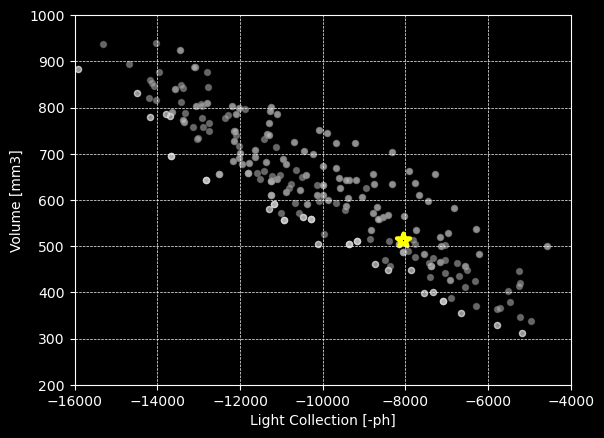

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


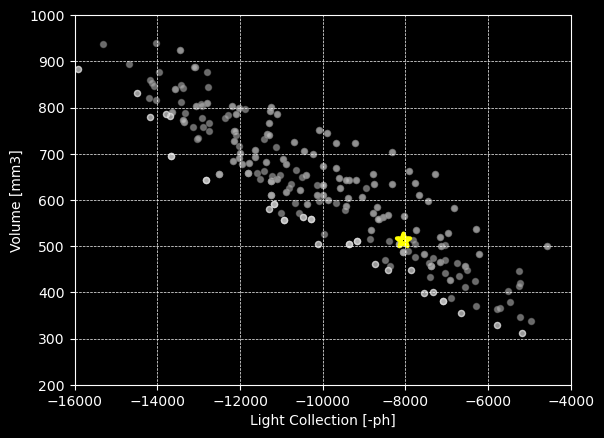

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


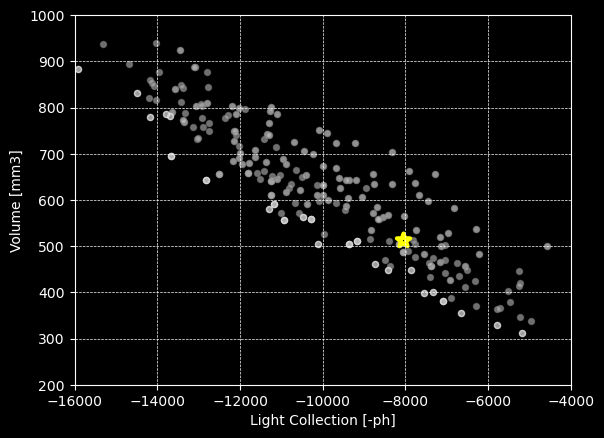

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


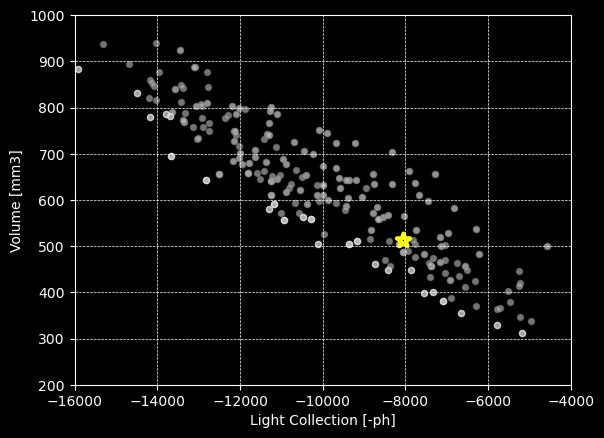

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


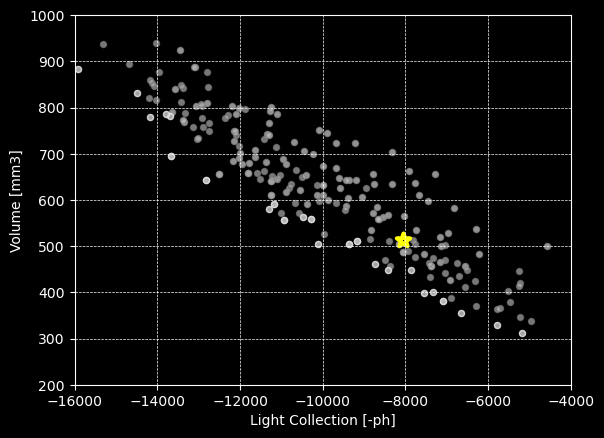

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


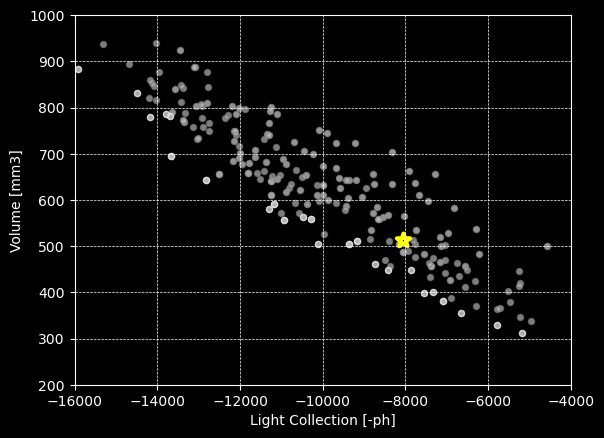

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


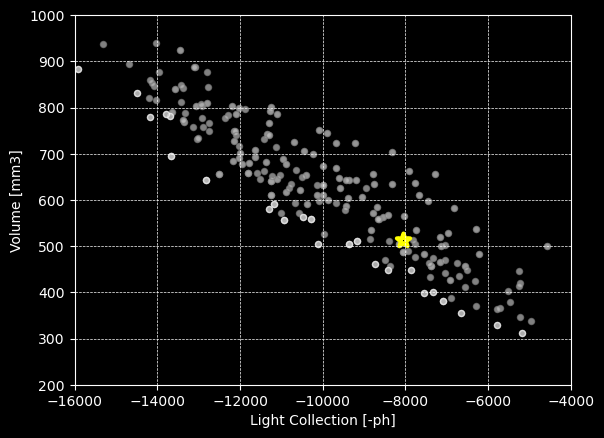

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


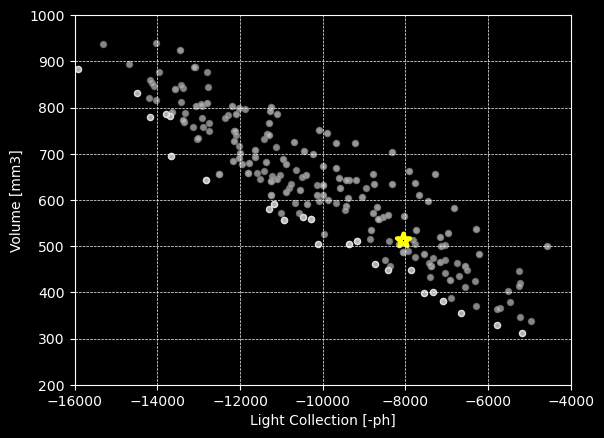

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


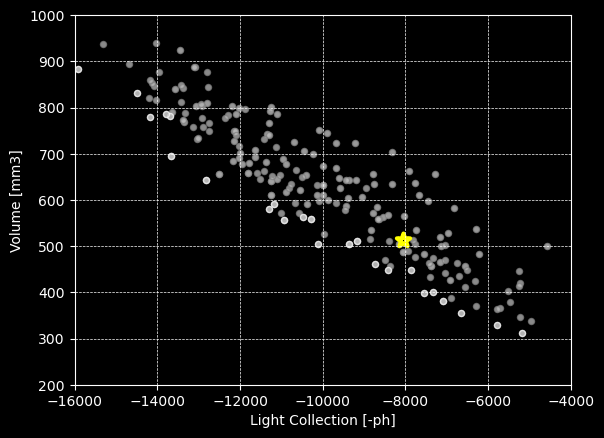

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


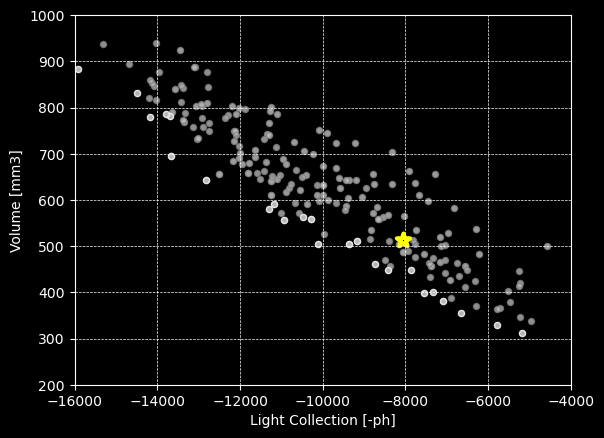

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


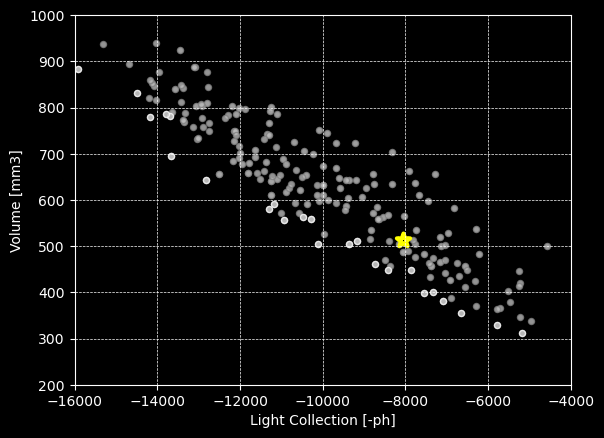

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


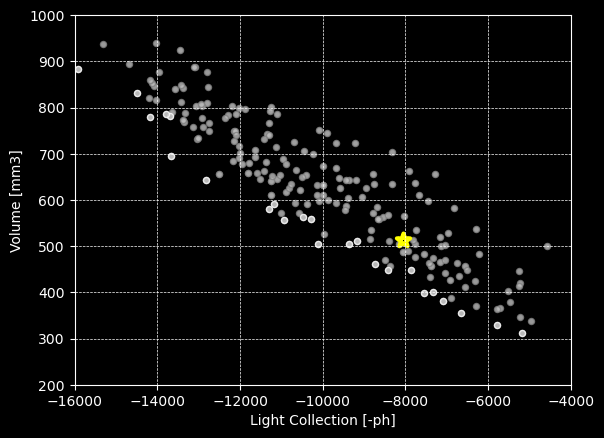

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


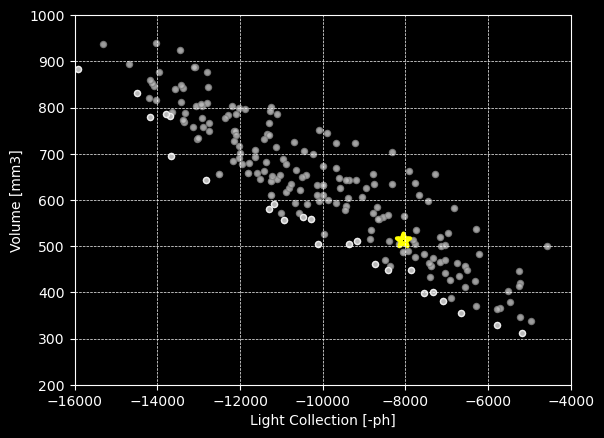

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


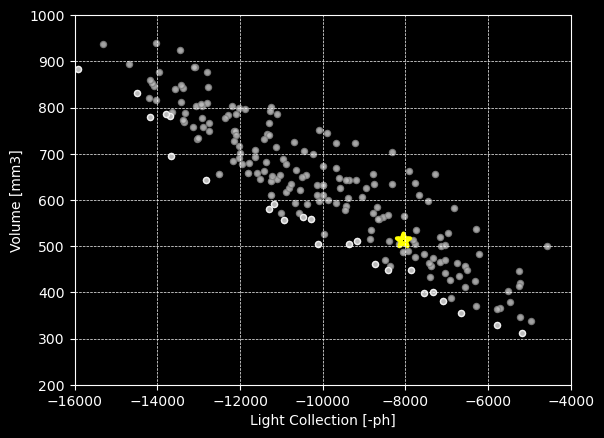

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


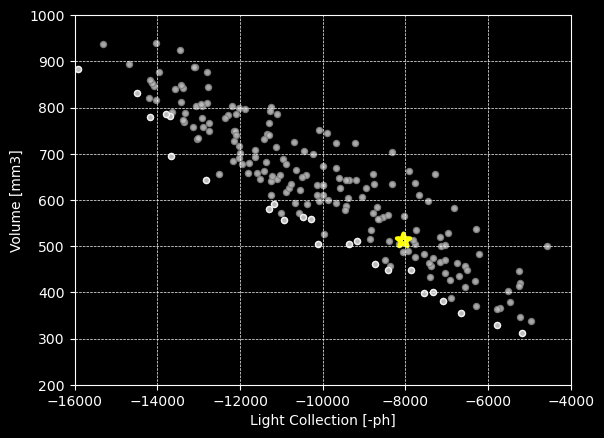

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


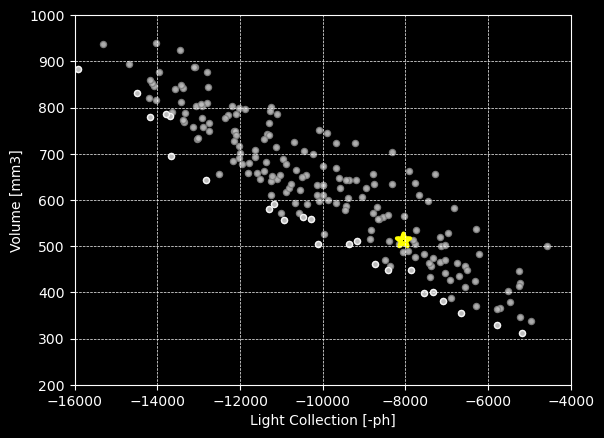

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


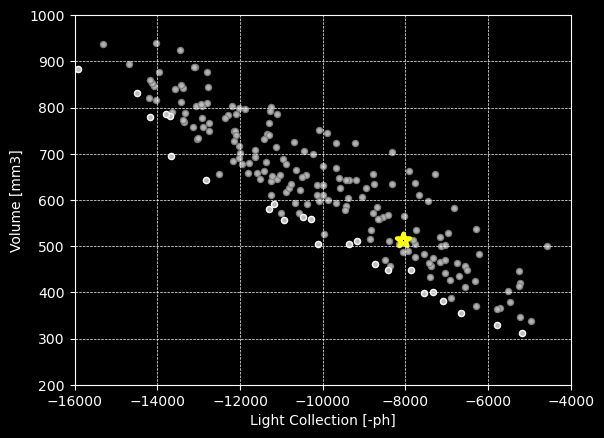

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


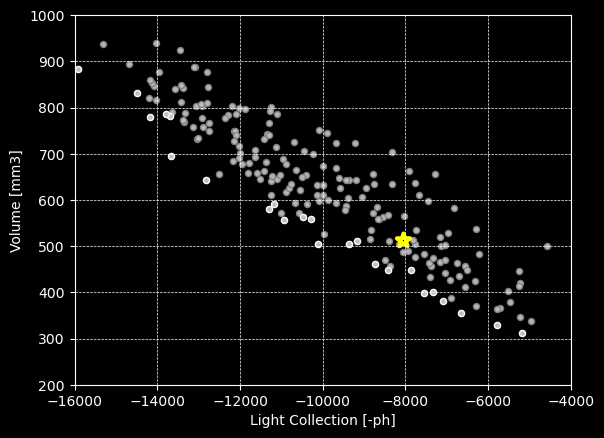

The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


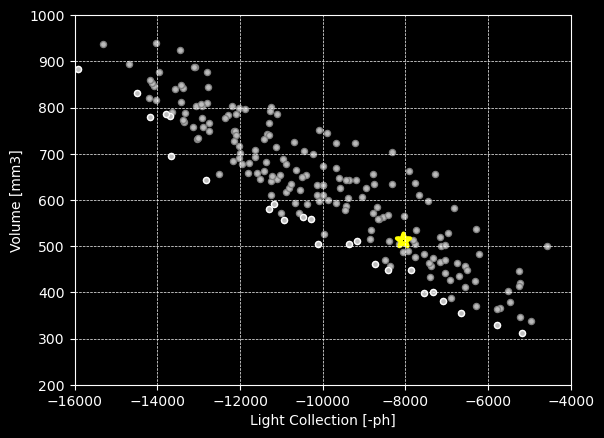

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


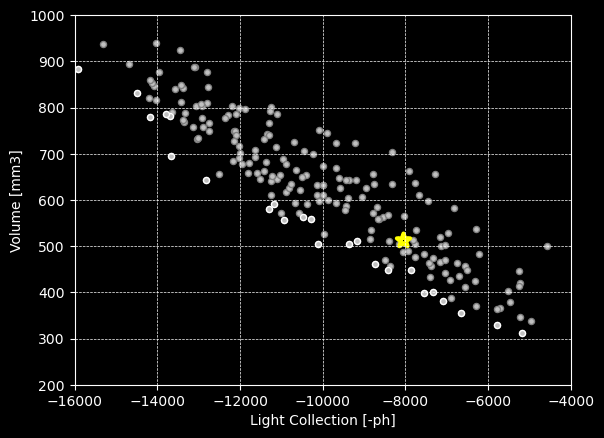

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


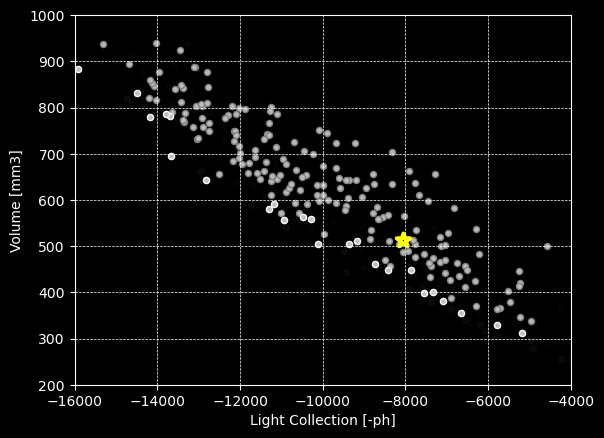

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


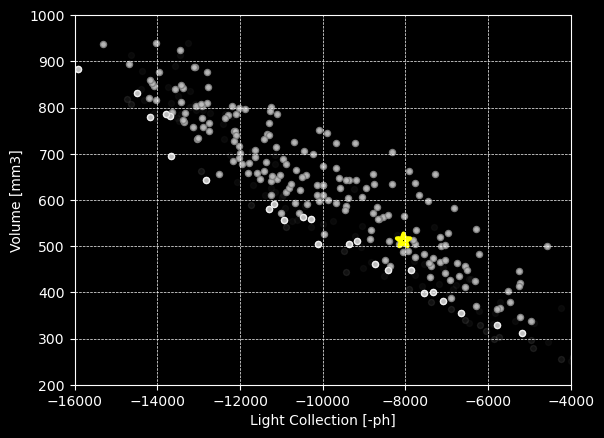

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


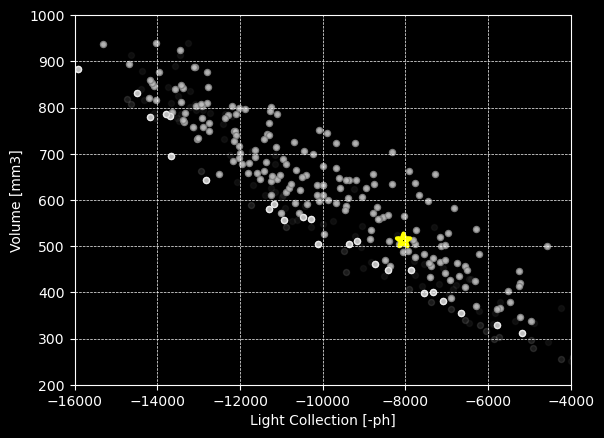

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


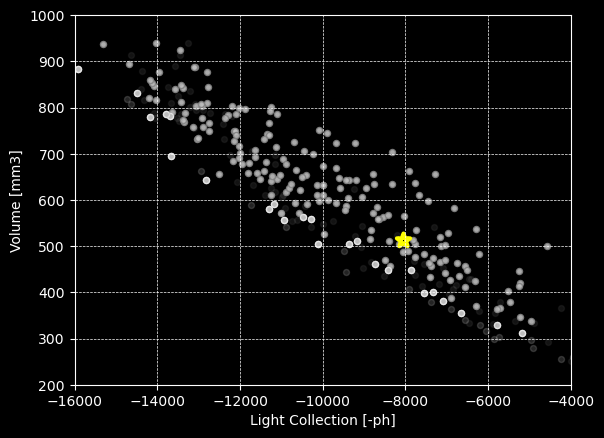

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


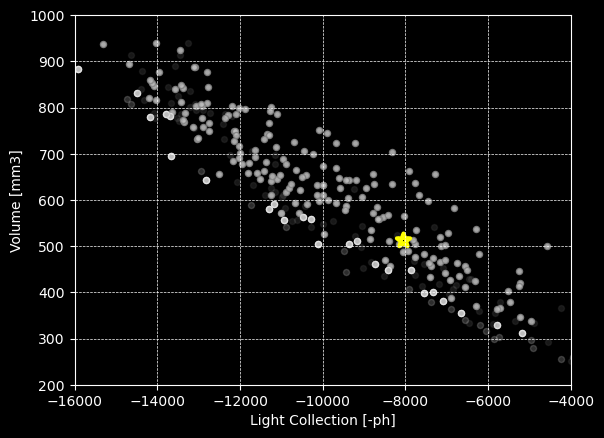

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


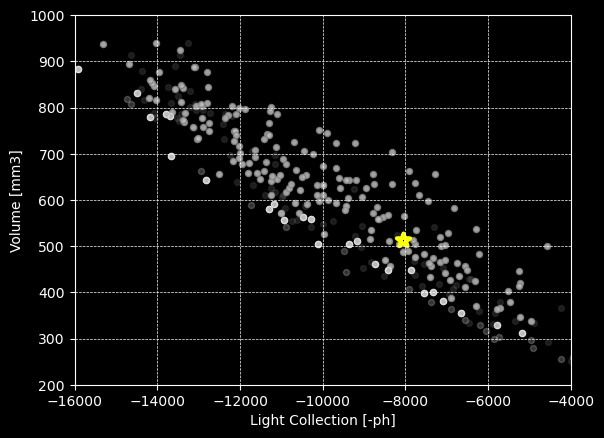

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


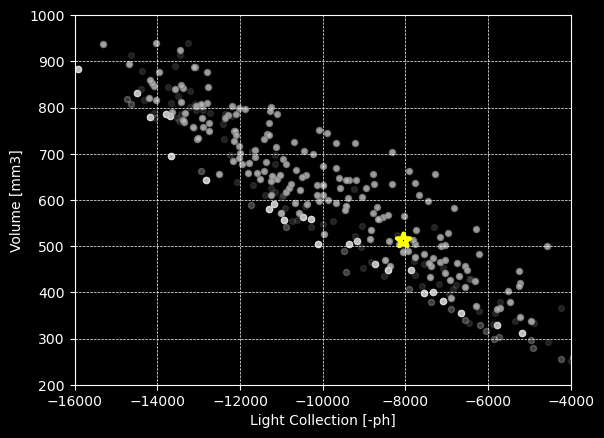

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


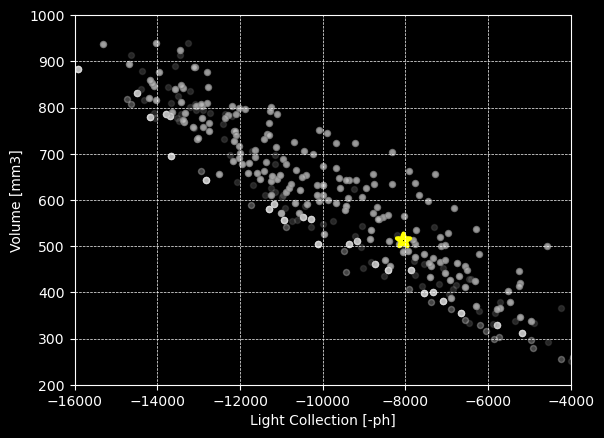

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


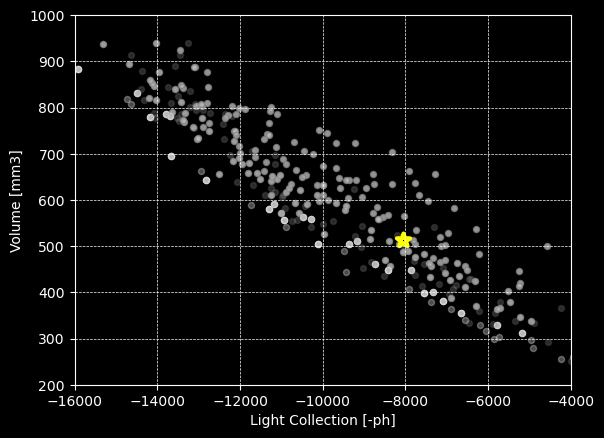

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


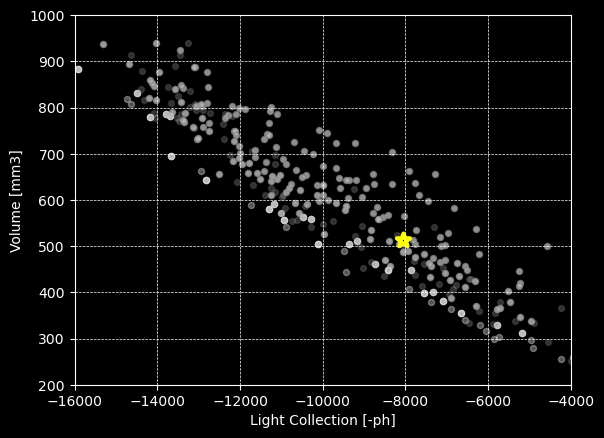

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


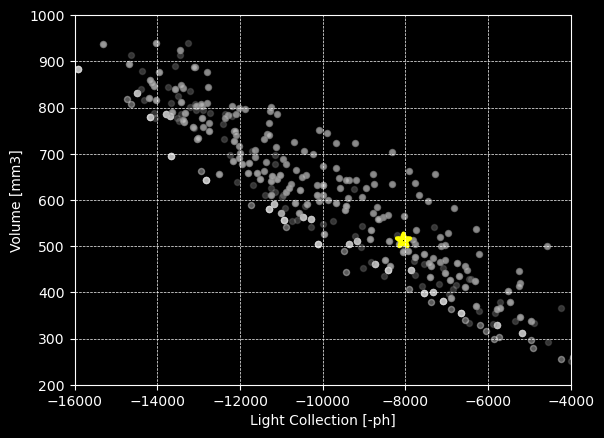

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


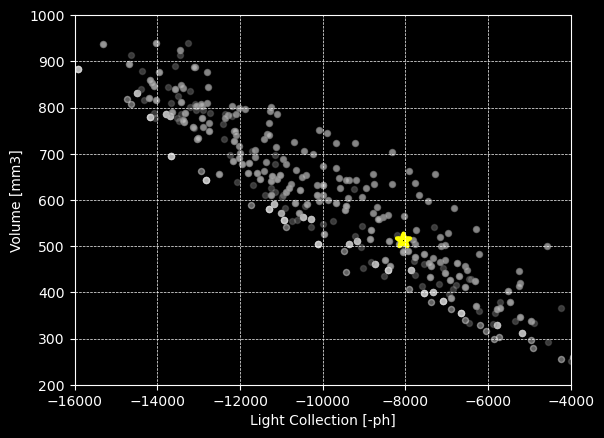

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


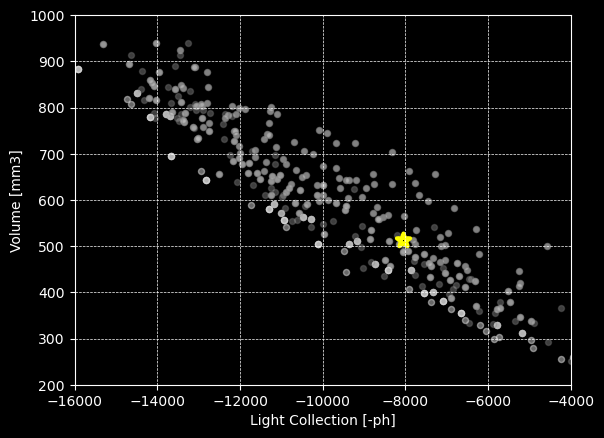

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


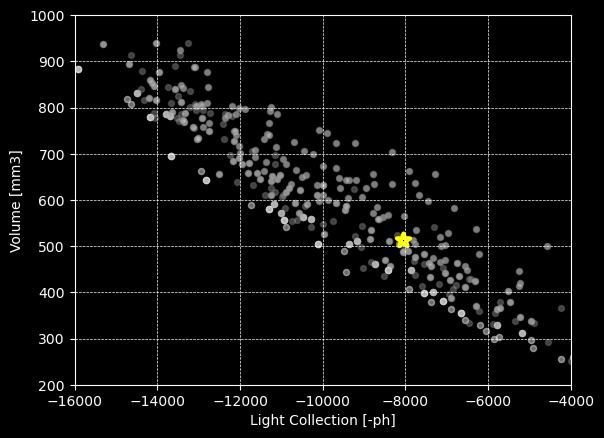

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


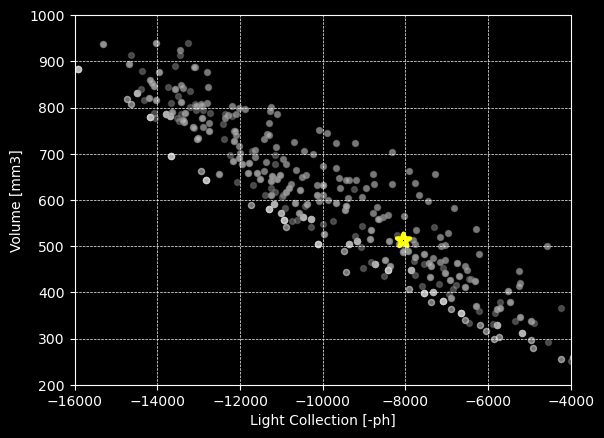

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


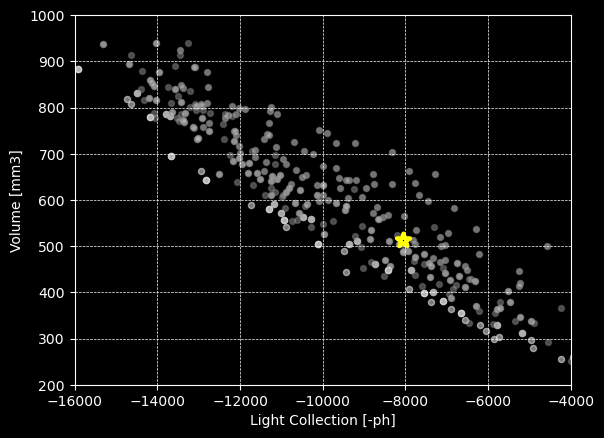

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


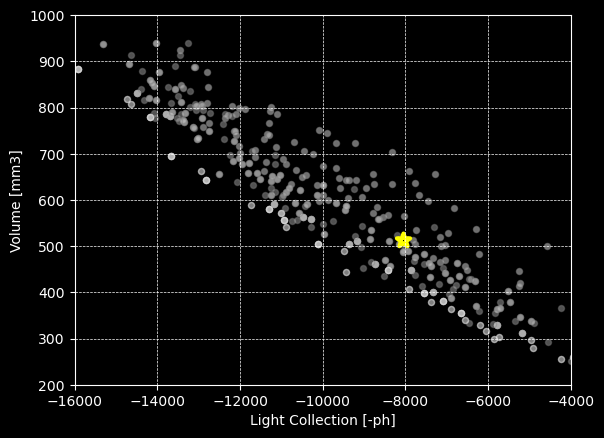

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


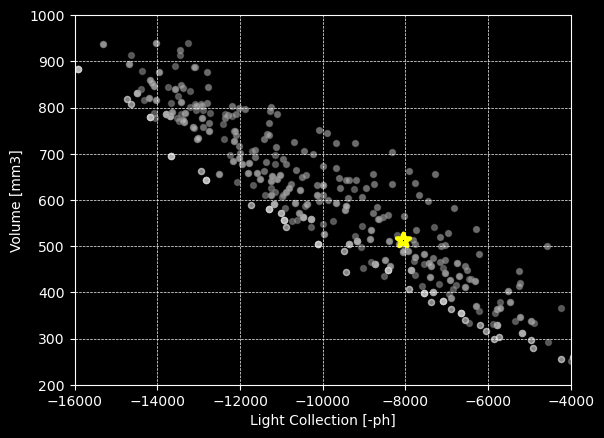

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


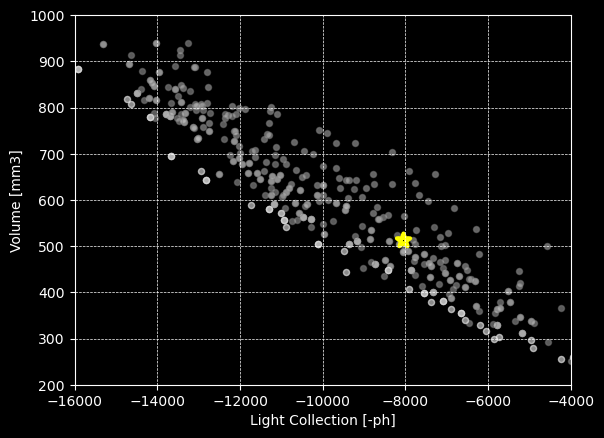

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


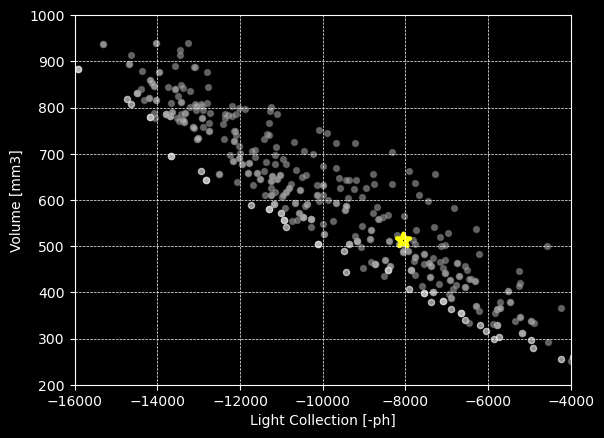

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


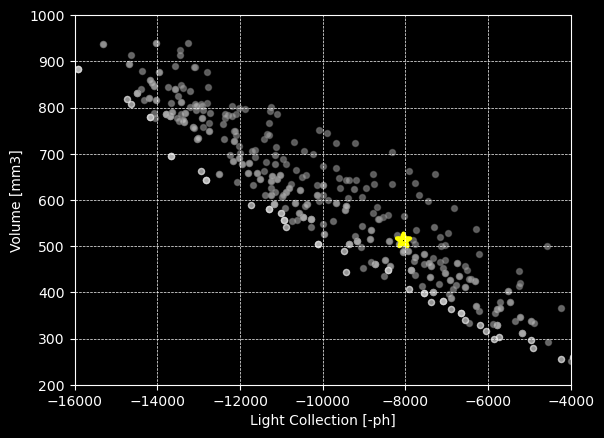

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


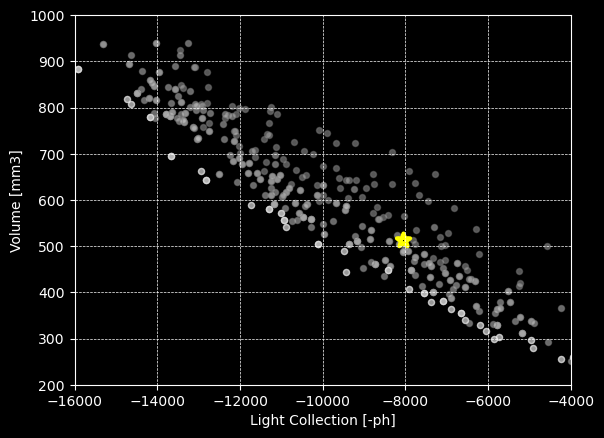

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


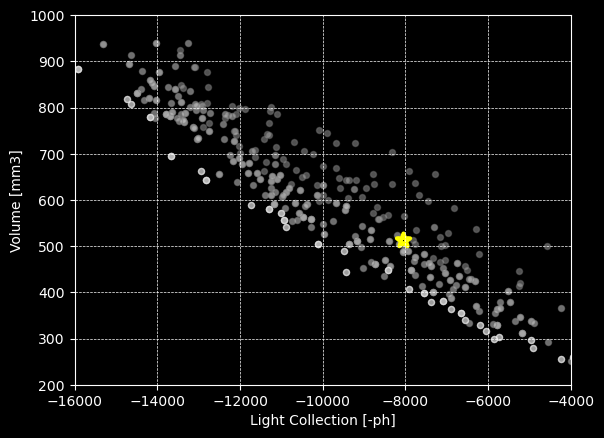

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


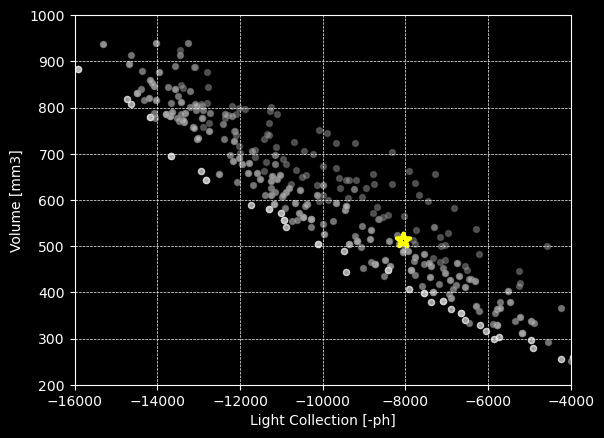

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


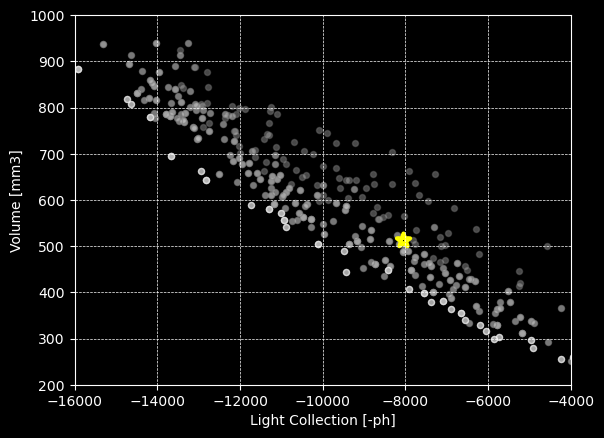

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


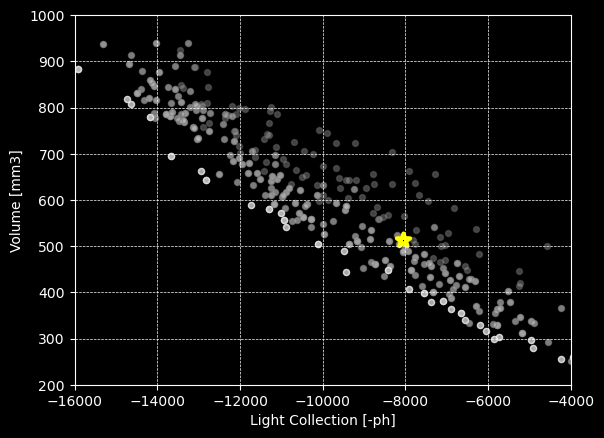

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


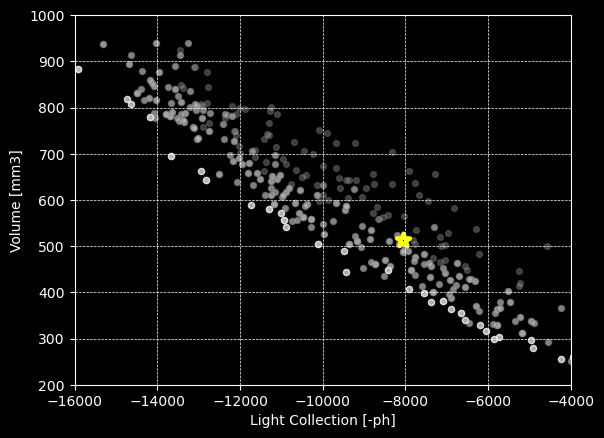

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


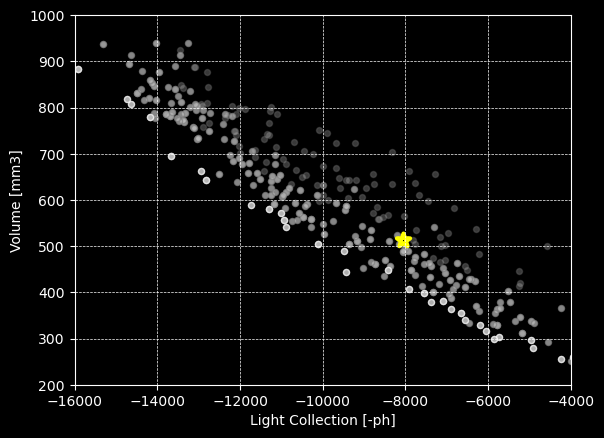

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


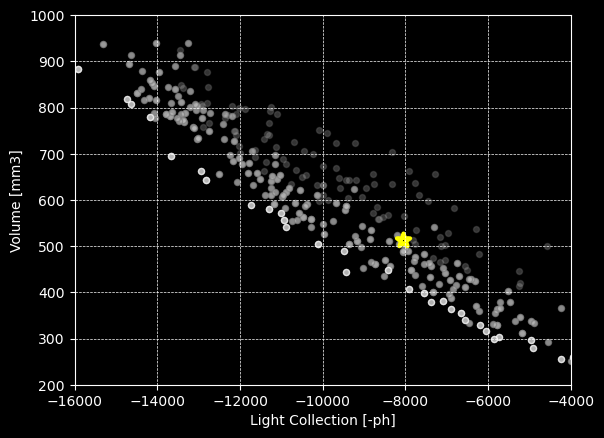

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


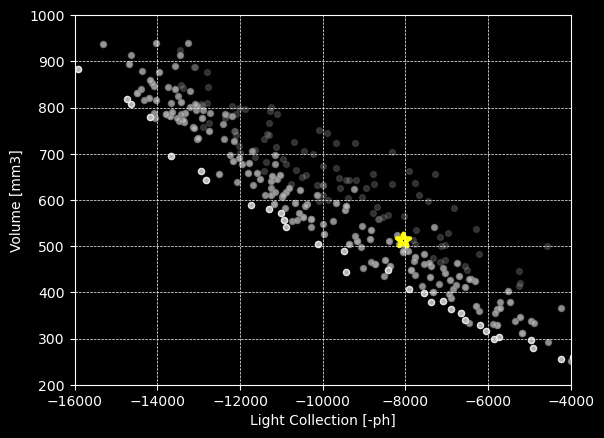

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


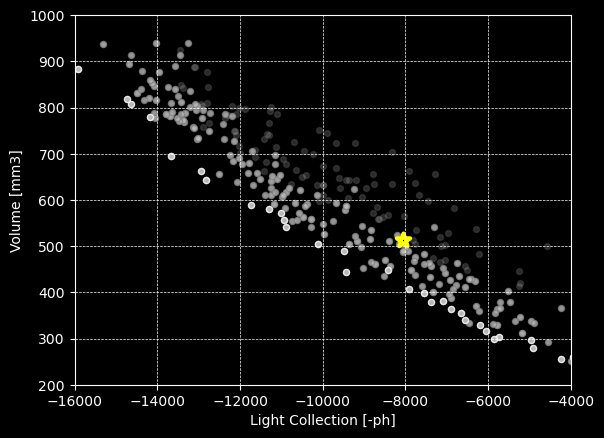

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


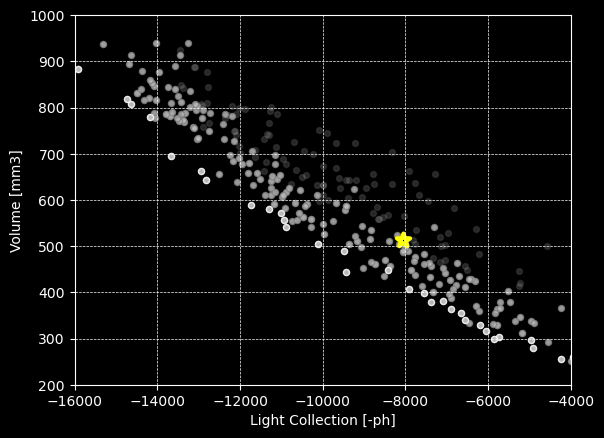

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


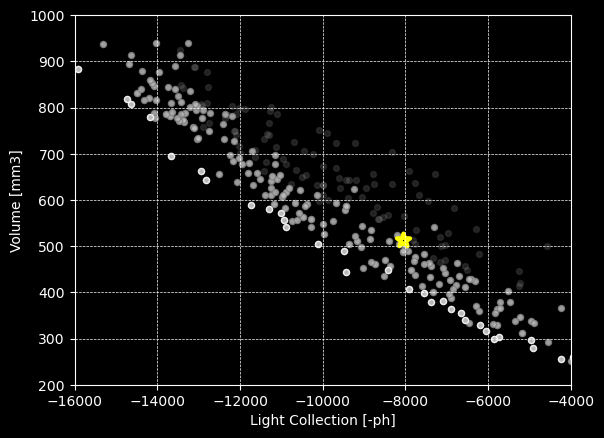

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


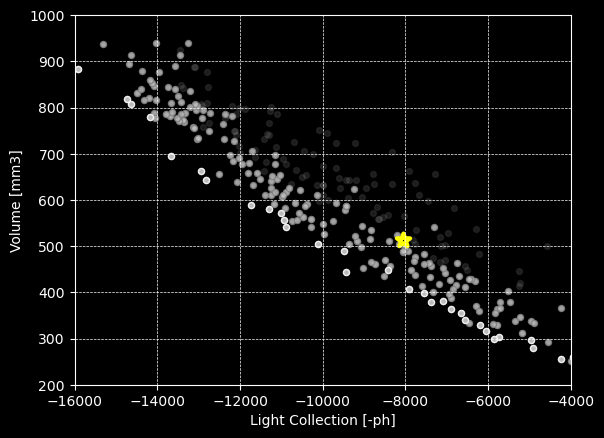

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


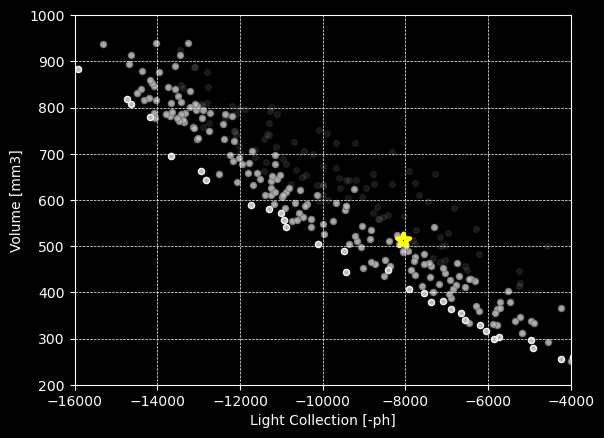

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


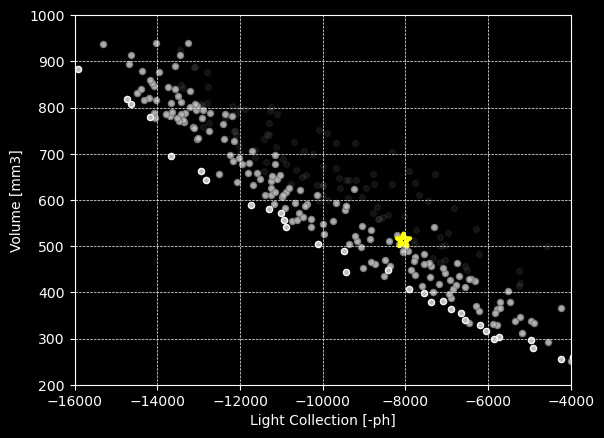

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


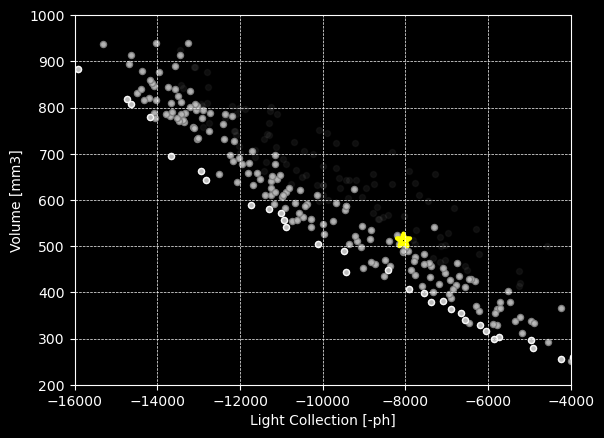

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


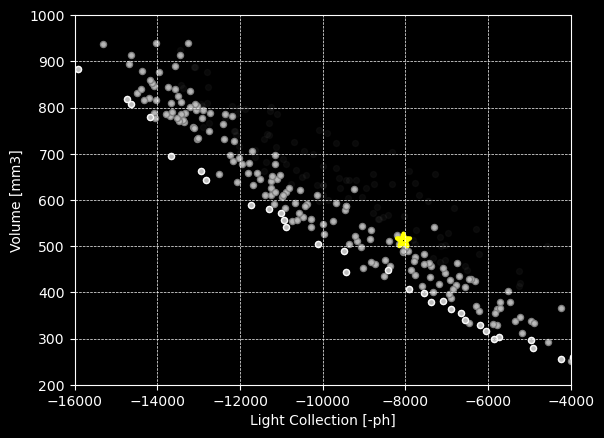

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


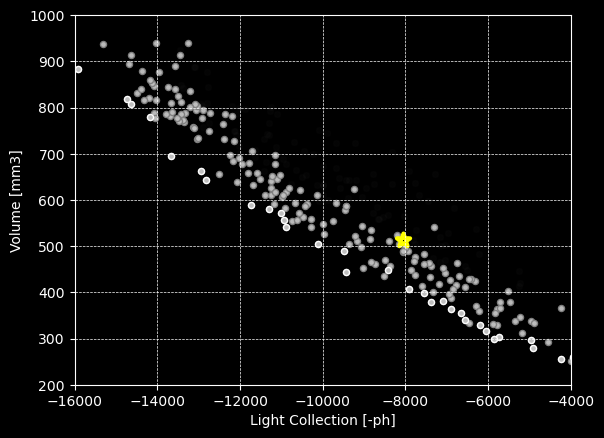

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


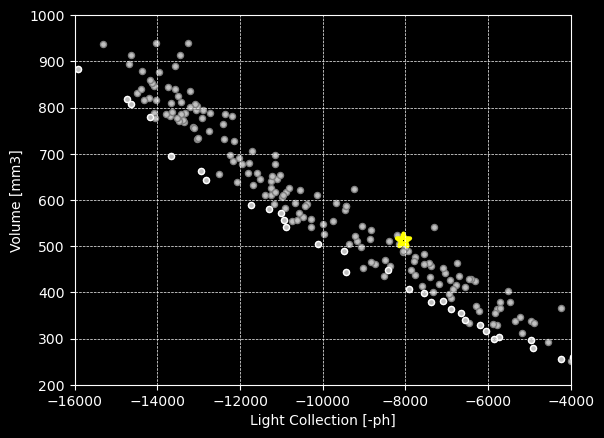

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


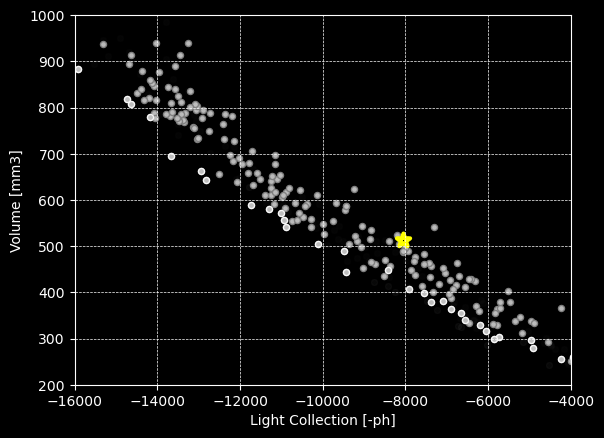

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


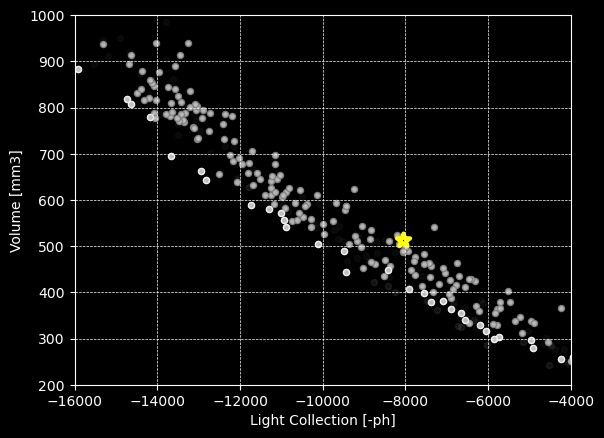

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


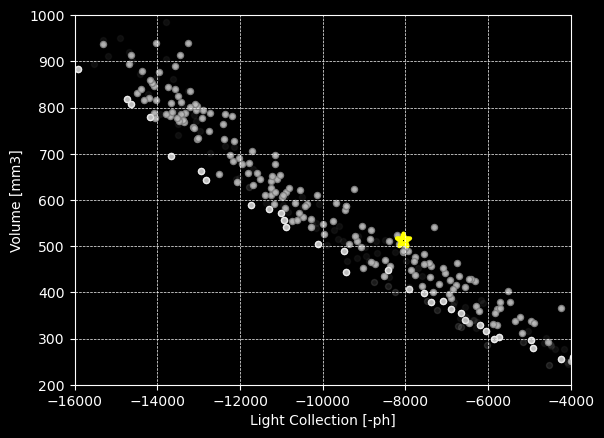

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


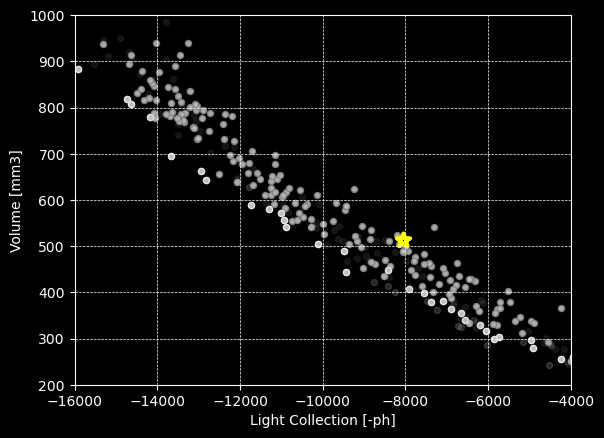

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


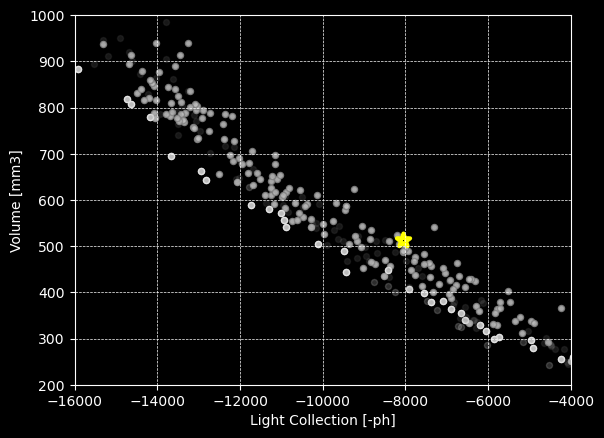

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


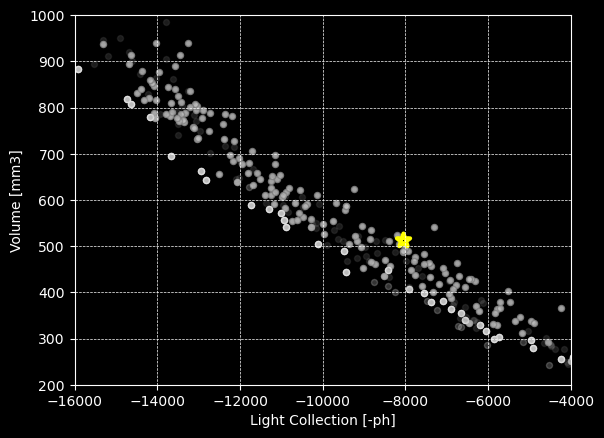

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


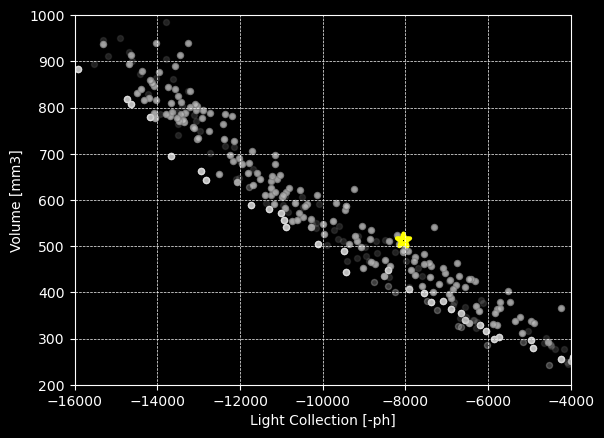

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


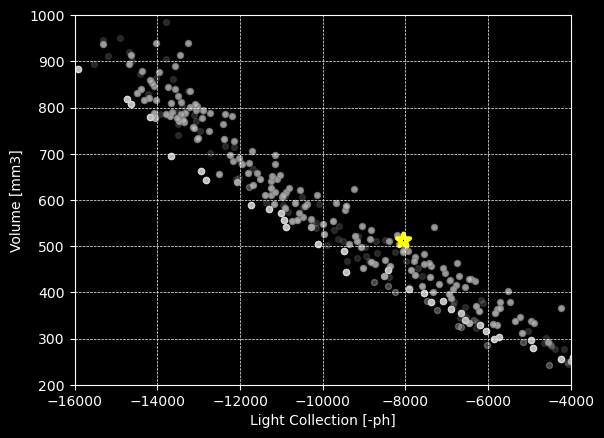

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


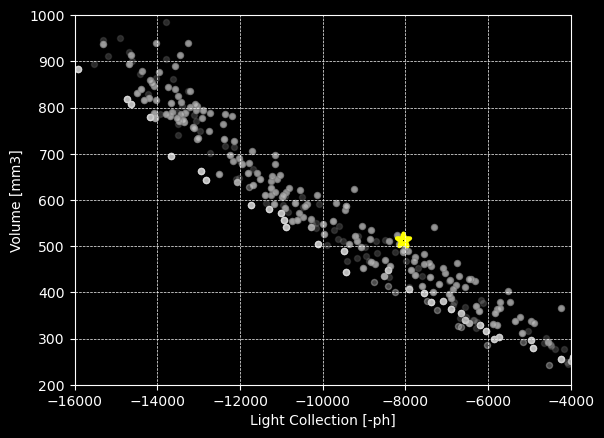

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


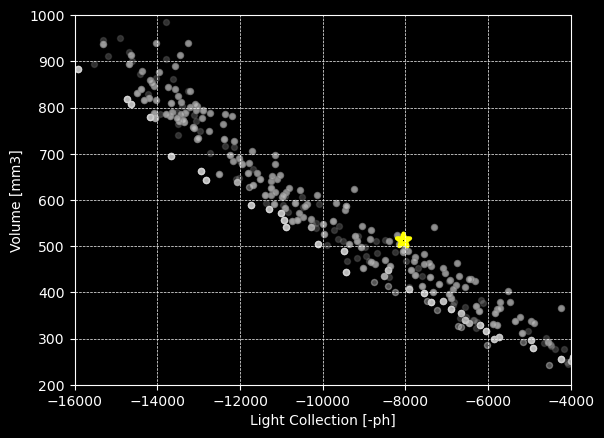

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


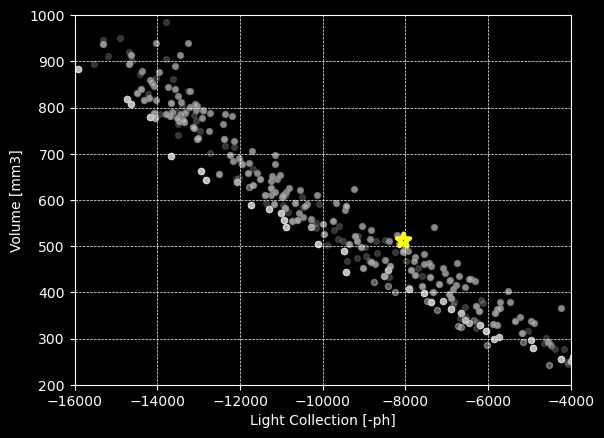

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


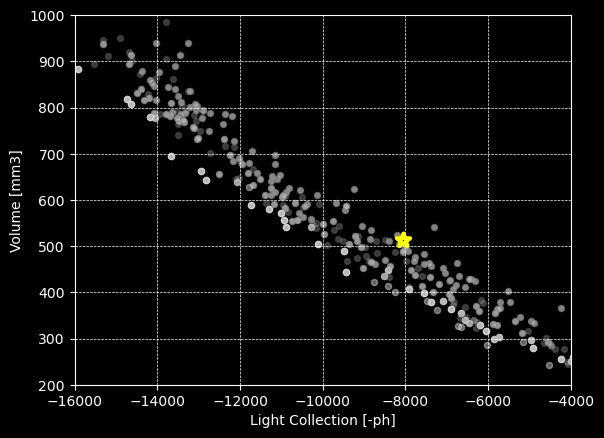

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


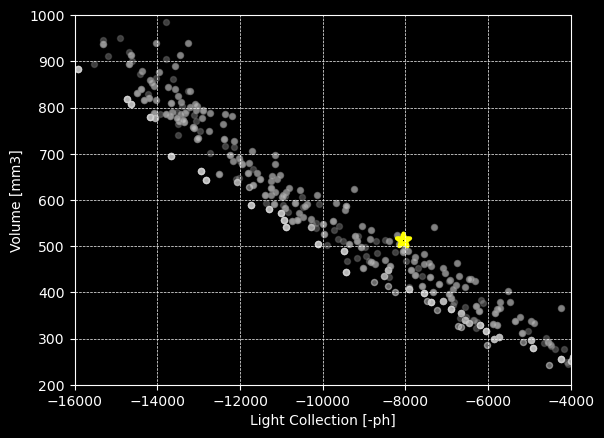

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


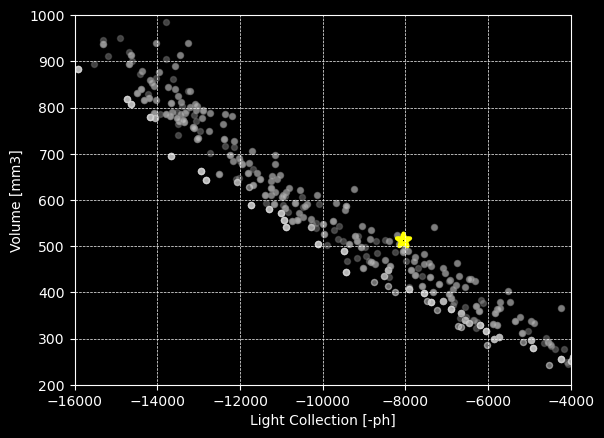

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


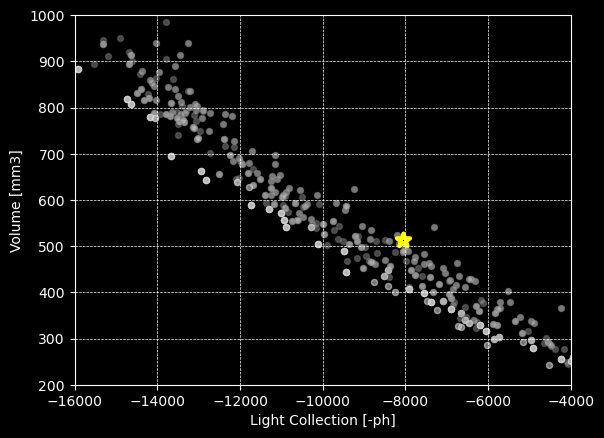

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


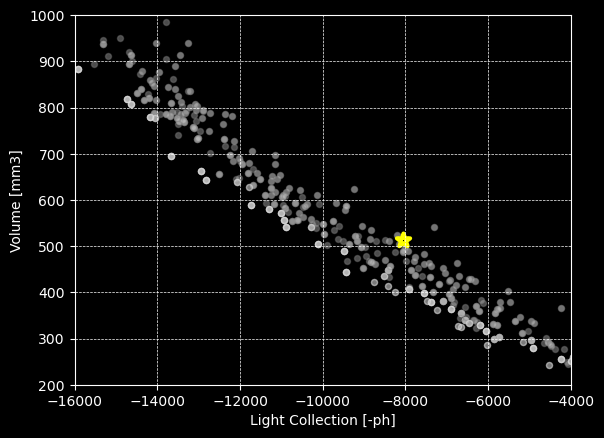

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


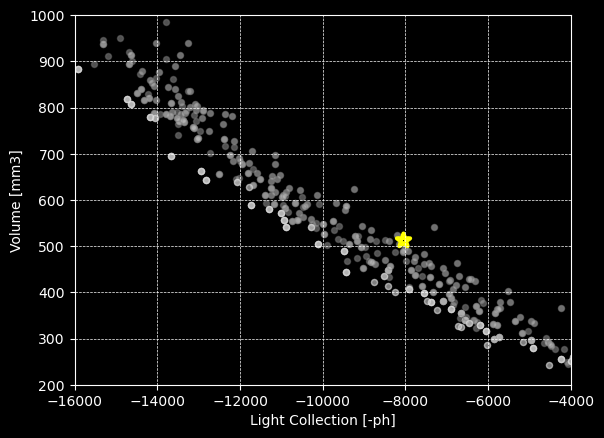

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


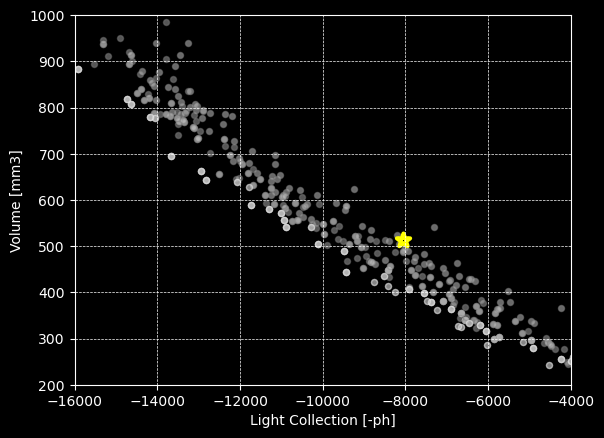

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


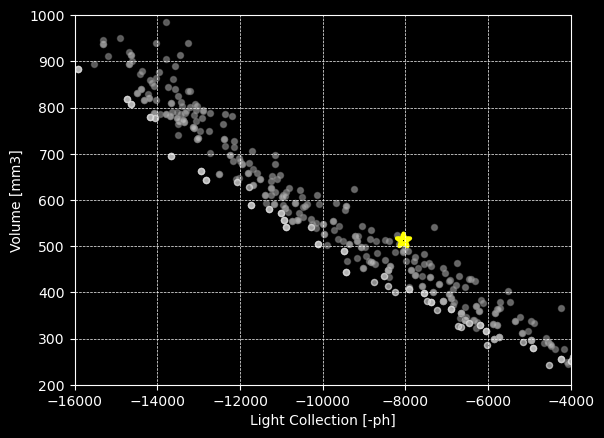

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


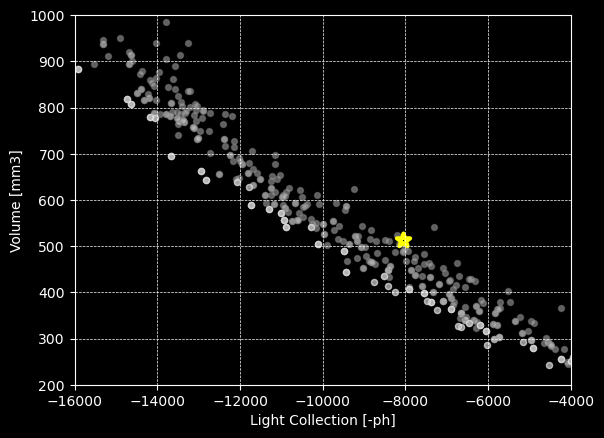

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


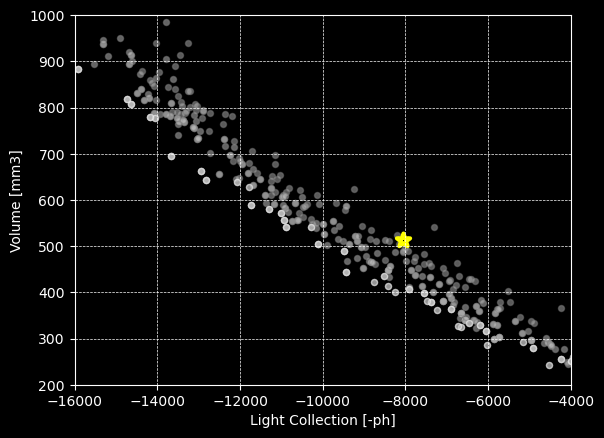

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


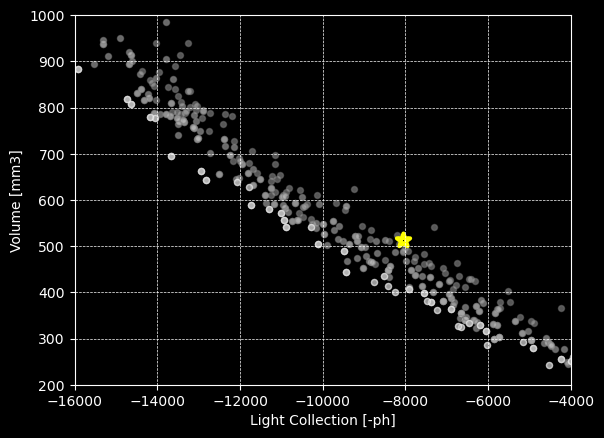

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


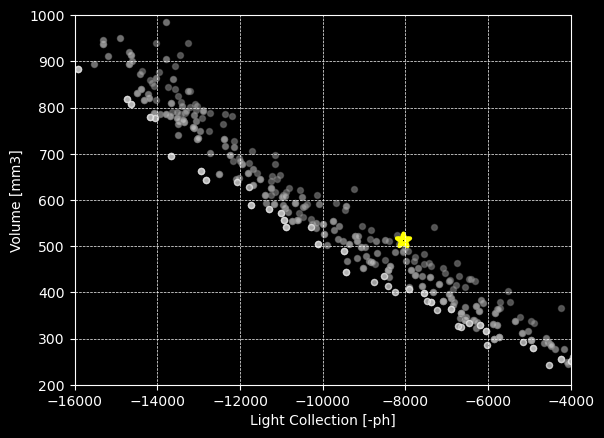

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


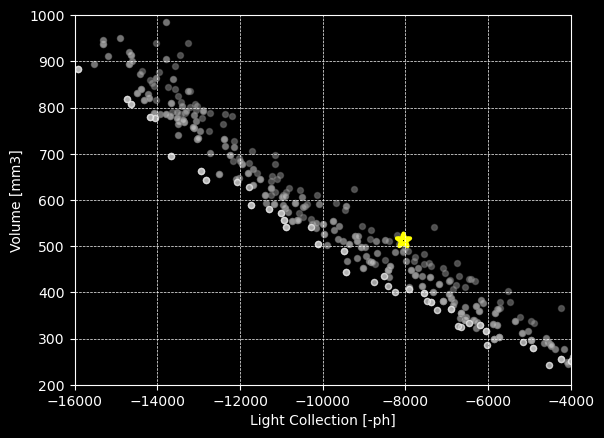

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


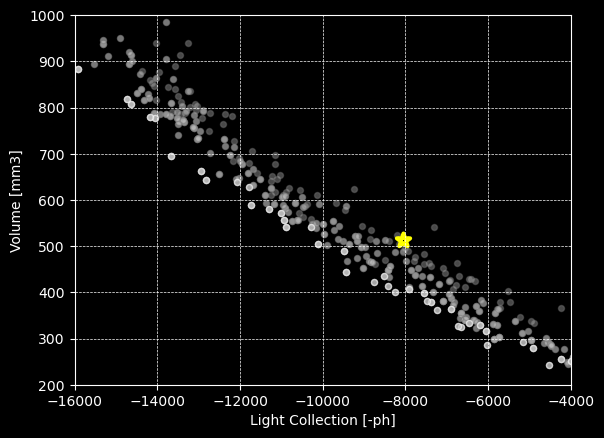

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


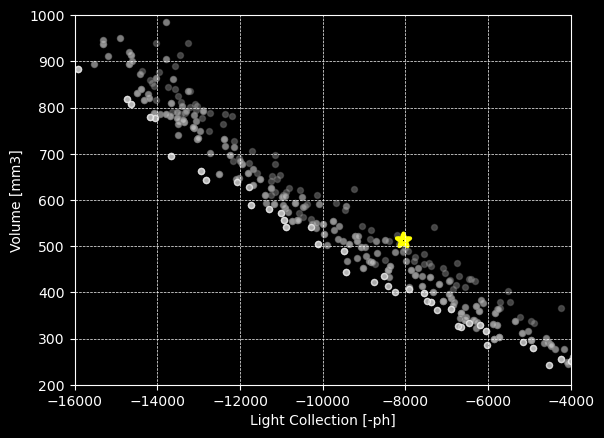

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


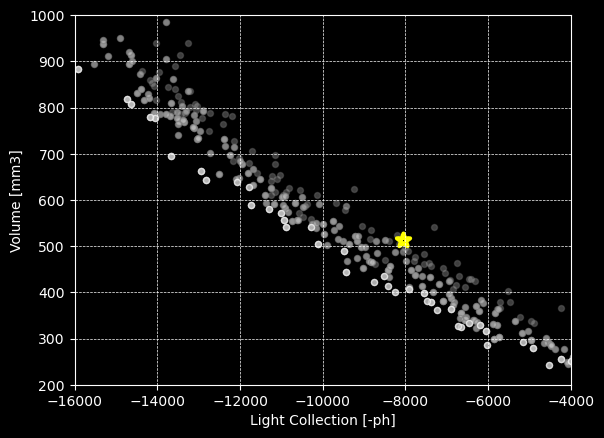

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


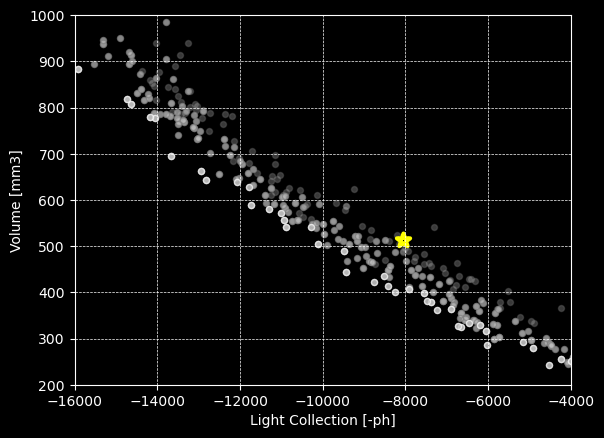

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


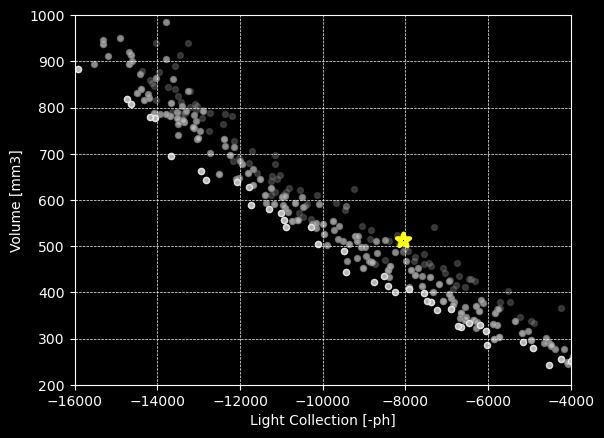

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


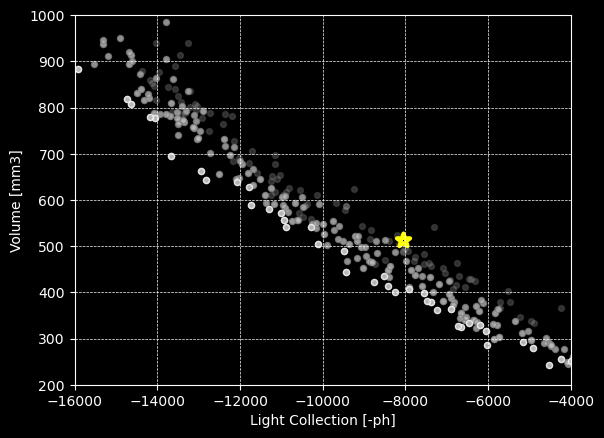

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


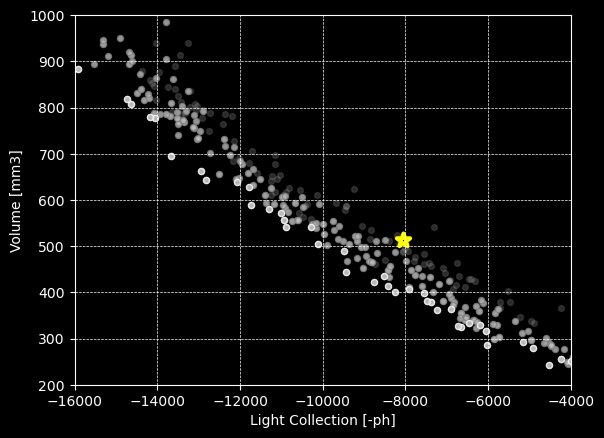

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


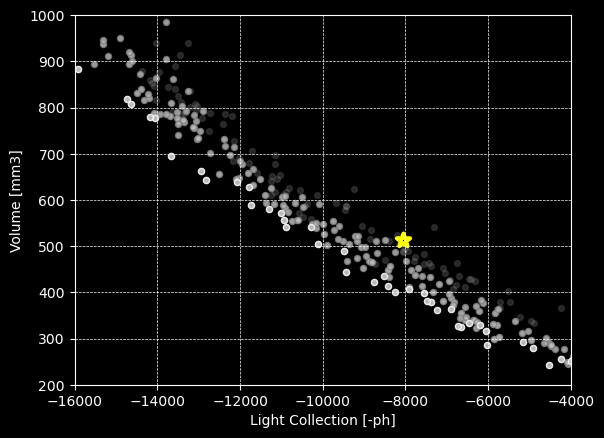

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


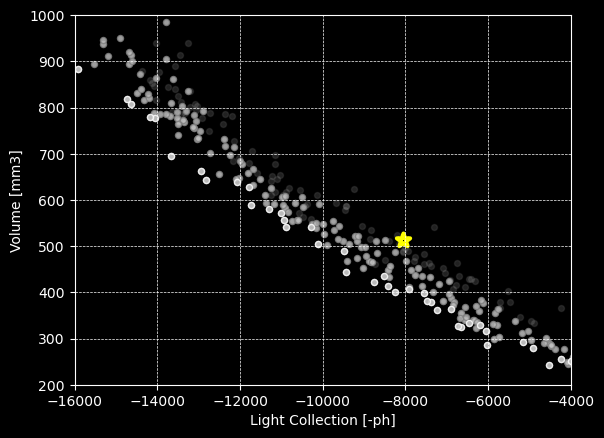

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


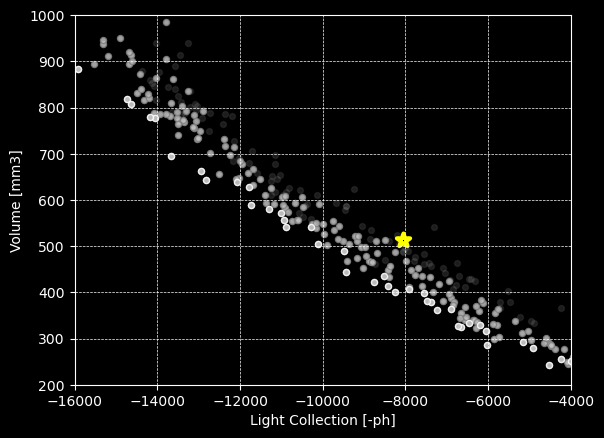

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


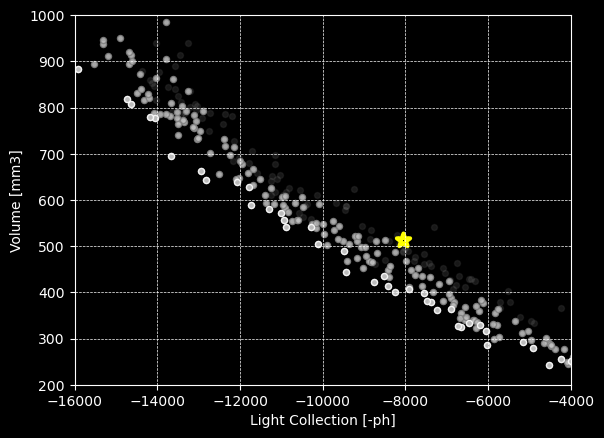

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


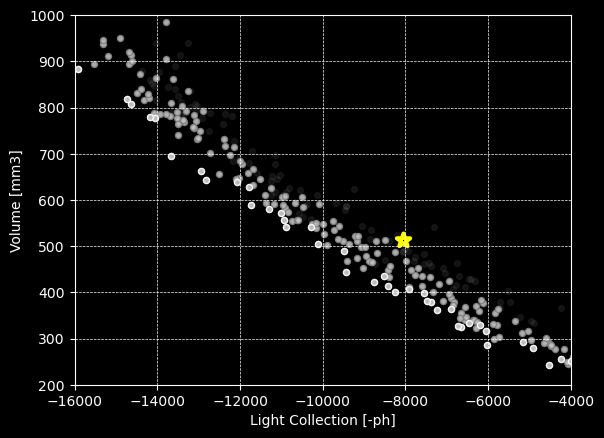

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


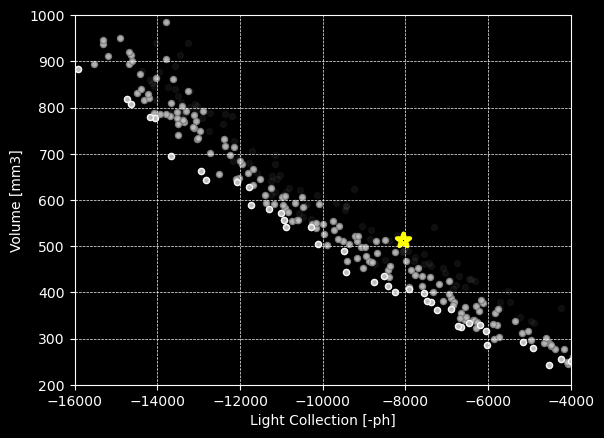

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


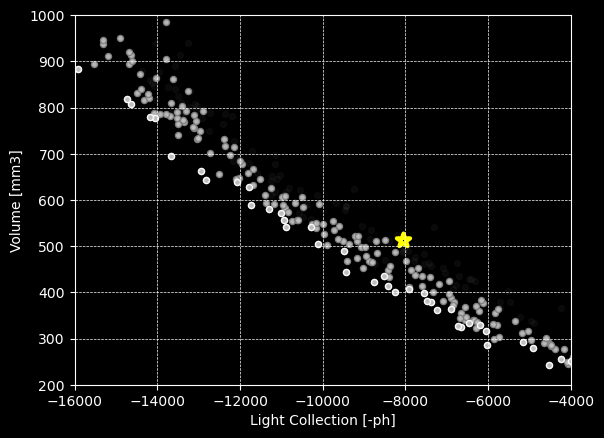

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


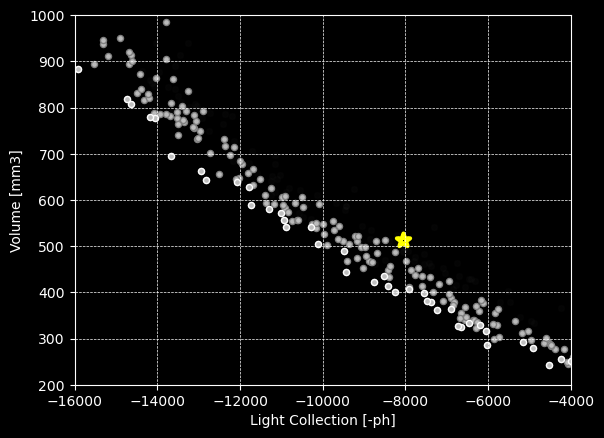

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


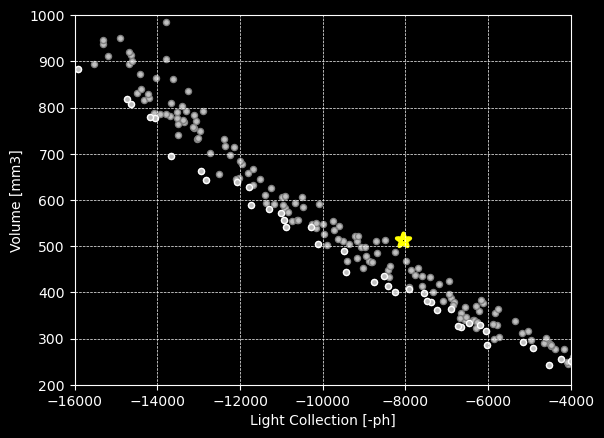

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


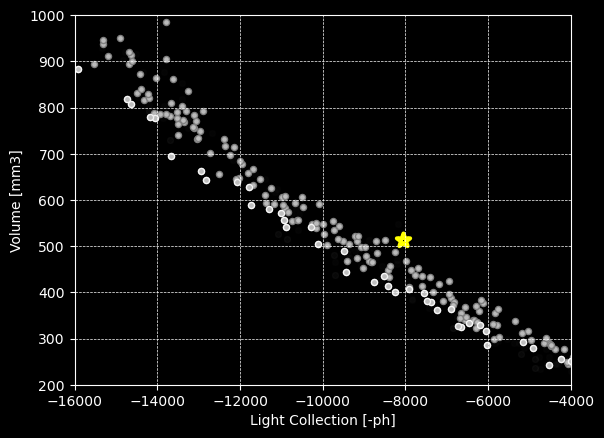

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


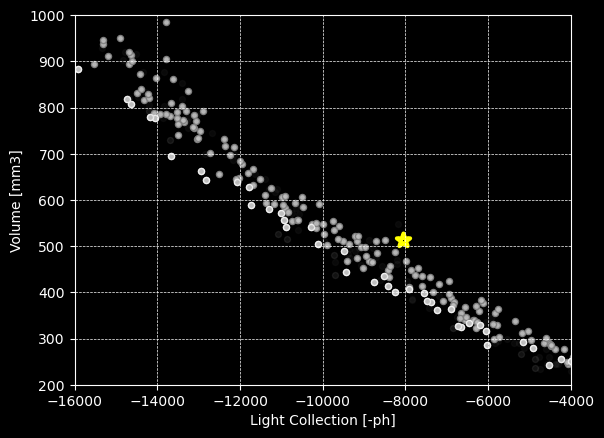

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


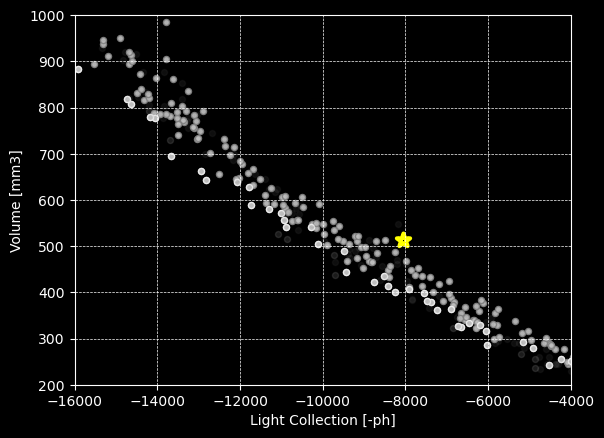

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


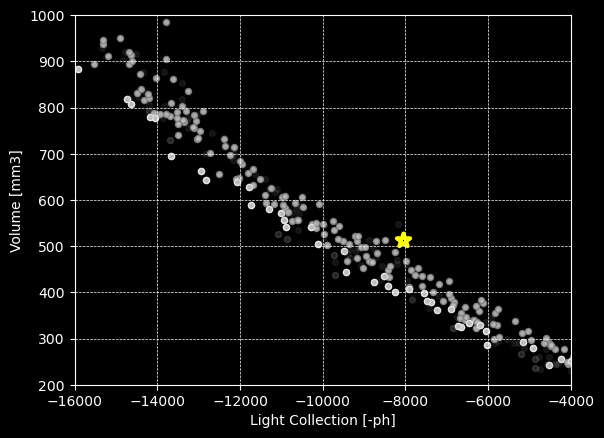

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


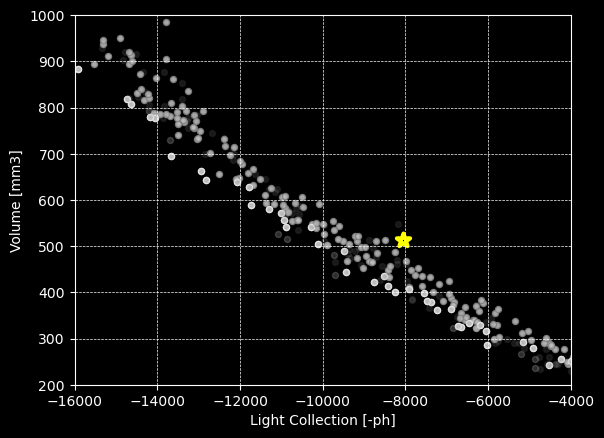

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


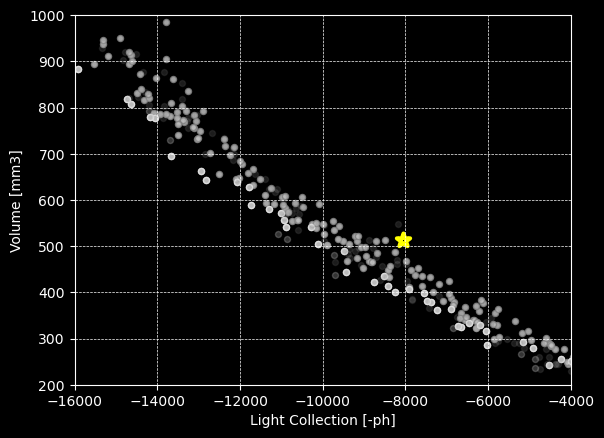

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


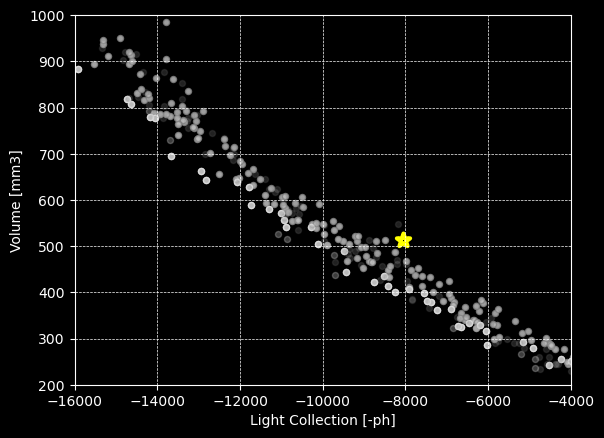

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


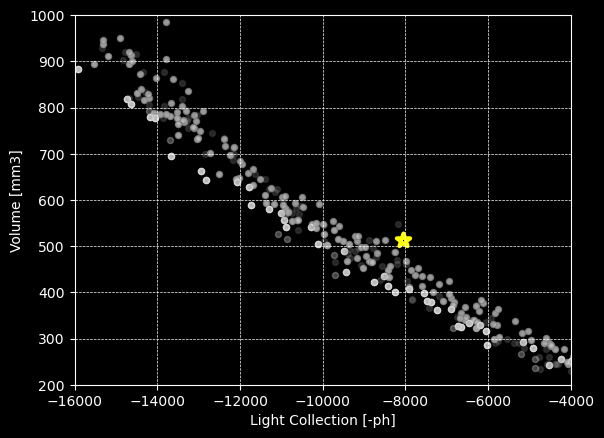

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


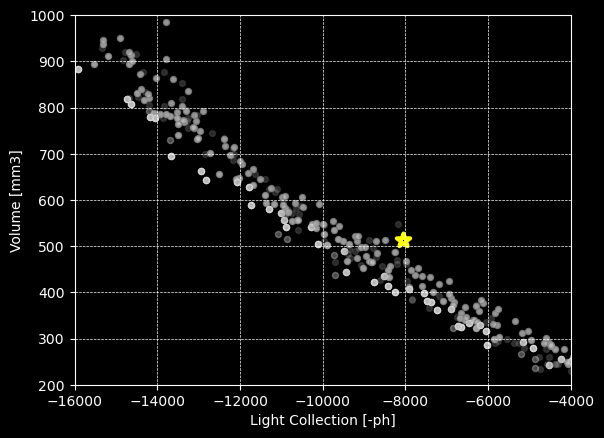

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


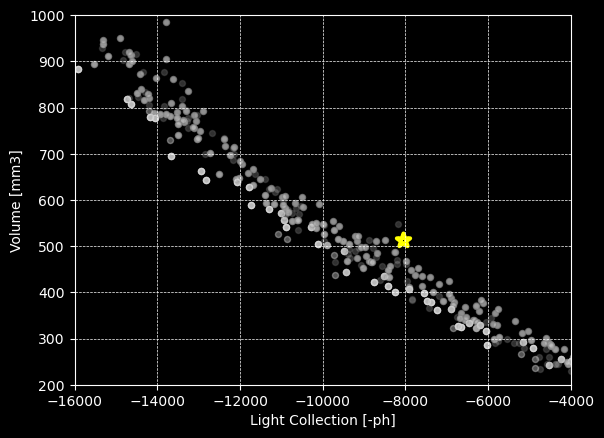

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


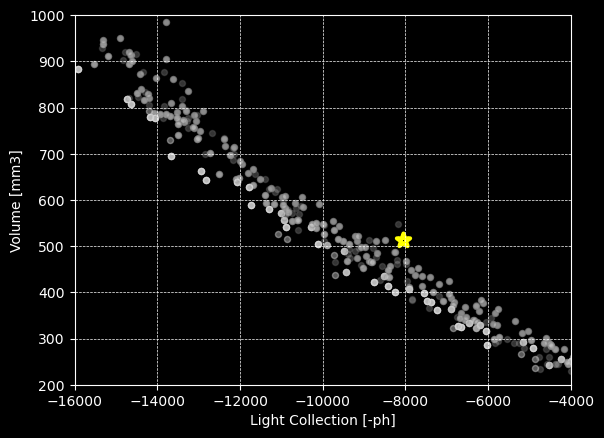

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


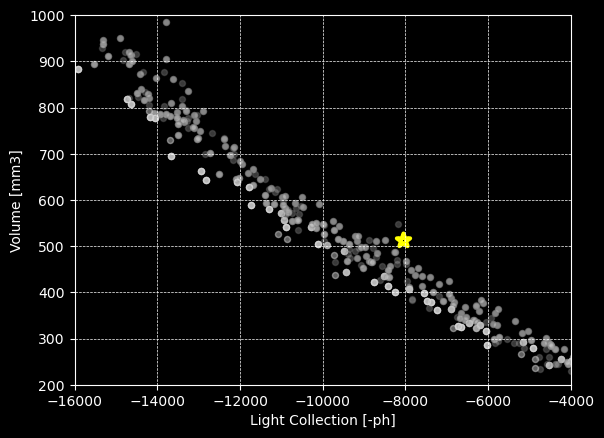

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


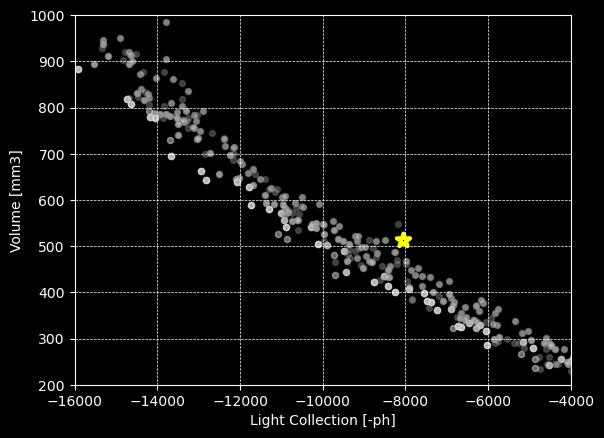

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


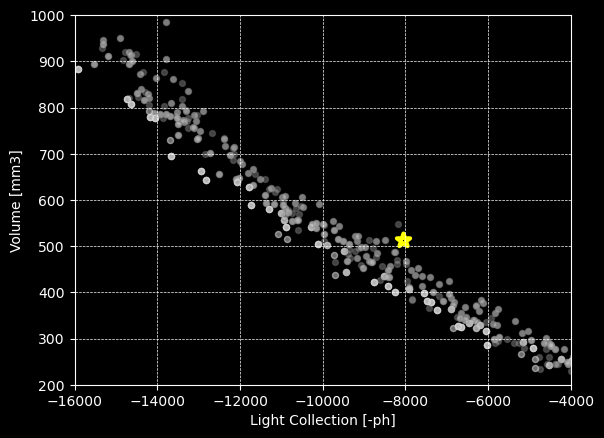

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


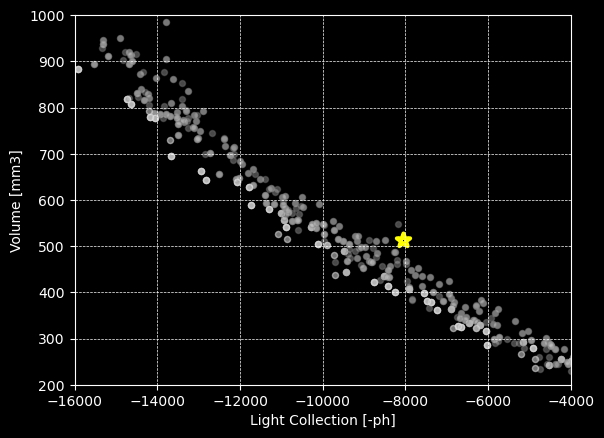

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


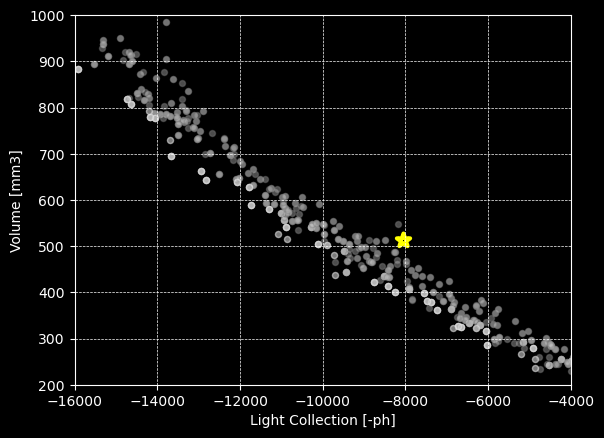

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


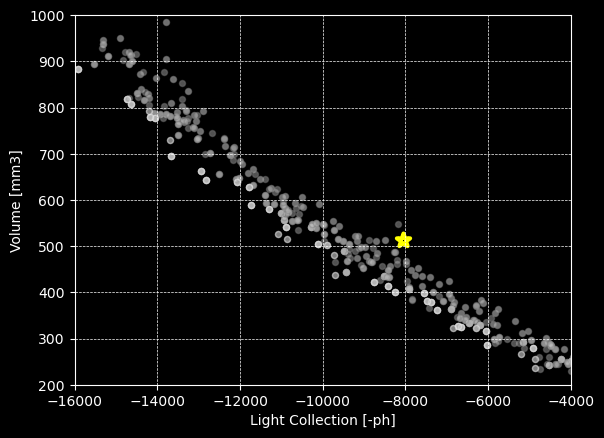

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


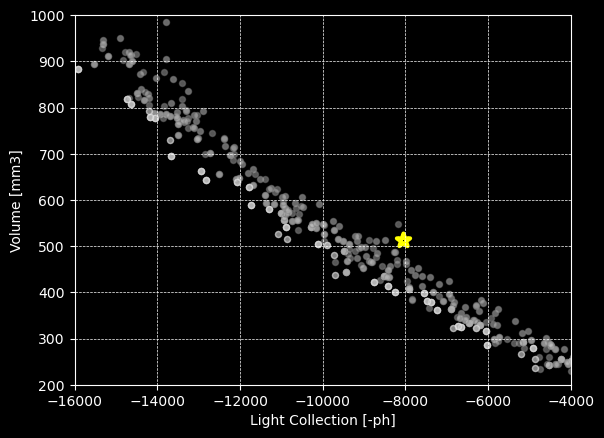

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


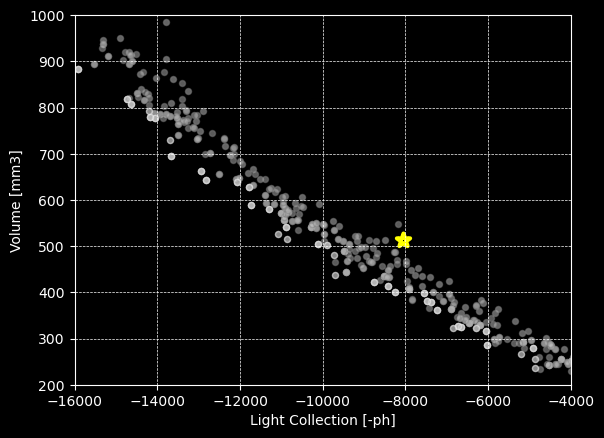

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


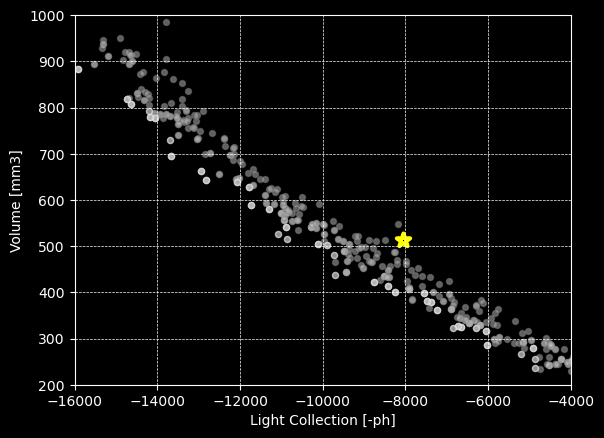

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


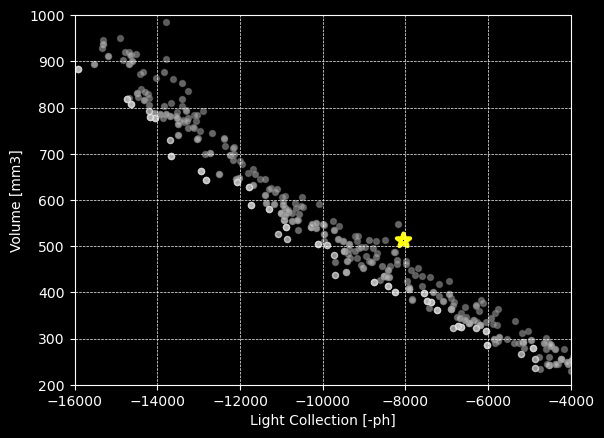

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


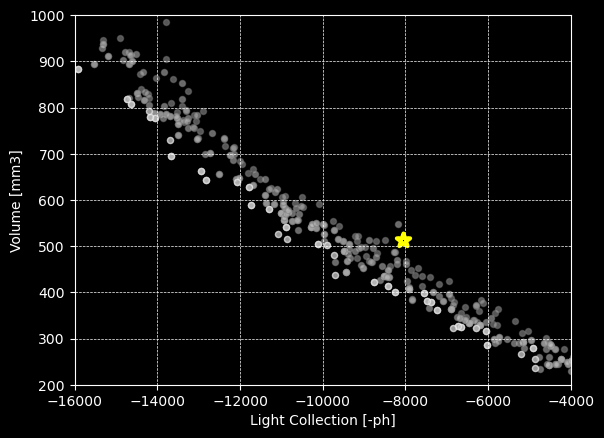

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


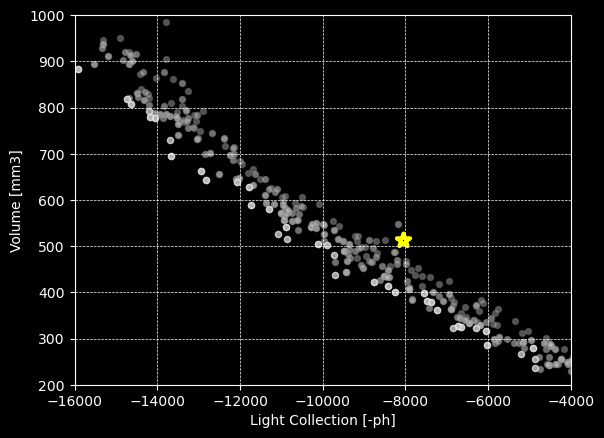

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


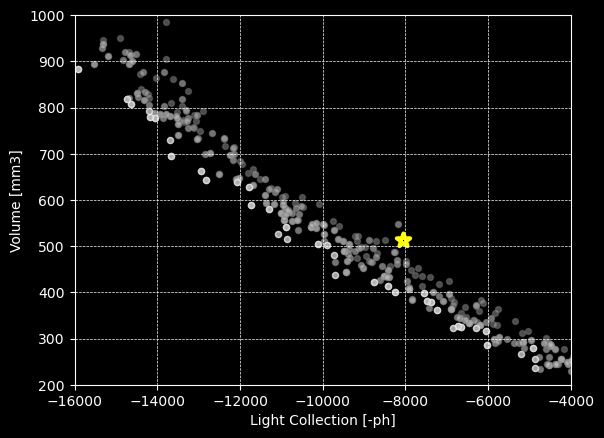

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


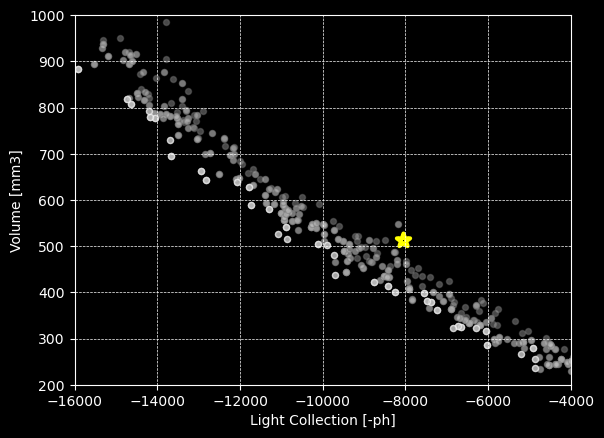

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


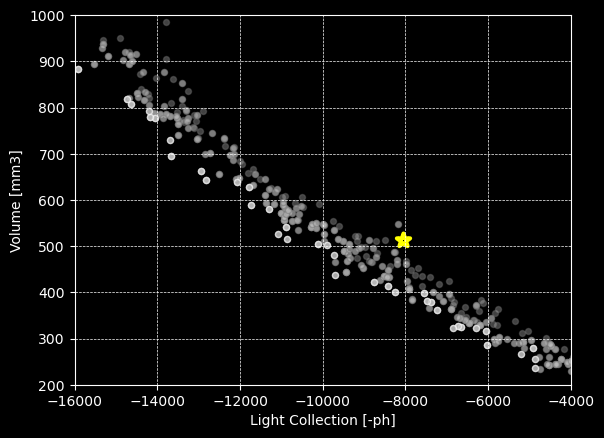

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


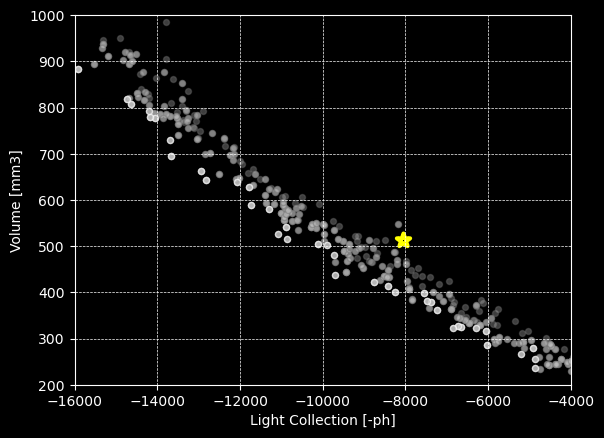

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


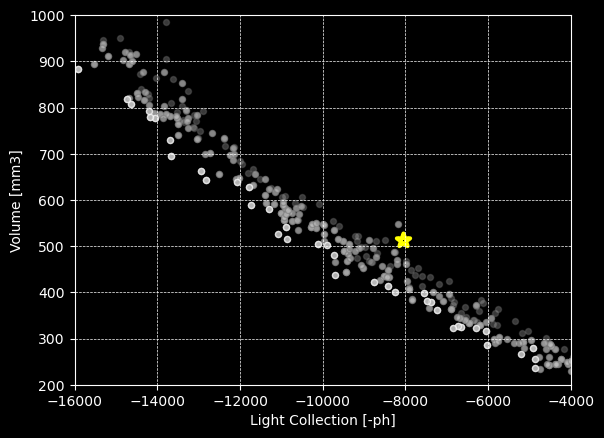

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


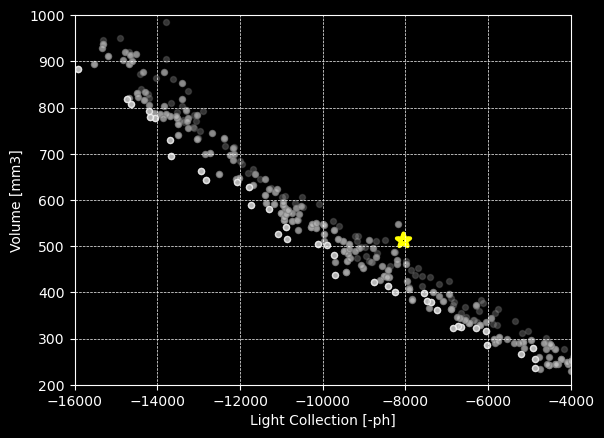

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


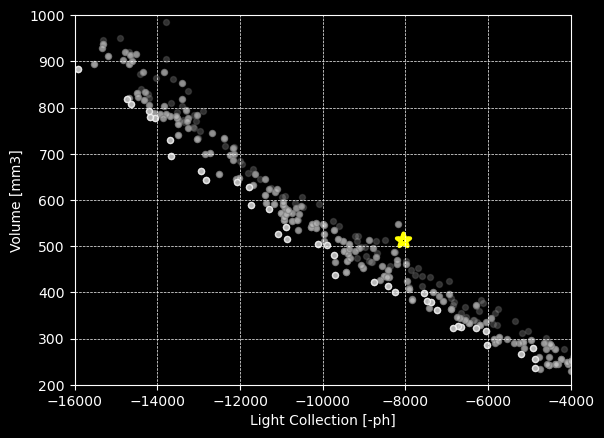

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


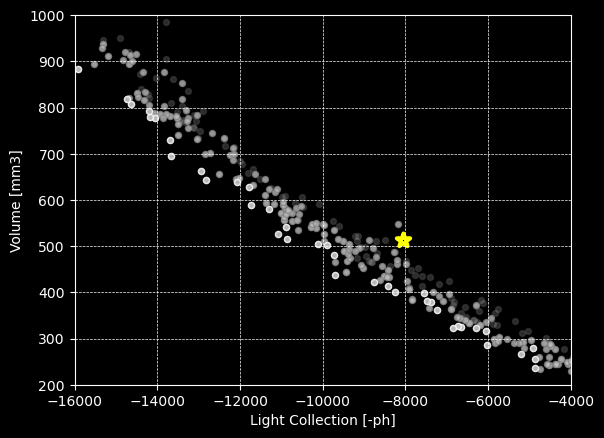

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


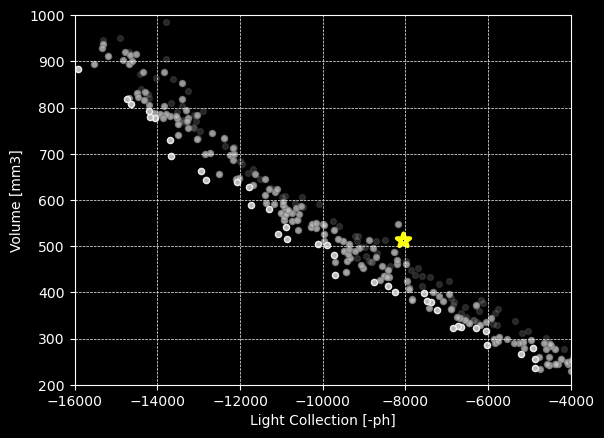

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


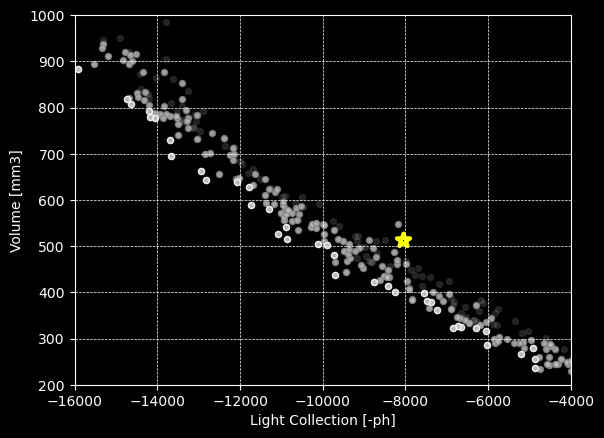

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


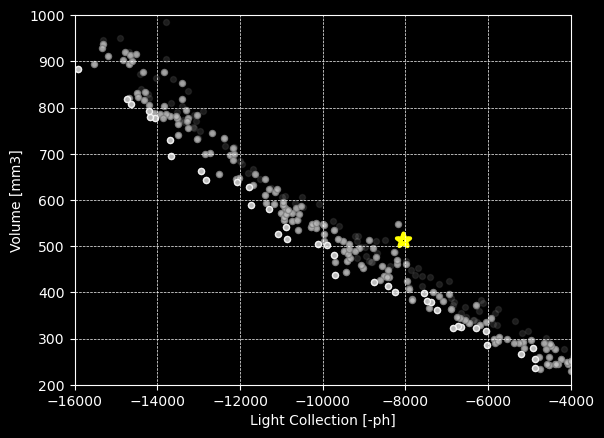

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


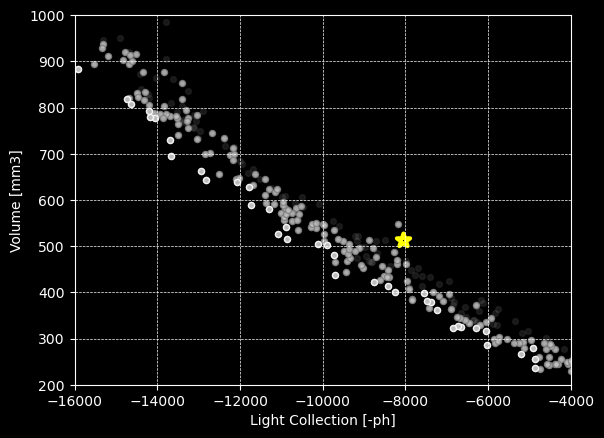

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


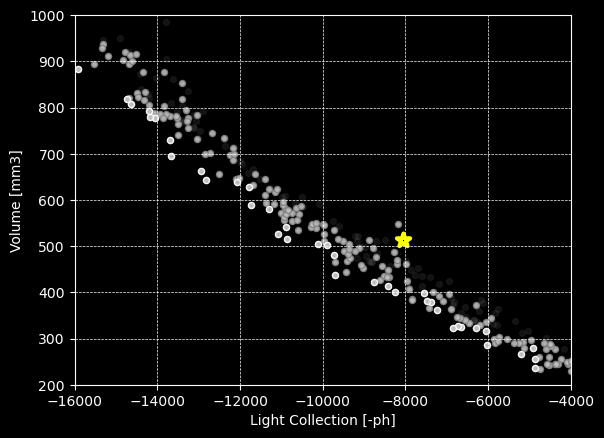

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


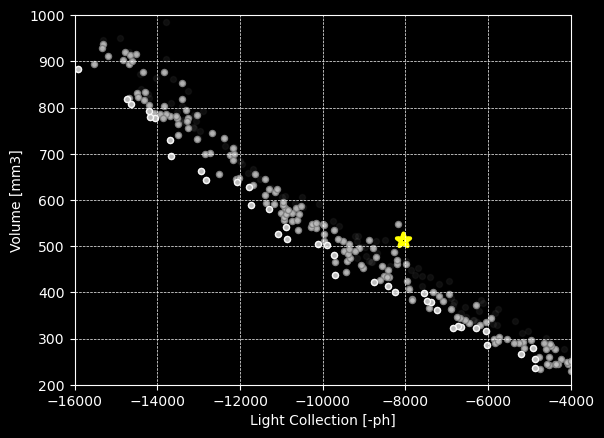

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


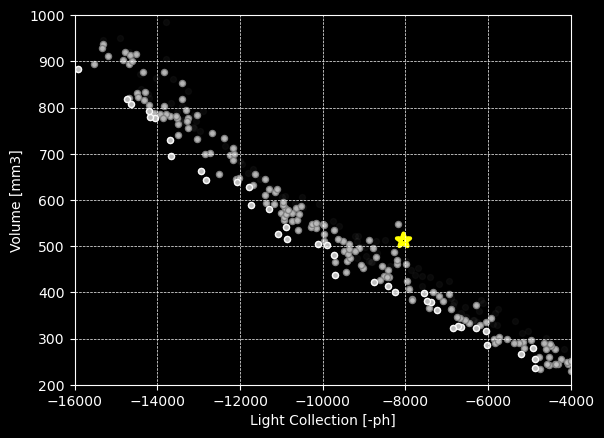

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


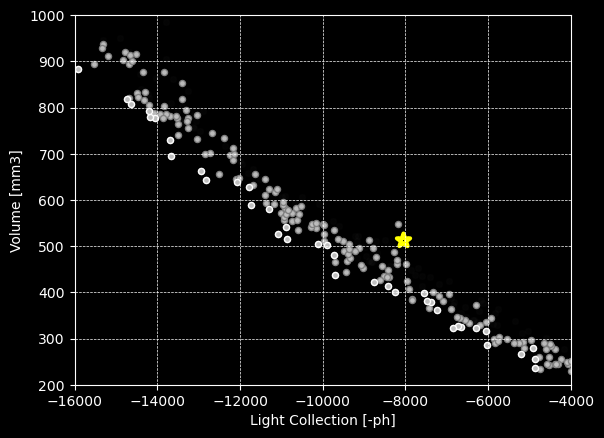

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


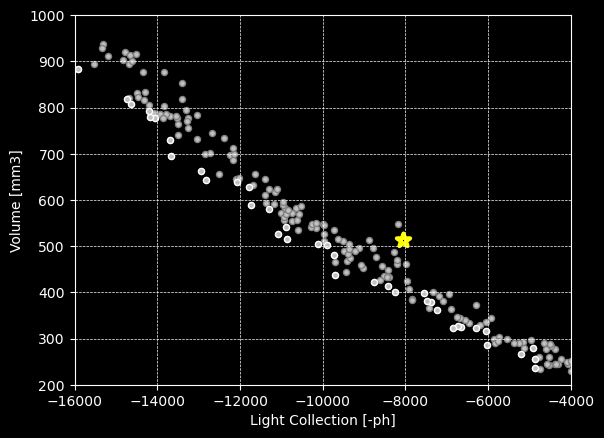

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


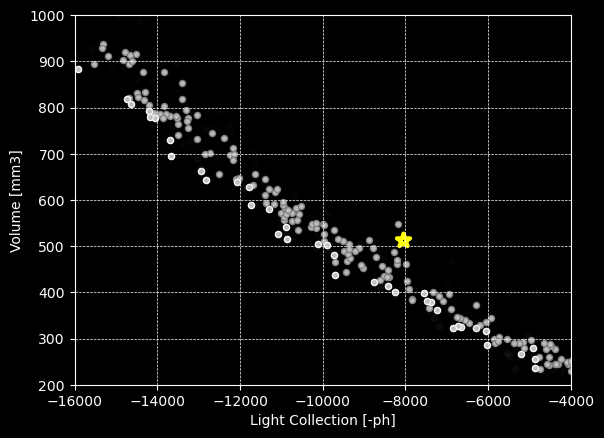

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


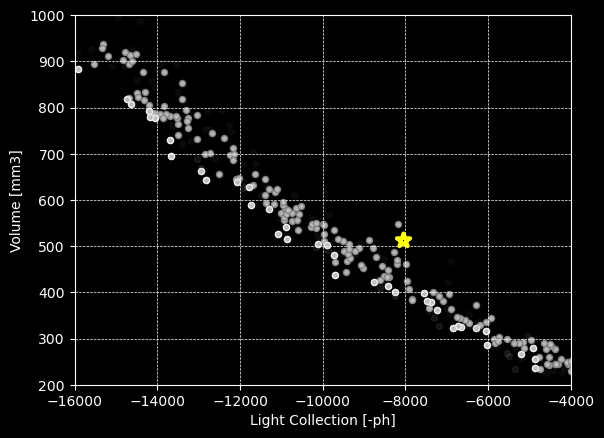

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


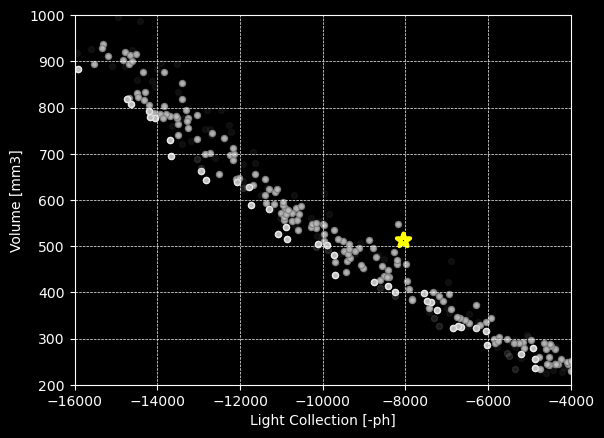

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


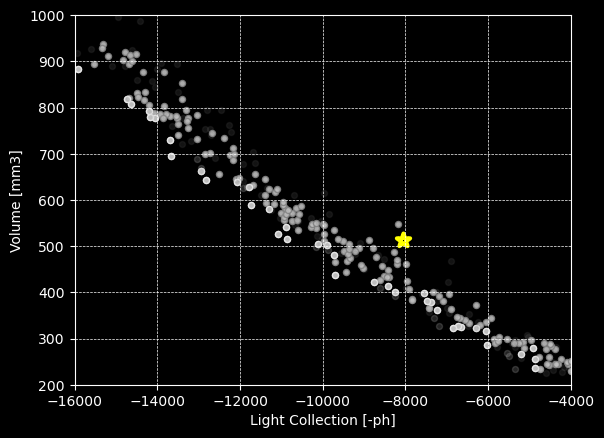

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


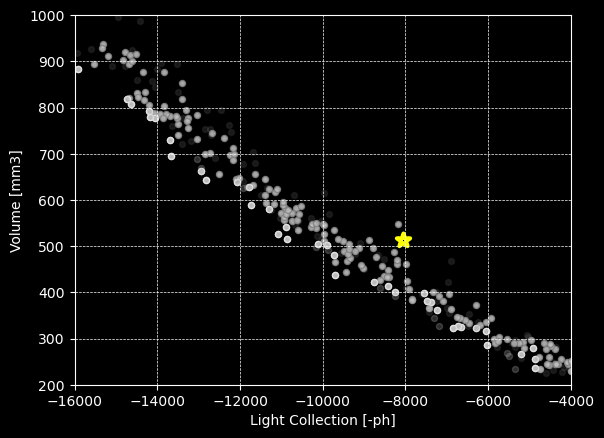

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


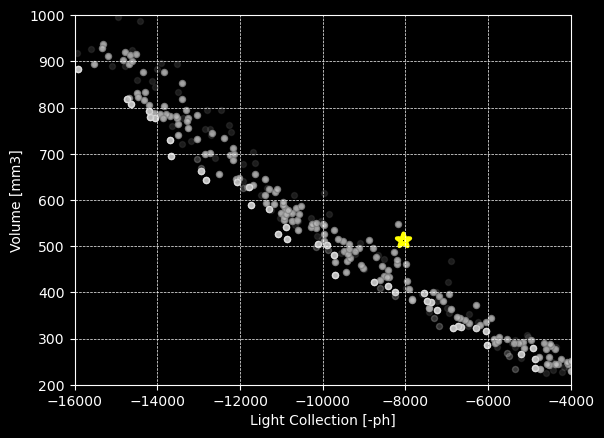

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


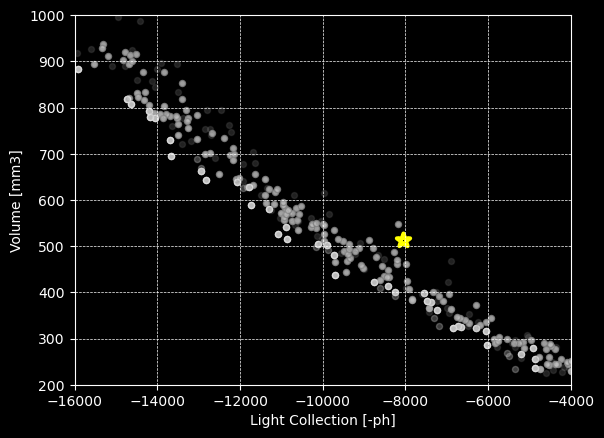

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


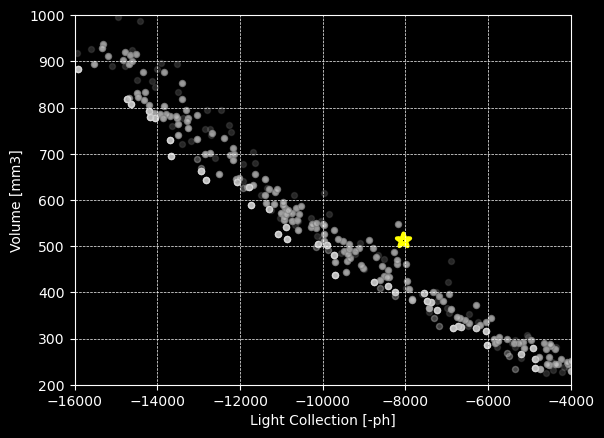

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


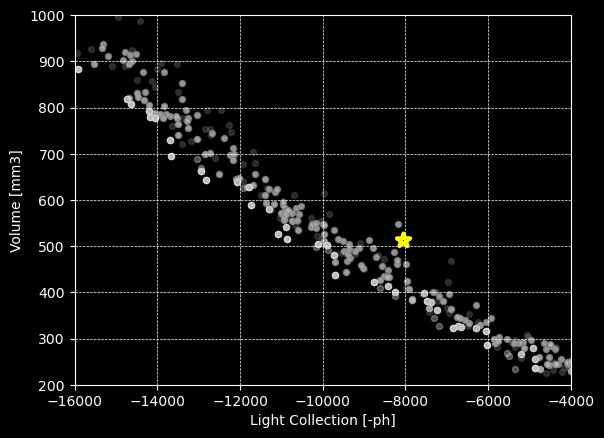

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


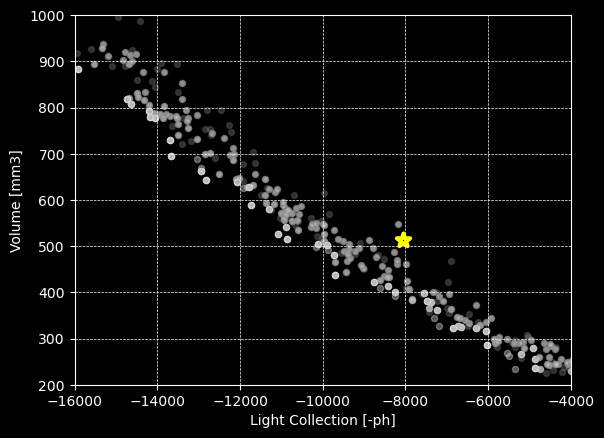

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


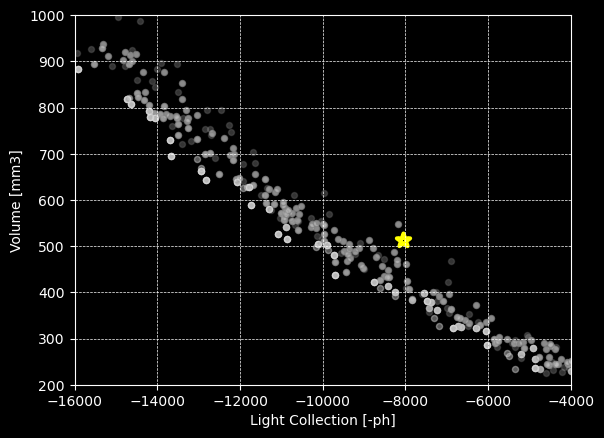

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


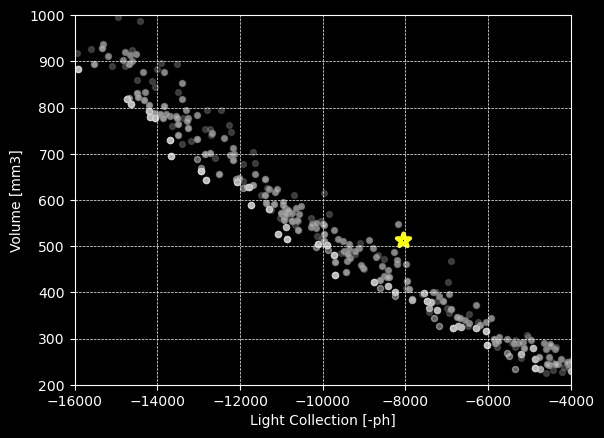

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


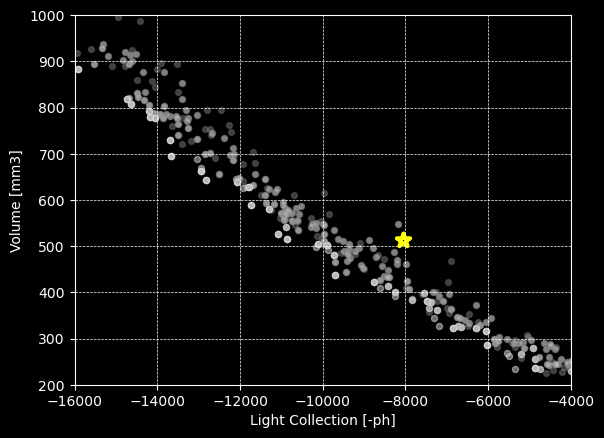

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


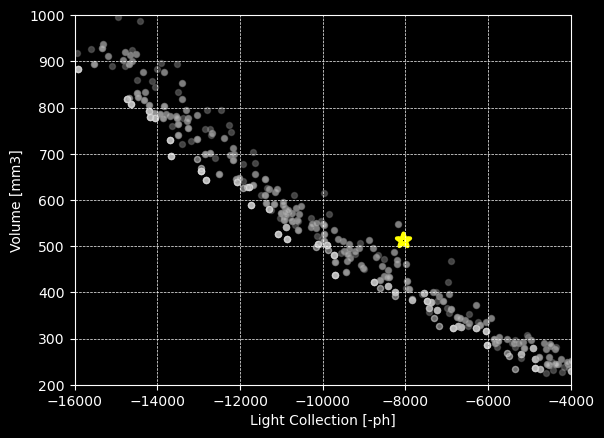

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


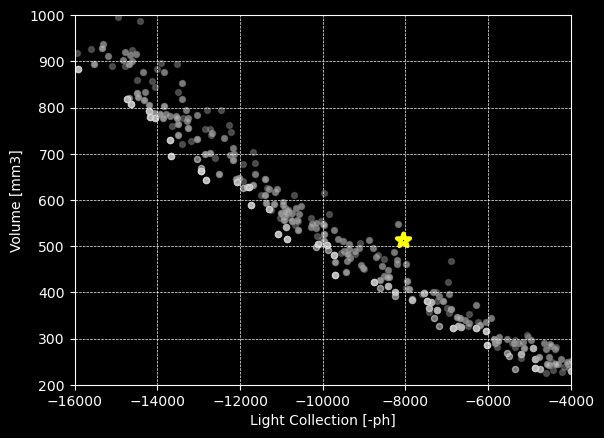

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


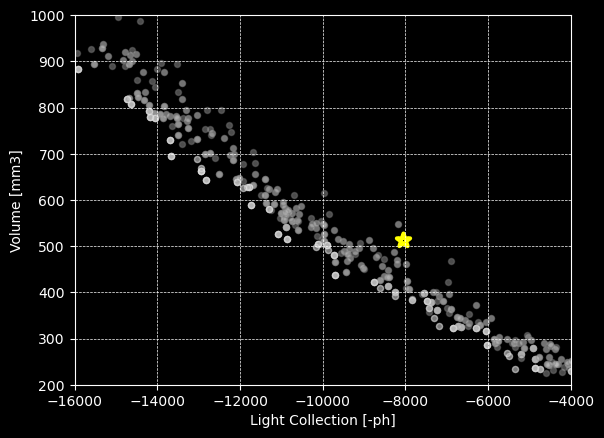

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


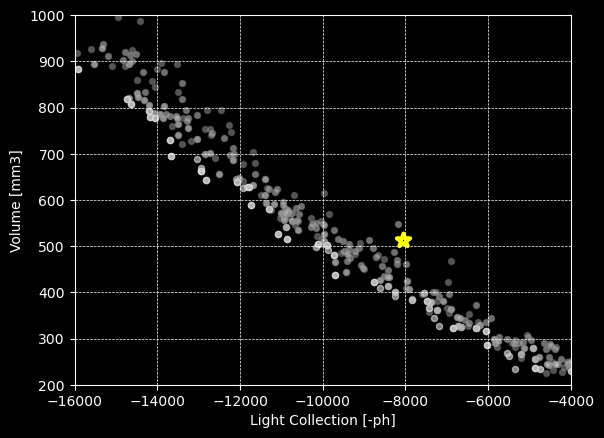

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


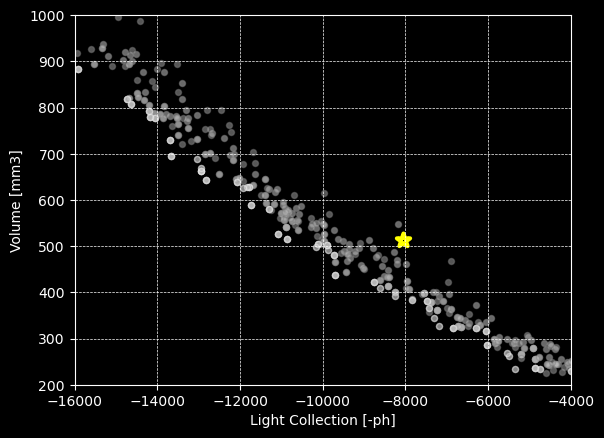

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


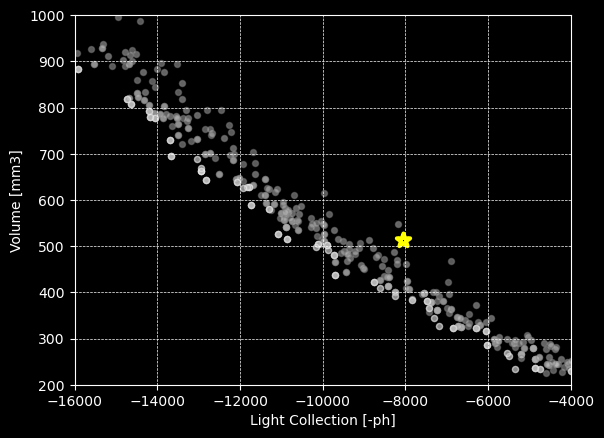

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


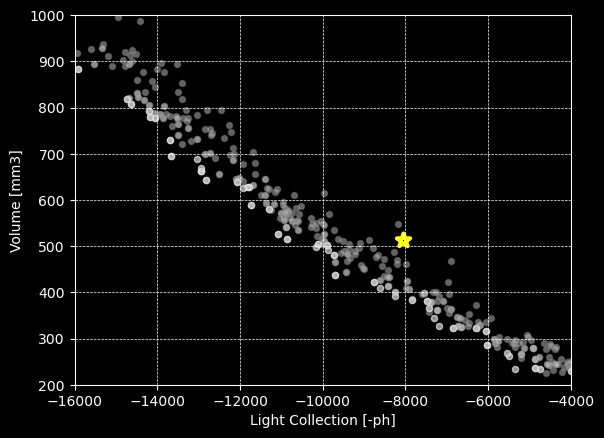

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


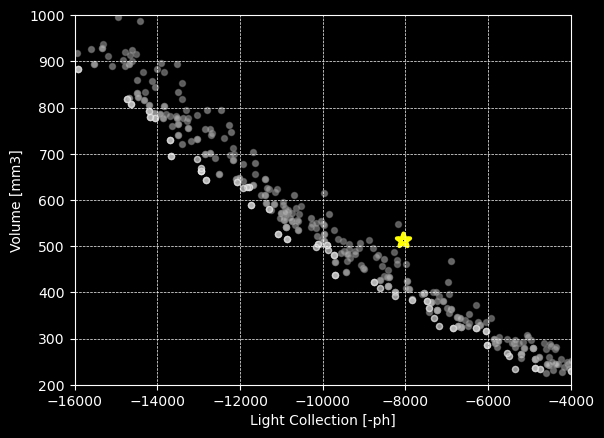

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


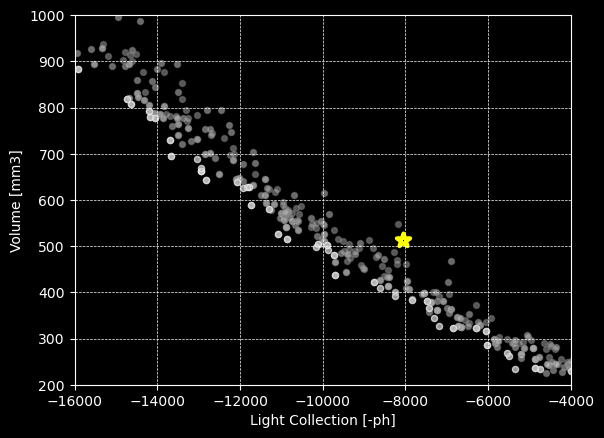

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


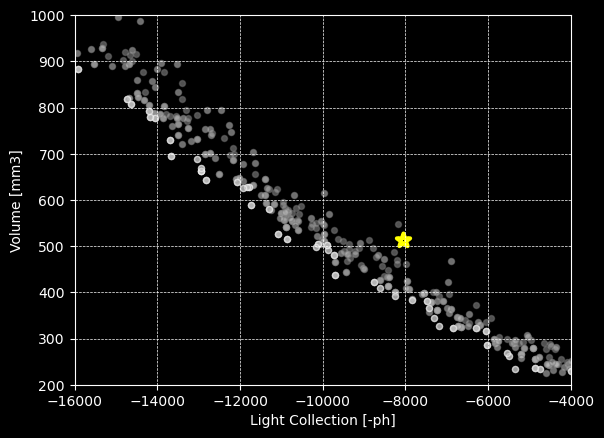

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


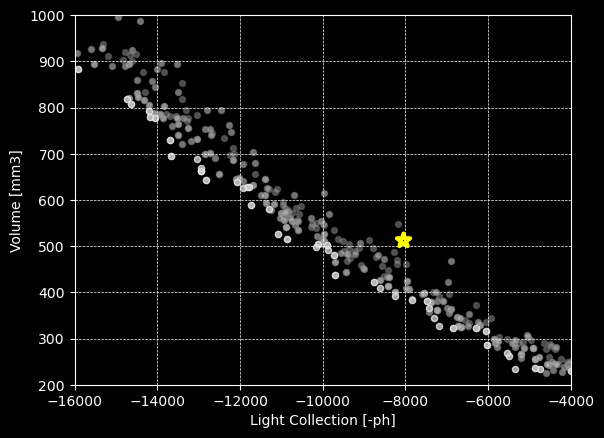

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


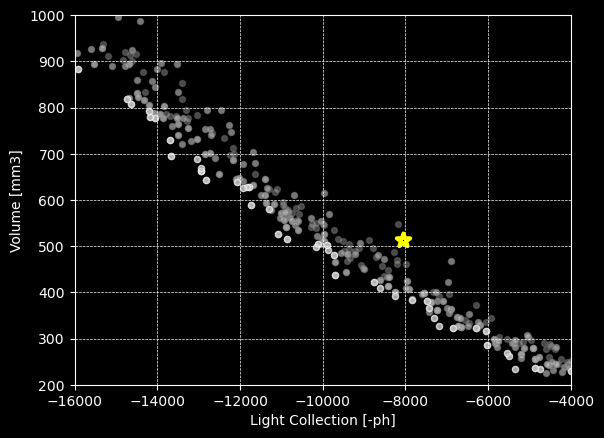

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


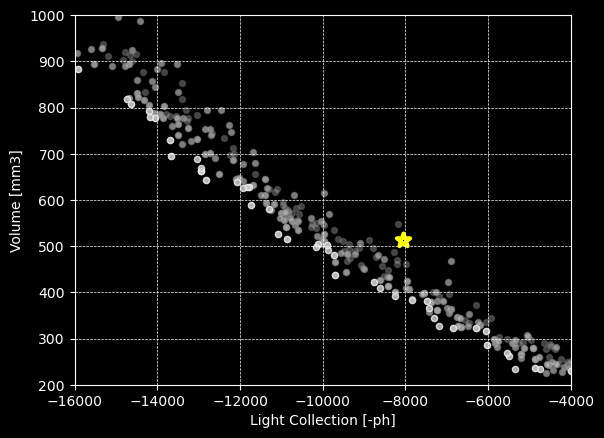

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


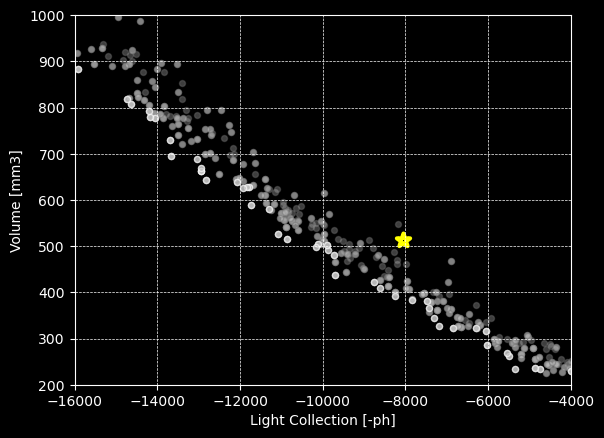

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


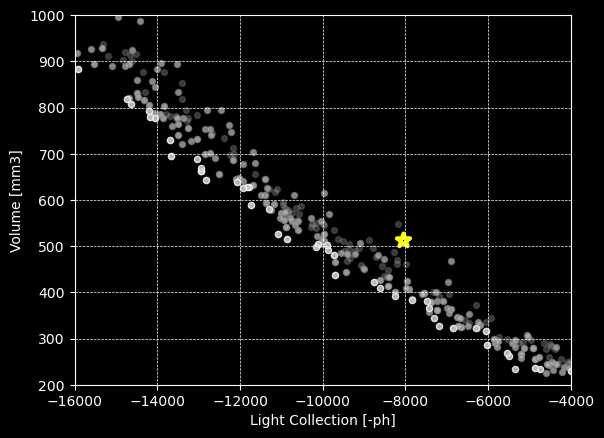

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


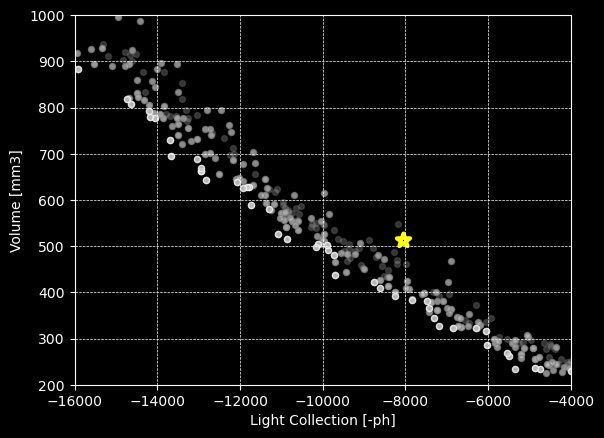

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


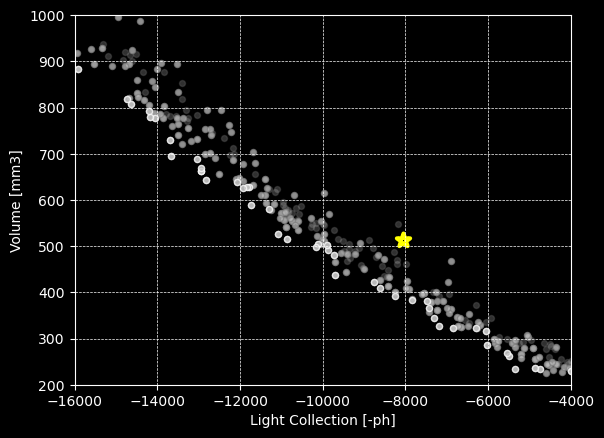

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


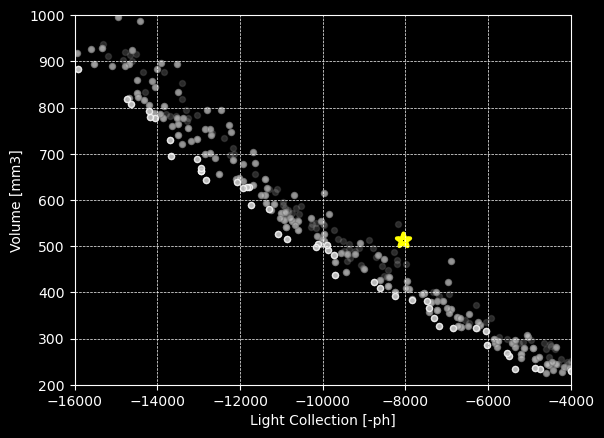

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


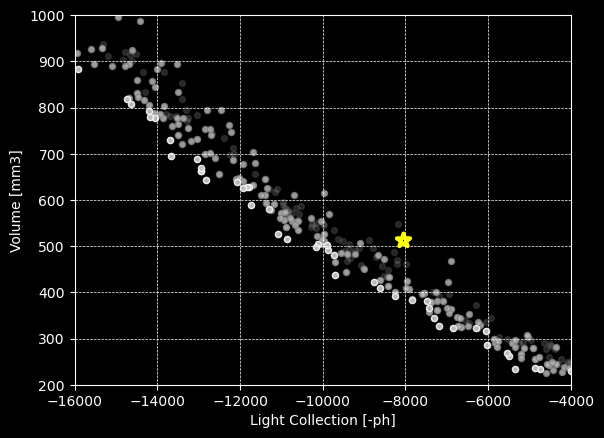

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


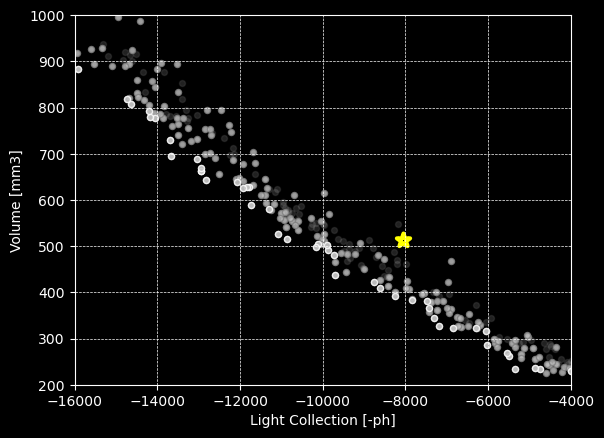

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


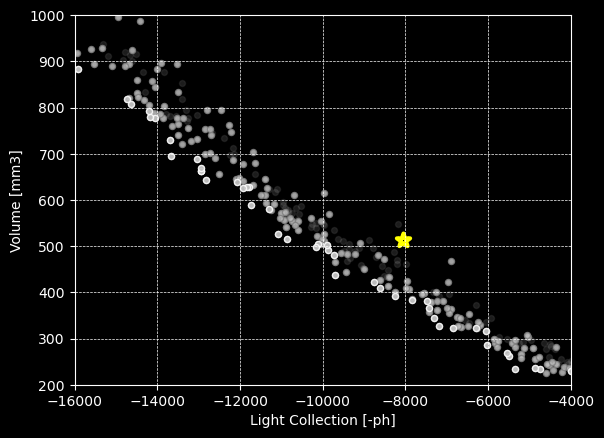

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


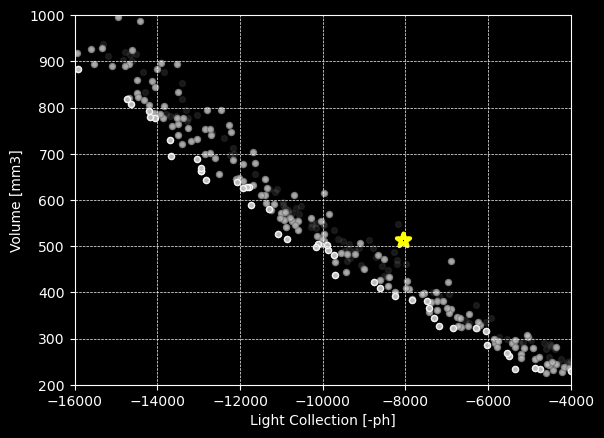

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


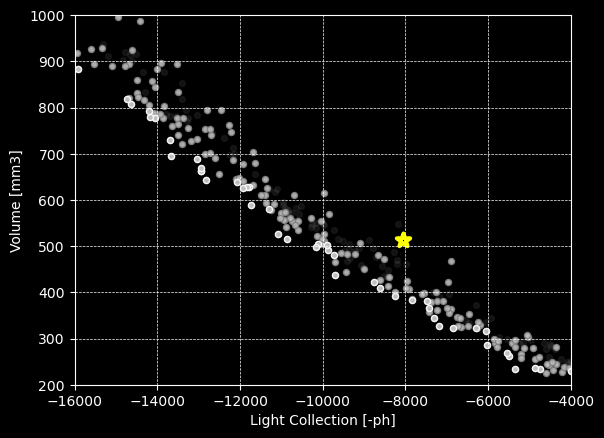

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


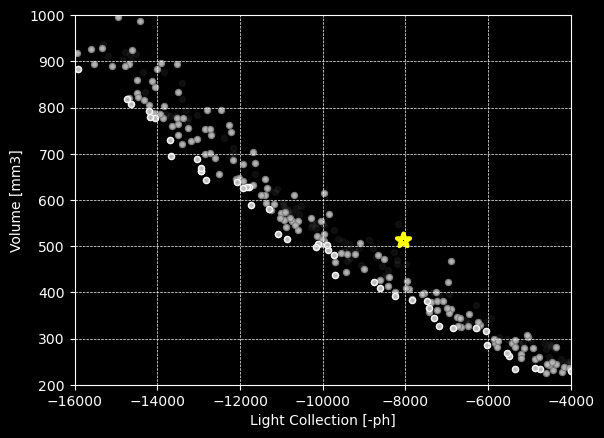

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


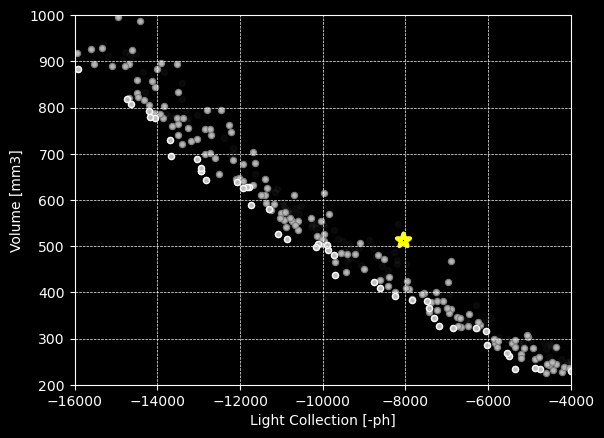

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


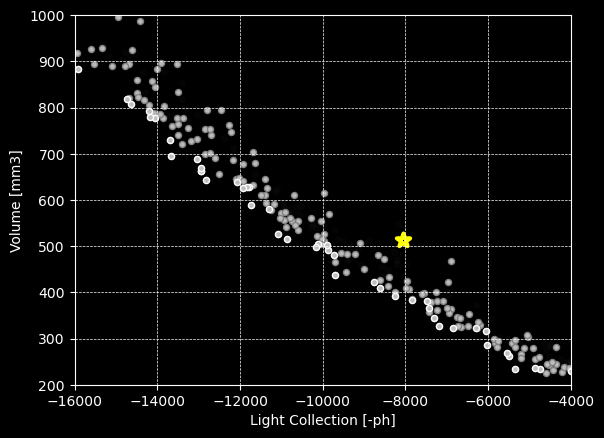

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


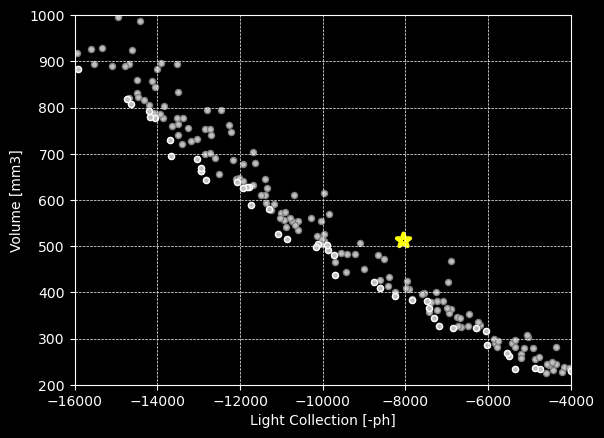

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


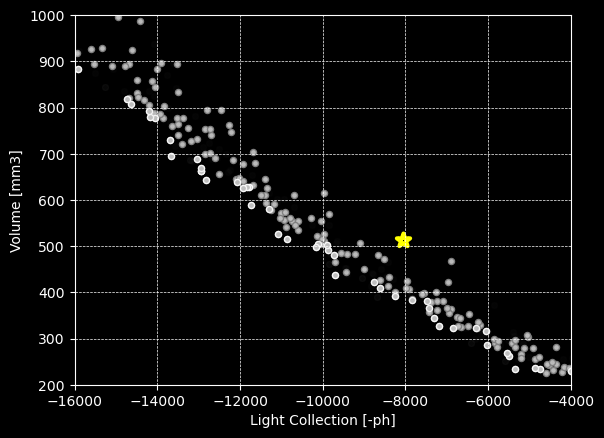

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


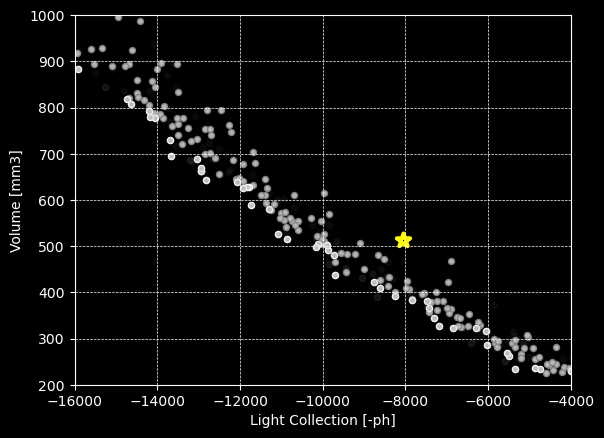

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


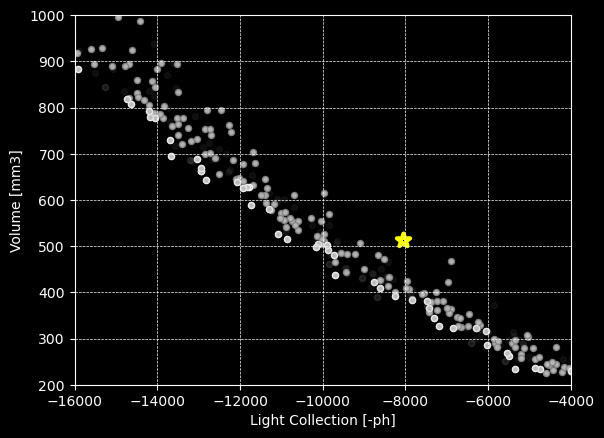

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


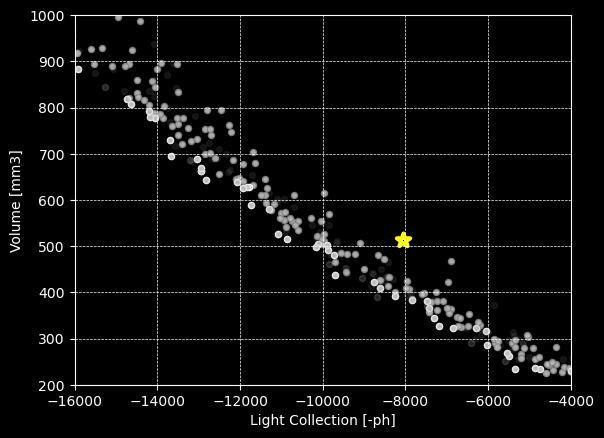

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


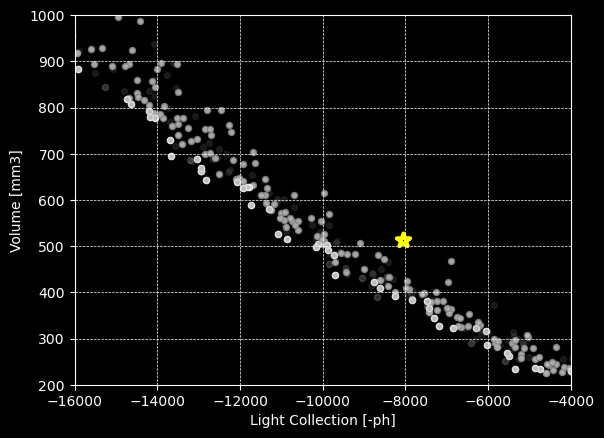

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


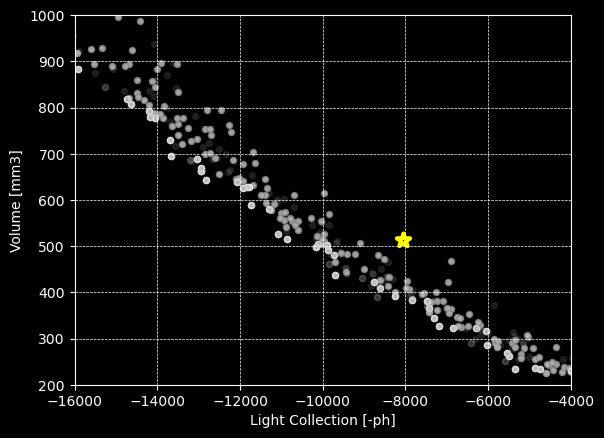

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


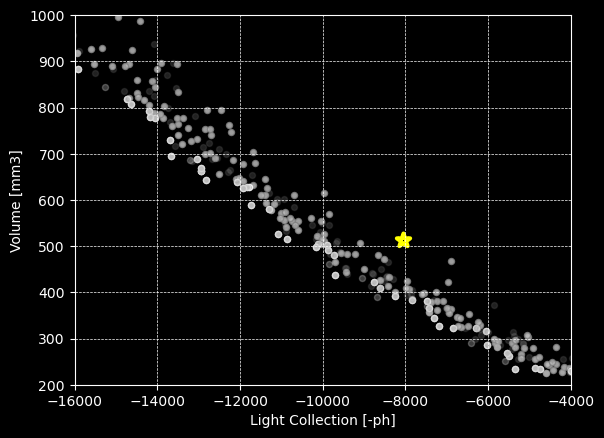

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


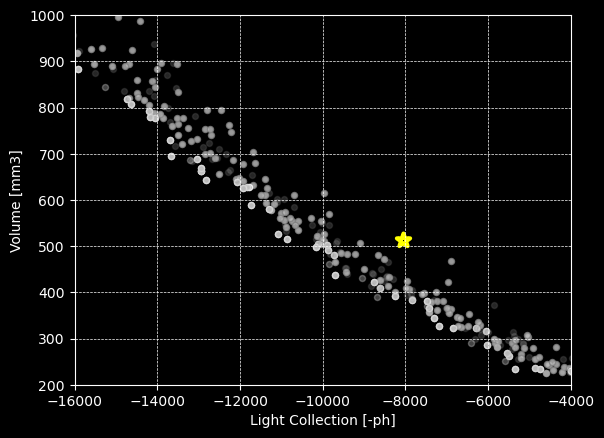

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


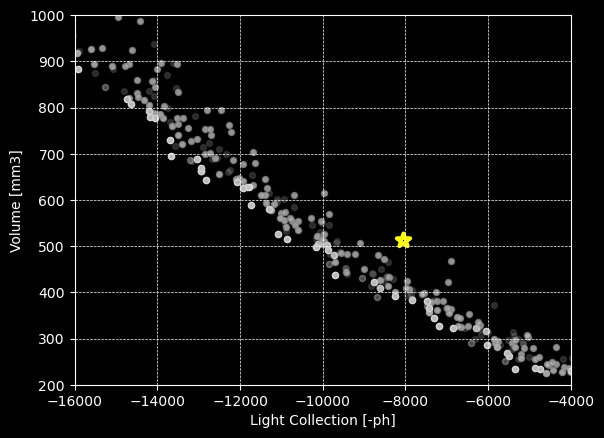

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


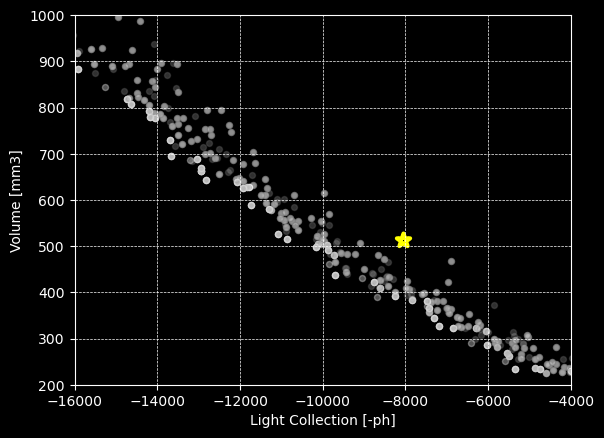

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


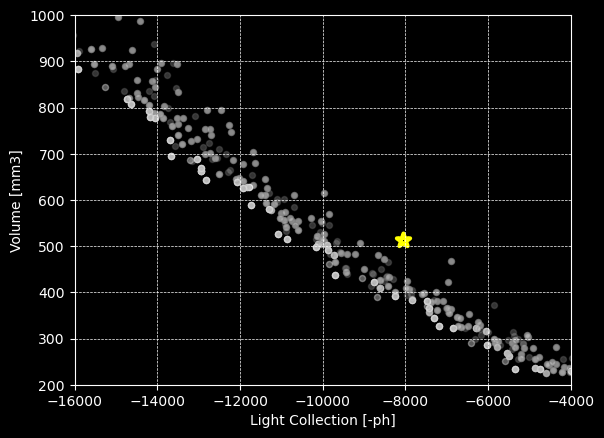

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


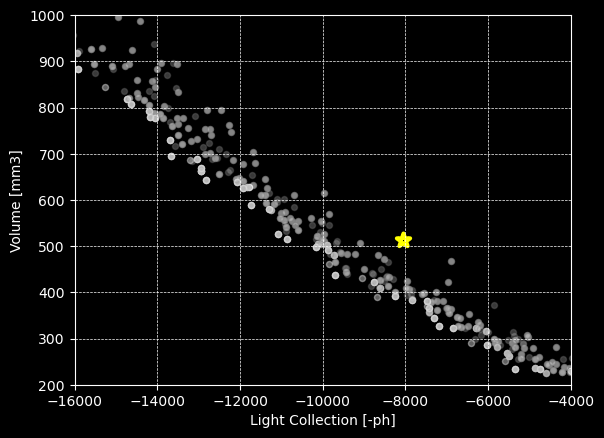

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


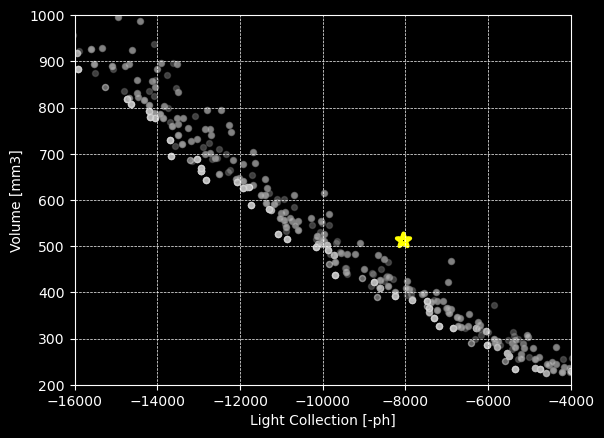

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


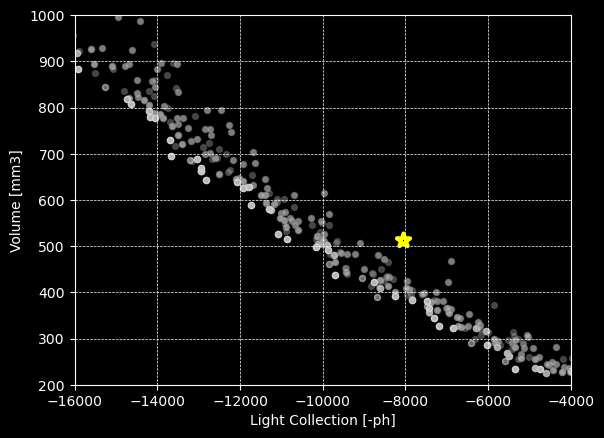

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


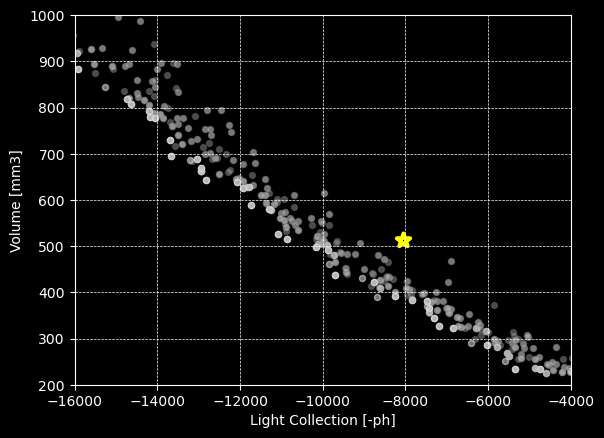

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


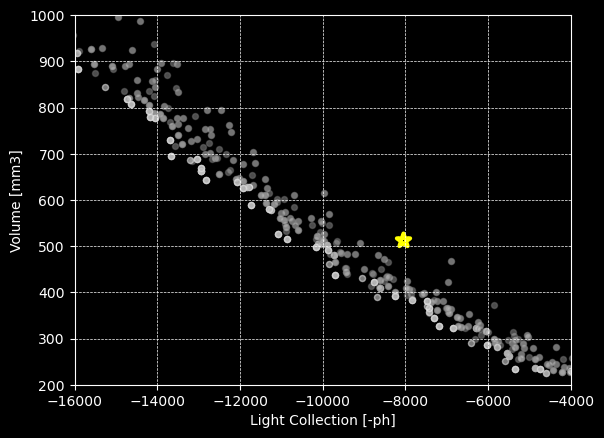

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


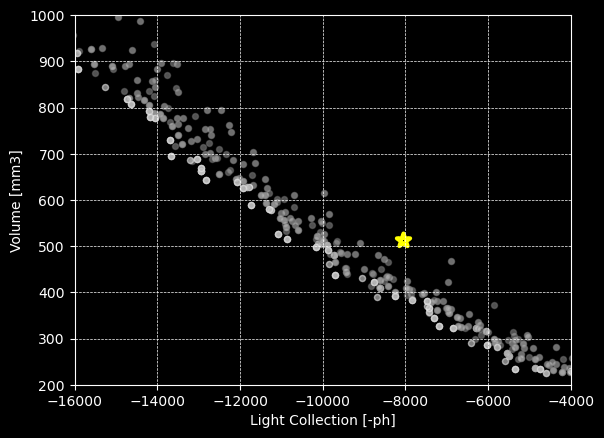

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


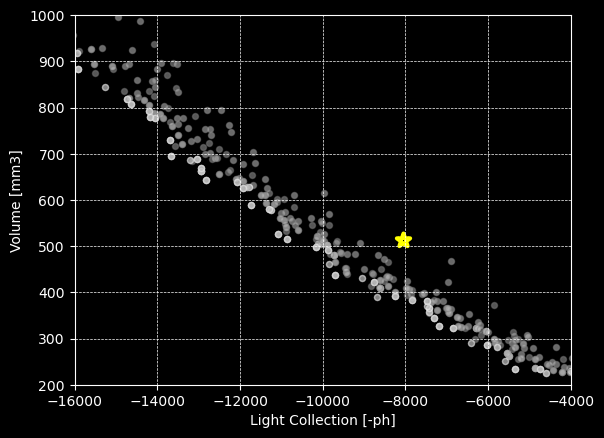

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


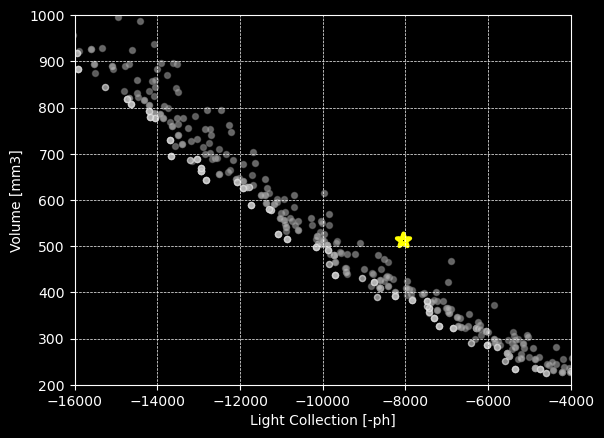

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


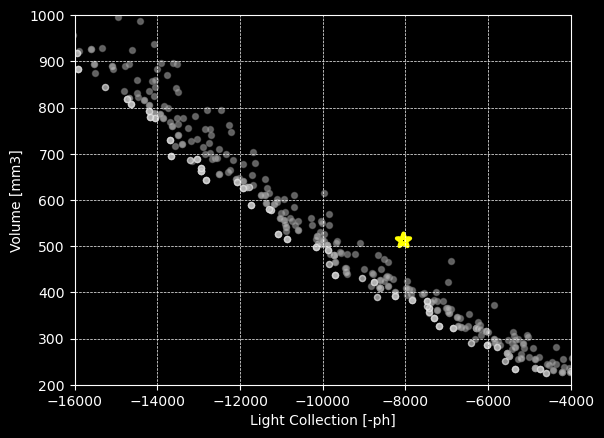

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


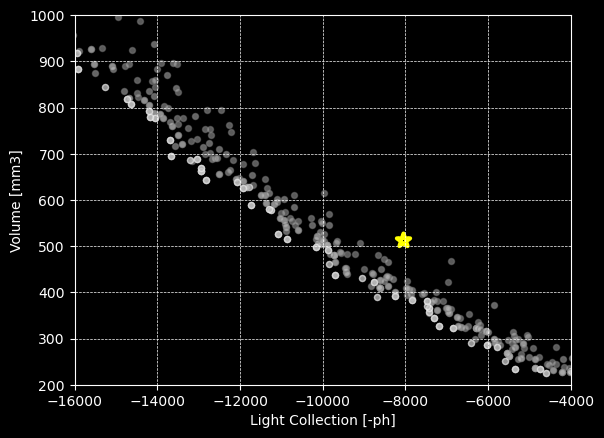

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


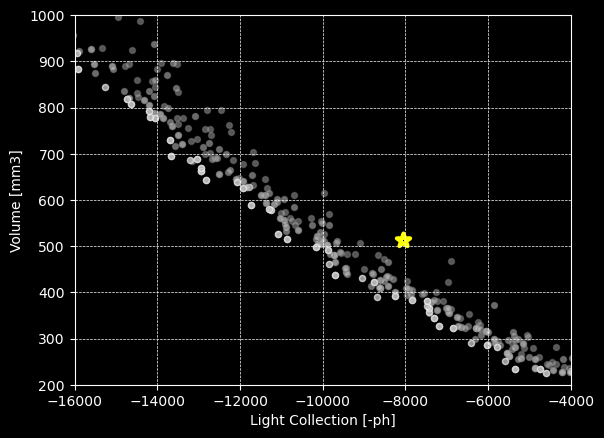

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


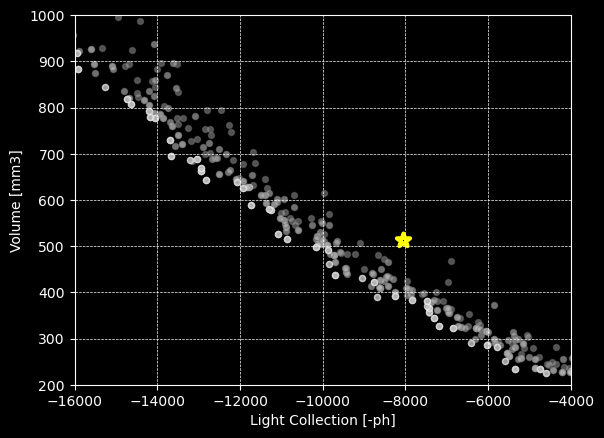

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


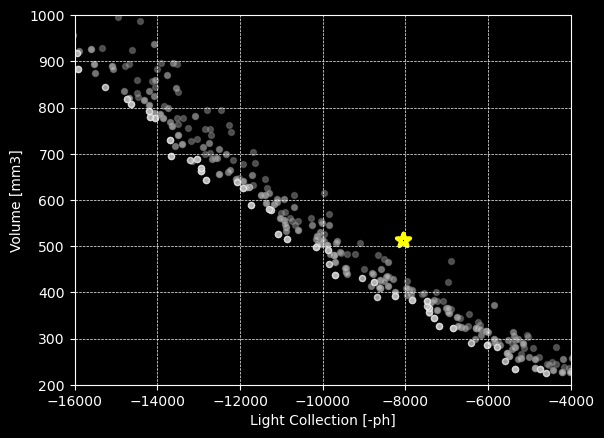

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


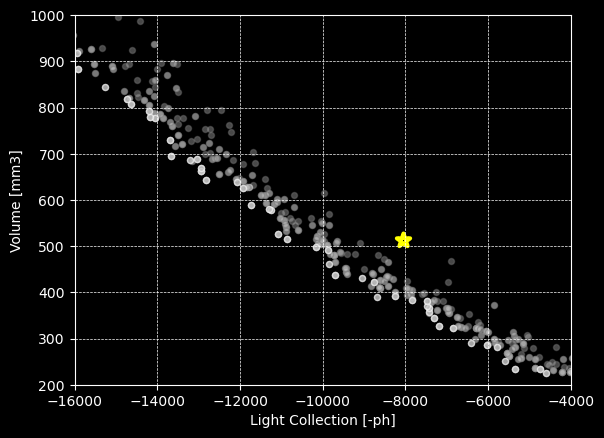

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


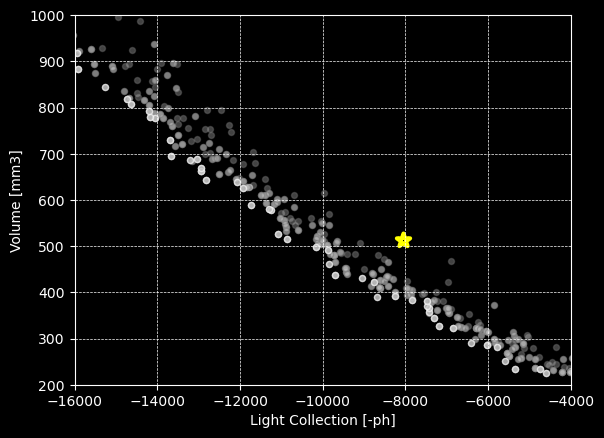

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


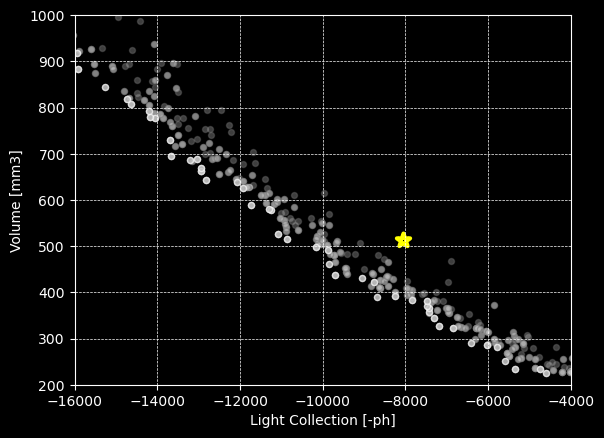

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


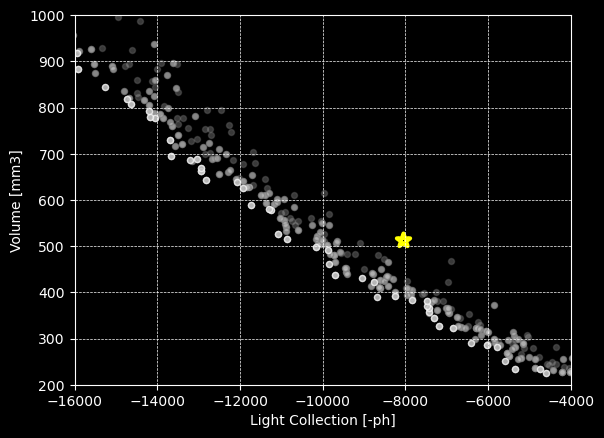

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


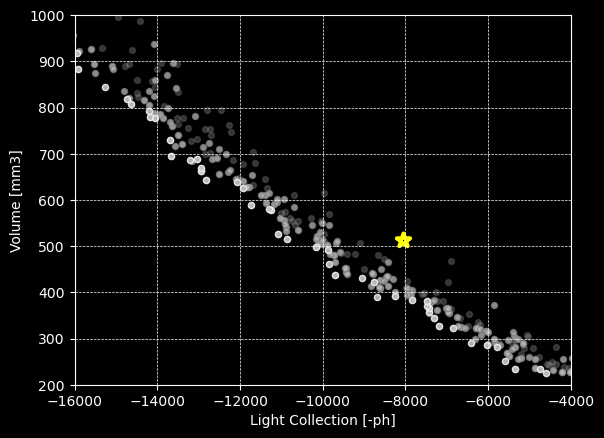

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


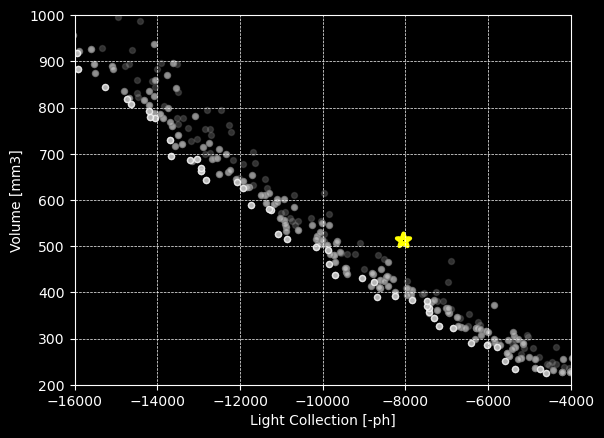

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


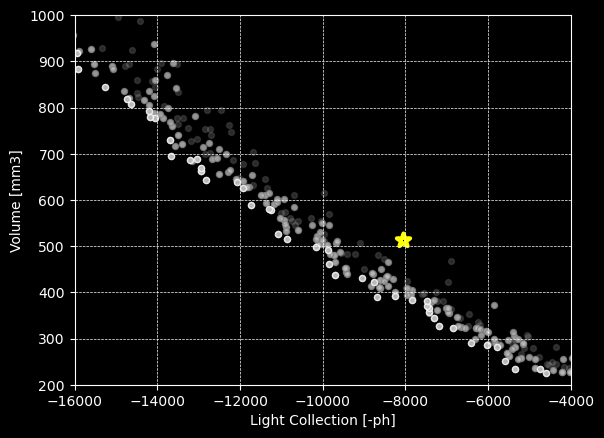

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


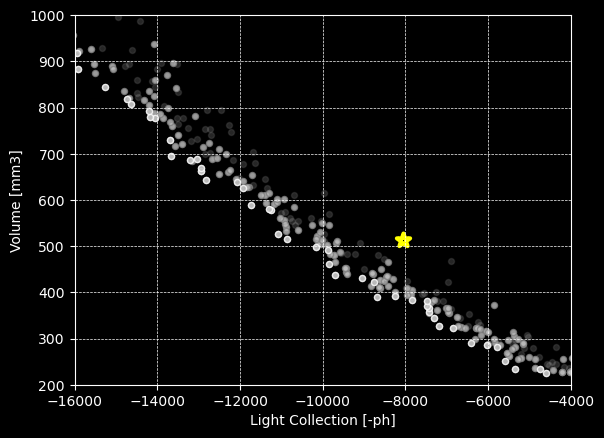

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


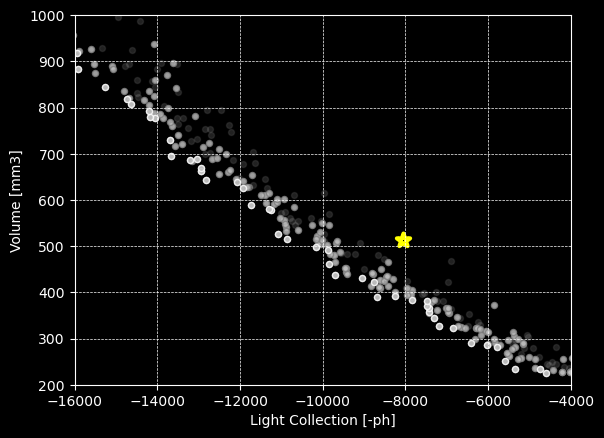

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


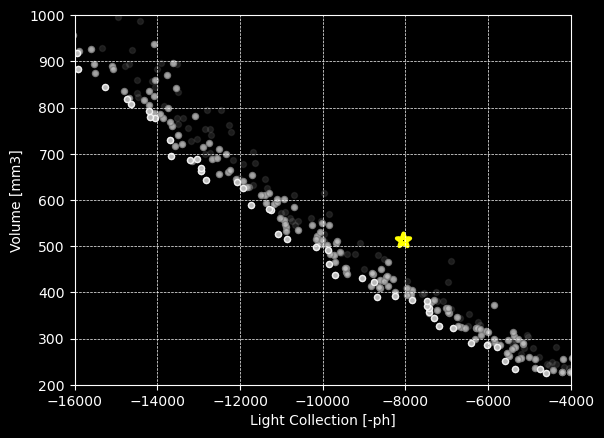

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


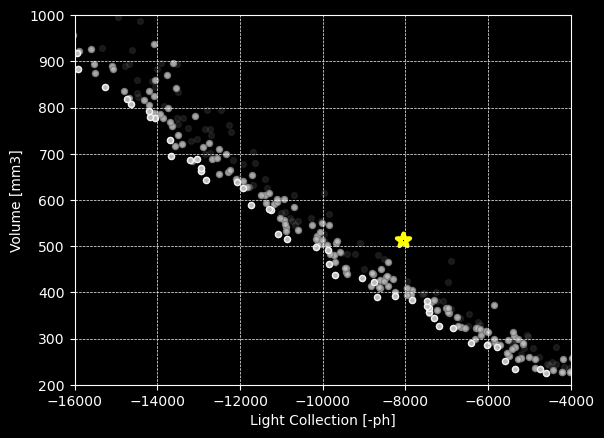

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


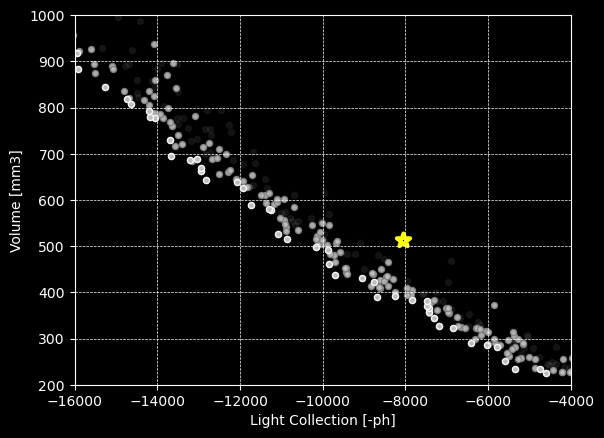

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


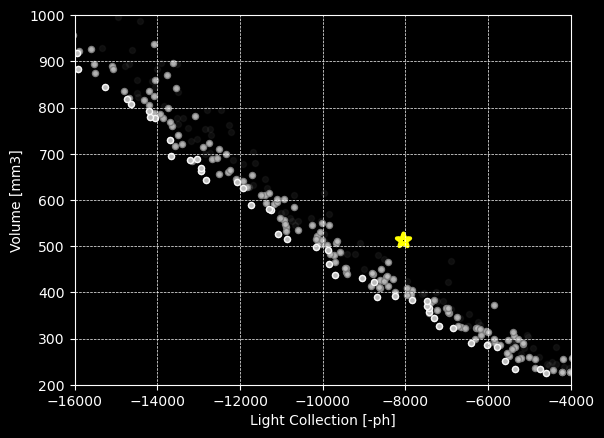

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


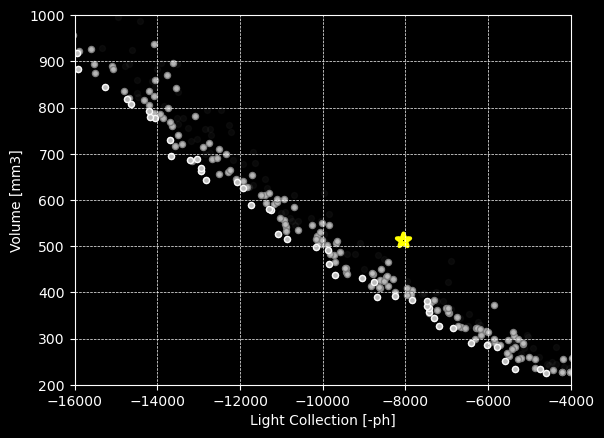

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


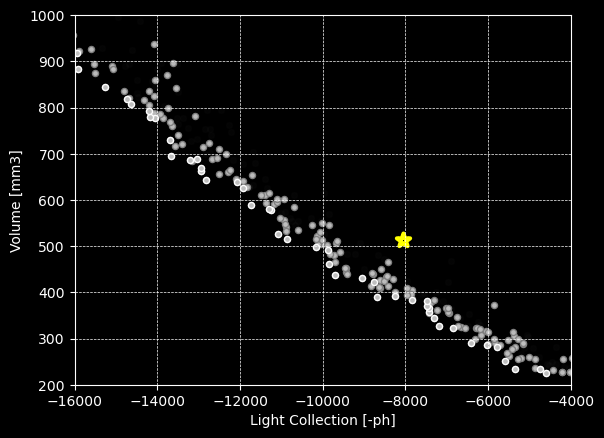

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


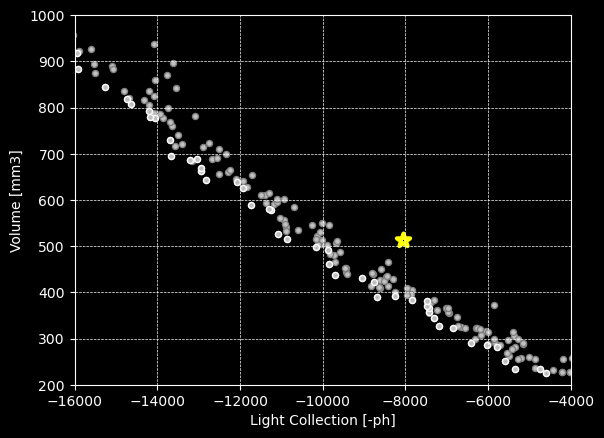

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


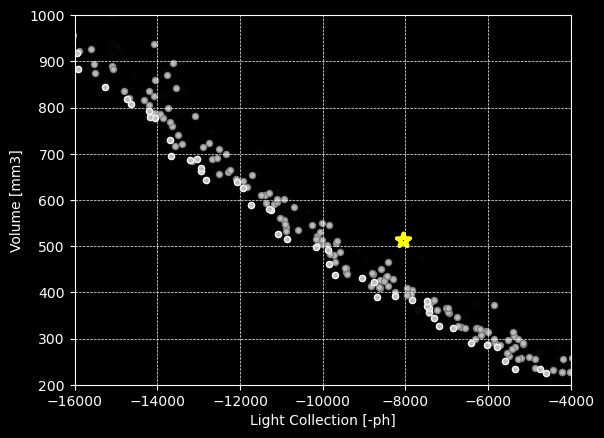

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


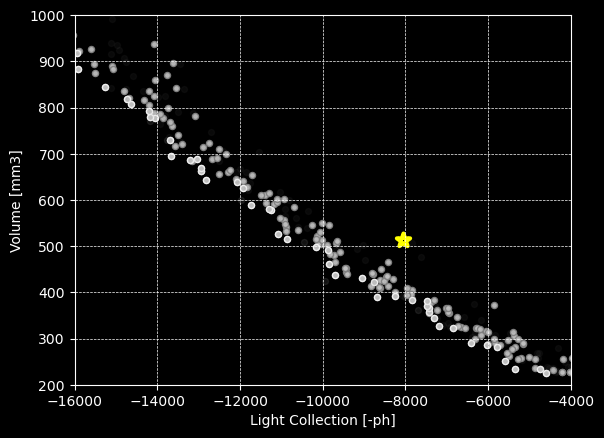

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


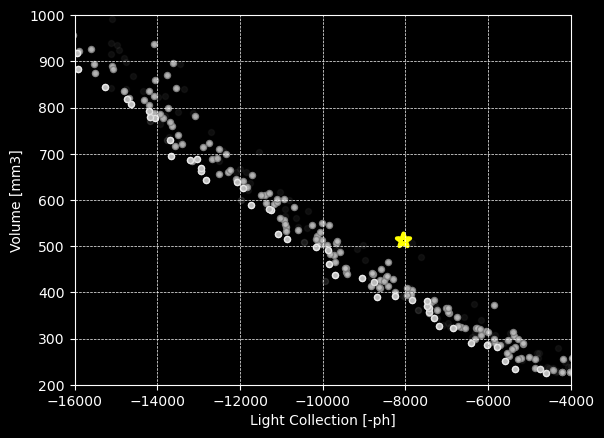

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


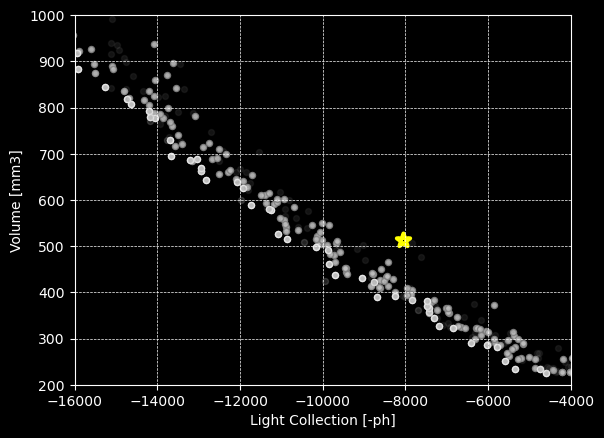

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


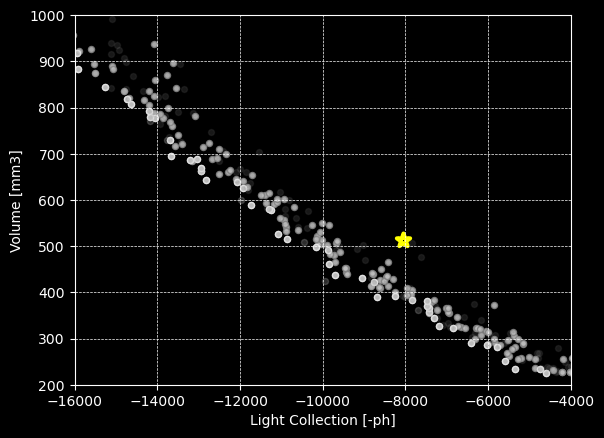

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


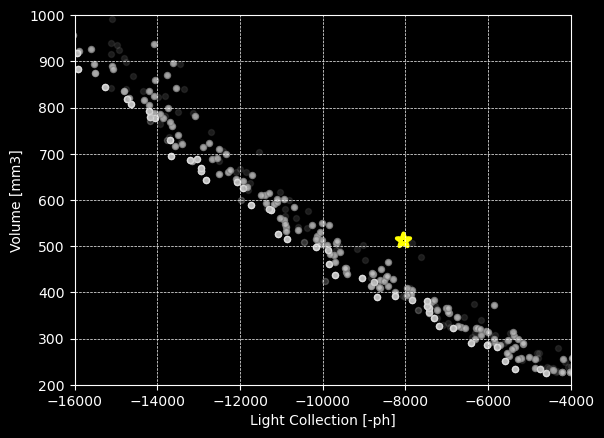

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


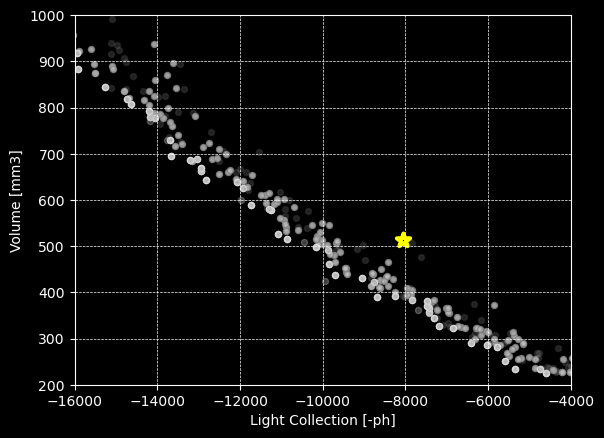

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


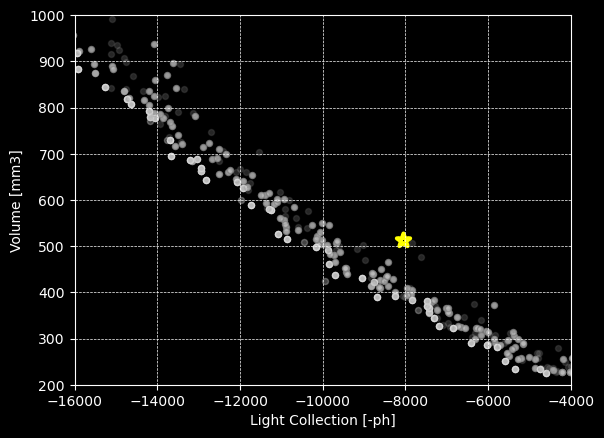

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


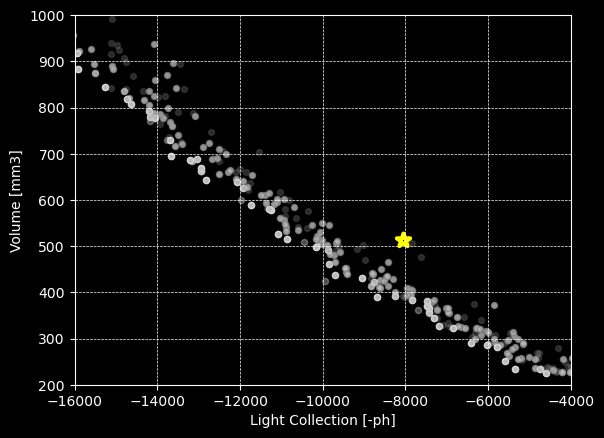

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


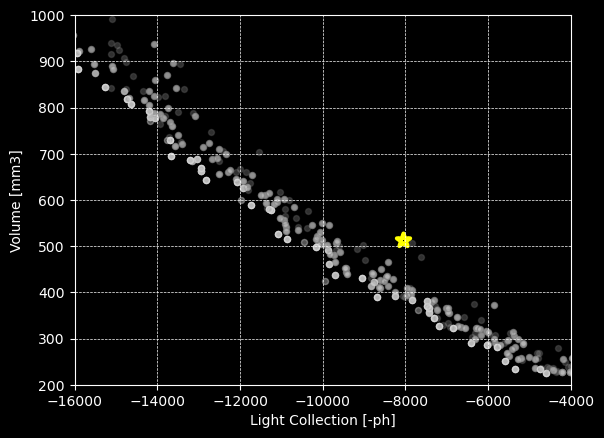

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


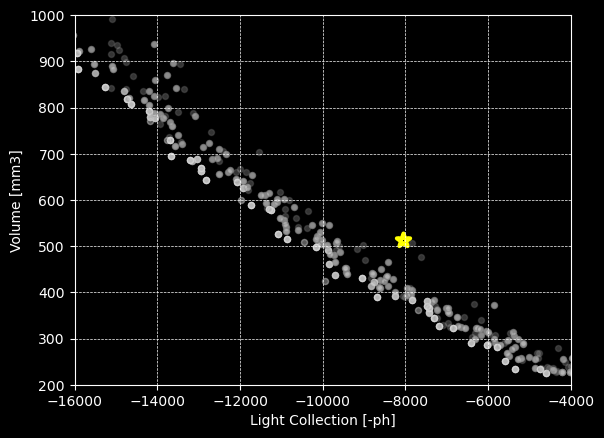

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


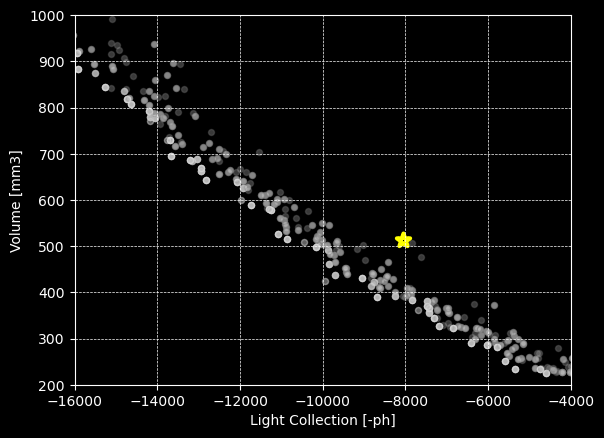

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


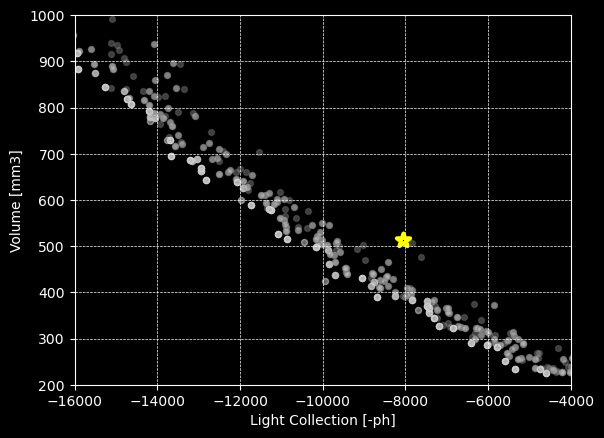

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


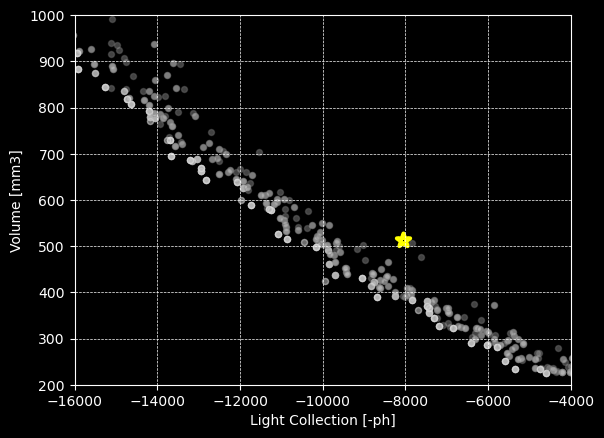

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


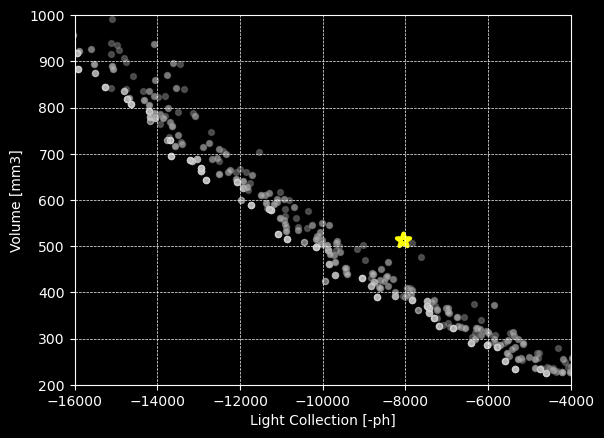

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


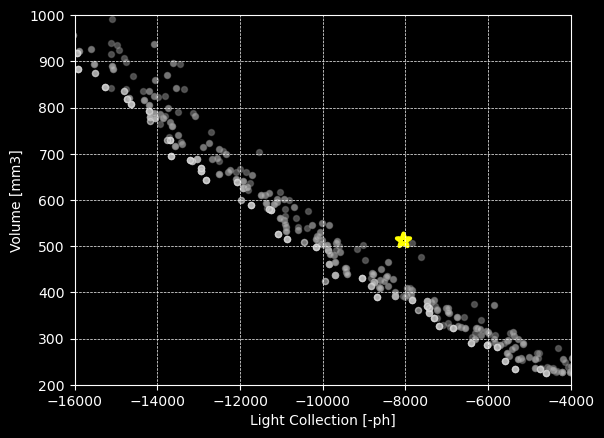

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


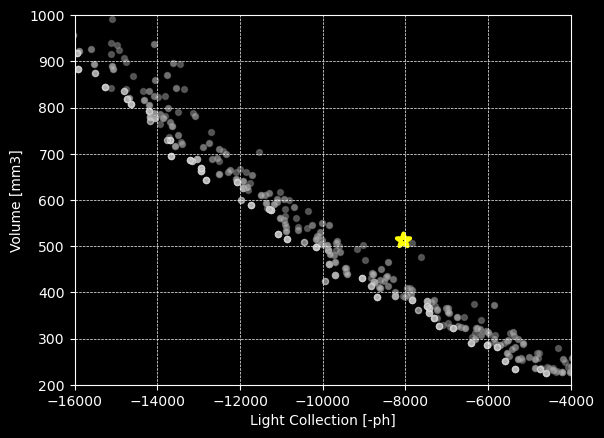

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


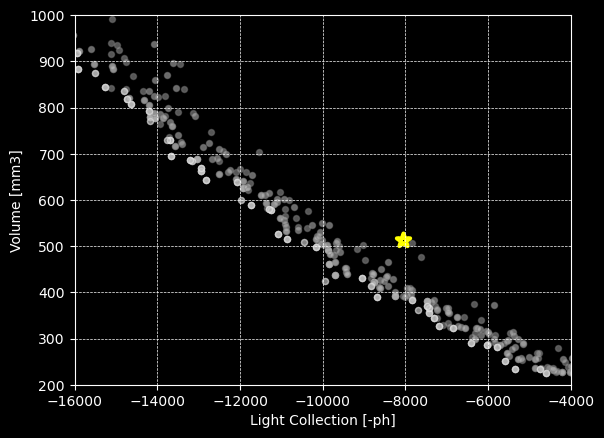

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


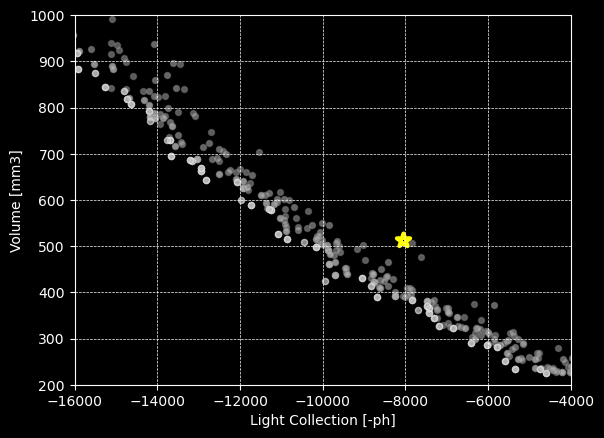

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


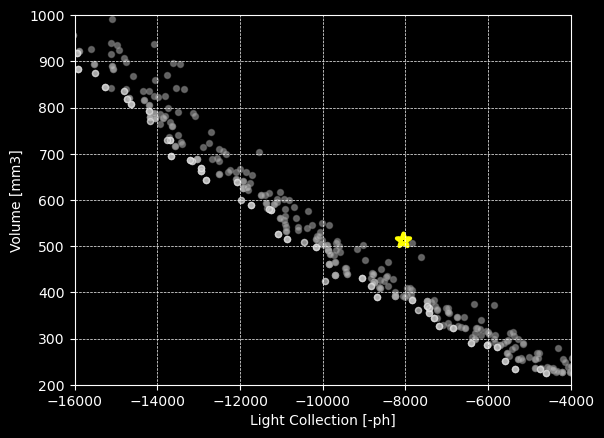

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


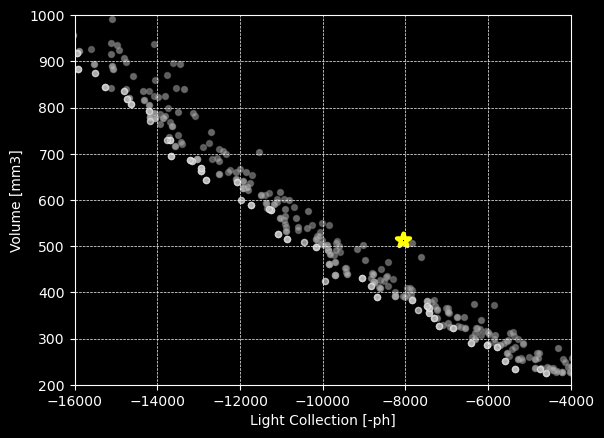

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


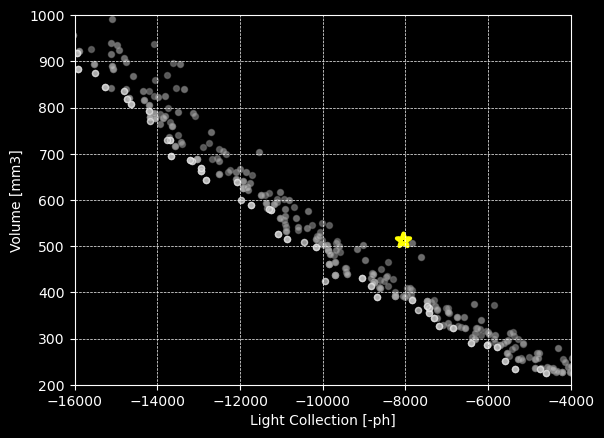

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


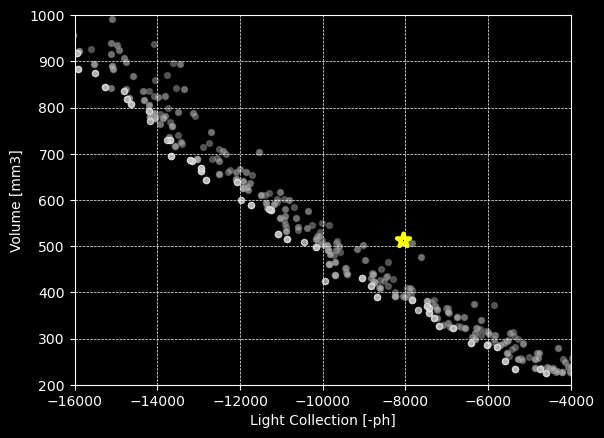

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


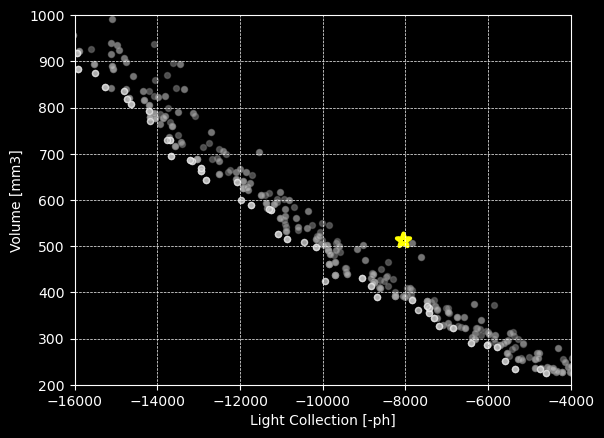

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


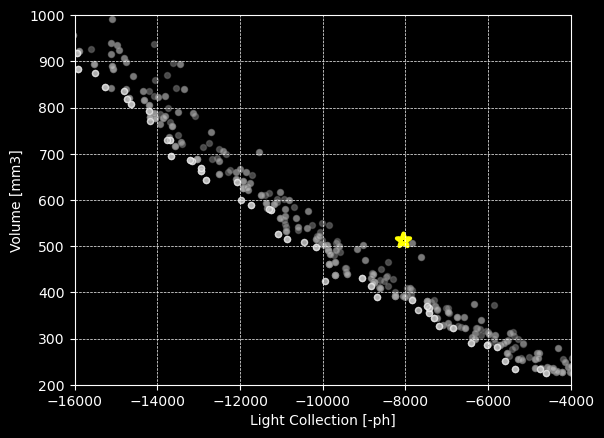

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


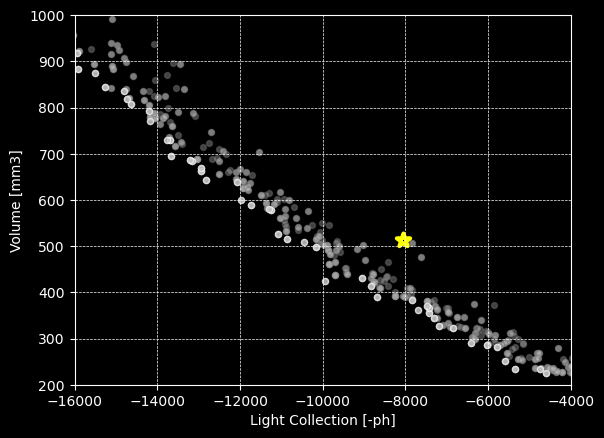

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


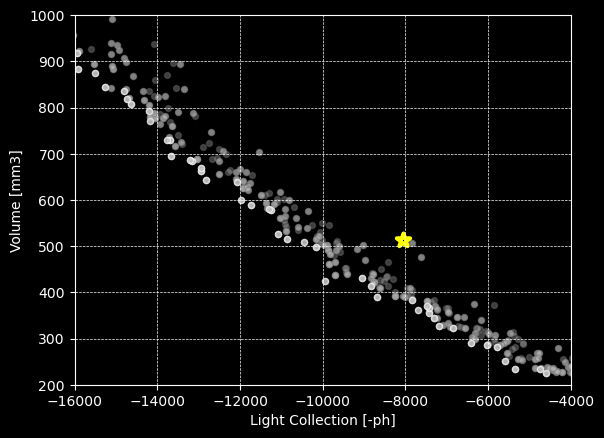

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


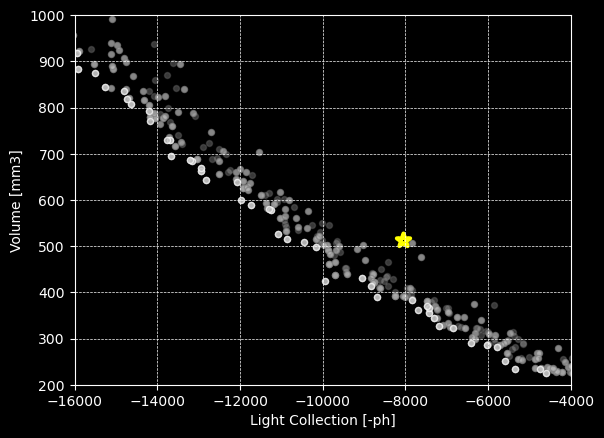

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


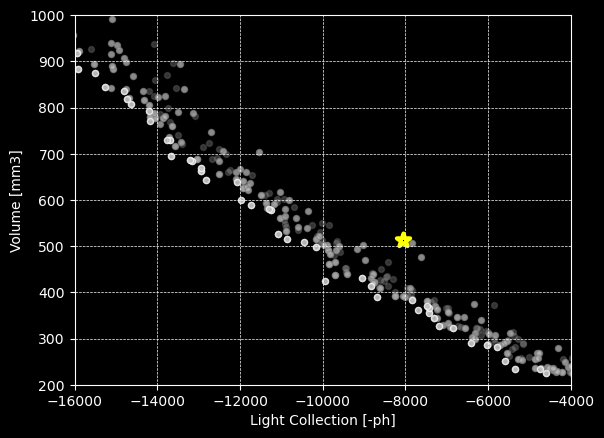

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


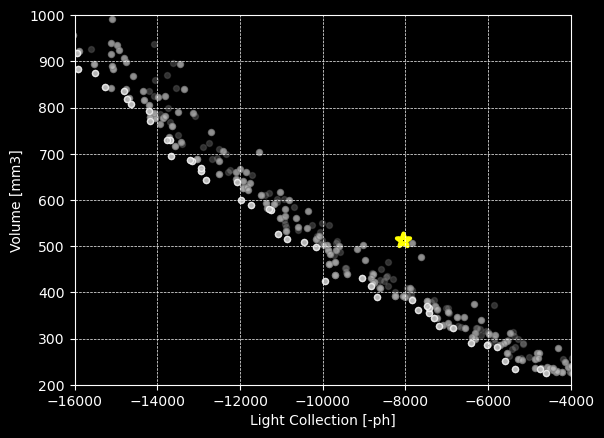

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


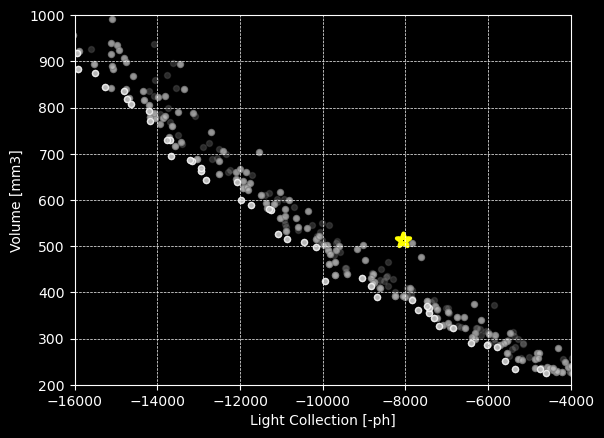

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


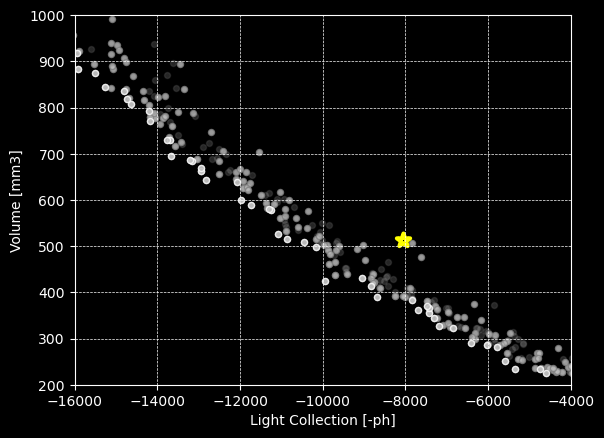

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


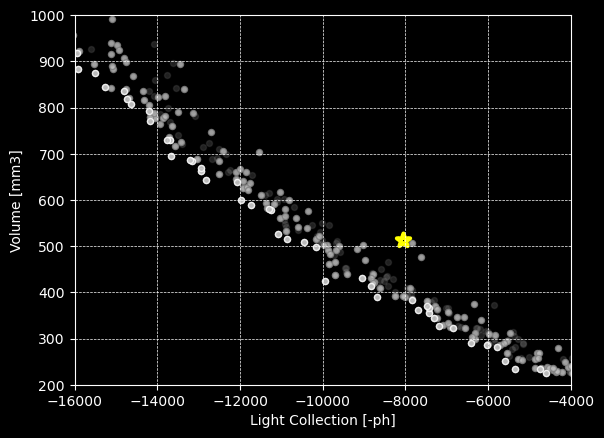

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


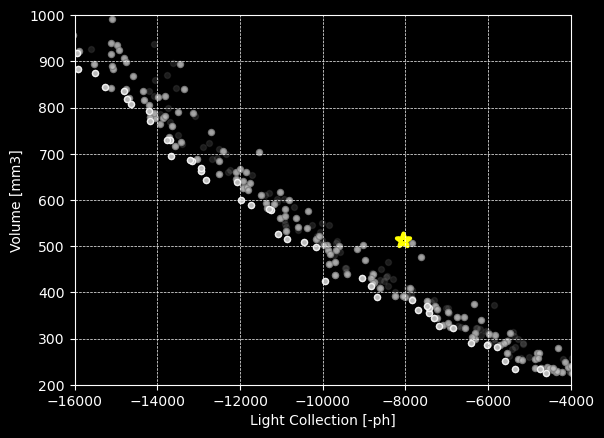

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


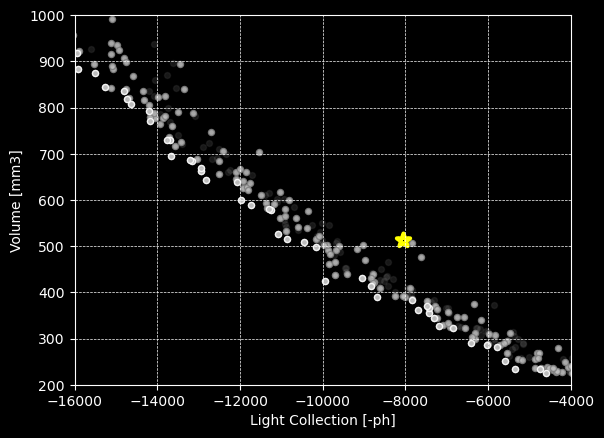

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


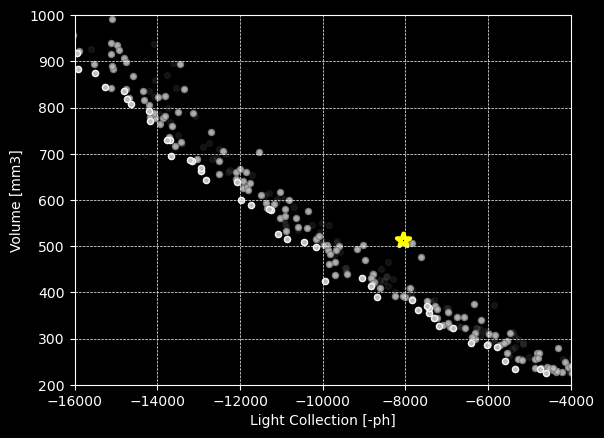

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


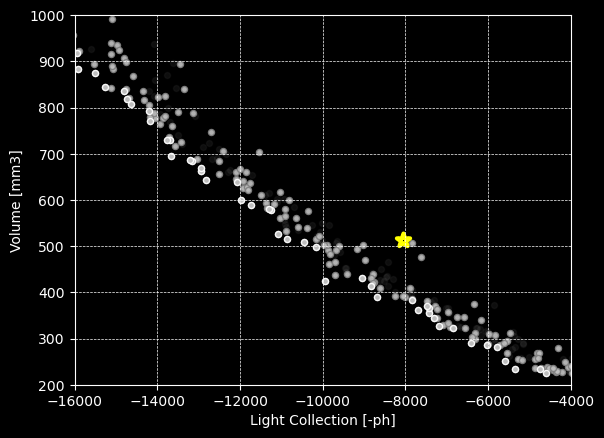

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


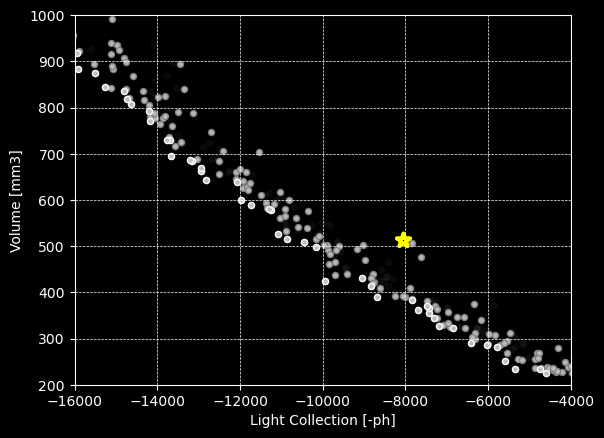

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


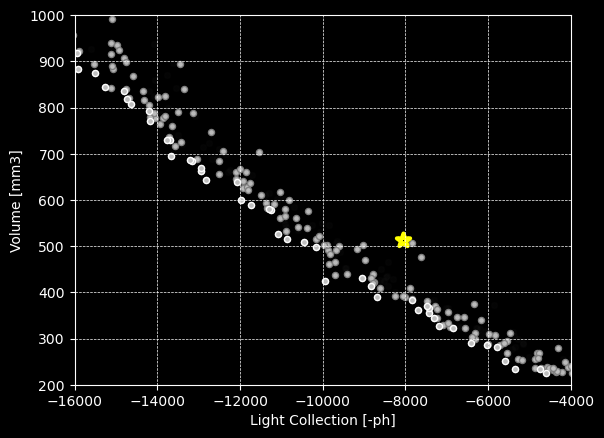

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


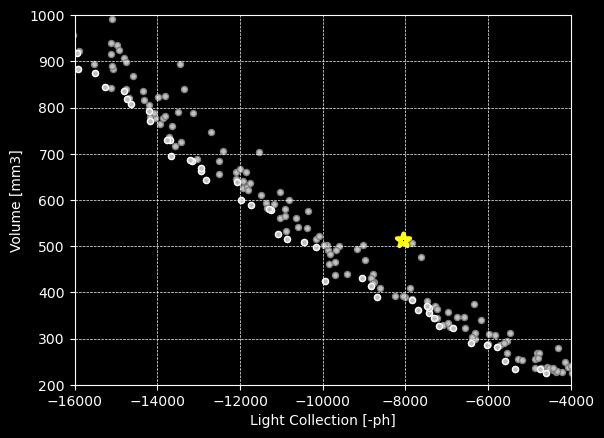

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


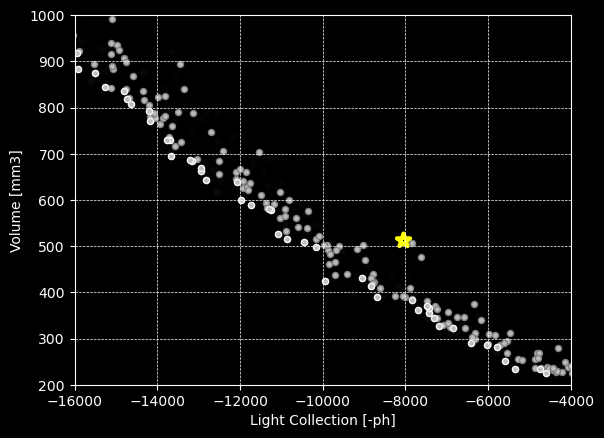

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


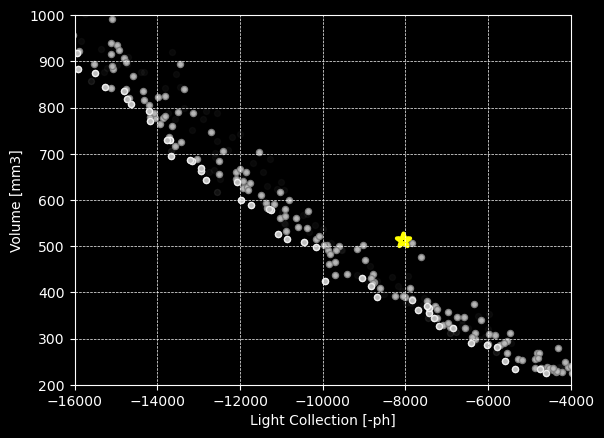

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


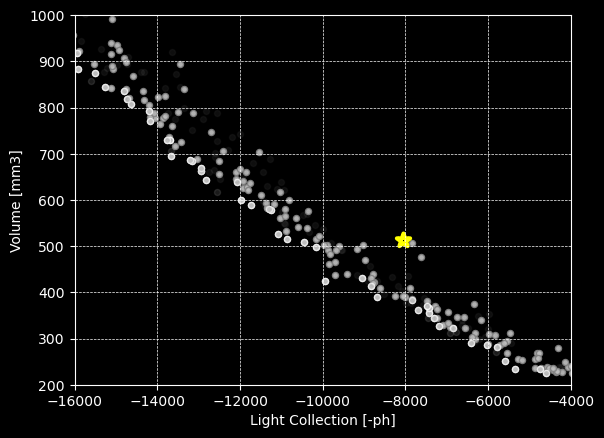

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


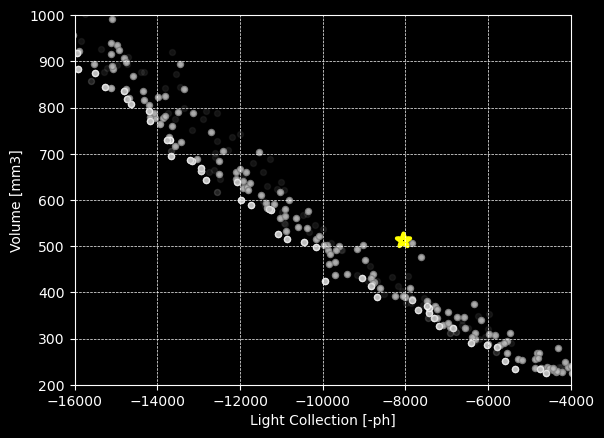

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


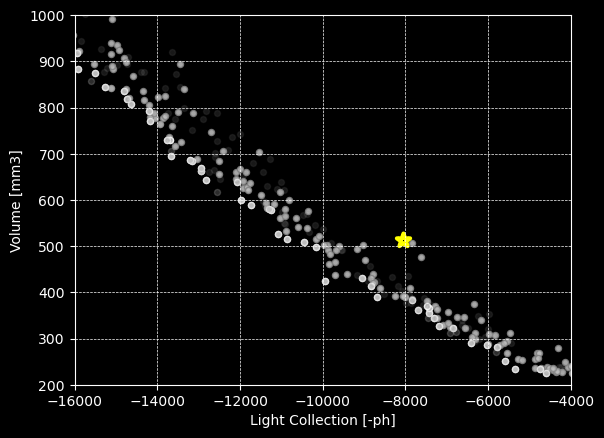

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


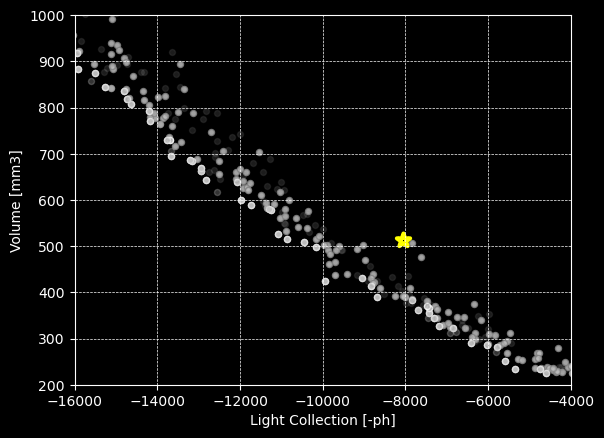

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


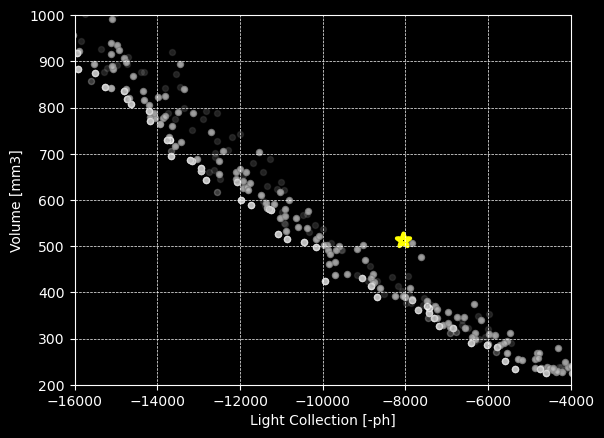

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


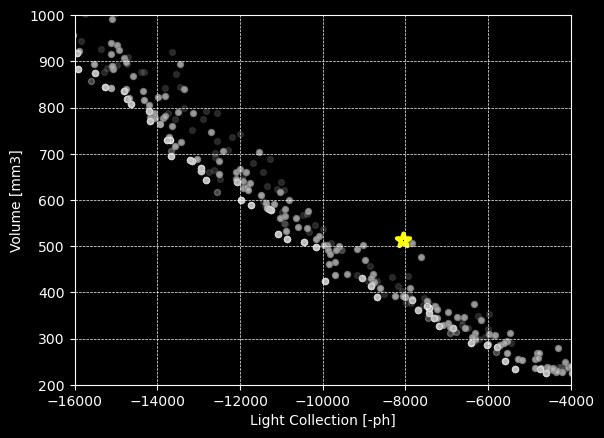

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


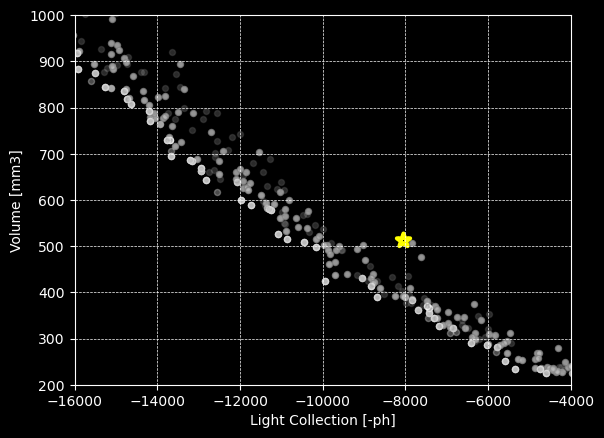

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


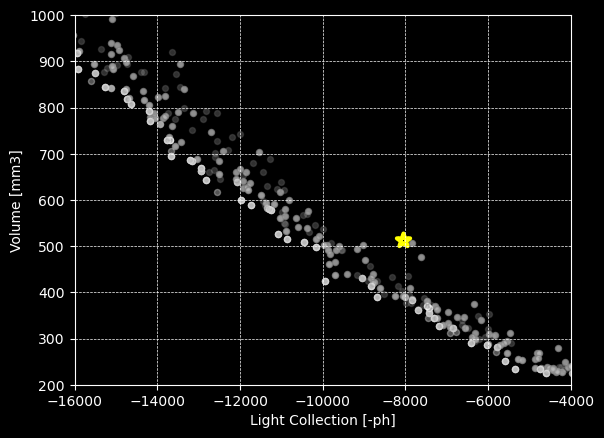

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


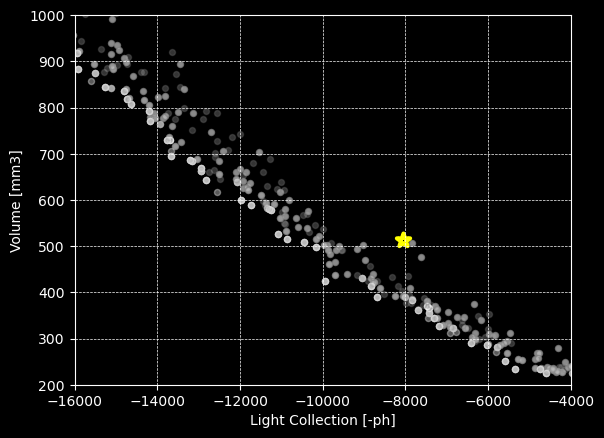

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


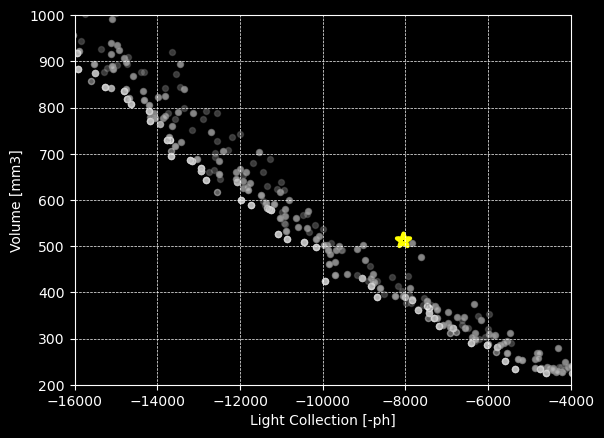

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


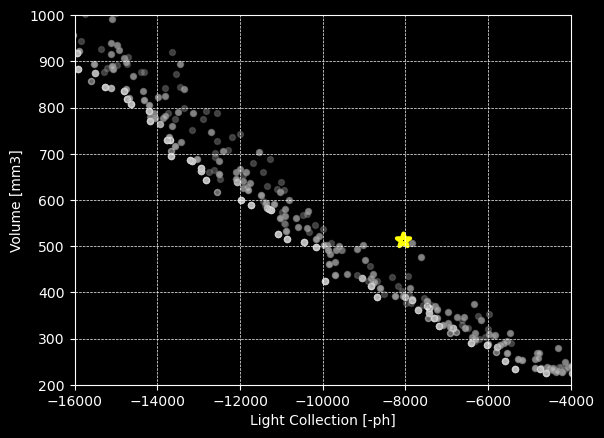

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


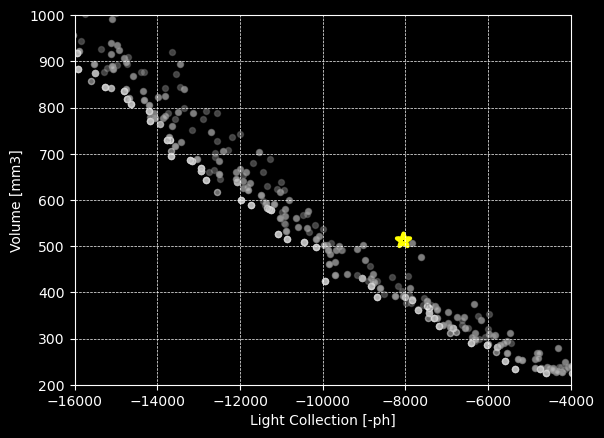

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


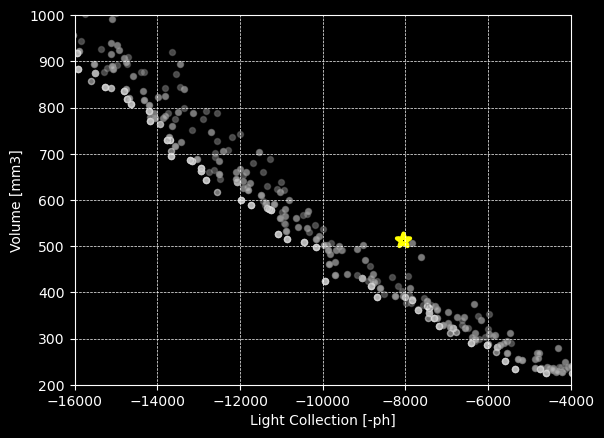

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


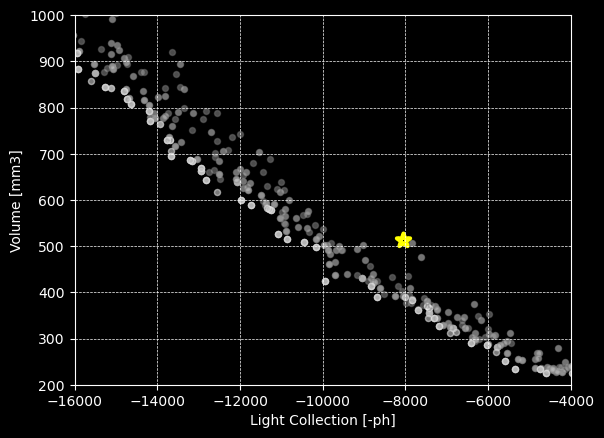

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


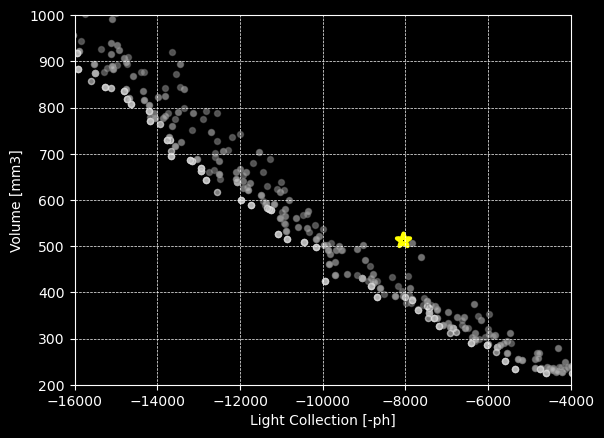

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


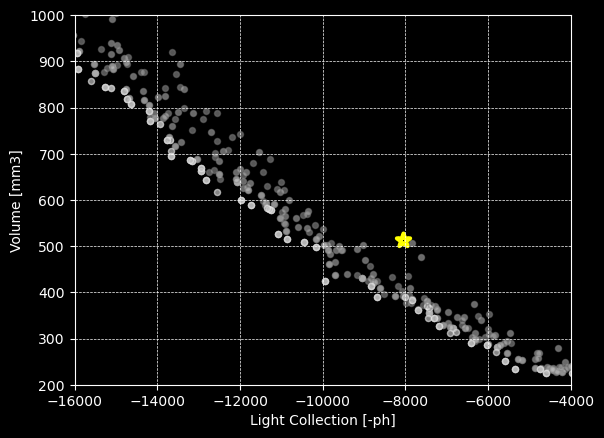

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


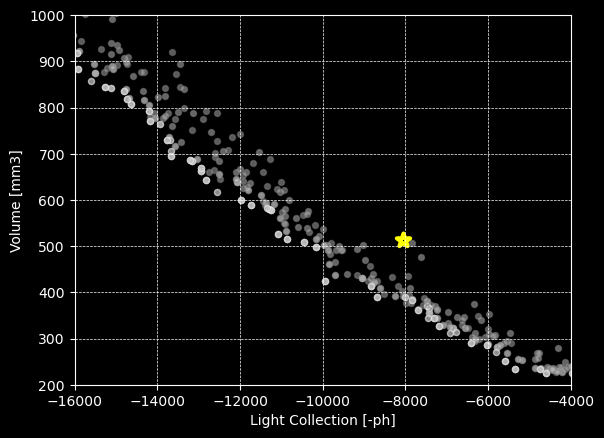

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


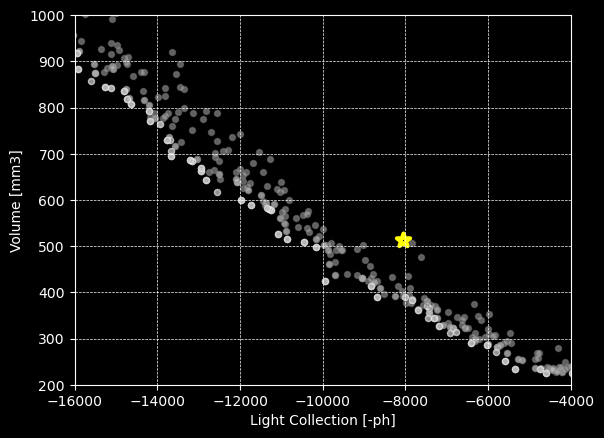

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


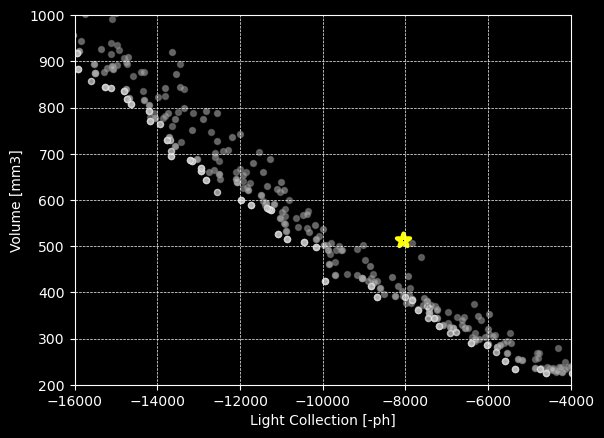

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


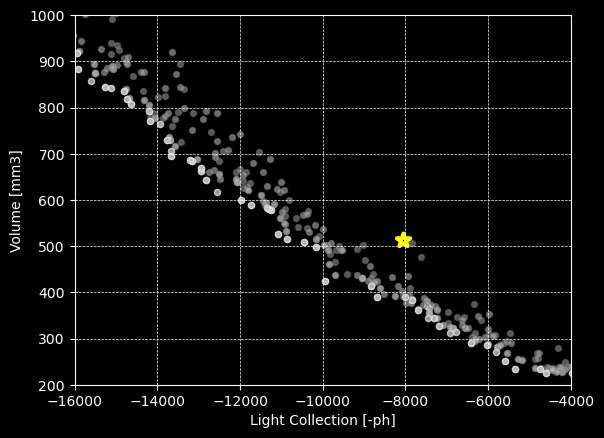

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


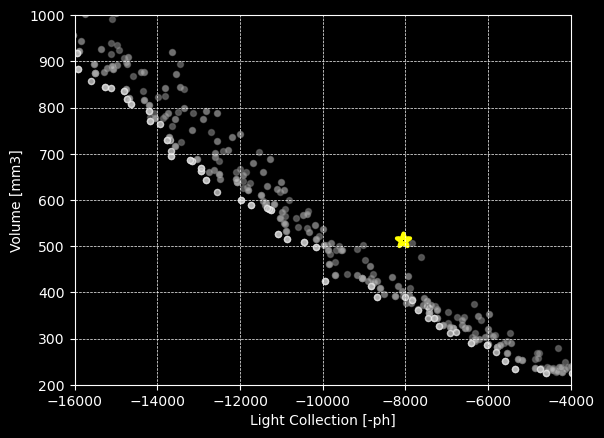

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


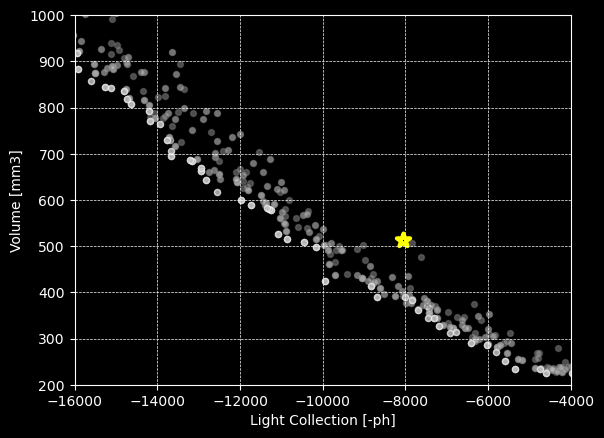

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


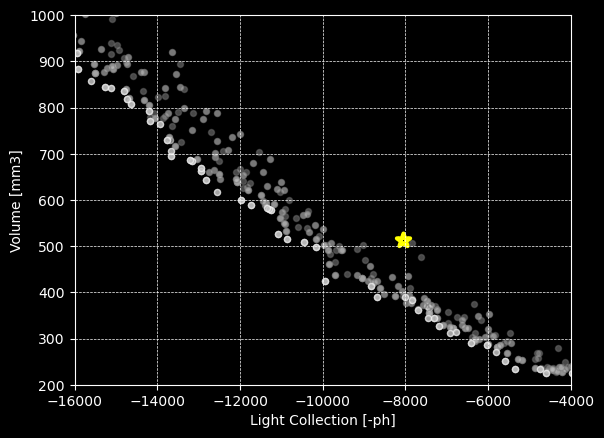

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


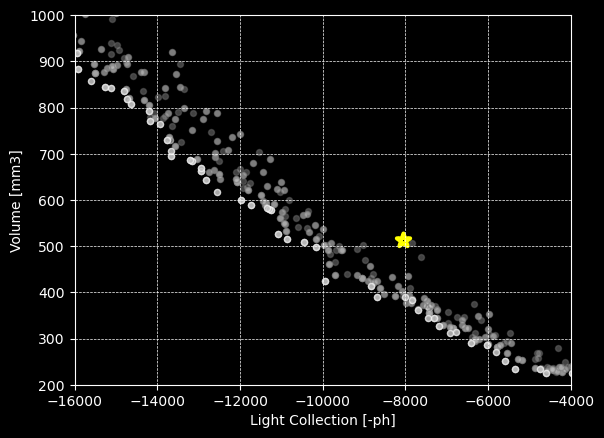

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


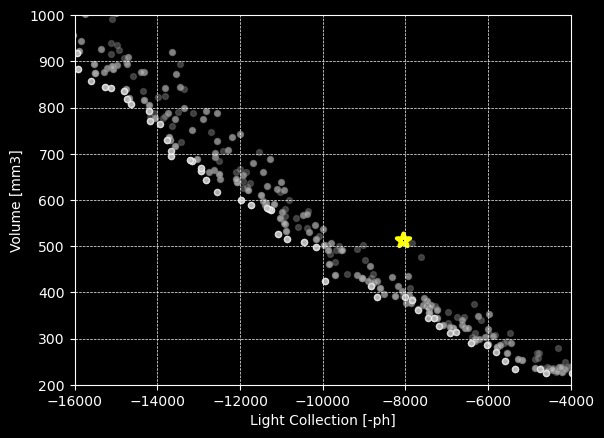

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


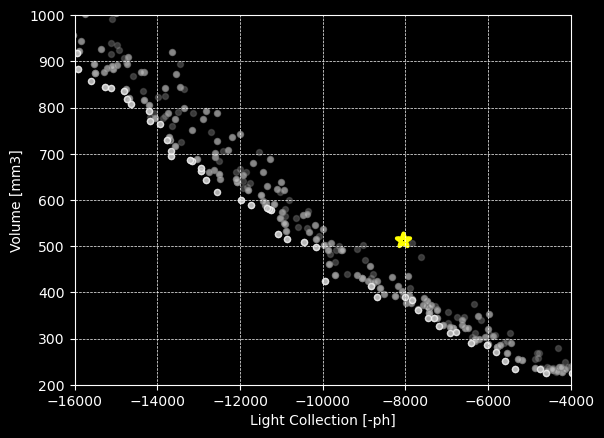

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


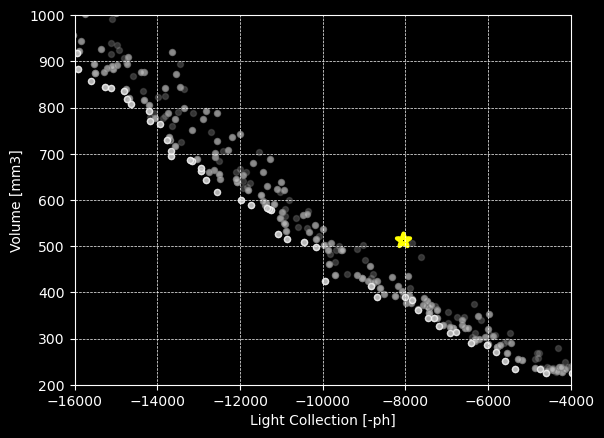

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


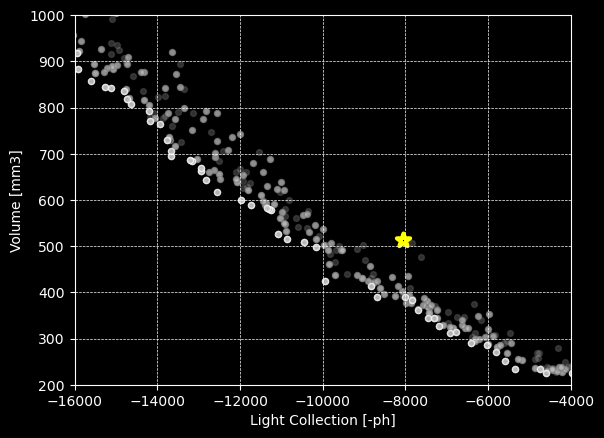

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


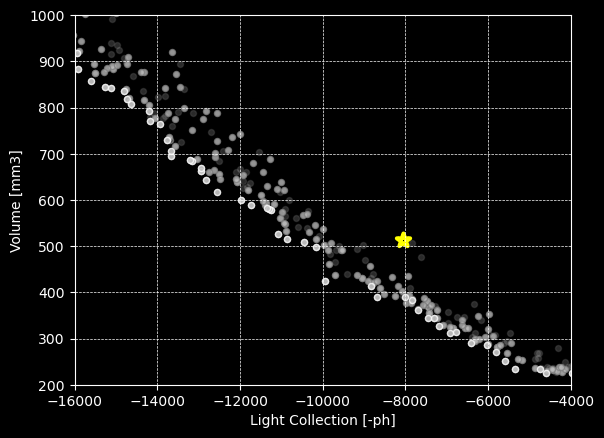

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


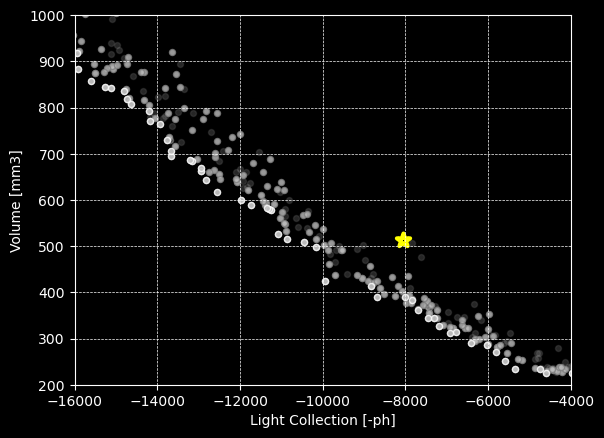

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


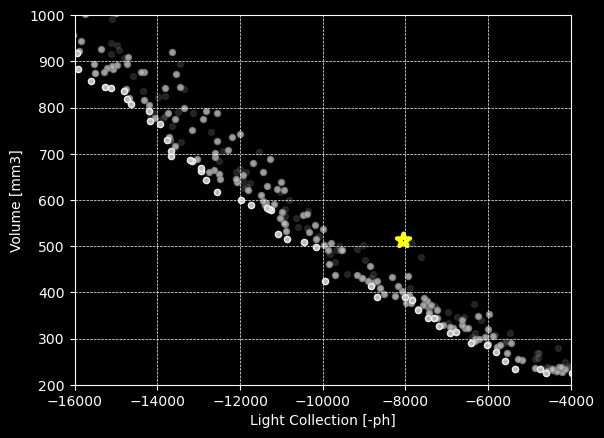

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


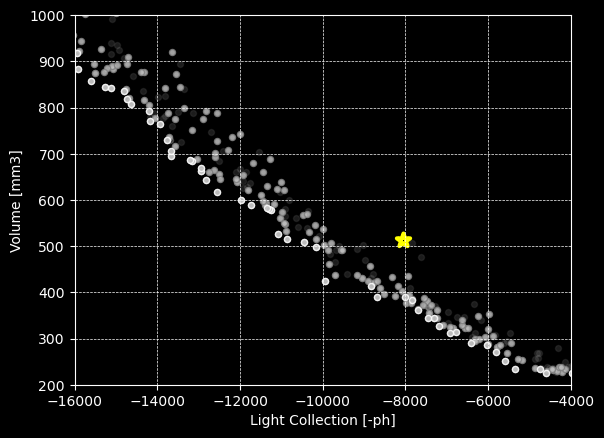

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


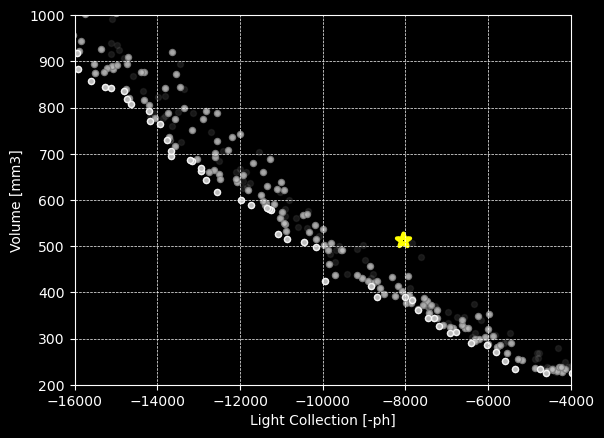

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


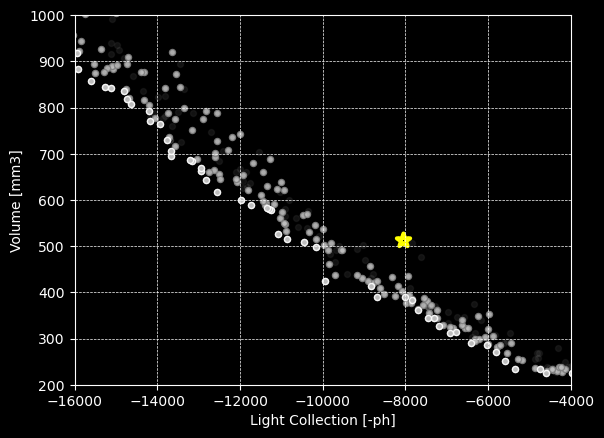

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


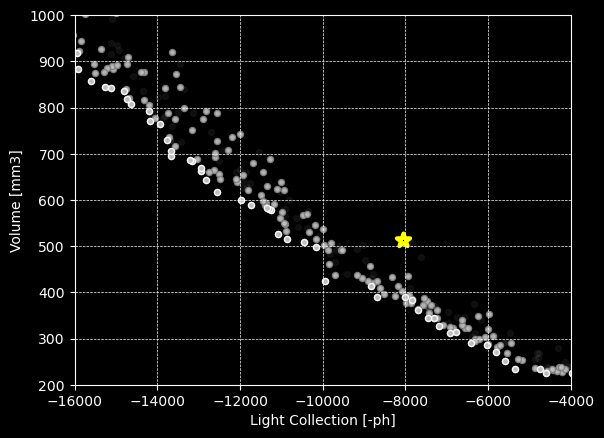

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


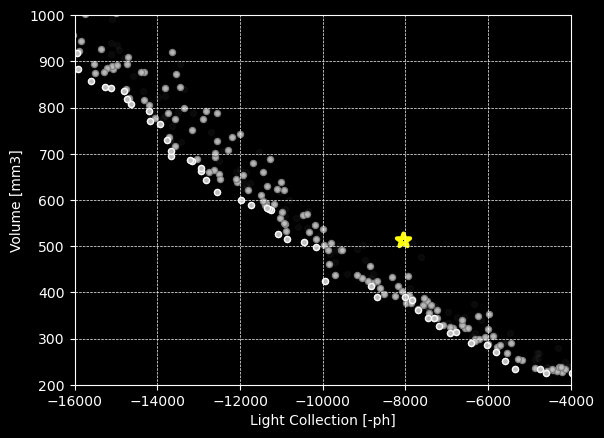

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


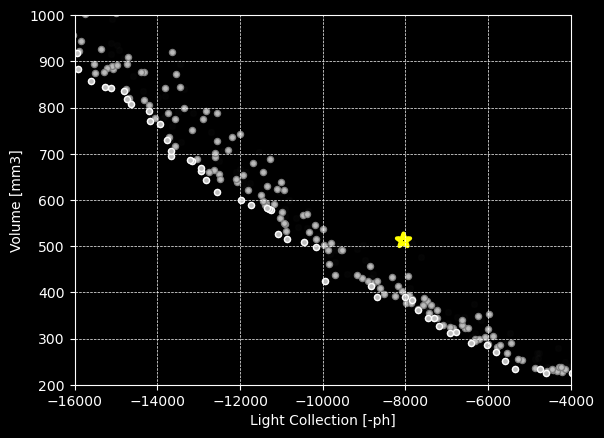

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


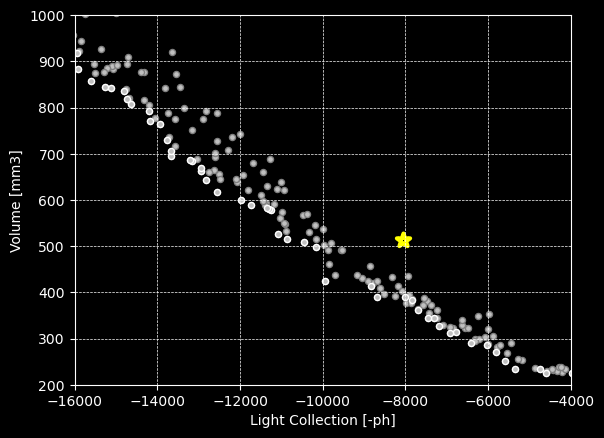

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


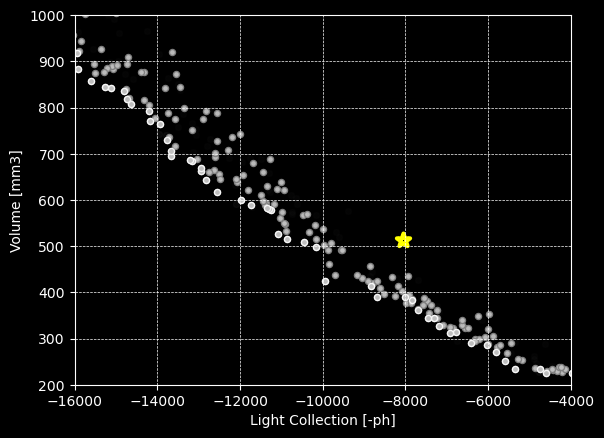

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


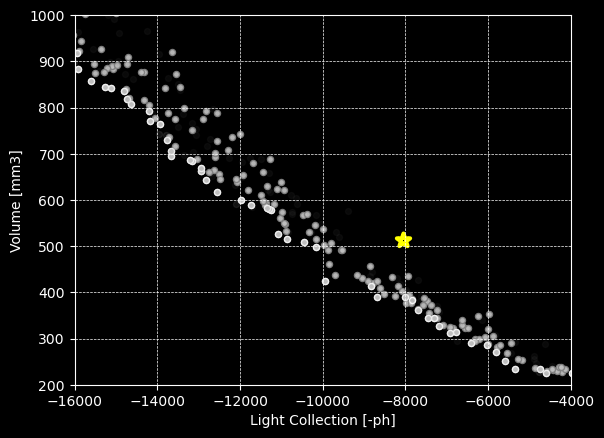

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


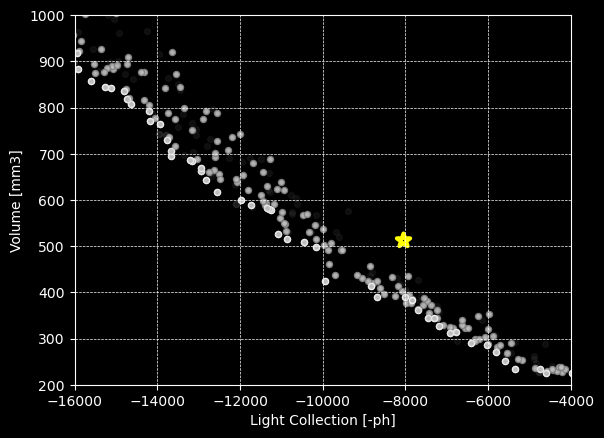

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


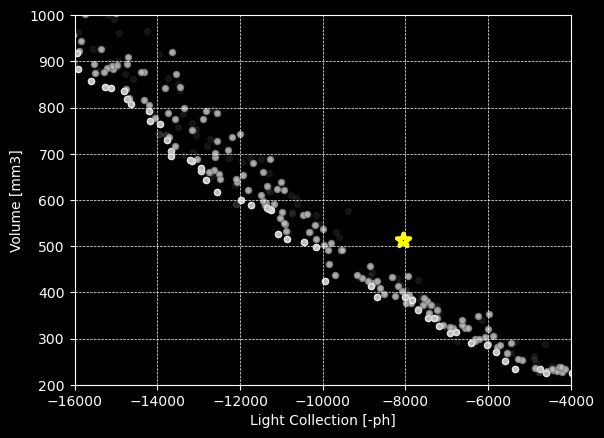

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


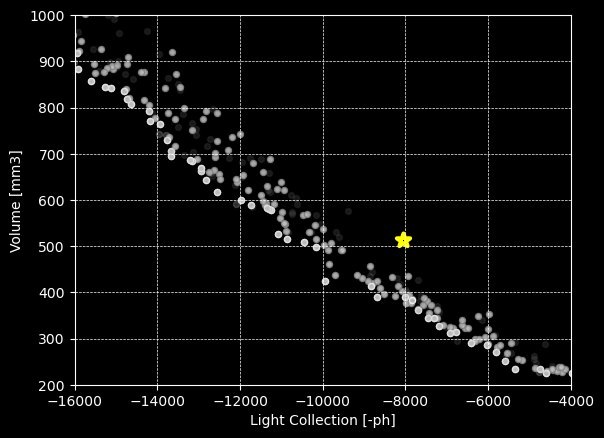

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


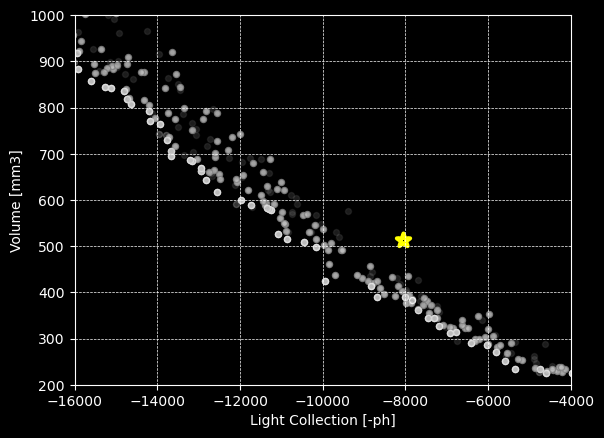

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


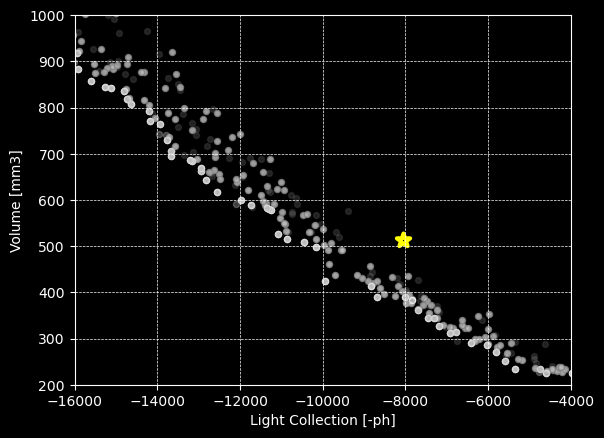

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


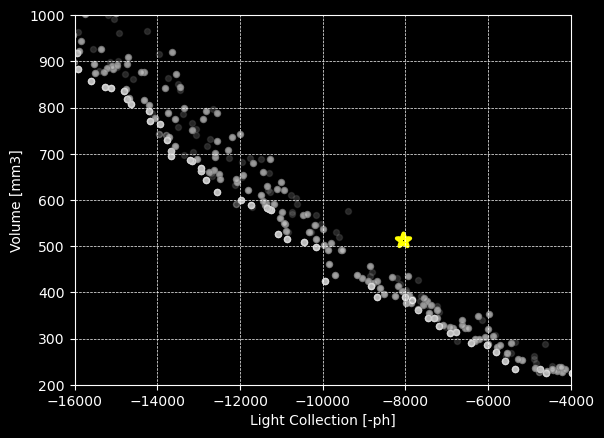

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


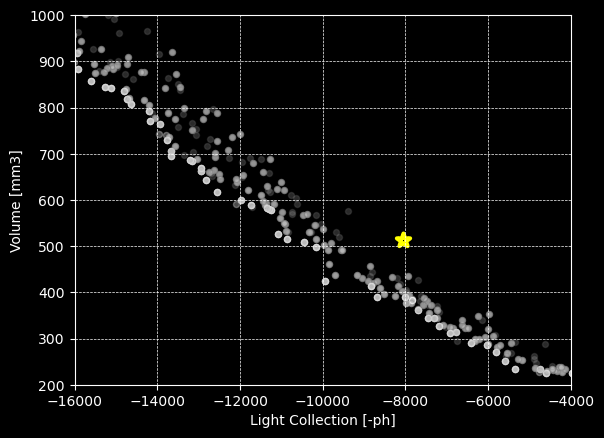

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


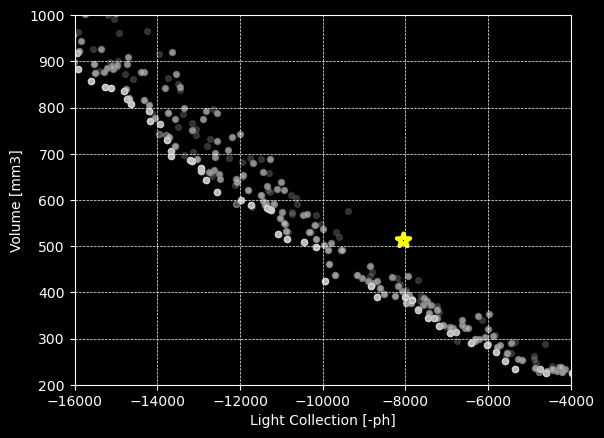

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


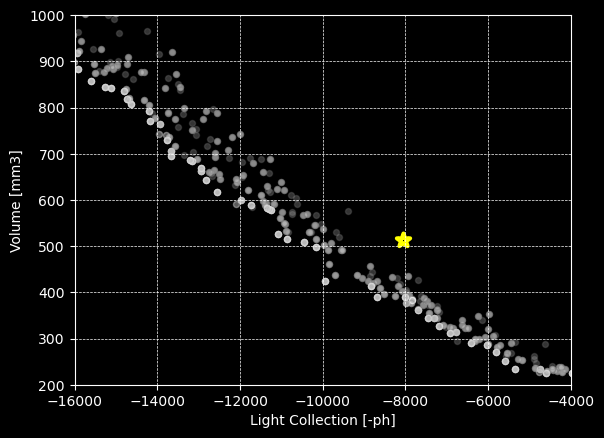

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


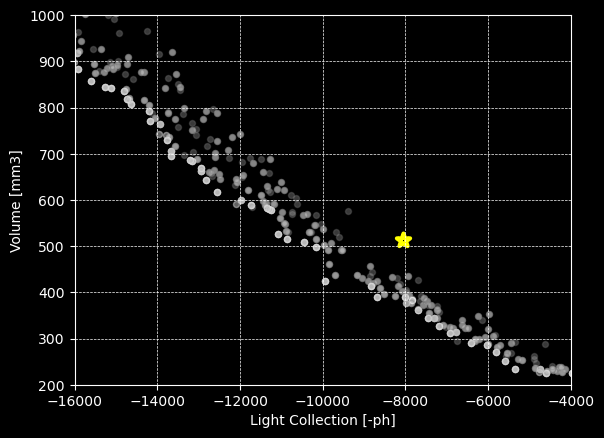

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


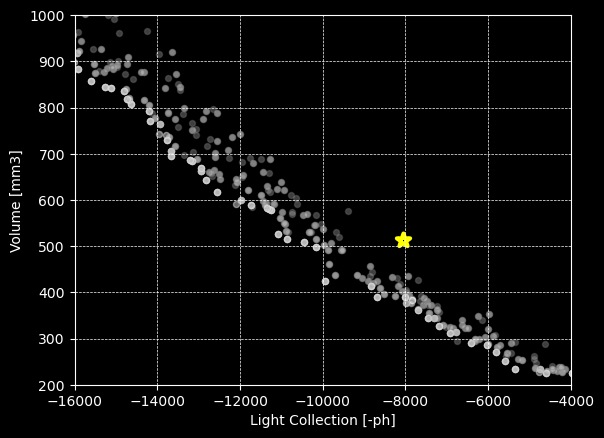

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


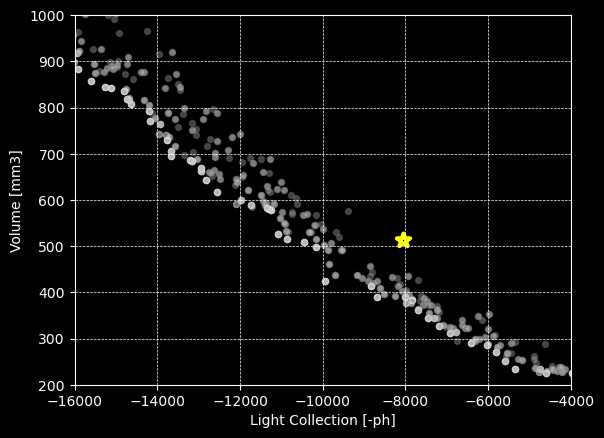

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


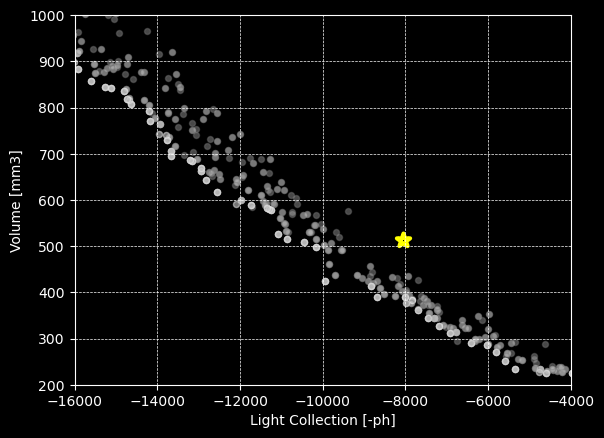

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


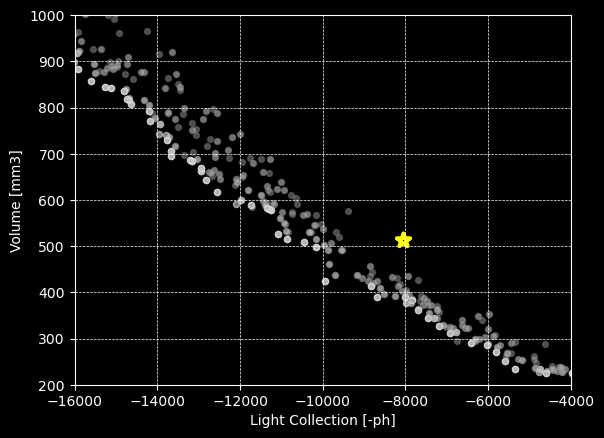

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


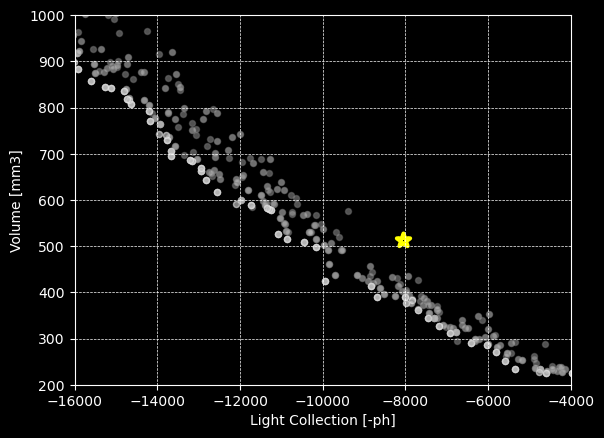

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


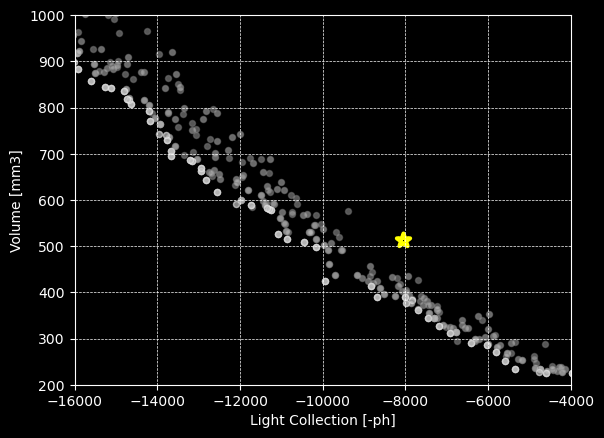

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


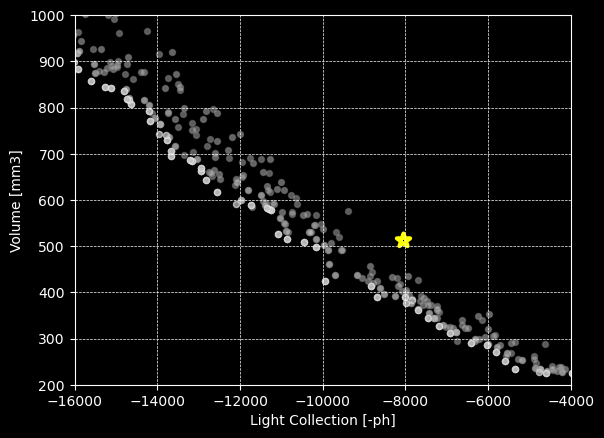

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


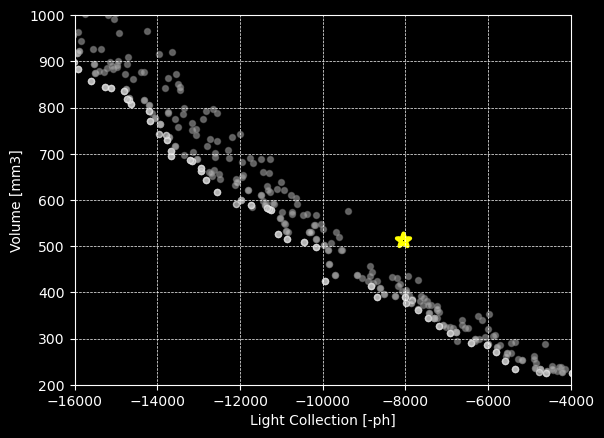

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


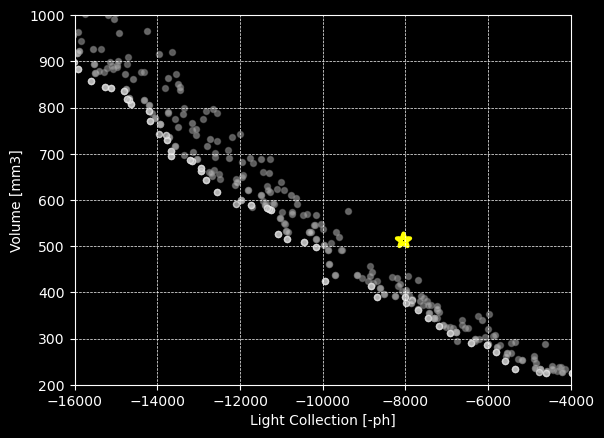

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


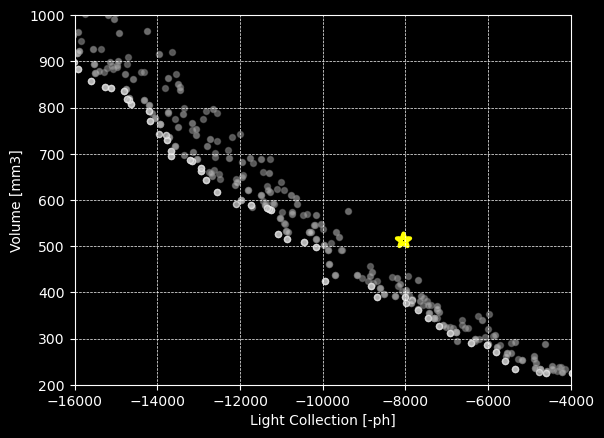

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


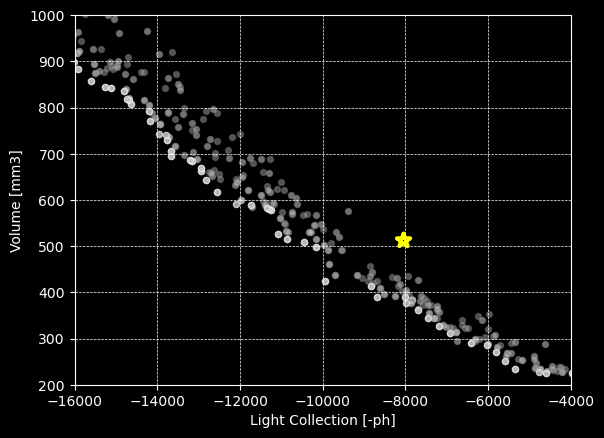

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


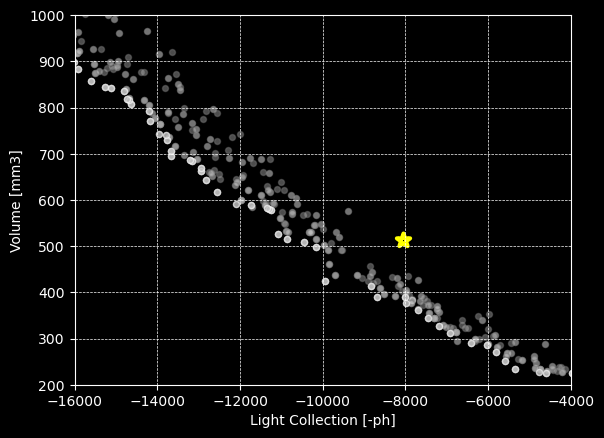

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


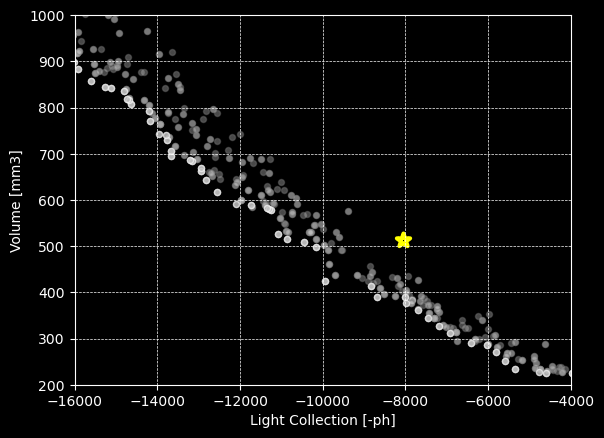

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


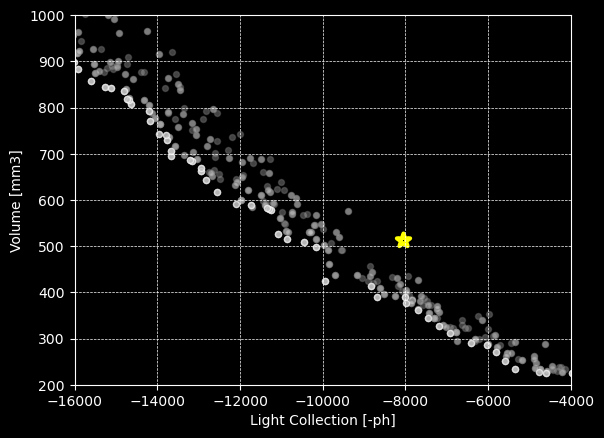

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


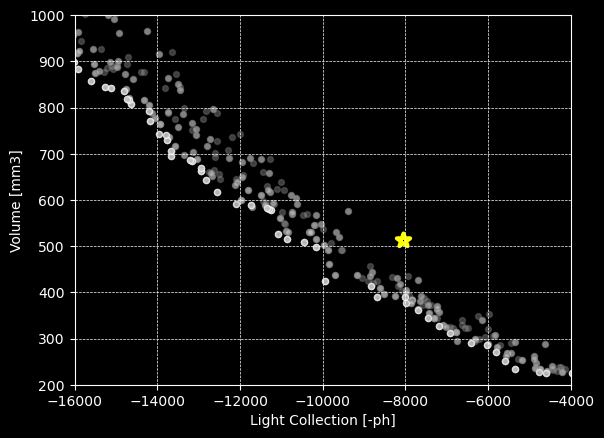

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


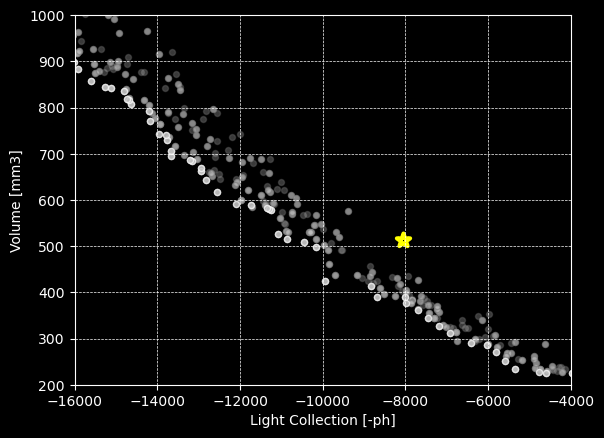

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


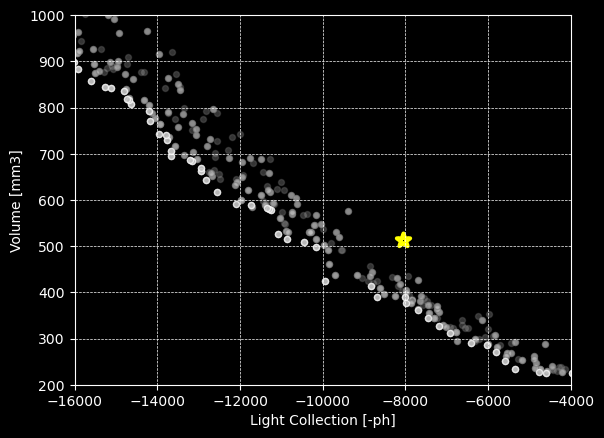

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


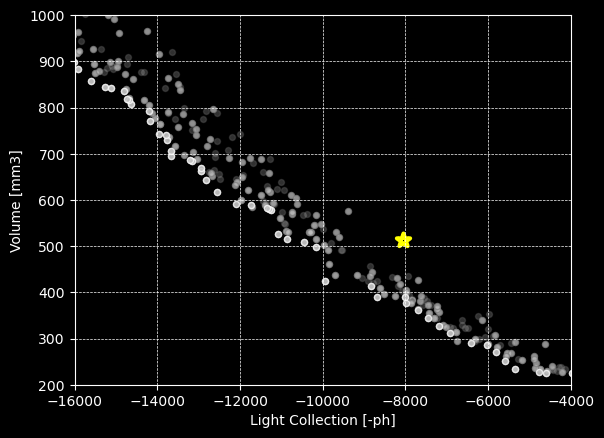

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


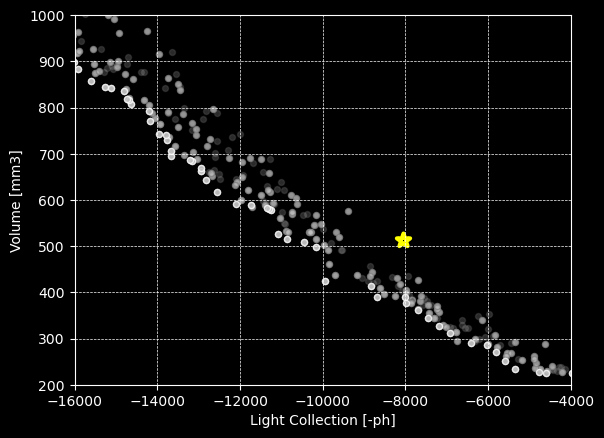

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


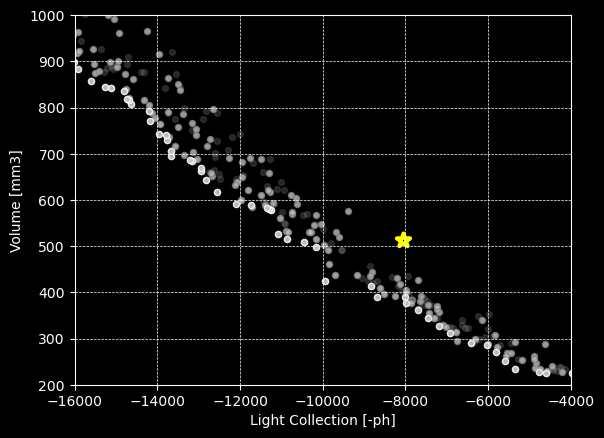

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


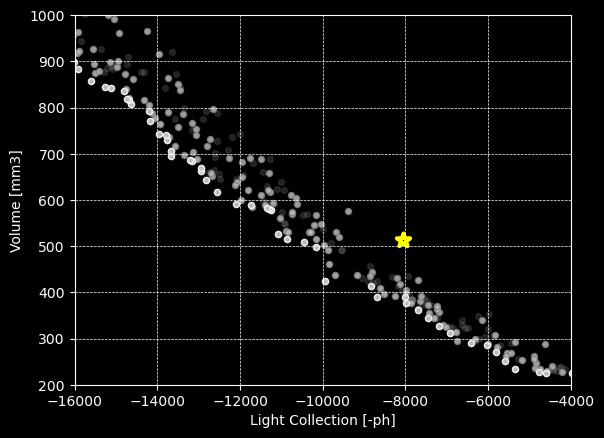

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


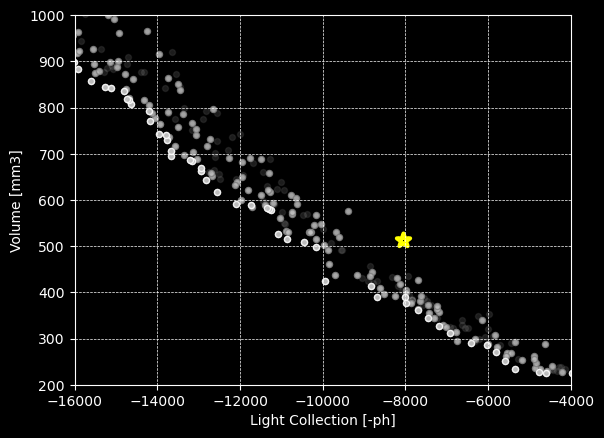

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


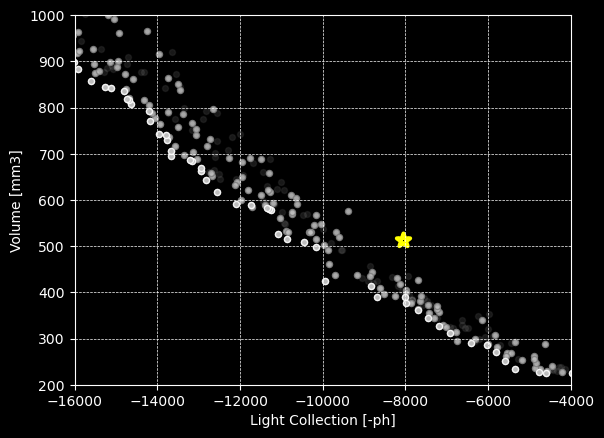

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


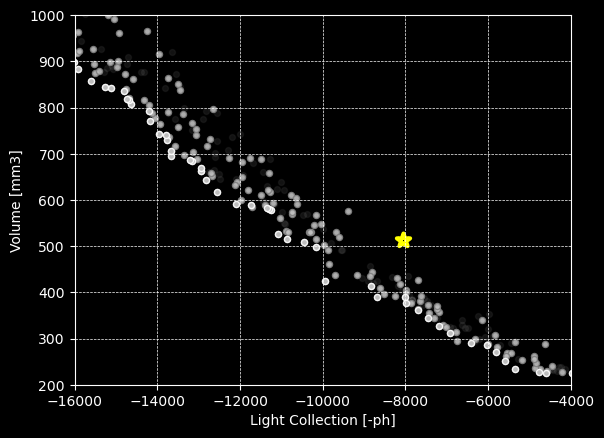

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


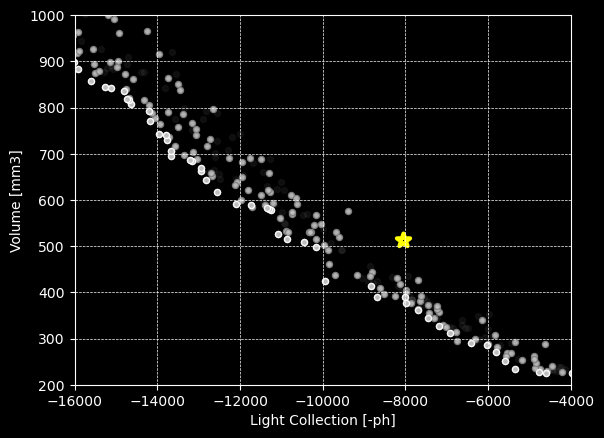

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


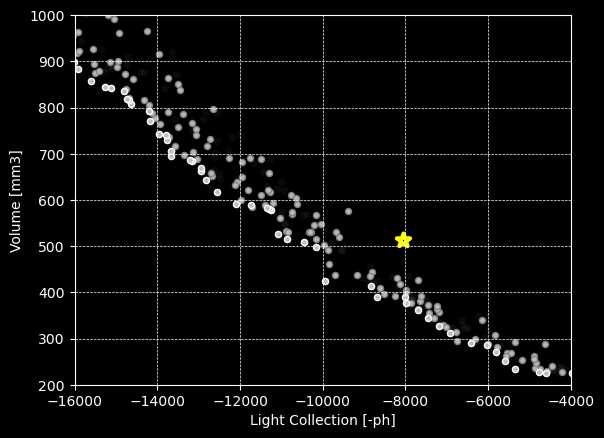

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


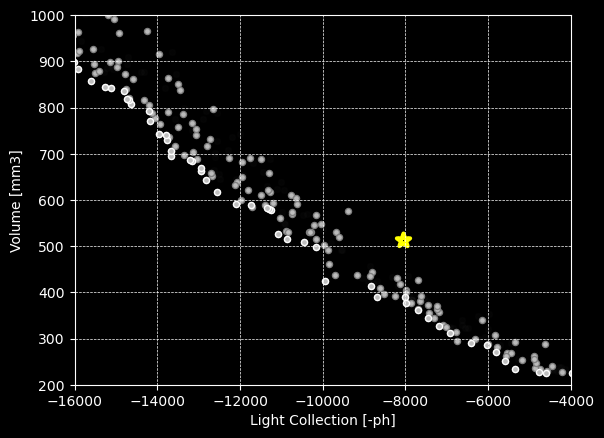

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


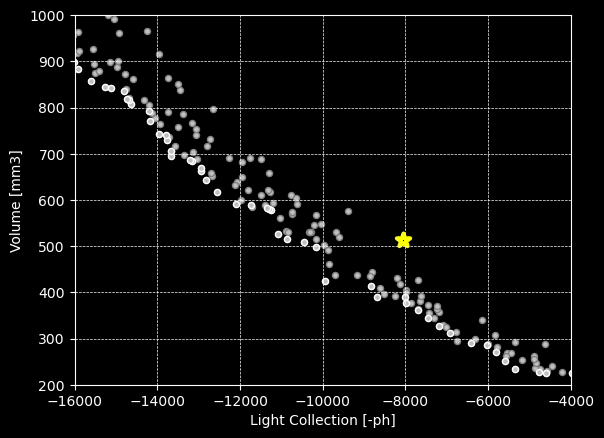

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


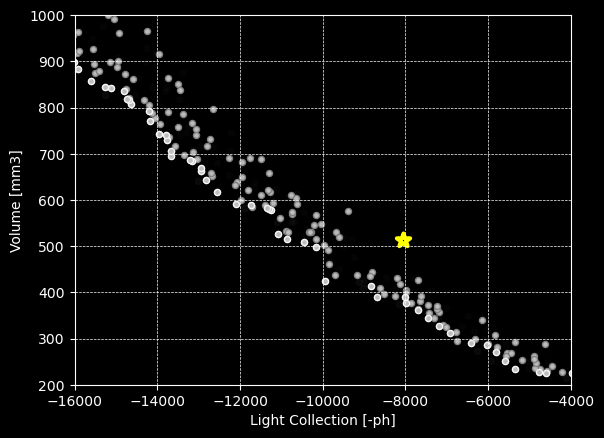

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


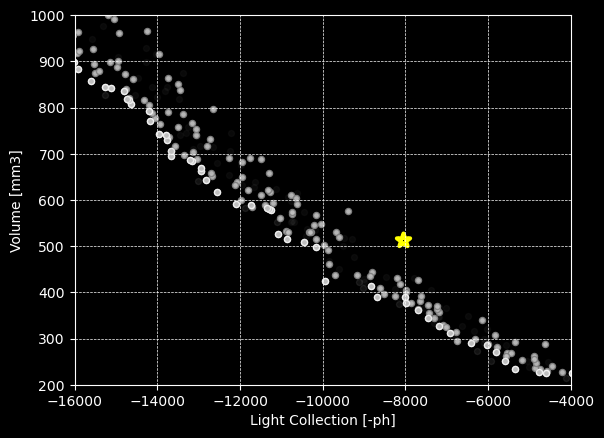

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


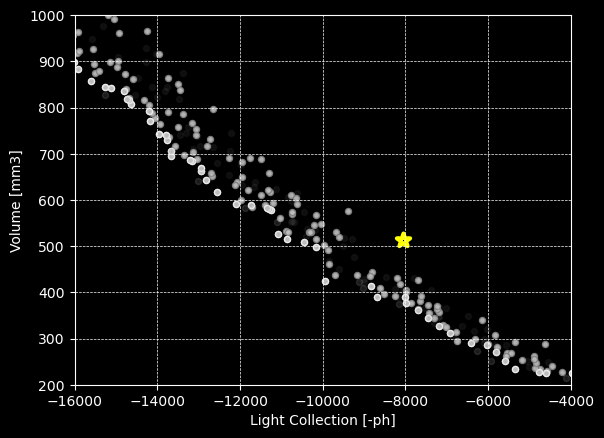

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


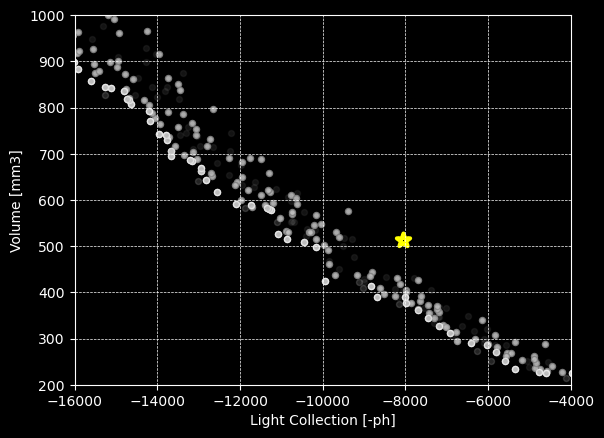

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


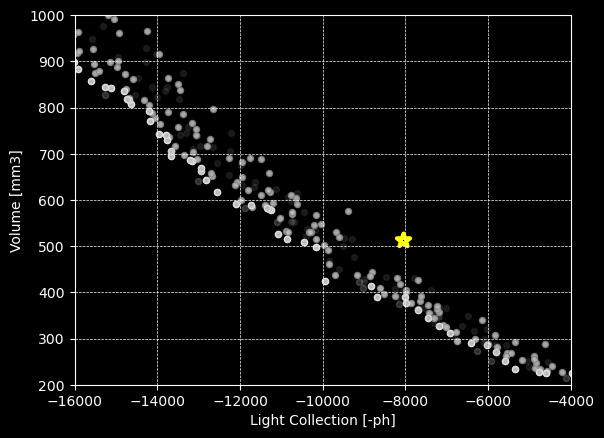

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


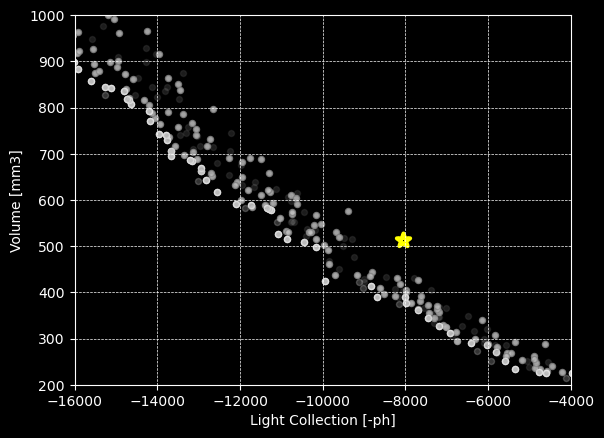

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


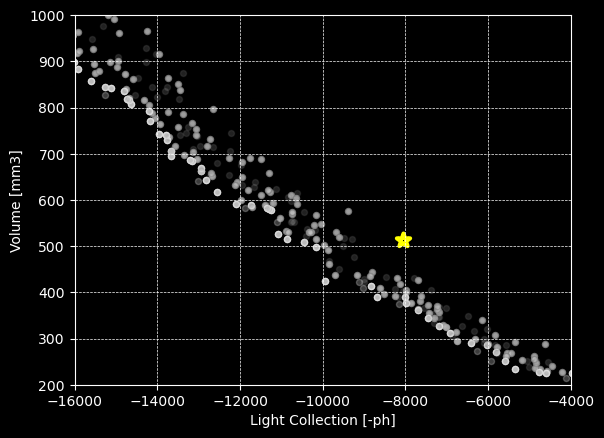

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


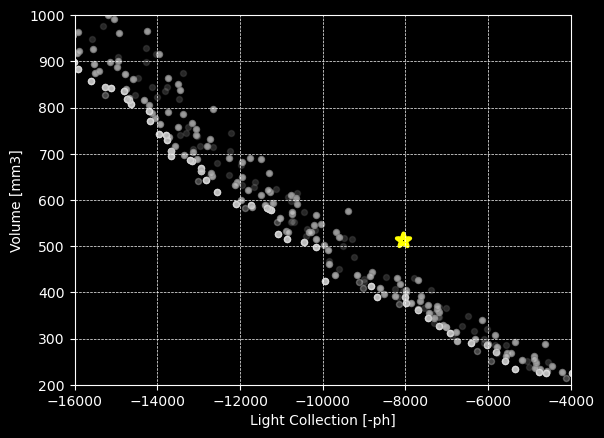

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


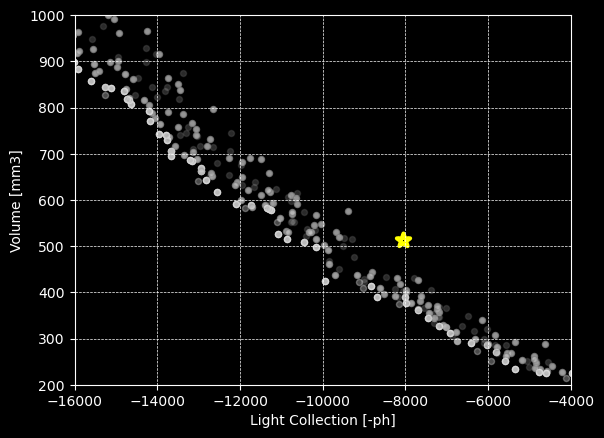

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


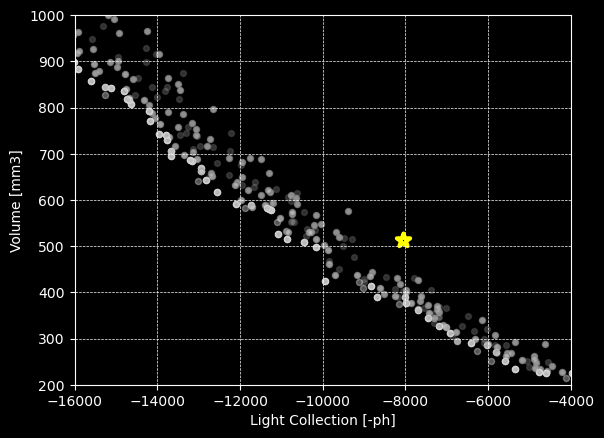

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


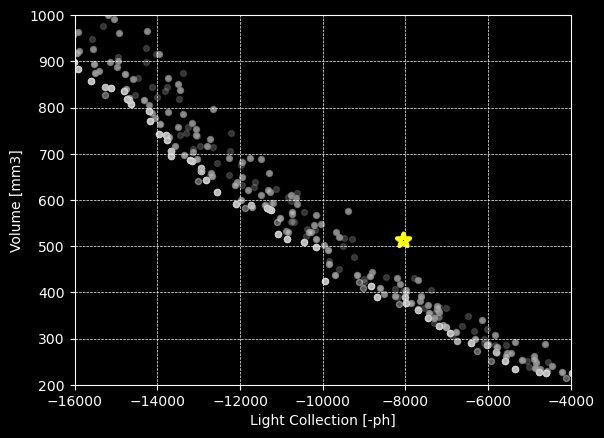

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


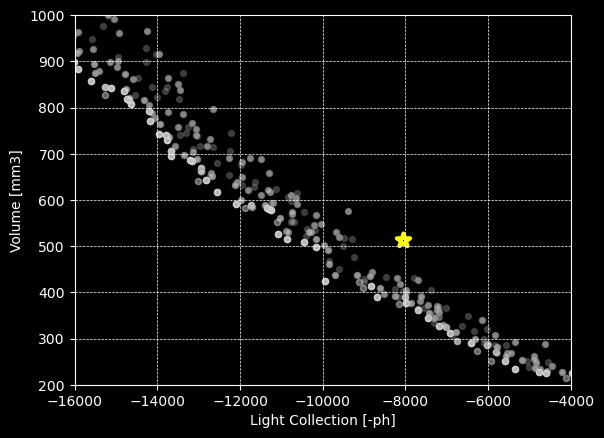

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


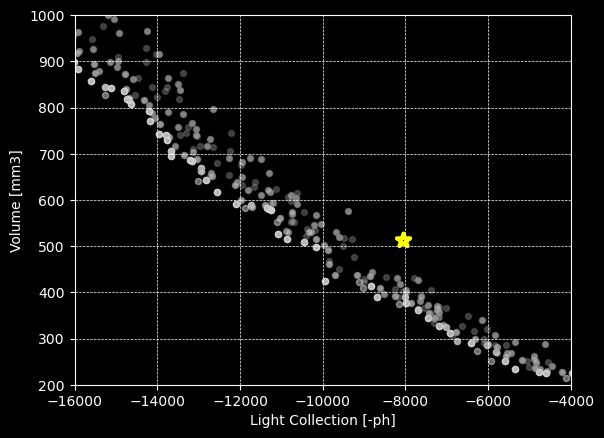

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


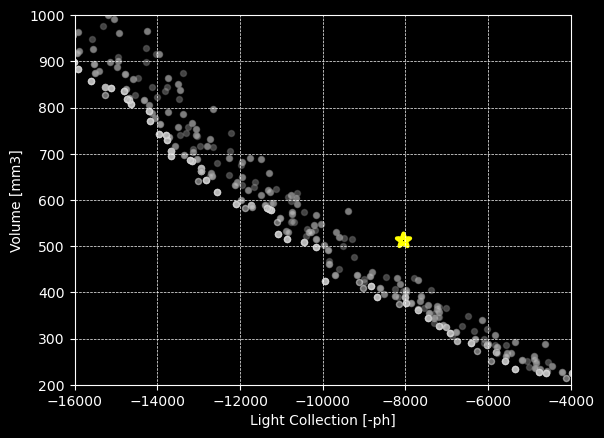

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


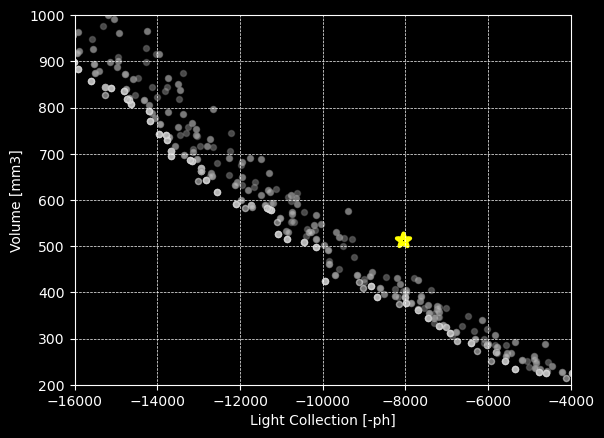

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


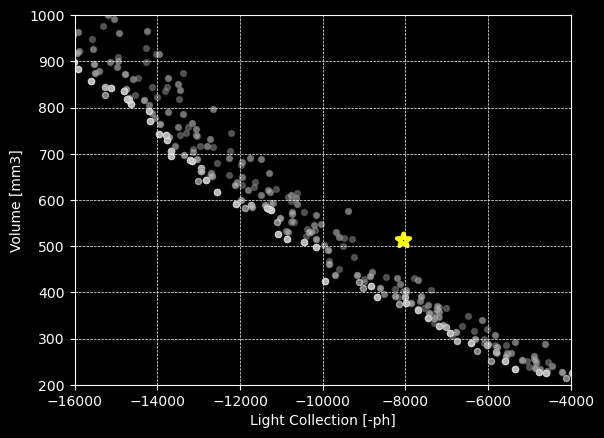

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


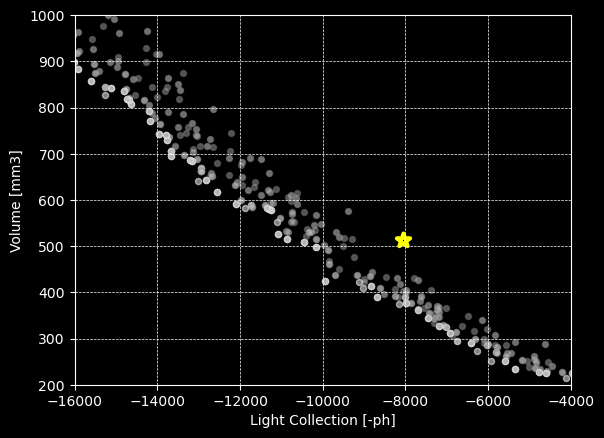

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


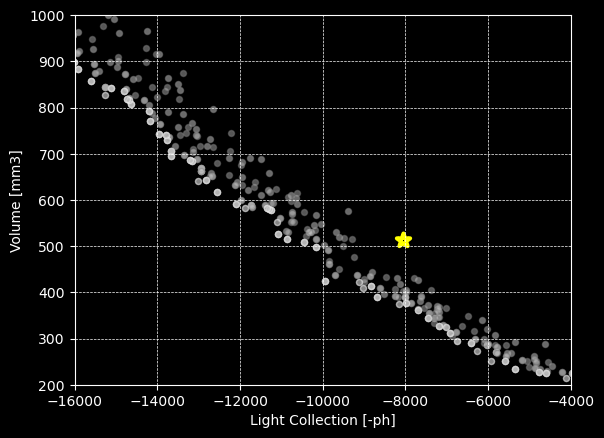

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


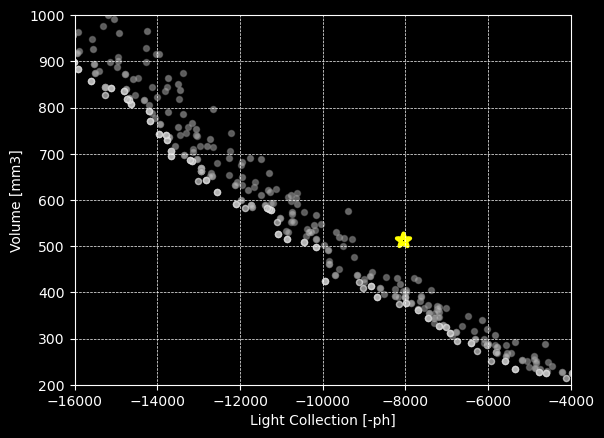

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


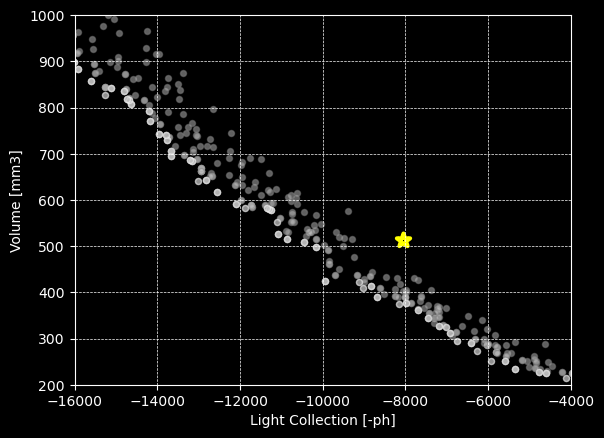

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


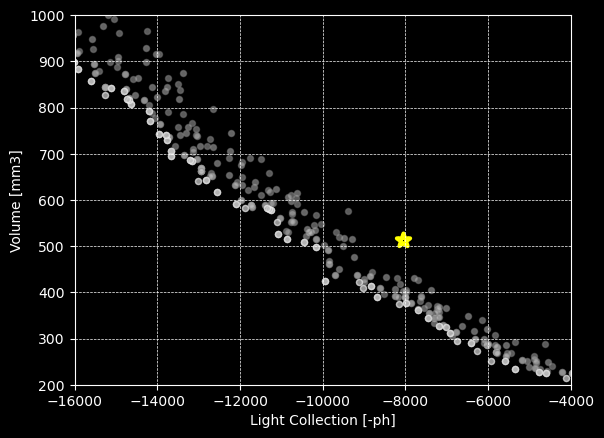

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


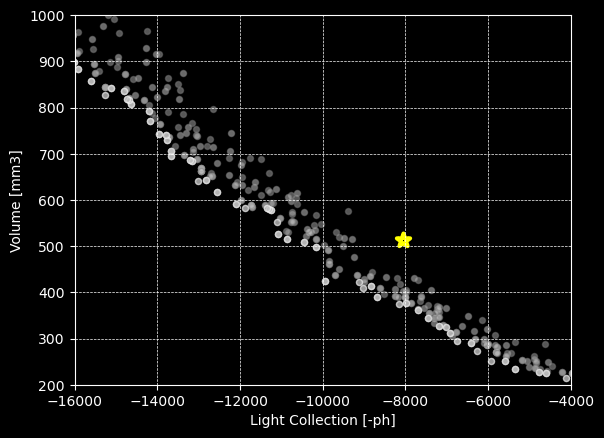

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


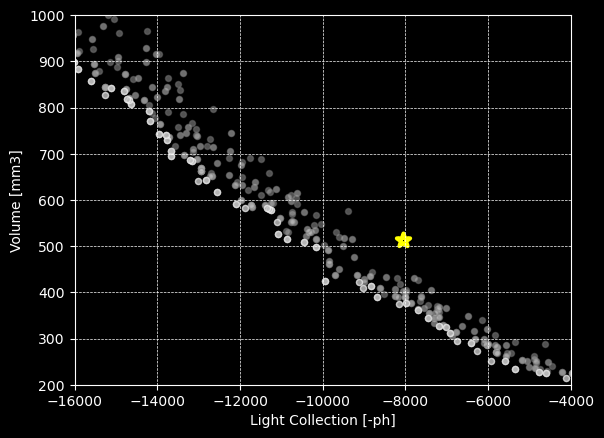

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


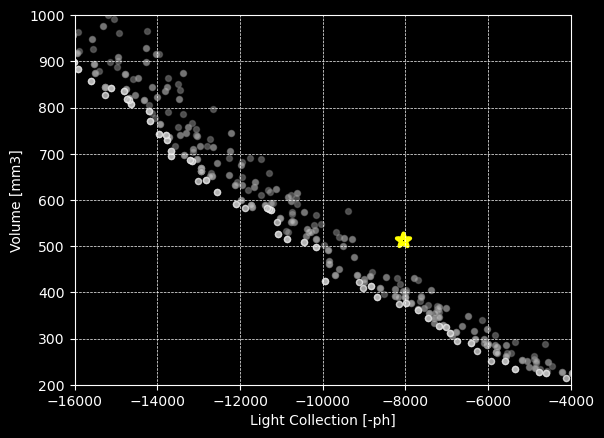

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


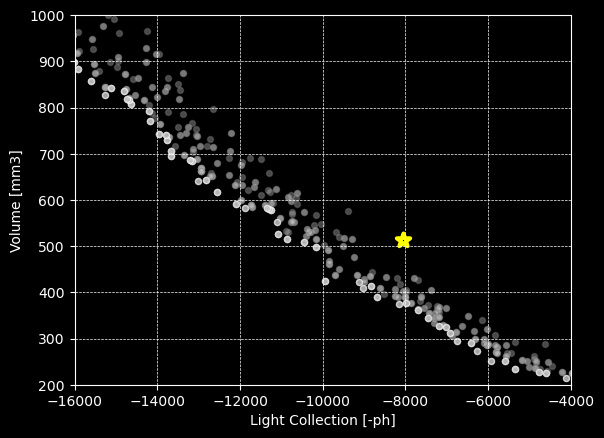

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


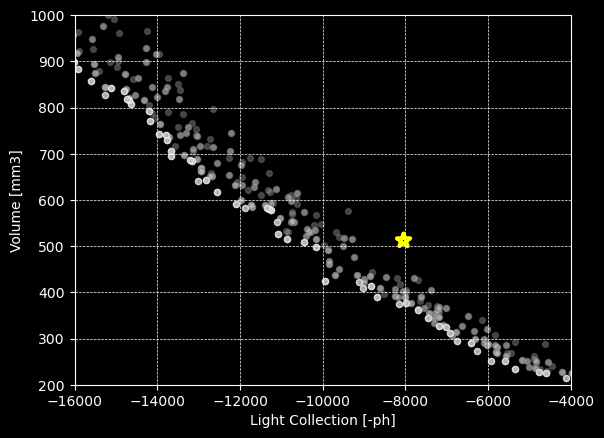

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


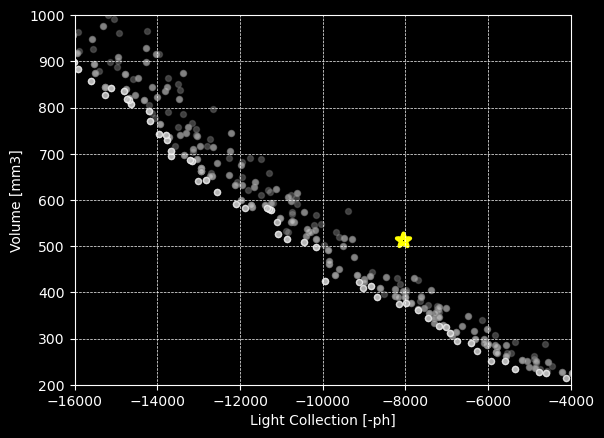

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


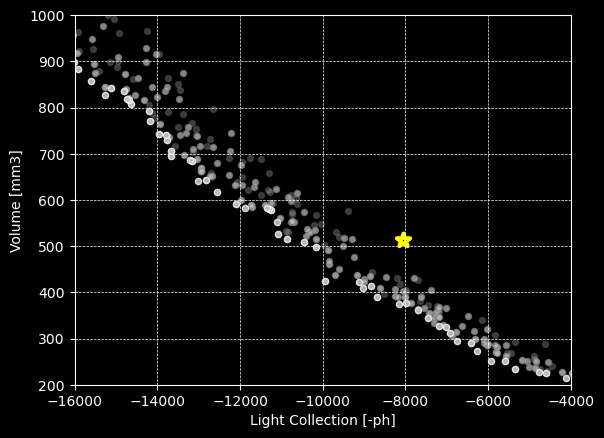

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


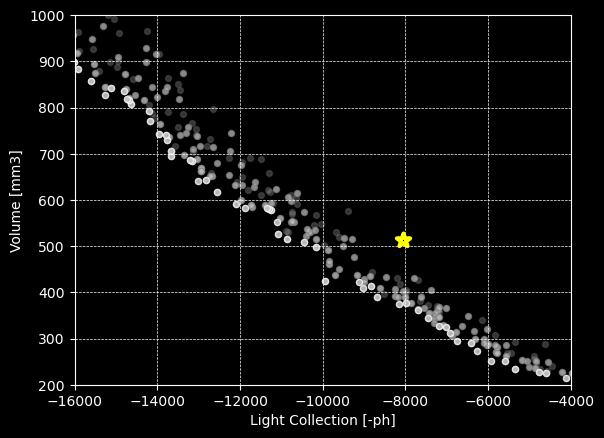

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


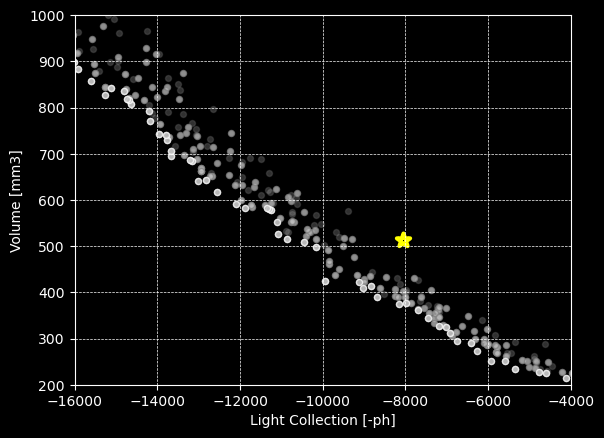

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


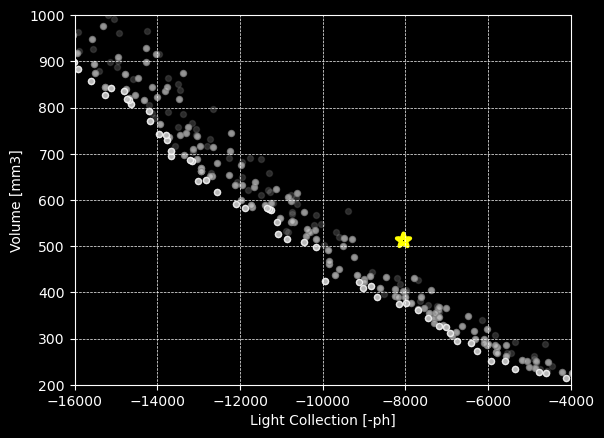

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


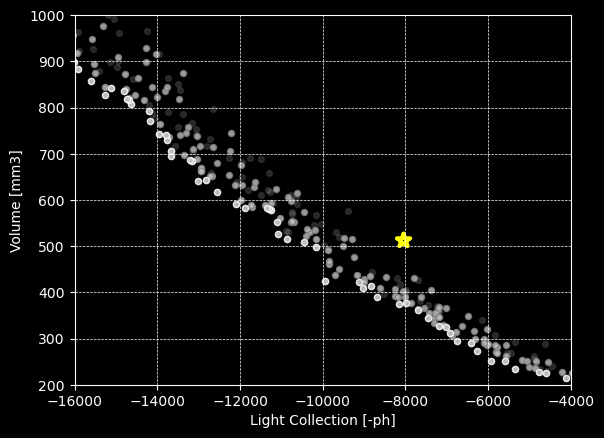

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


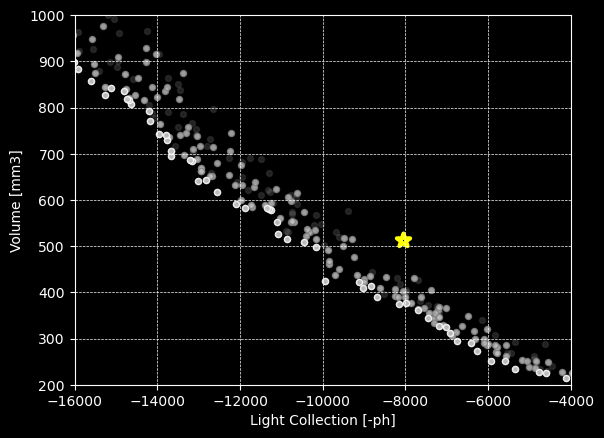

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


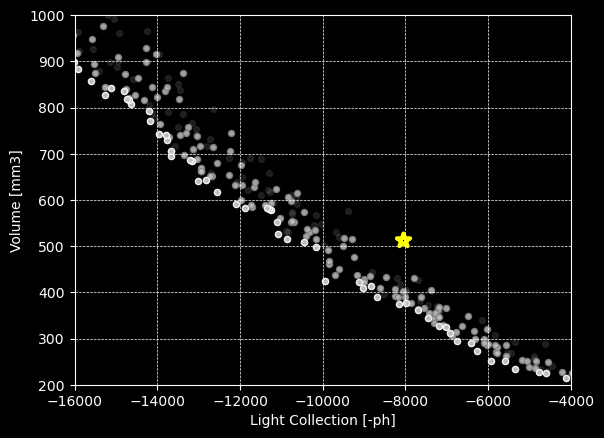

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


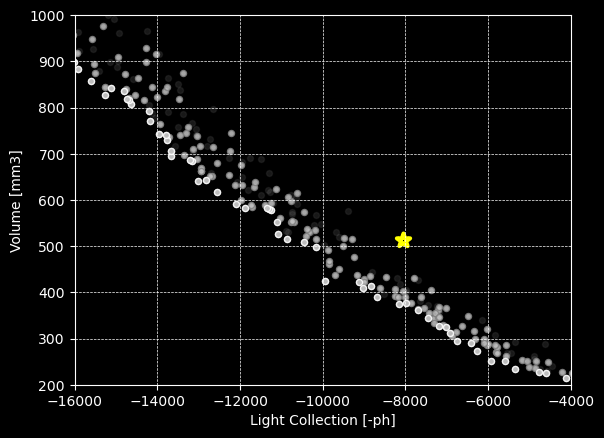

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


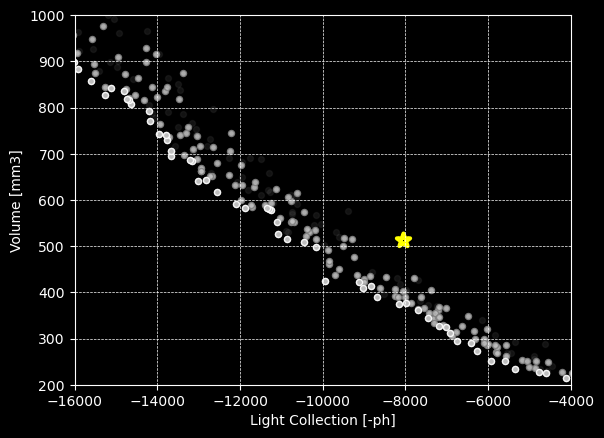

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


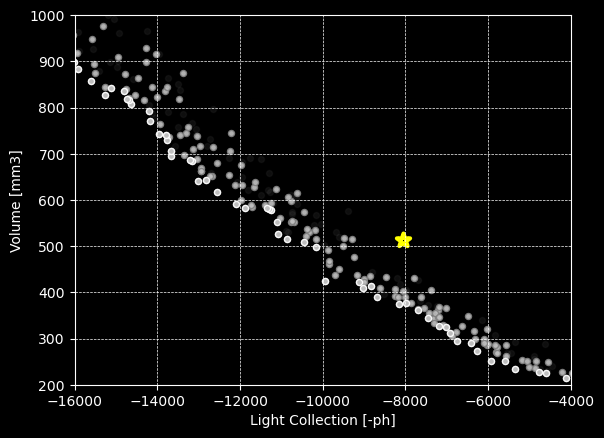

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


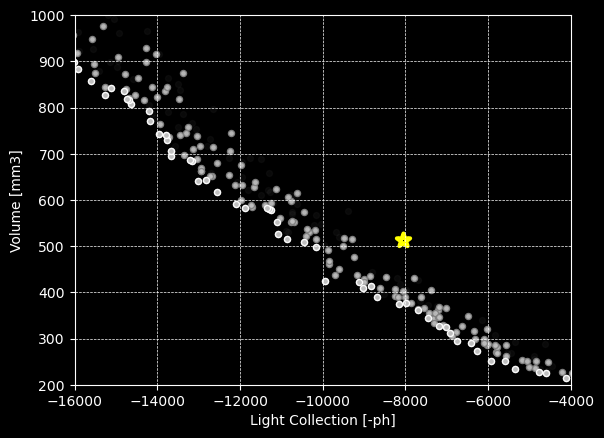

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


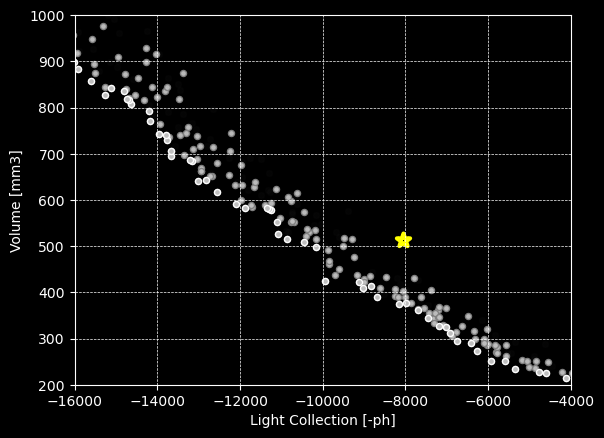

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


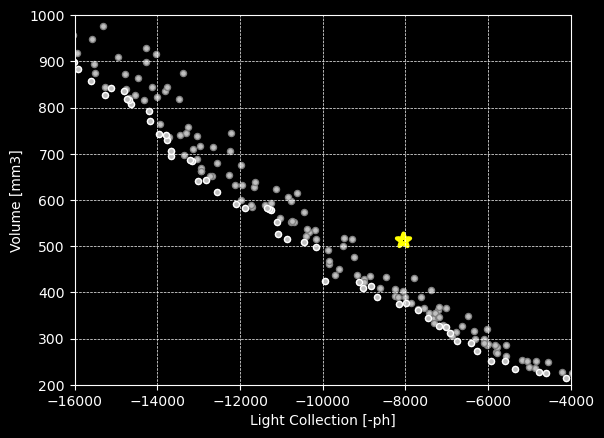

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


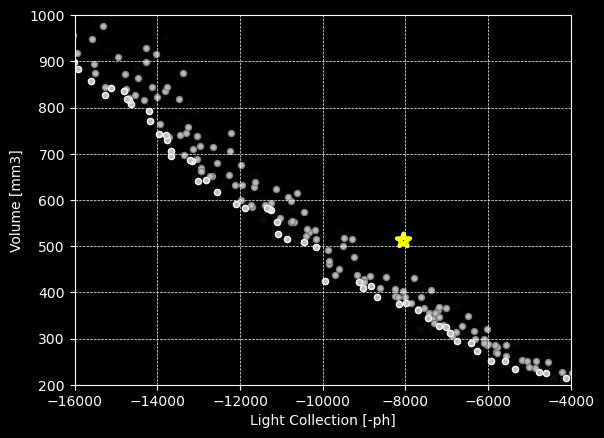

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


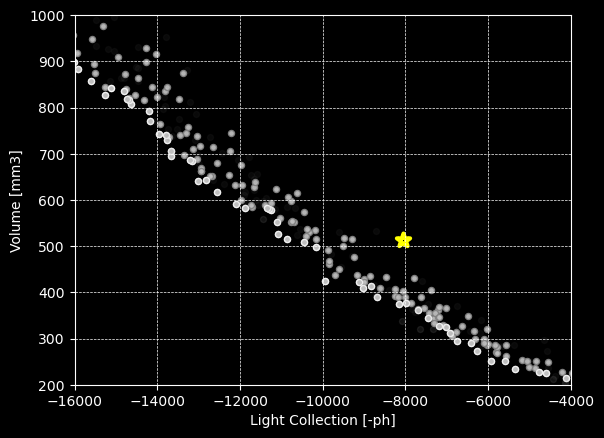

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


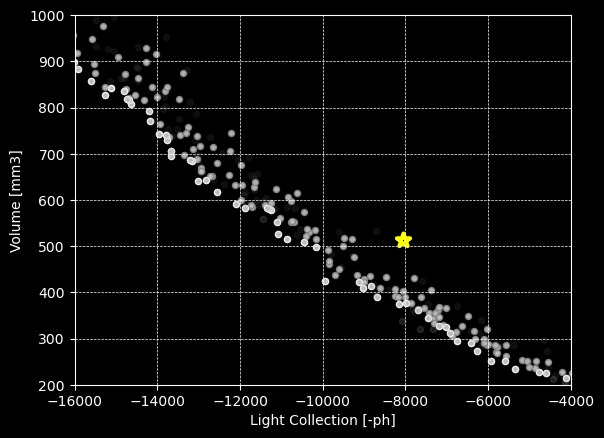

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


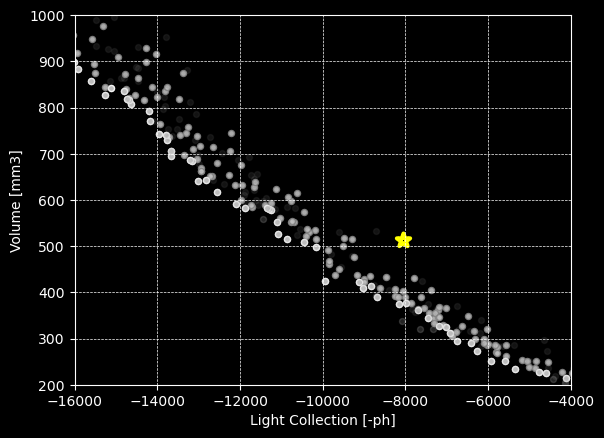

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


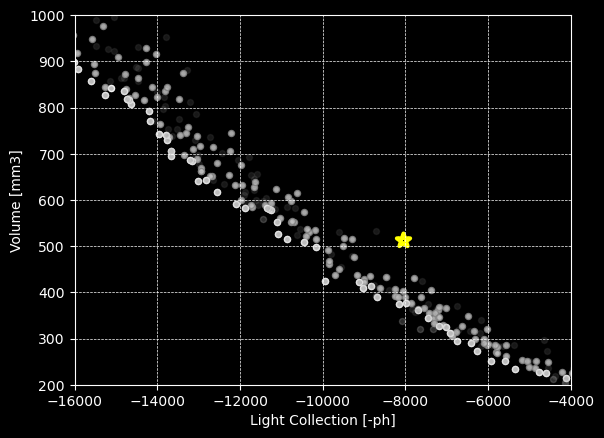

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


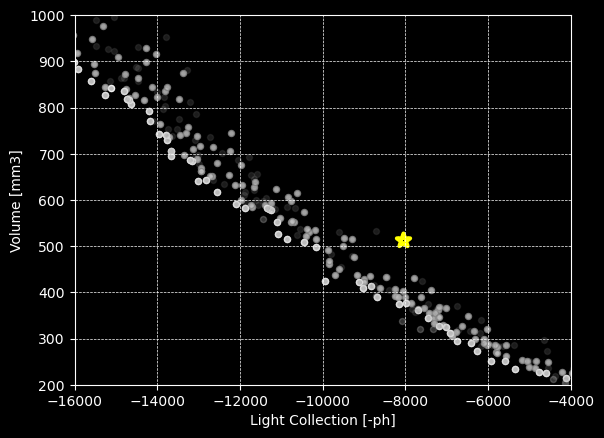

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


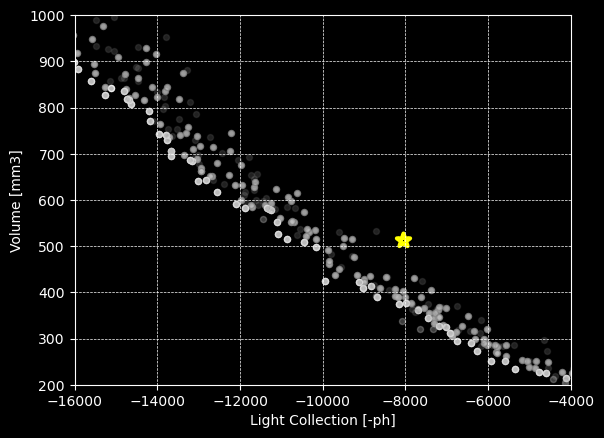

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


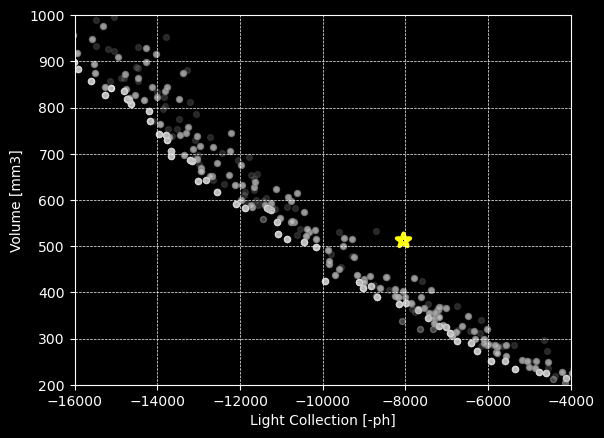

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


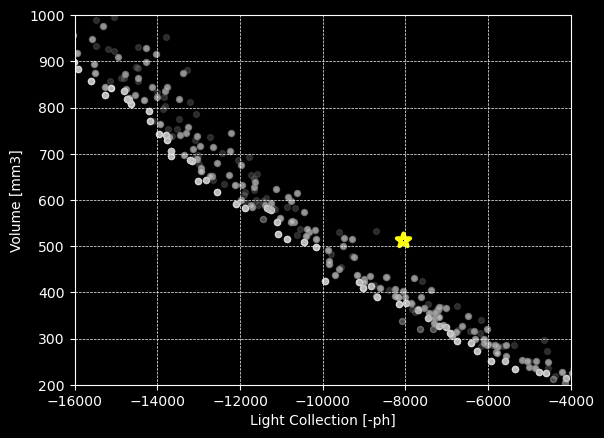

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


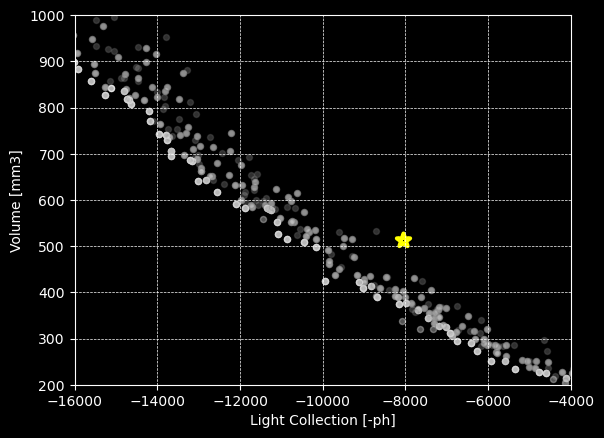

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


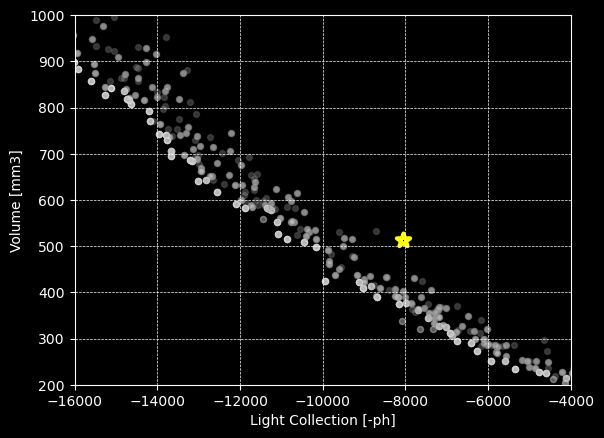

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


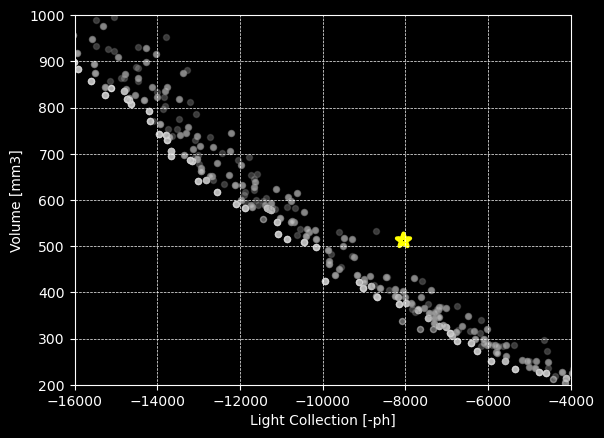

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


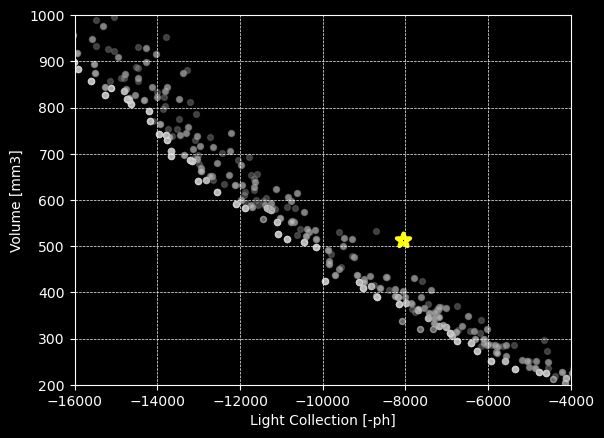

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


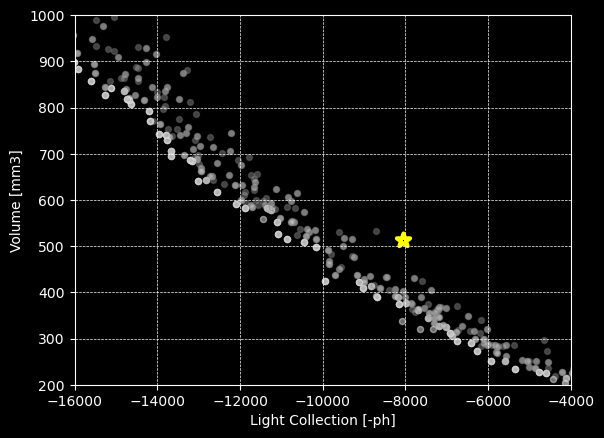

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


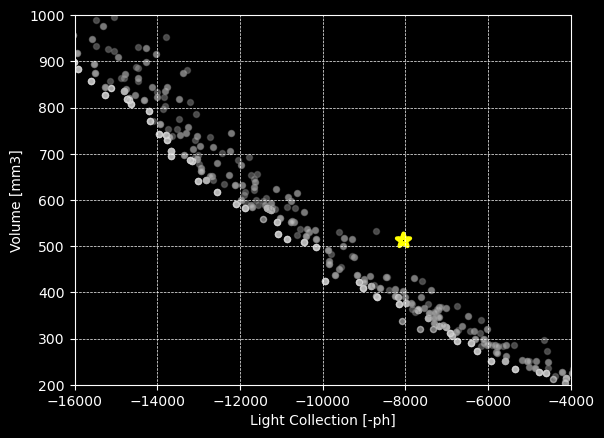

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


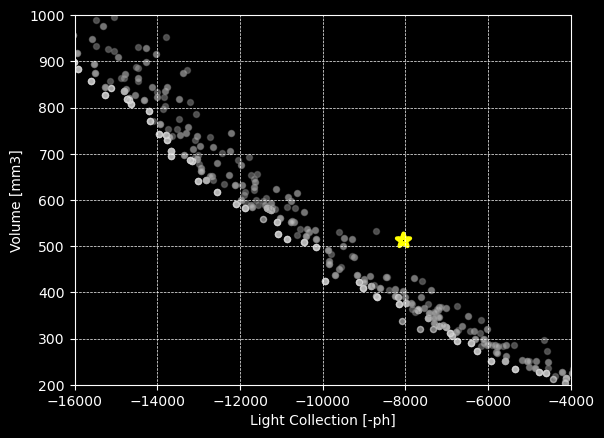

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


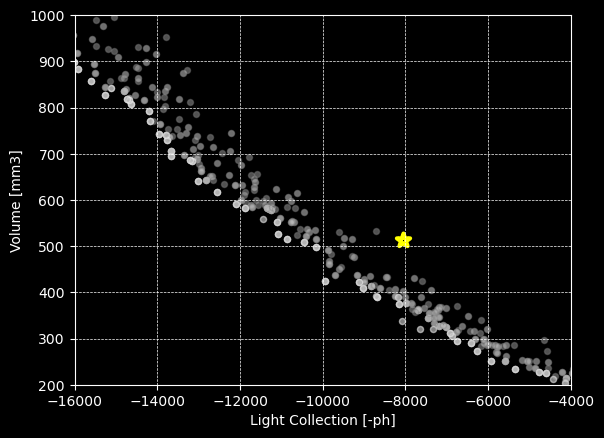

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


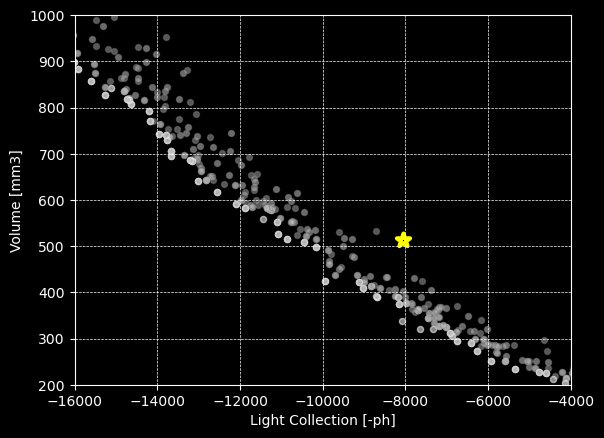

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


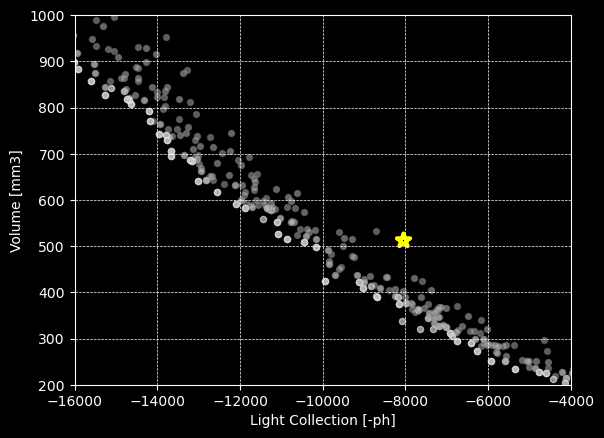

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


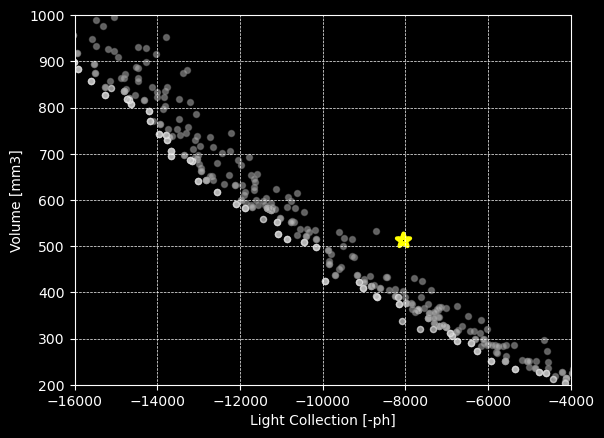

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


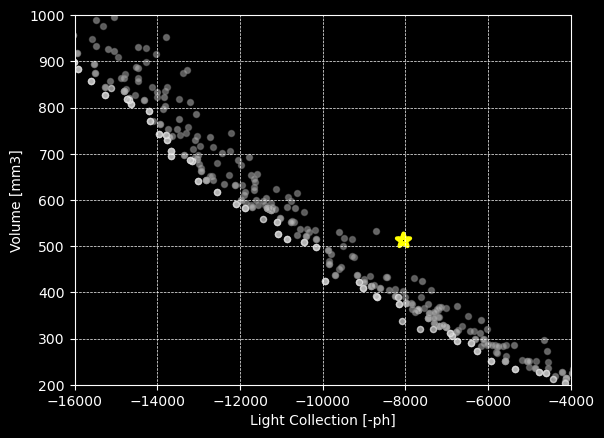

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


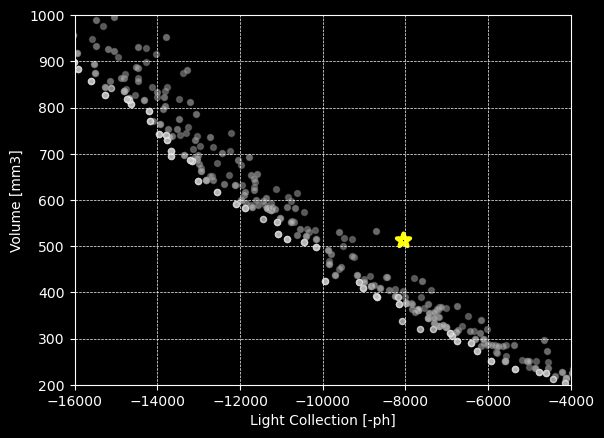

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


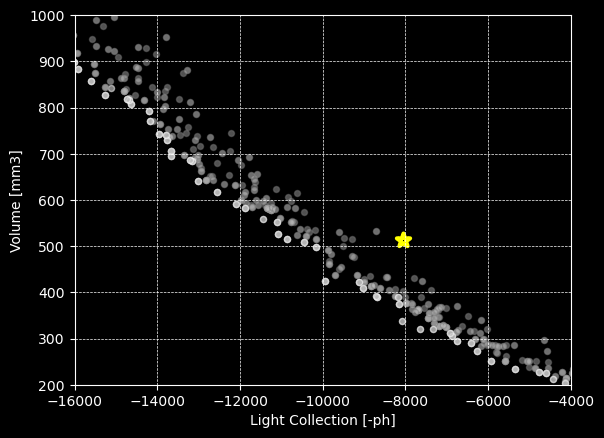

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


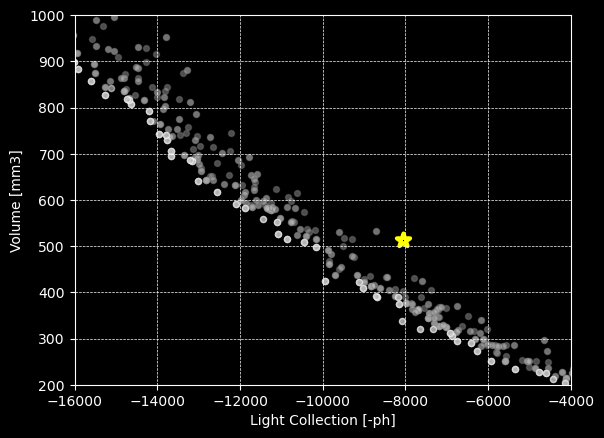

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


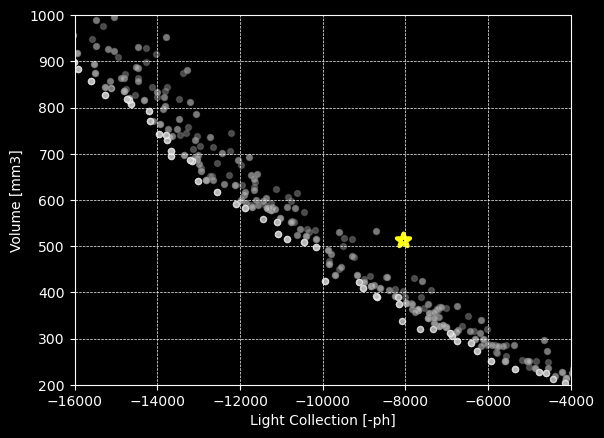

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


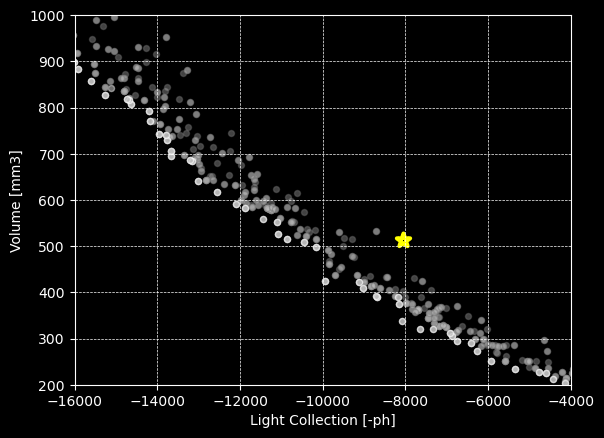

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


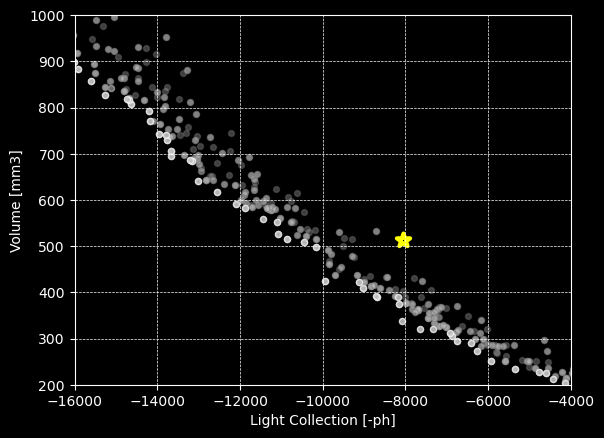

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


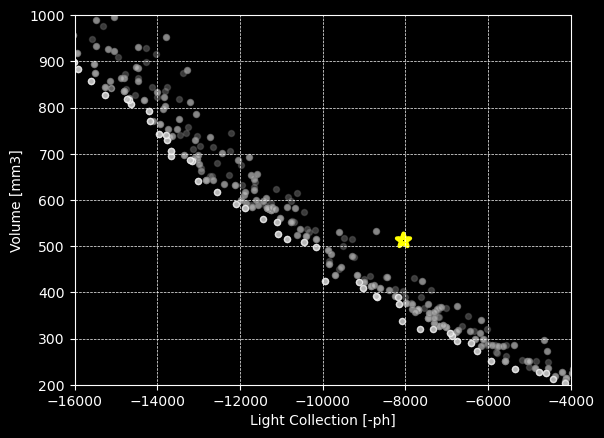

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


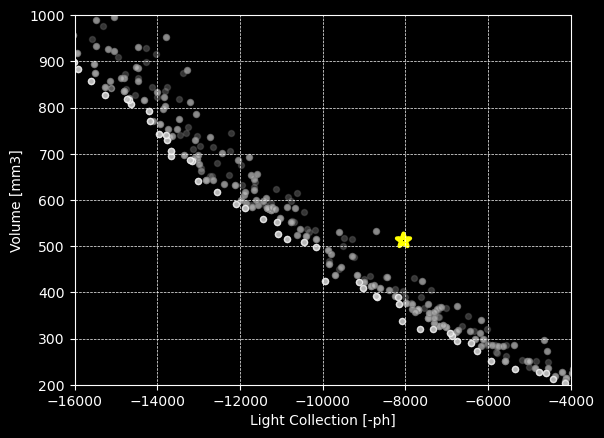

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


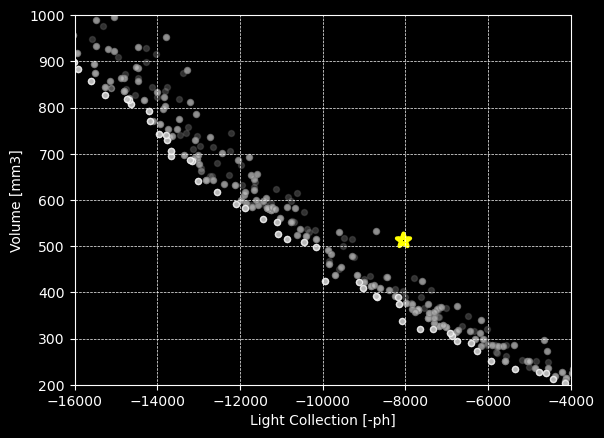

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


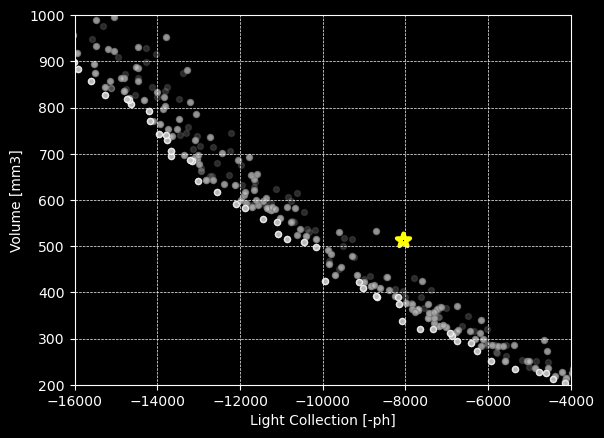

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


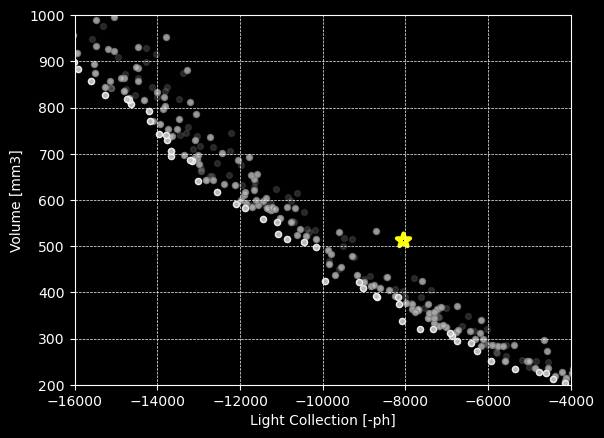

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


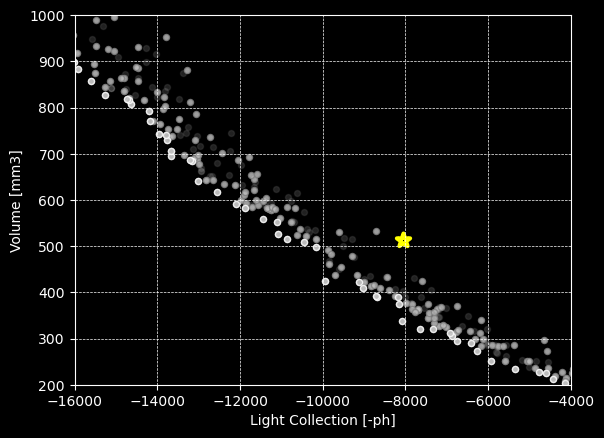

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


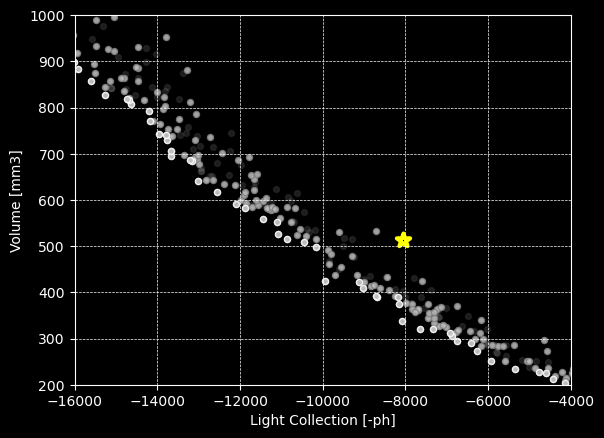

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


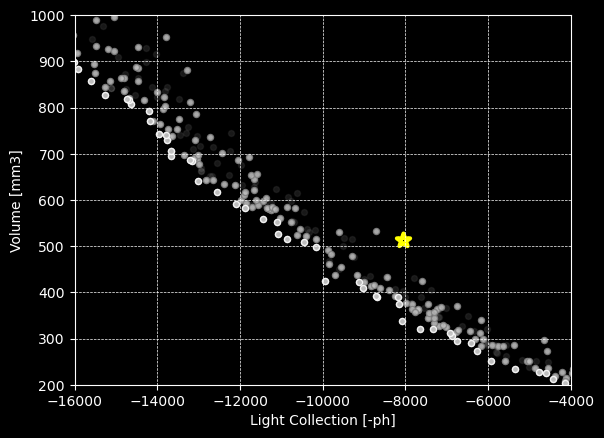

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


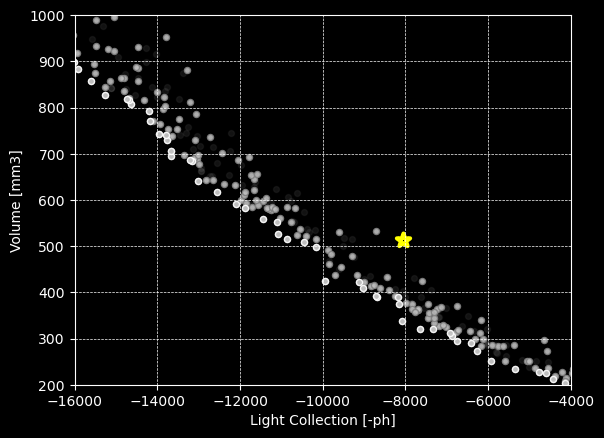

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


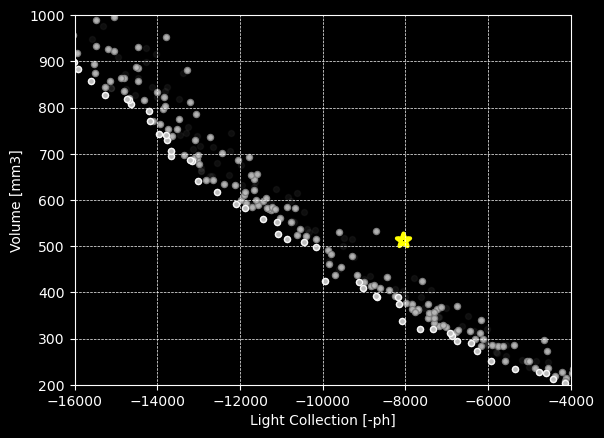

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


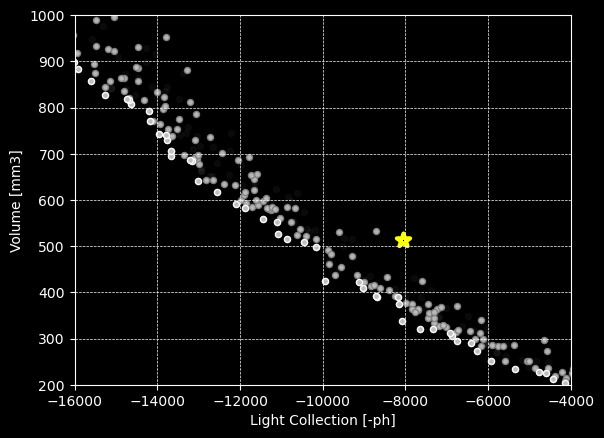

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


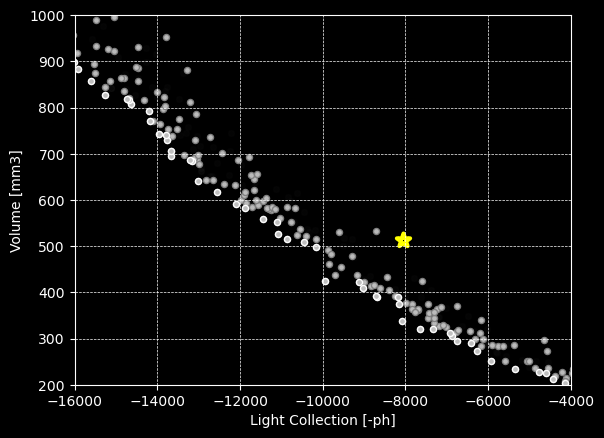

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


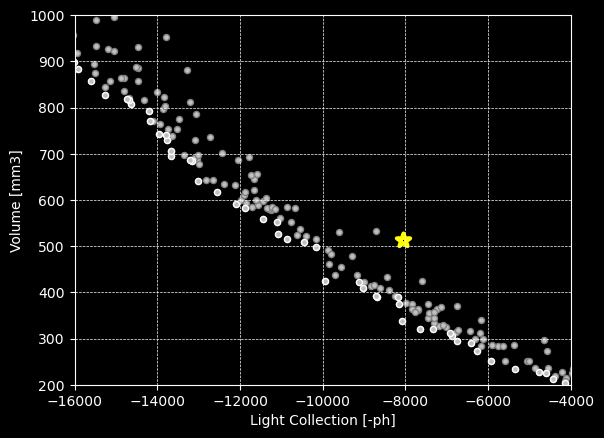

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


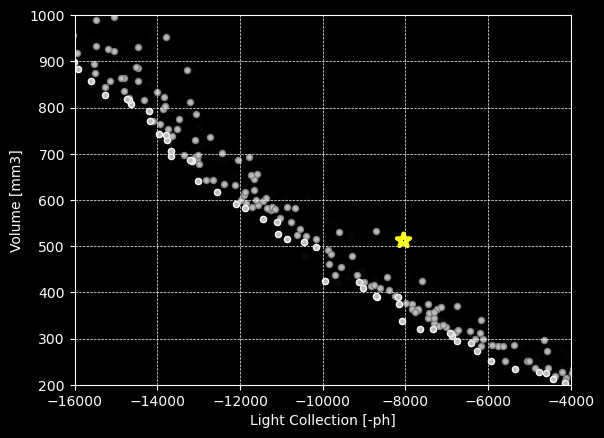

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


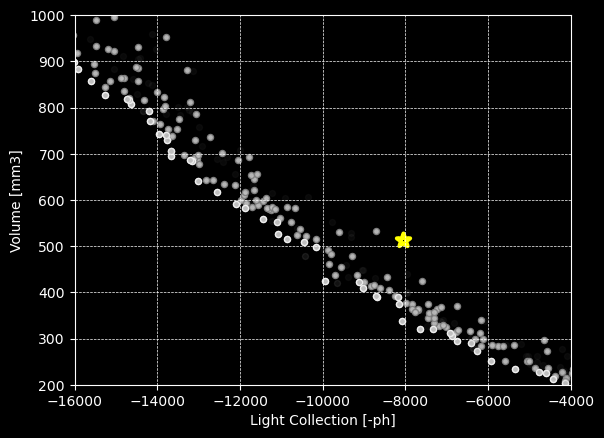

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


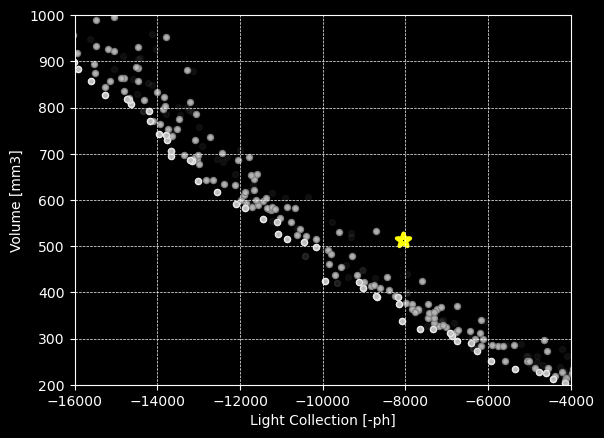

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


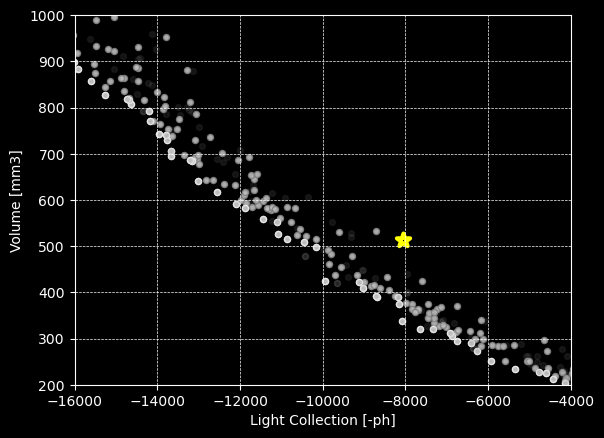

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


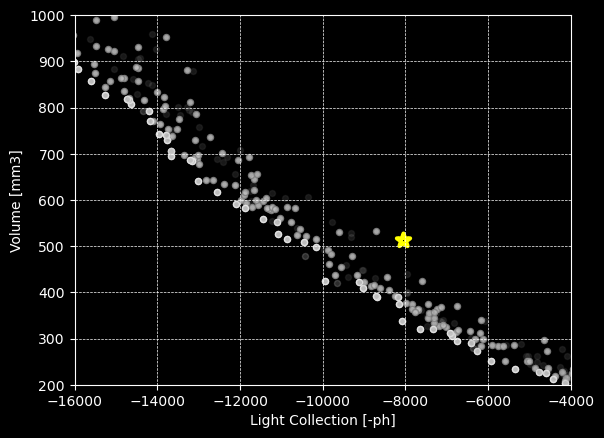

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


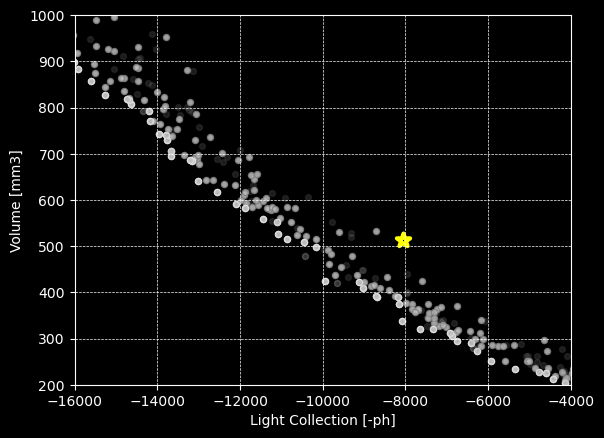

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


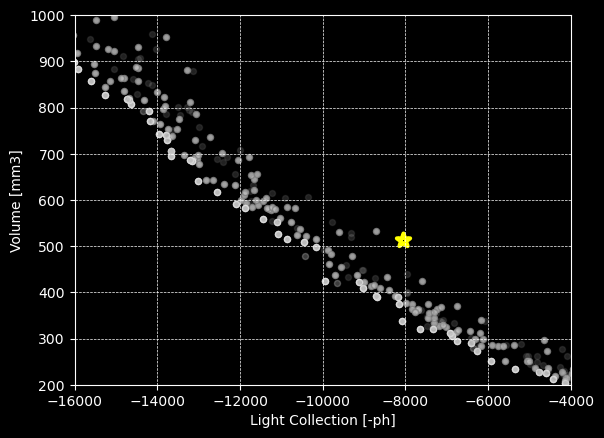

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


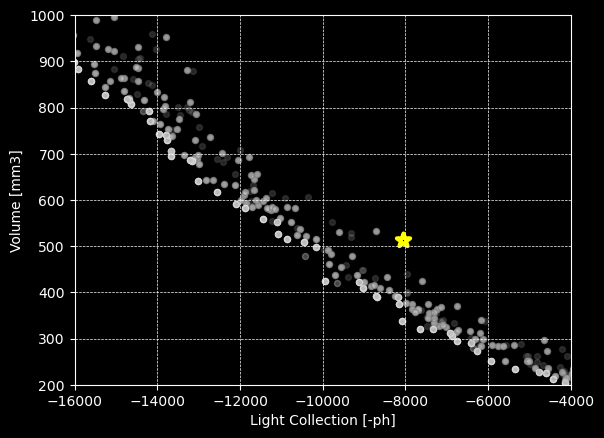

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


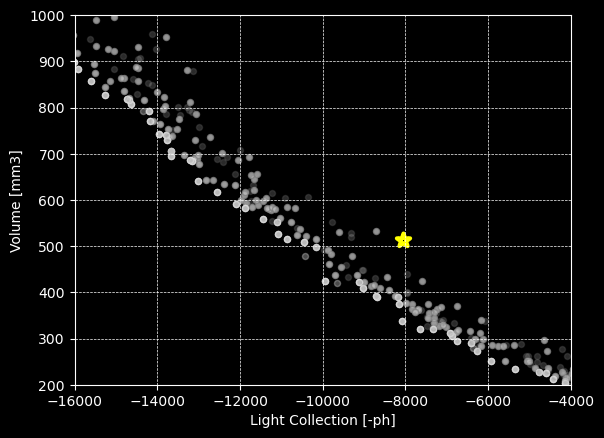

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


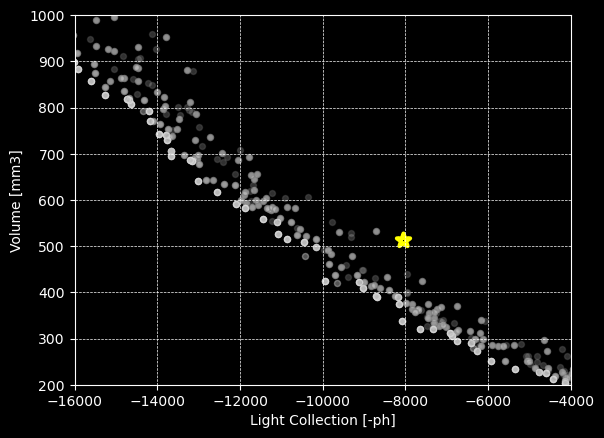

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


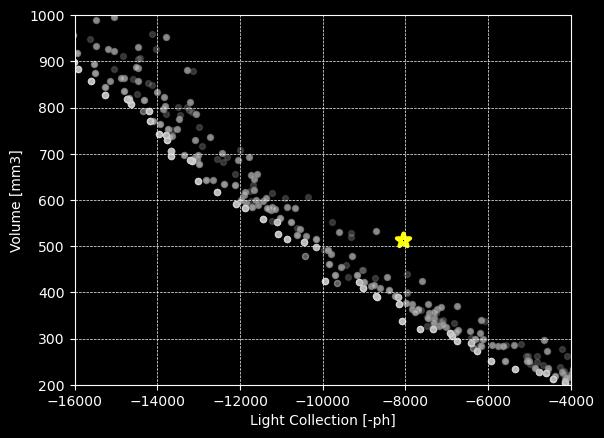

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


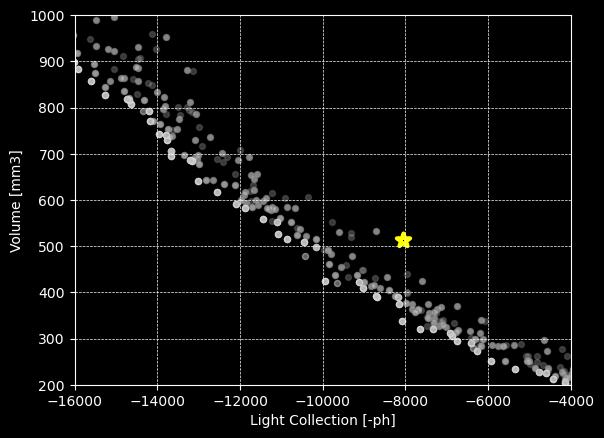

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


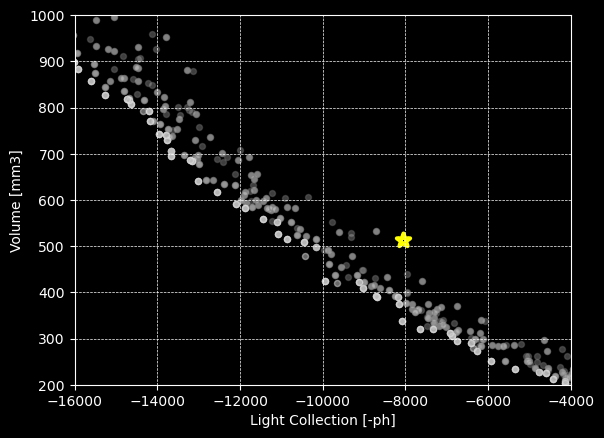

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


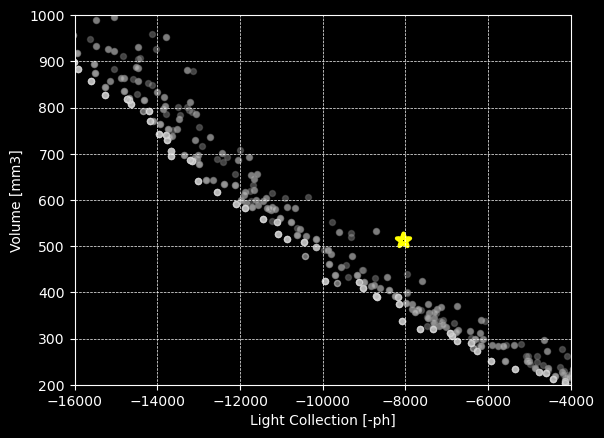

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


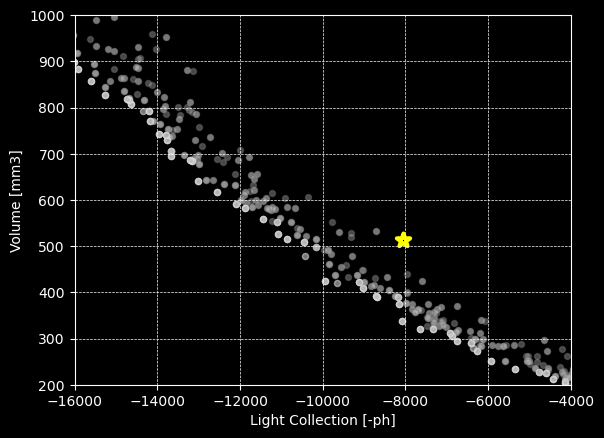

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


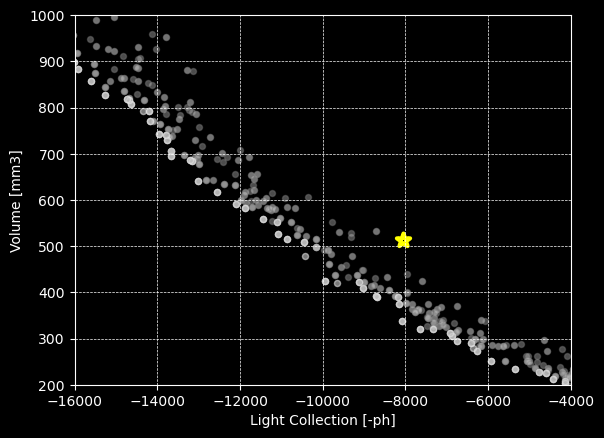

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


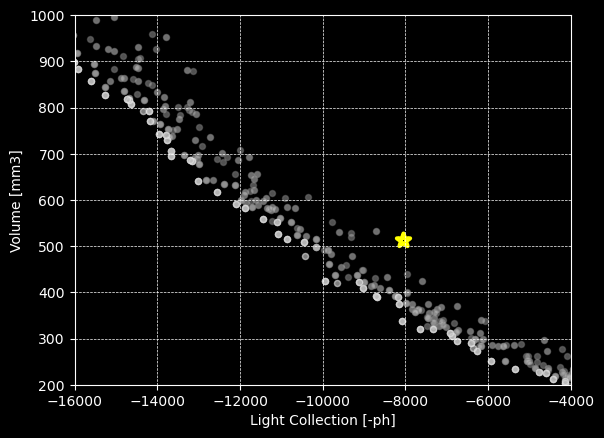

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


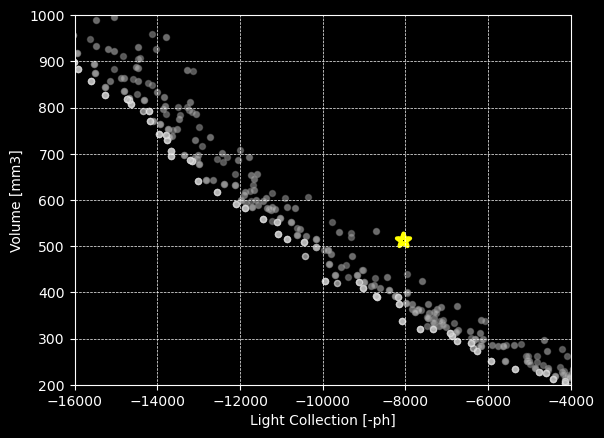

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


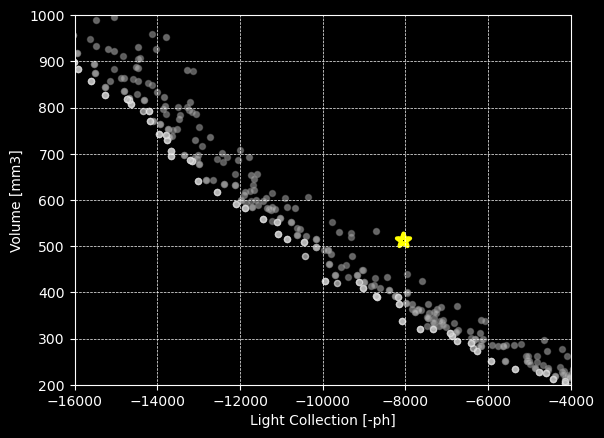

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


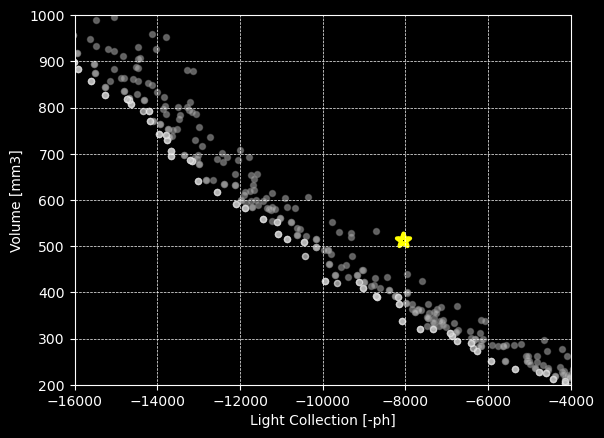

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


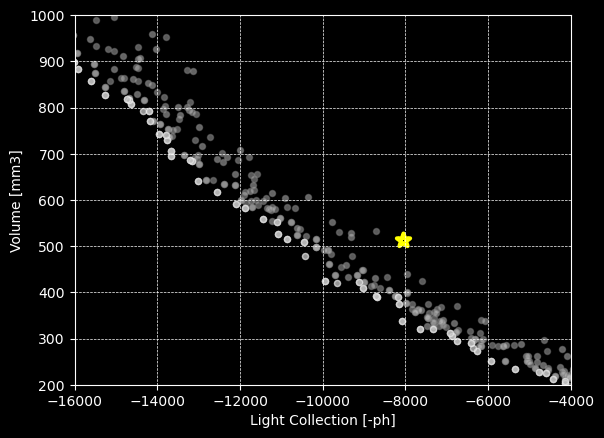

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


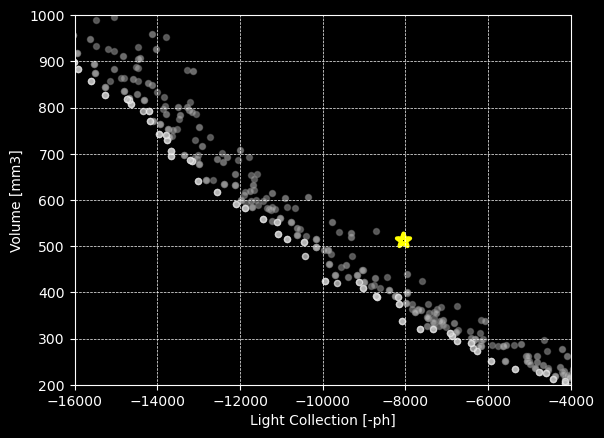

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


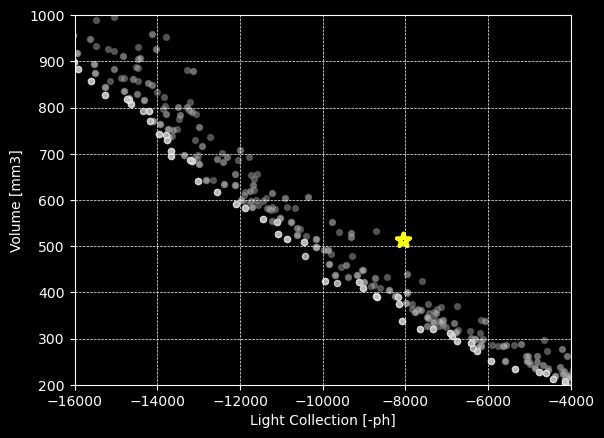

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


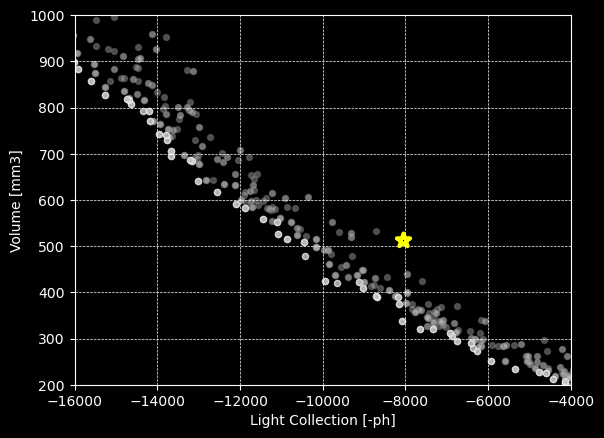

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


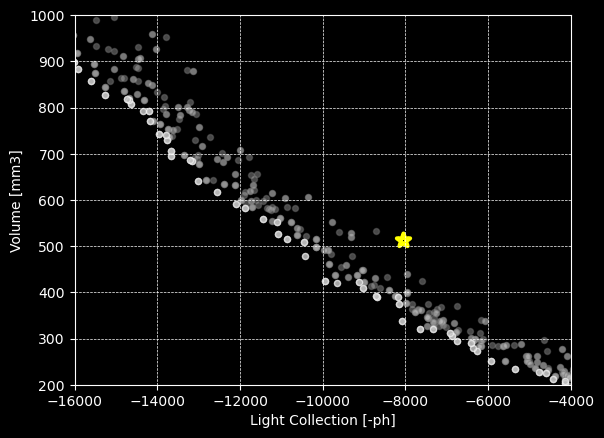

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


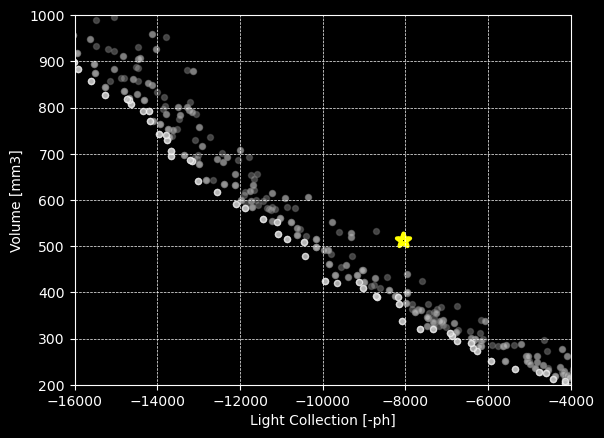

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


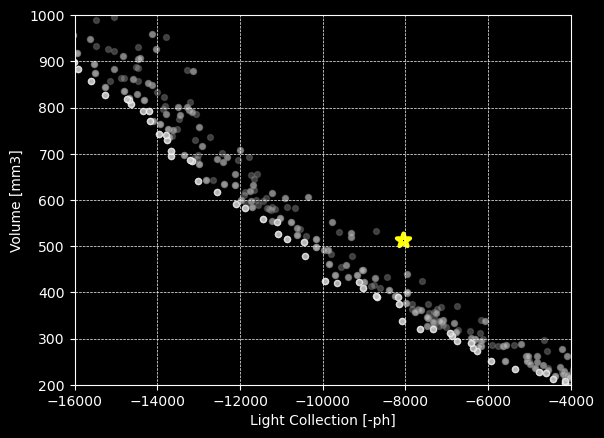

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


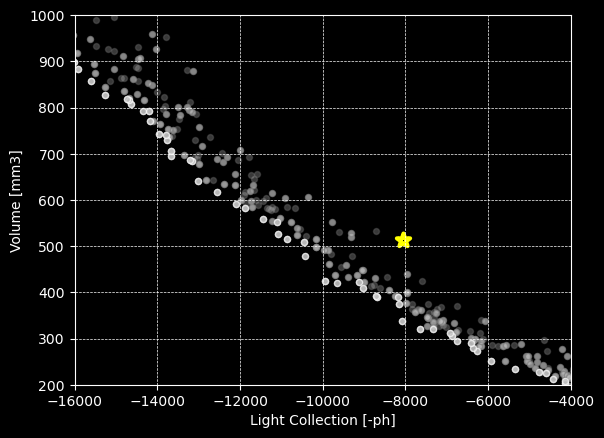

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


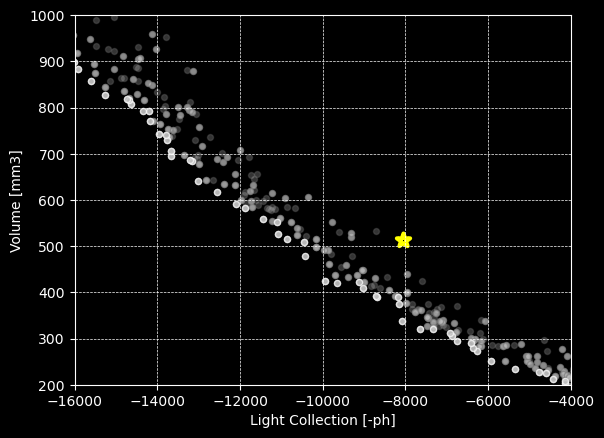

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


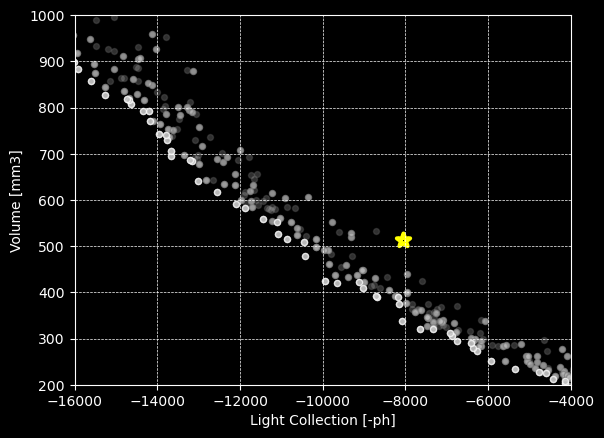

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


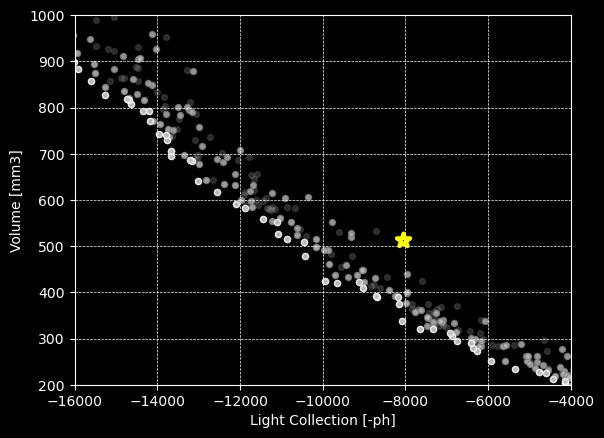

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


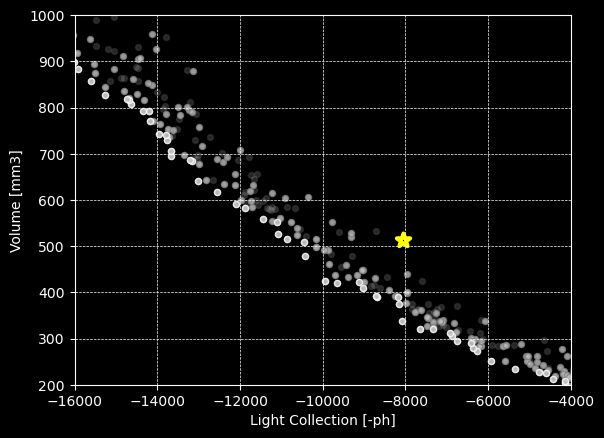

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


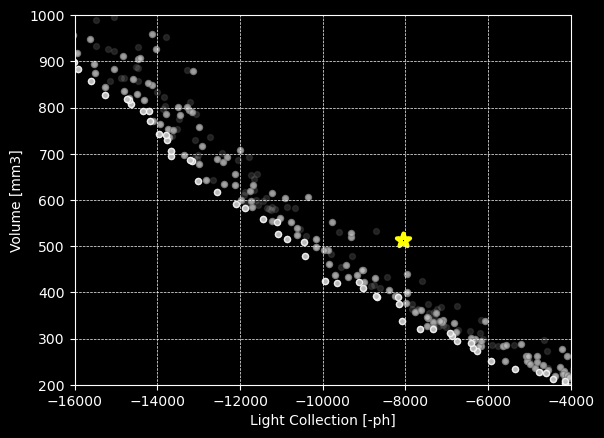

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


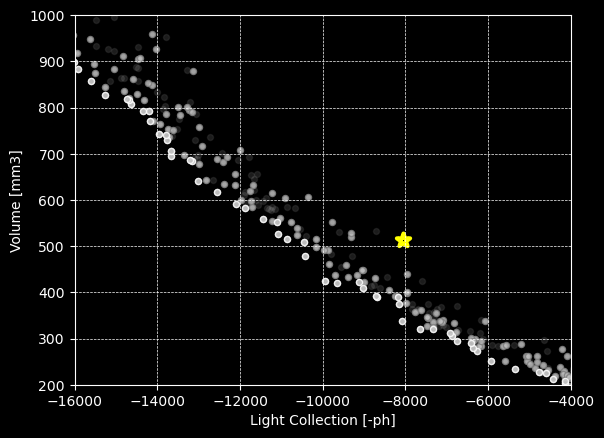

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


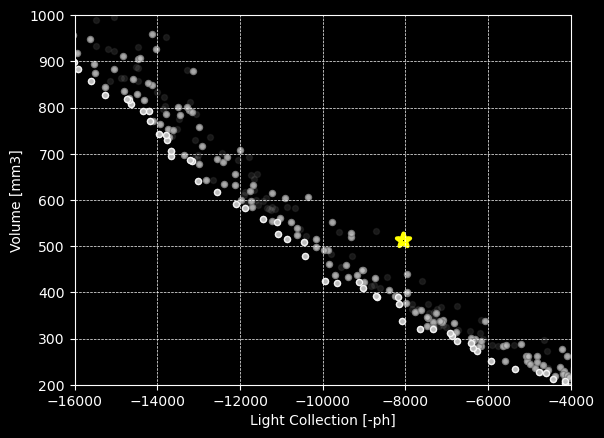

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


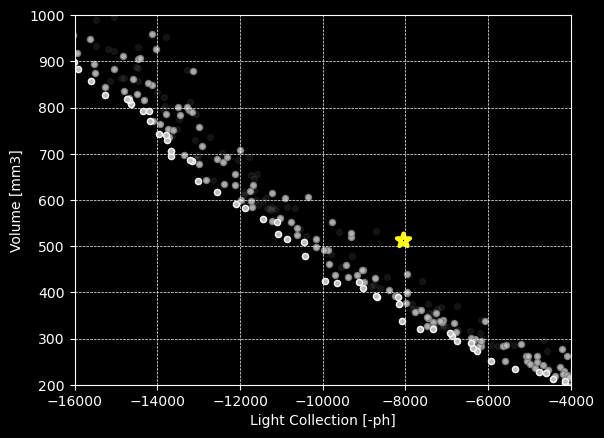

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


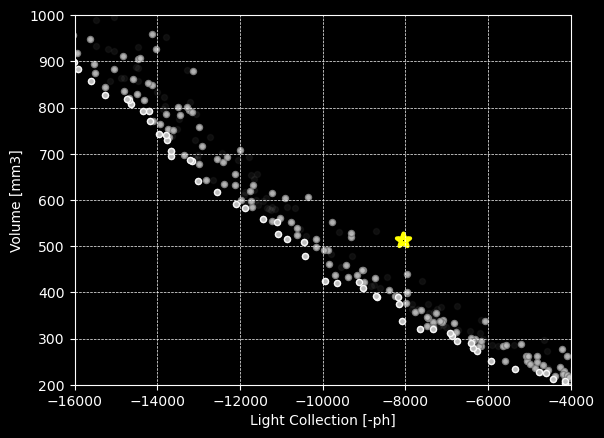

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


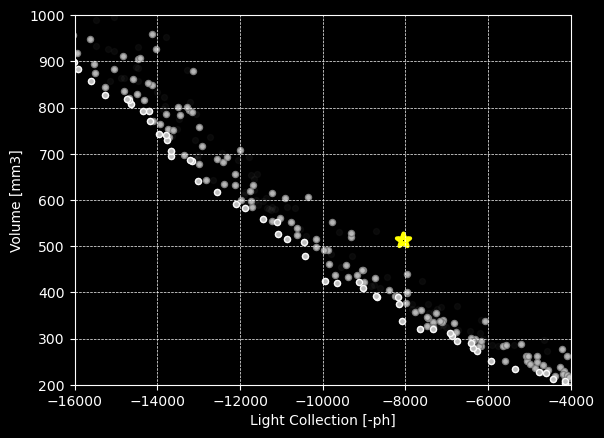

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


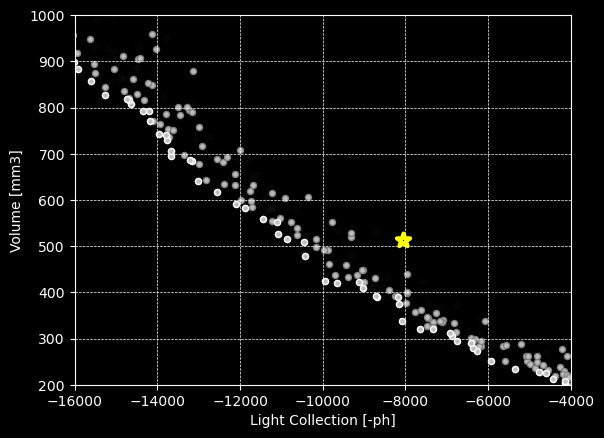

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


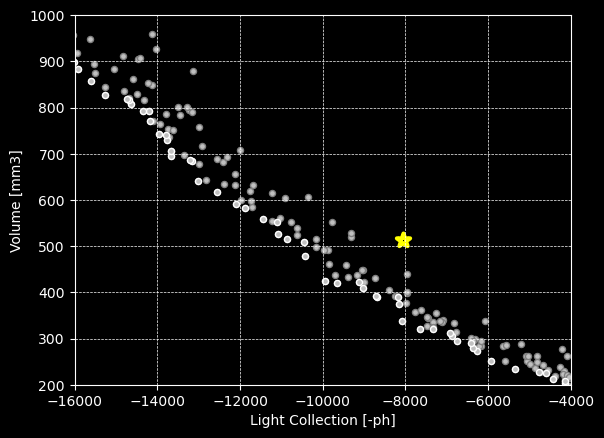

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


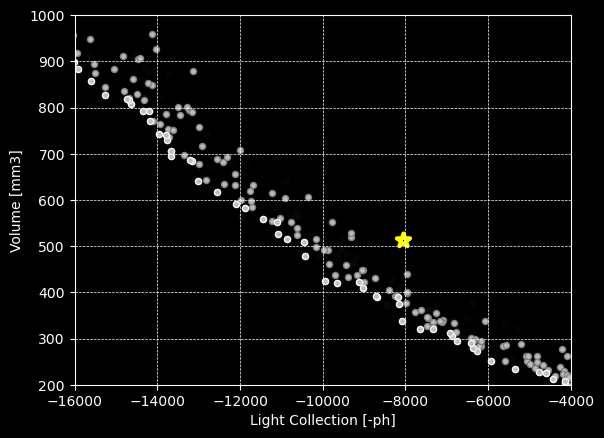

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


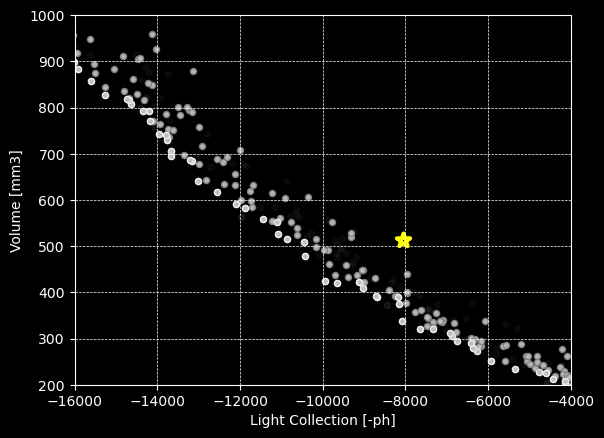

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


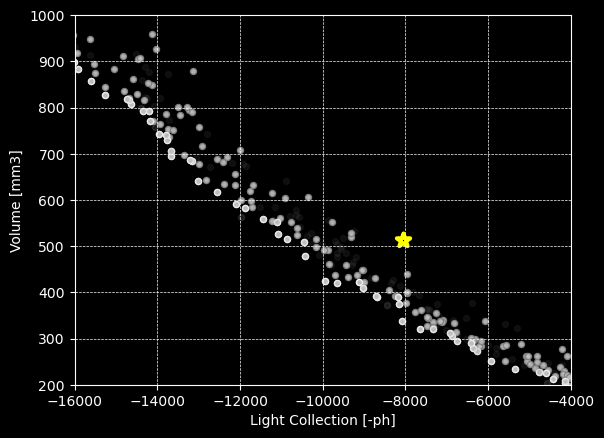

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


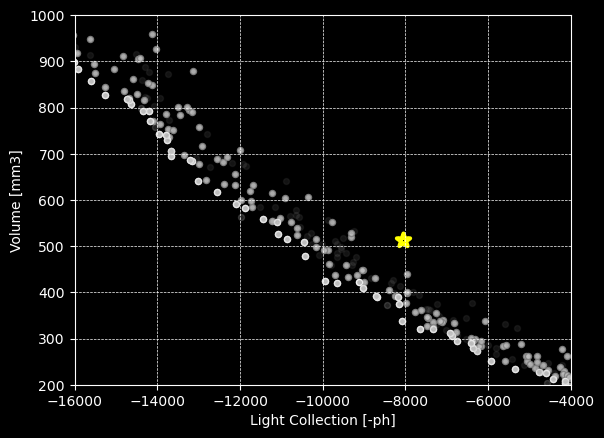

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


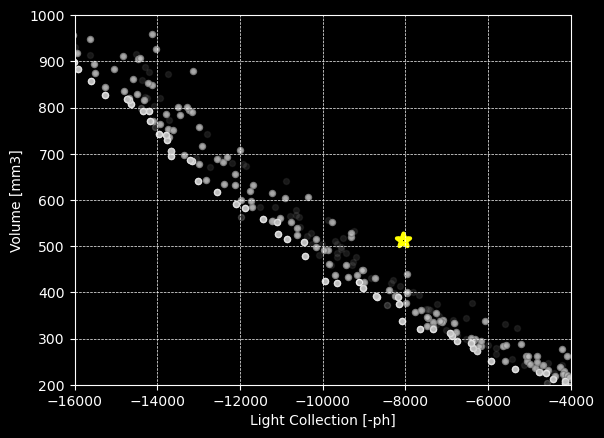

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


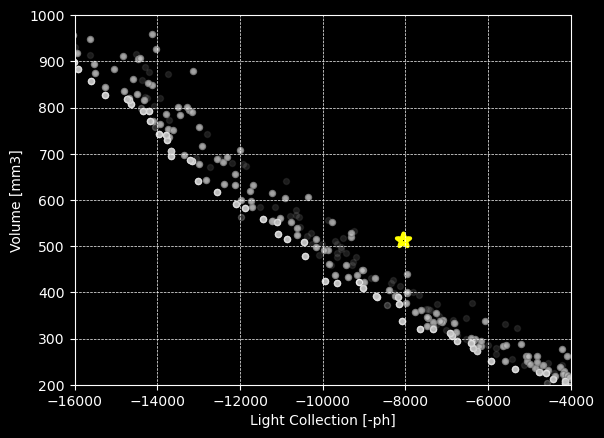

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


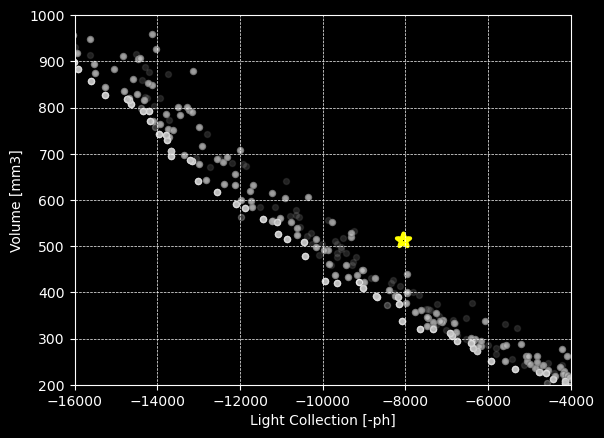

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


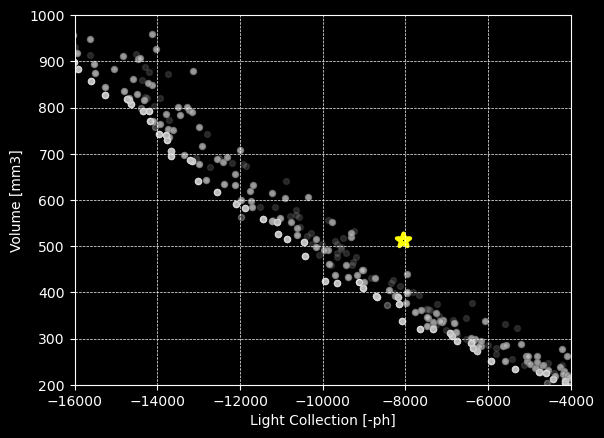

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


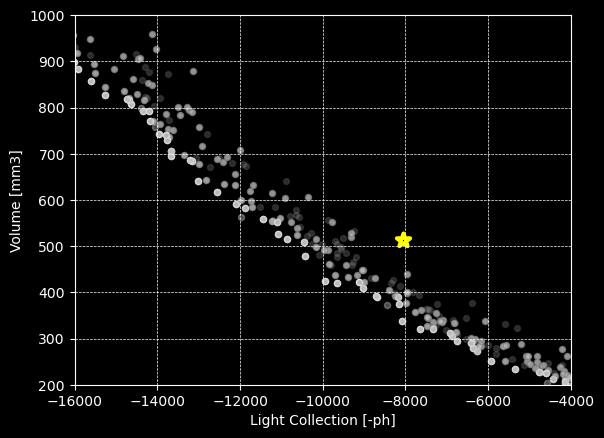

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


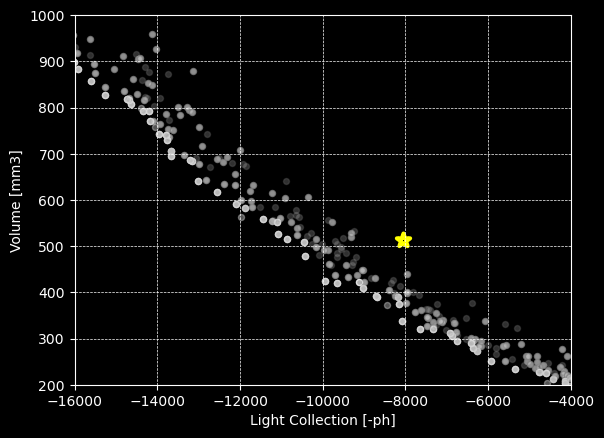

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


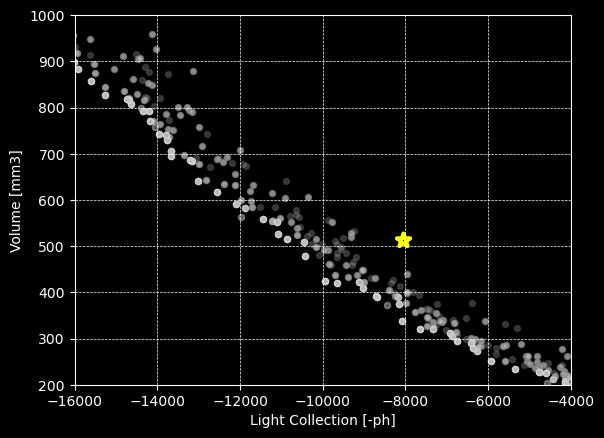

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


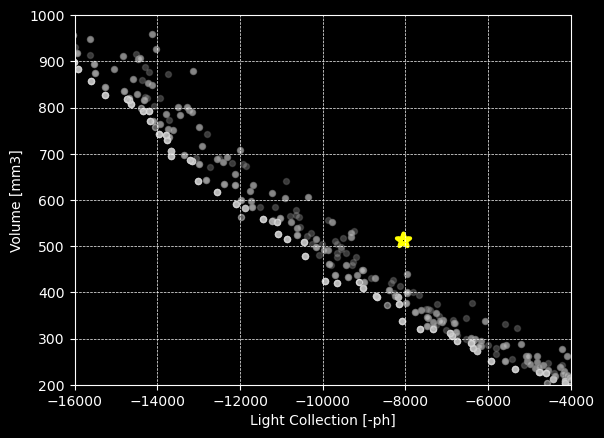

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


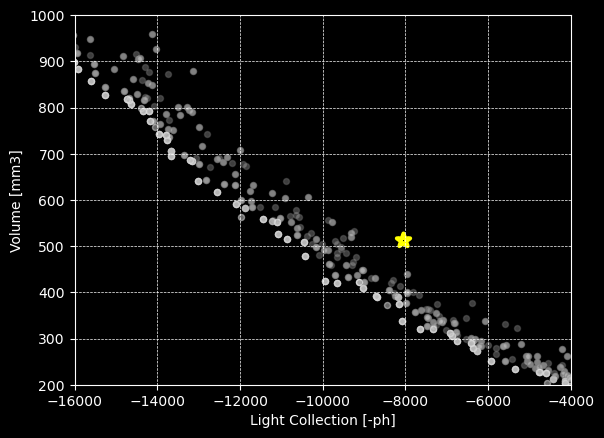

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


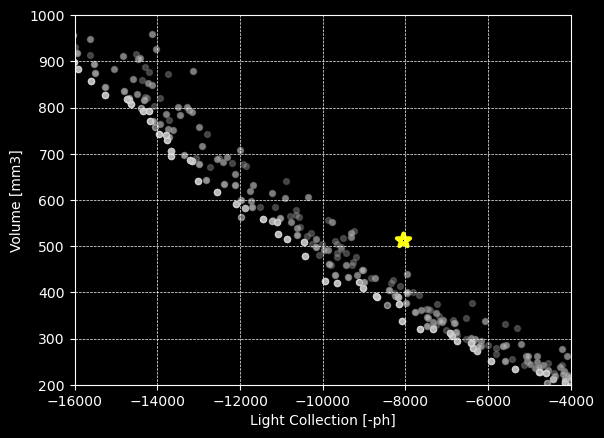

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


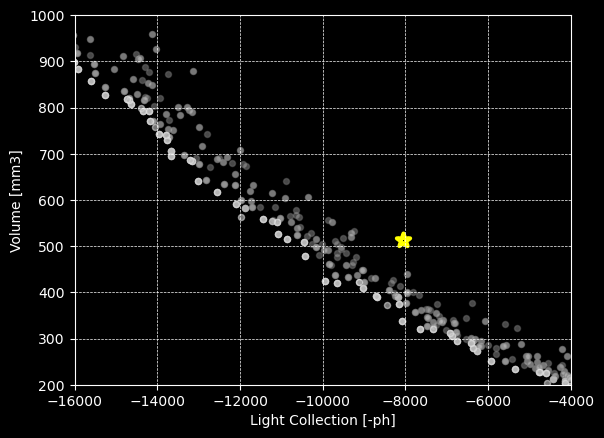

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


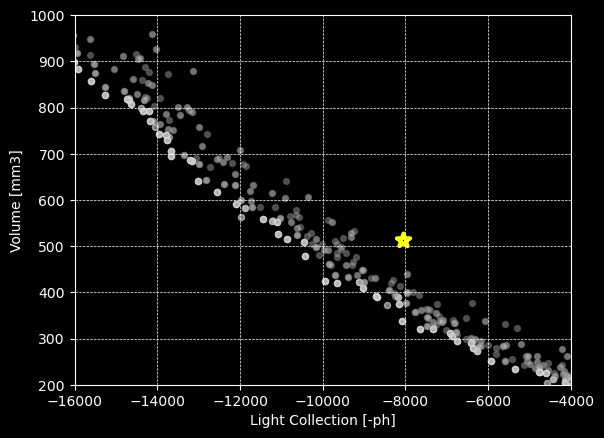

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


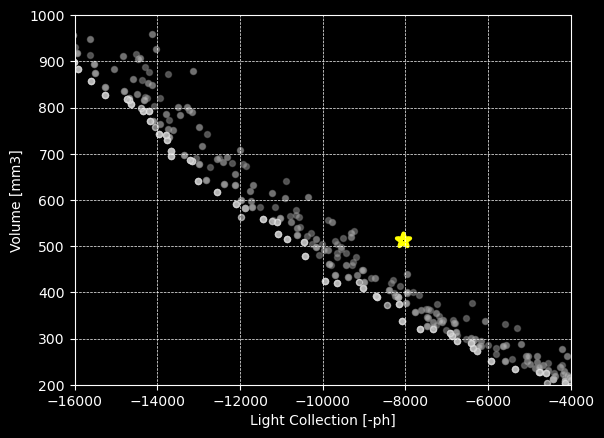

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


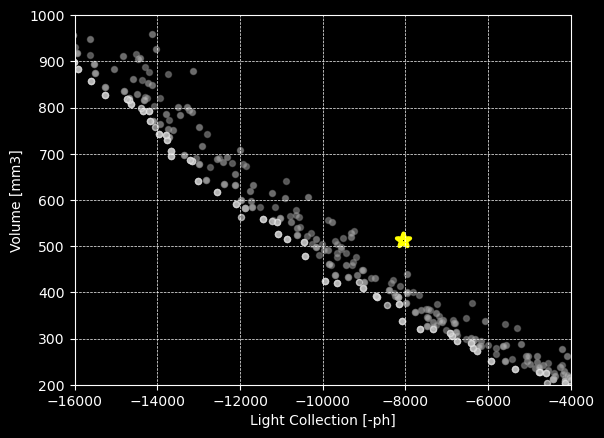

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


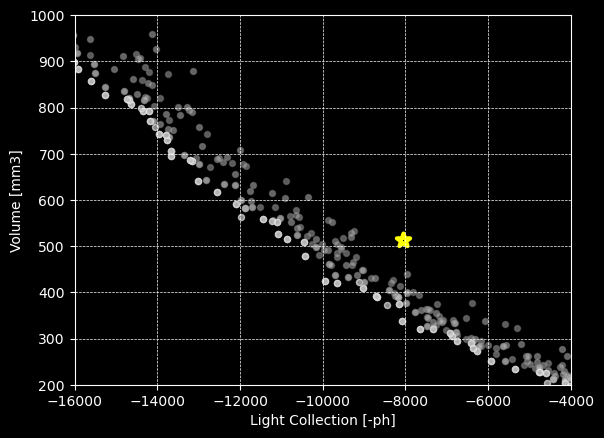

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


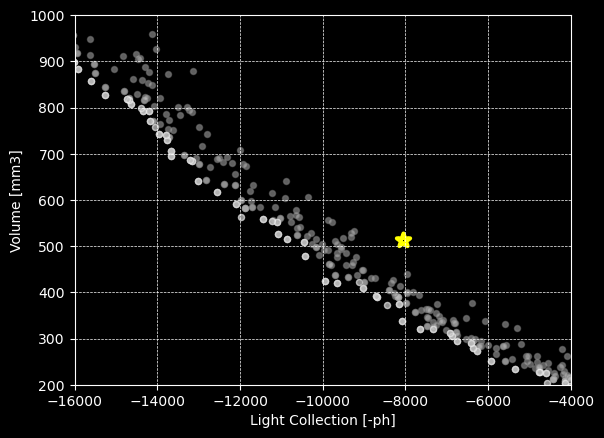

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


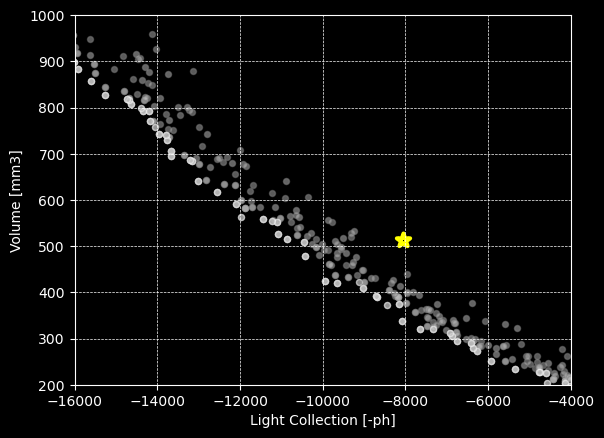

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


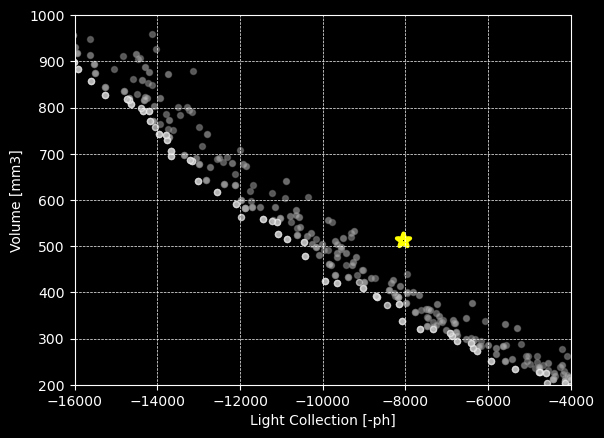

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


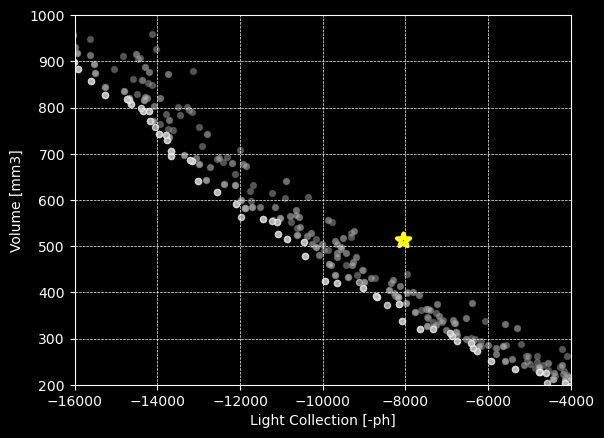

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


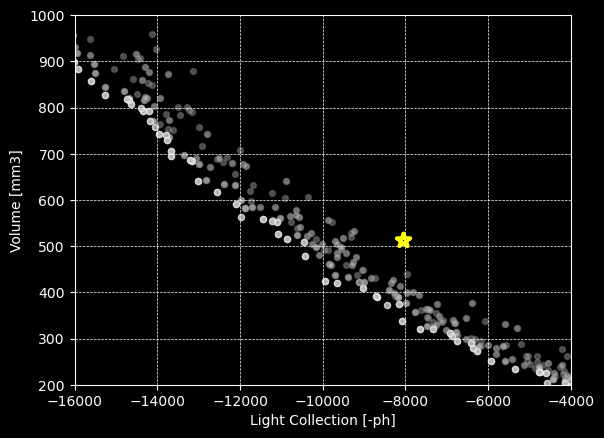

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


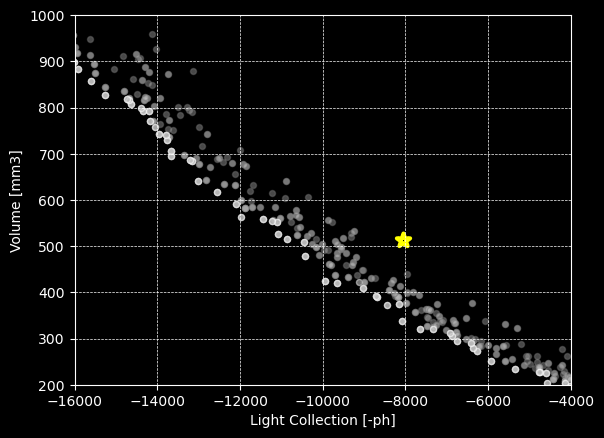

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


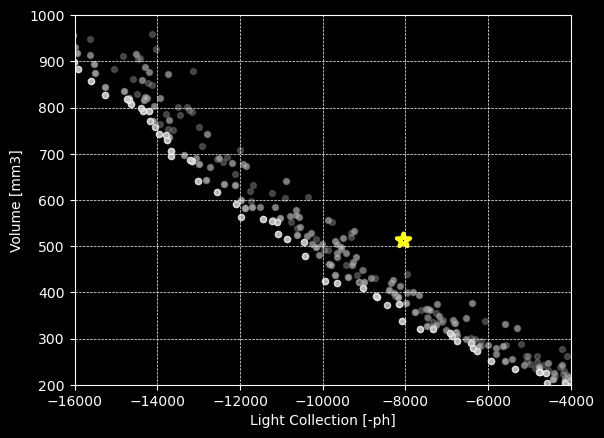

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


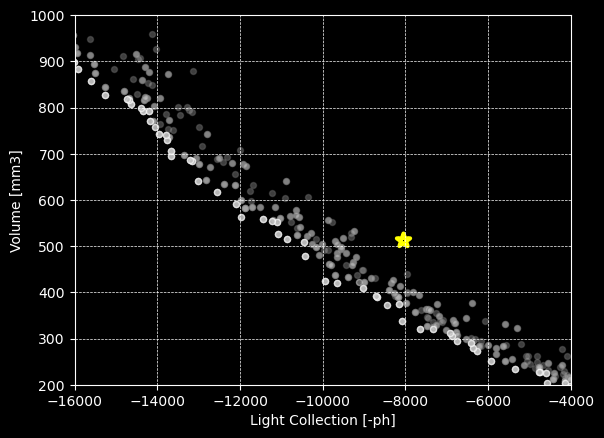

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


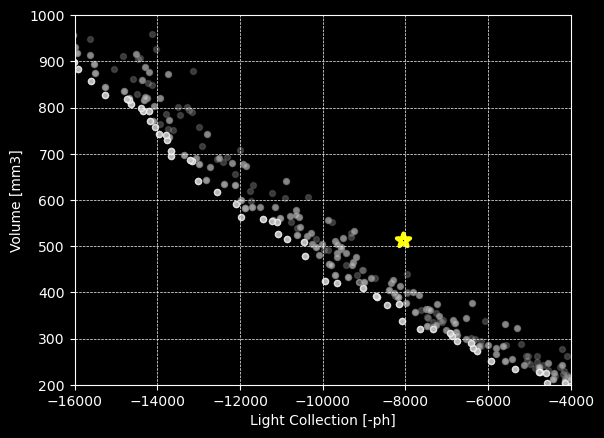

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


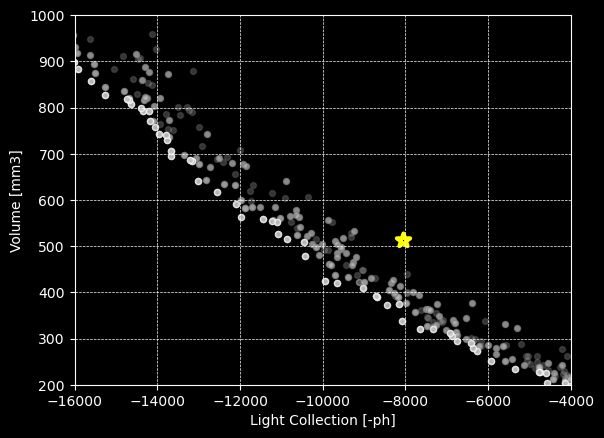

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


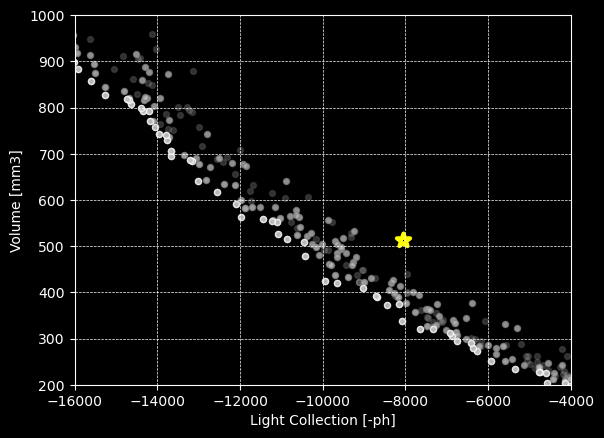

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


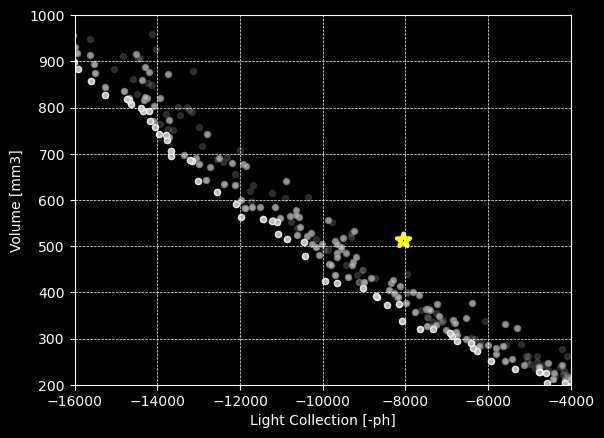

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


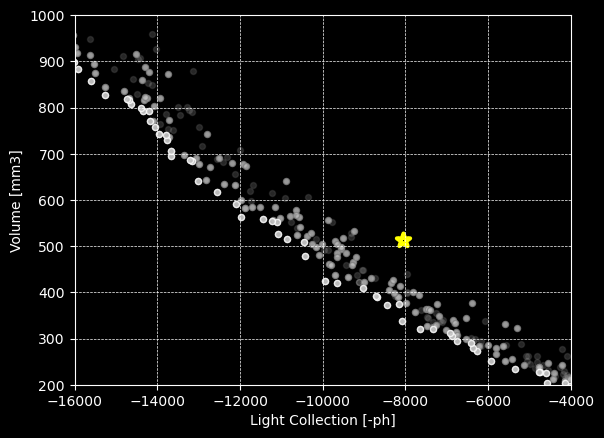

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


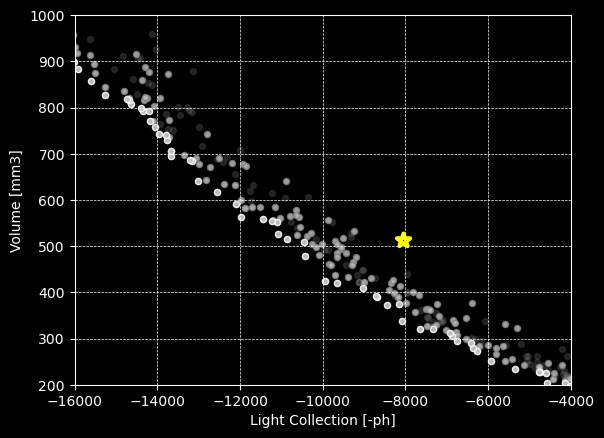

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


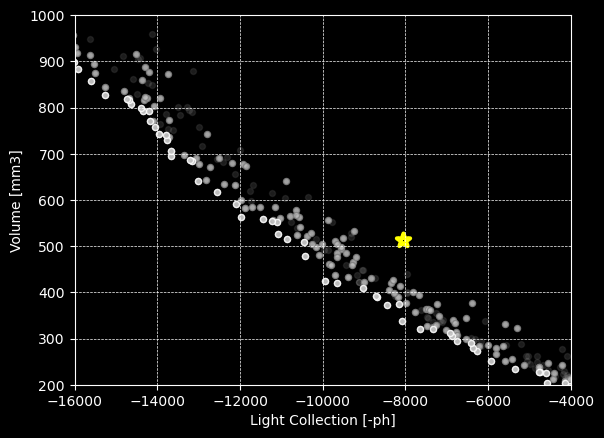

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


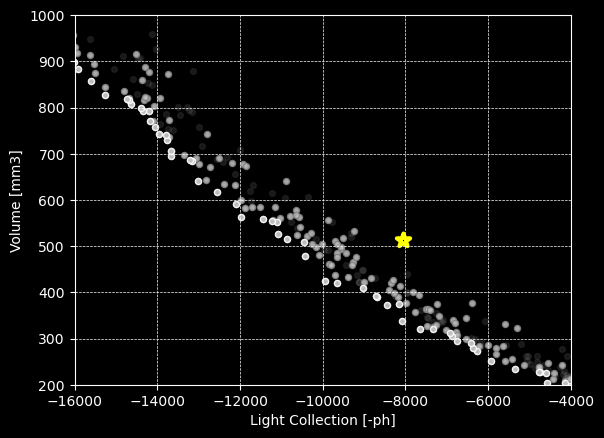

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


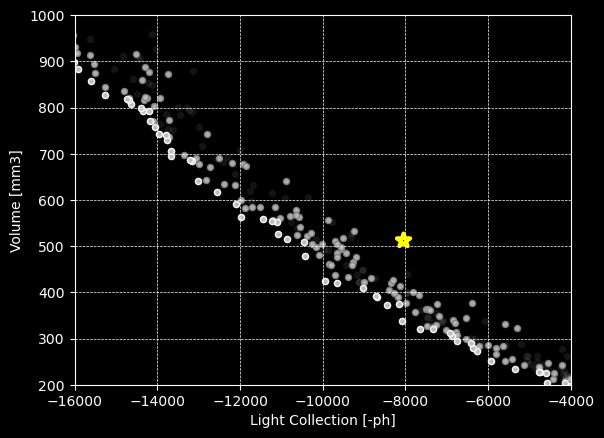

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


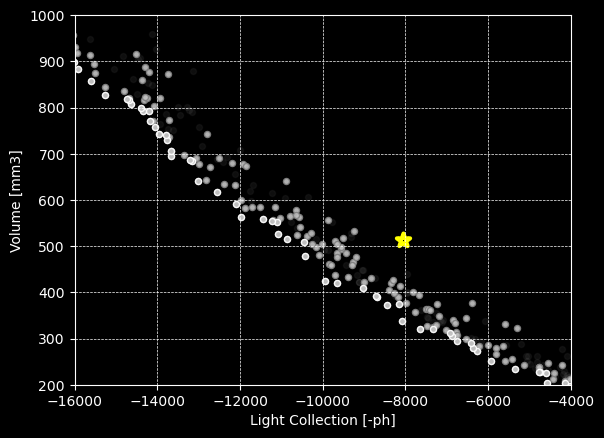

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


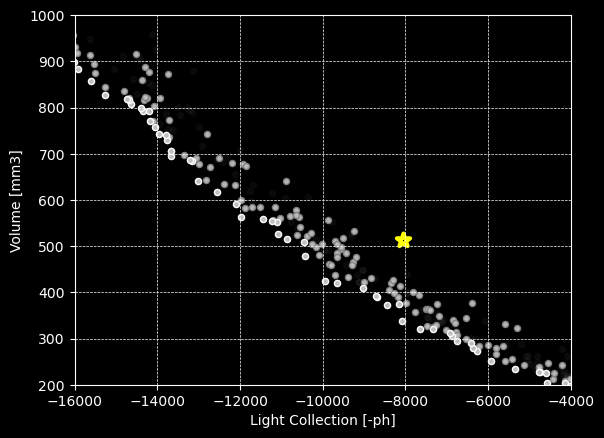

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


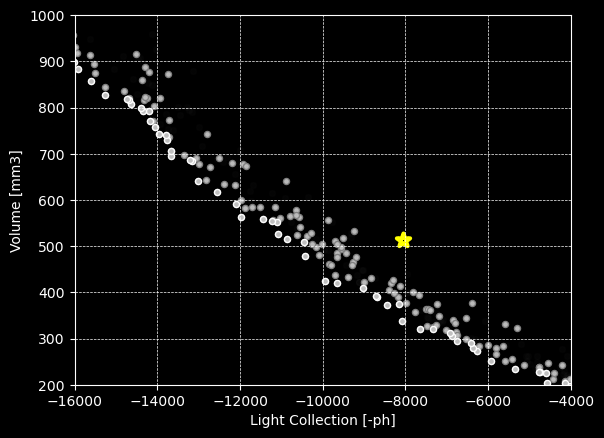

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


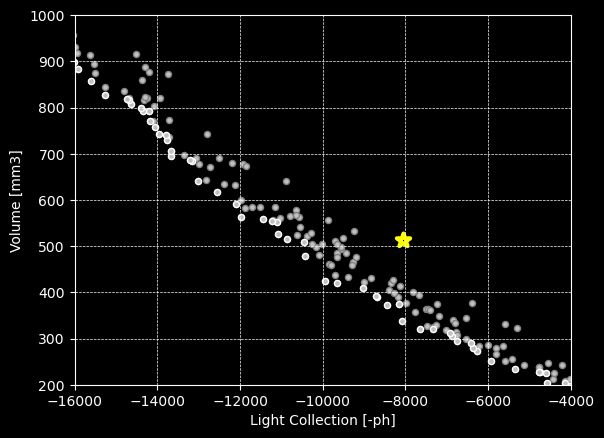

The number of vars per indv is :11
The number indv is :200
The number of vars per indv is :11
The number indv is :200


IndexError: list index out of range

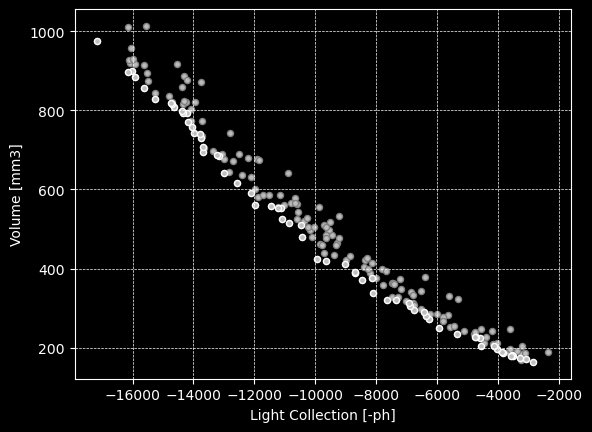

In [18]:
# Define function to plot and save the picture
def plot_and_save(nsga_file_idx, alpha,idx):
    plot_filtered_data_G_w(nsga_file_idx, alpha)

# Set default LaTeX interpreter for axis labels
    
id=1000
for nsga_file_idx in range(14):
    for alpha in np.arange(1.0, 0.0, -0.025):
        plot_filtered_data_G_w(nsga_file_idx, alpha,idx=id)
        id+=1